In [1]:
import numpy as np
import pandas as pd
import transformers
import os
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans, MiniBatchKMeans
import random
import matplotlib.pyplot as plt

In [2]:
from torch.utils.data import Dataset, DataLoader
import torch
from sklearn.metrics import mean_absolute_error, accuracy_score
from torch.utils.data import Dataset, DataLoader
from transformers import AdamW, get_cosine_schedule_with_warmup
from tqdm import tqdm, trange
import torch.nn.functional as F
import csv

In [3]:
torch.cuda.get_device_name(0)

'NVIDIA GeForce RTX 3090'

In [4]:
data = np.load('data/forex/all_forex_data_ffill_300.npy', allow_pickle=True)

In [6]:
for d in data:
    print(np.mean(d), np.min(d), np.max(d))

0.03391905487632166 -1.8280317934034276 2.70559586906366
0.01163739238481138 -1.6134729493178936 1.6175325158006082
-0.015955311241926784 -2.3844219833305544 2.073687886194254
0.0020025444239508048 -2.063220445396786 2.2019112899394404
0.013948660554444353 -1.9106848652613528 2.1393199099933096
0.014874981062768166 -1.7189655577102256 1.9073564699645027
-0.0035206990947079546 -1.6099867096672136 1.350943468008794
0.009188763132141226 -1.7185898585296395 1.904237452654746
-0.006053227536291648 -1.9834544946759376 1.8129019058018754
0.03479484537245297 -1.4865746966654305 1.6035214086580192
0.02674458073660414 -1.5985559188566731 1.8049356291269172
-0.049476397654942175 -2.1176504512747214 1.9773855070202937
-0.006583609258751558 -1.810236655216118 1.4839321697816628
0.010880738890521432 -1.9024887588716526 1.7162463240508041
-0.03646508513077635 -1.8129019058017721 1.9825704904330115
0.02471233687335114 -1.7168080526082201 1.7162463240508041
-0.005088830622950842 -1.7113969367464874 1.7

-0.013252409715922652 -2.856212135716526 2.5607233574336323
0.007779139114850047 -3.0075585541347998 3.0931955245640075
0.0439952382840239 -4.311808800196247 2.8173927088698134
0.02623934478997703 -2.502660879162328 2.6474817995944355
-0.03416095517714617 -2.55505689508181 2.6011863674547255
-0.0032927399165202675 -2.3478001490816687 2.5120946391526395
0.049722256860989016 -2.4601560412261207 2.409106665571602
0.012263244930468334 -2.6413508375166264 2.393249161501126
-0.004625718220280069 -1.9833758747620125 2.212354628520774
0.041652382855325264 -2.5988786788155087 2.549084260262571
0.010257035429888992 -2.445764462173143 2.5519505147964336
-0.0451766530528267 -3.610754057682795 2.6622335249083795
0.02104035536287196 -3.1319591783158813 2.8539564778621203
0.03795776039070529 -2.6621154562764895 2.9003190087725295
-0.016145398690379845 -2.8520613953576706 2.925131912713287
0.017513785219741528 -3.4327783068524313 2.914230427966701
0.003394387739553038 -2.9158808316864624 2.55563339024

0.003302458731773056 -2.180835094656855 1.890839758741084
-0.009294488709942123 -1.8021118181952815 1.7048299152551953
0.01505022783657149 -2.181930605479329 1.8012668390912856
0.029775000755543953 -1.702165417174211 1.4739905183697937
-0.00959608415929869 -1.5929134613984364 1.6997852523222343
0.0019470435395285961 -1.7002423403012565 1.7003337941858163
-0.010087220928384853 -1.5913101191121295 1.4709695662687878
0.0286340733916101 -2.234485573243363 2.348686640711892
0.0262394240607043 -1.8801245667655293 1.6934175894713805
-0.028790892723909153 -1.878713853478083 1.4690781107342978
0.00014677757851894212 -1.8827651612587564 1.4695933957951186
0.01453083686912993 -1.6959576085609933 2.1070357353929037
-0.0008657572622013567 -1.7943567769105901 1.5883807139867865
0.014539842110933055 -1.7875128647406147 2.2324026232130305
0.009249480591267394 -1.5828240345924969 1.9577537154918347
-0.03456875988658896 -1.695412530768589 1.6936892873012328
0.015296574283844153 -1.5872302613406502 2.234

0.005917375156151918 -1.6043374869683538 1.6070422235264035
-0.020871329741398357 -1.2497000044303883 1.500277659183048
-0.006444612196646873 -1.6082389913194963 1.2532631936071743
-0.05448622008728331 -1.612404500430189 1.2604587996840062
0.01384005864179399 -1.3926276318491781 1.5110375021829463
0.01795563678555668 -1.1052561625129775 1.39187016358513
-0.004639829946419449 -1.7994675405030367 1.6171624439232302
0.016258085863378825 -1.5072742983957315 1.3897543119202342
-0.006037089338522289 -1.2571372718182756 1.5089963446053796
0.025574059435564064 -1.7074533691751301 2.643525970680692
-0.004861974551878059 -1.703440237659904 1.3864443798724333
0.04051345938276238 -1.497346490547283 1.939508989218011
0.004881185773678249 -1.246653866852381 1.695644640886303
0.01377179914074842 -1.6007745165039118 1.4951953148266697
0.019700656130733133 -1.7786310450536913 1.5967594541742416
-0.00954741109707151 -1.4923638452584775 1.4938927971366853
-0.007491905940154699 -1.244257104907518 1.244116

-0.011020097890703882 -1.5720934175101113 1.118201665148796
-0.01939204541378649 -1.4162579890532836 1.5868570407249687
-0.022623126728492583 -1.2804343954348978 1.1058580947336691
0.0016606773752543026 -1.3580315971179784 1.138118465599666
-0.005219033768236733 -1.3332211362421902 1.2564150470018474
0.006884437267313519 -2.224385748820241 2.098047625628511
-0.014440909742537268 -2.6424025216225506 1.3626485187198178
0.02626823371454175 -1.309937335604661 1.9026400831984658
0.011482646343869614 -1.267608567051046 1.307655612841673
0.0034606233870505734 -1.405095871905641 1.43916270445277
0.01620888132922601 -1.623160985404082 1.5136120291411443
-0.011488019859724828 -1.0527093286046898 1.6870028902350056
0.018338743110894215 -1.6854912117880596 1.353784125204001
-0.009736325736826354 -1.6040620715138565 1.2770950691548784
-0.010420336037041253 -1.086773495452214 1.070465507532654
-0.011969161977593542 -1.5970734844856853 1.6043987058908484
0.0010427253622173453 -1.2379897731054417 1.39

0.02381113004063812 -2.2919119053992154 1.7559204296575814
0.015255899124704708 -1.170870219172434 1.3873167833138695
0.01454387888595555 -1.3986725910498903 1.4096149464823782
-0.02223615955658543 -1.9172736193814044 1.43512385066263
0.017949748792056915 -1.57453253026859 1.484899811220584
-0.01002460165921598 -1.6292193735209495 1.3473158797298286
-0.03662581537595661 -2.060987928248717 1.7419029254196017
0.0006458552954763567 -1.7502741334369551 1.6652677246187588
-0.00391656564029025 -1.8239179096141522 1.713458398035809
0.027649194233329615 -1.793993862233347 2.7835541759668563
0.005423172731018235 -1.707068275615575 2.196726031418052
0.0038950318116621023 -2.2964255557720867 1.825674038262385
0.01961007023372283 -1.054039208436322 1.4767345709869601
-0.041861799119052426 -2.8544519025686657 2.3754351539880143
-0.008014063787417886 -1.3668177347315913 1.2086650202774585
0.024818084420261684 -1.2696337625747713 1.26816330419549
0.01055401078210856 -1.1243178499385749 1.609595853219

0.004090607670689801 -0.9275642955358875 0.9846503987240285
0.0003058786583715526 -0.8667021718644657 1.1982504495640398
0.006783052320043168 -0.7562310057751679 1.7451294093000942
0.0029858252449042185 -1.1189682695310197 1.0874905881331909
0.00029074237999184043 -0.8654536137959142 0.823620307718468
0.01153480468196086 -2.286481784290372 1.7005861088475718
0.011043078402501755 -1.2400597088897147 1.036516944927616
0.002606773603031262 -1.8476130121058403 1.2404367981861584
0.008052040908324674 -2.439476502555301 1.6728048521257601
-0.002326187855368326 -1.1506784228479723 1.2260852348720628
0.005257964621294291 -0.9995156627886238 1.0695001321790472
0.010129706073562299 -0.8003931266473955 0.9054670489369271
0.001633283753861417 -1.4086023908630105 1.268017939420788
0.003200618345916428 -1.5528476447925765 1.9982721286206357
-0.0035364184871706904 -1.209865444258786 1.085778943733373
0.0089956196106556 -0.7077310612970826 0.863823145313927
-0.008870575936436935 -1.0344967634416324 0.

0.04114982064413088 -2.214133830946382 2.2052802816346695
-0.02521937565398141 -1.3929707994974279 1.2366563572232403
-0.013681247469875715 -1.885487510717313 1.3411437652573095
0.0007799137610701042 -1.2682132565222666 1.801981300237644
0.006529784031262186 -1.3535671889782541 1.6608189269474185
-0.0006476495590028478 -2.127518394324186 1.033573165210533
-0.005011551678908644 -1.2074714097305232 1.1400172879160186
0.0013398551260740293 -1.2057852439339656 1.3379816134428515
0.0038384129567261708 -1.4936443853471113 1.2818755817960945
0.02267498106769521 -1.3092874118679618 1.2659536264753022
-0.018458775031868973 -2.8820937249761163 2.0301142348648558
0.014264166803038129 -2.2944075556346193 1.091385582918051
-0.01016514960709034 -1.1425115241328427 1.192048799757603
-0.007712474594034601 -1.4232687820763739 1.0542137833142777
0.009683085693074162 -1.1083912781611625 1.0731501726197892
-0.026249778083382073 -1.1597152199951137 1.3462723313864022
0.01594509923134668 -1.2730762581101192

-0.007458182811892252 -1.0702785941797603 1.2305585496189064
0.013336488990730923 -1.9777145273619319 1.7164231155855538
-0.009821804255195249 -1.565392597051211 1.630458243249368
0.013395160596733418 -1.3288834768555784 1.1859253785896726
-0.008705756852007224 -1.3151522726488107 1.3174459477349416
0.008247761835262308 -1.418748445568008 2.1127333874639427
0.019923683856117445 -1.1671119862221109 1.4867019206486267
0.005871182039257638 -1.163983345939447 1.2538855301699432
-0.015086592543432966 -1.5601529694545224 1.1171012790993533
0.005630449568849008 -0.9765127185320136 0.9952646919256738
0.022121210744611354 -1.4698832697886182 2.154843539488044
-0.006872063673429664 -2.0153971801658543 1.2525487240987463
0.012803044010109975 -1.013398914686029 1.1650931549678911
0.006767263984506397 -1.6174982412833319 1.1145638876753046
0.00983108037118192 -1.54723195460113 1.9144191850335786
-0.002322259863656996 -1.5007339776257969 1.3059442809062054
0.010703652655134375 -1.4769775060241677 1.

-0.0038871220367968093 -1.2122915450254068 1.1331889842480618
-0.006531479839481023 -1.3694111885933686 1.0291846779883778
-0.00225541848830899 -0.8269924132777385 1.1512419423300415
0.010363536042407891 -1.0289733274696167 1.2443670227525363
-0.001718661042822428 -1.1179670300642723 1.066439203614553
0.007383238008867128 -1.3822554095698056 1.2136996570828713
0.0010473923810412219 -1.690633077961577 1.3020120980683376
0.00022084809857699024 -1.0478483207652225 1.5038681174684019
-0.014994012339232957 -1.0307330513695574 1.0311109866332813
-0.016745162697587634 -1.085898638362043 0.9572809162308198
0.0007803350335124672 -1.3729520687168217 1.2177784853660276
-0.010156729369474291 -1.9825972632982582 1.1399179735808593
-0.01830515416393267 -1.8133528592660757 1.4008799365897964
0.019226818913375802 -0.918572653826702 1.1241495188975574
0.0008834283107055532 -1.172307125177023 1.088910761528724
0.0069461460548898984 -1.9097697001597964 1.4264679992754743
0.010356811758488568 -1.333418187

0.005970524574316203 -0.9273957346647443 0.9698928639638089
0.016131614844841016 -1.4629080781669617 1.4755106653613808
-0.008060108263697985 -0.9888360265930419 0.8815066764433833
-0.005715251985254861 -0.967411982015609 1.1025992981973065
-0.005819788934837526 -1.3009239272081556 1.010416195665858
0.006501879410313657 -1.1229532405276401 0.9901030744783025
-0.005256516816277512 -0.6841047843813813 0.8829242511401848
-0.03048270948174973 -1.3989078725123172 1.6601690301505039
0.00824288770657298 -1.4809816819817059 1.2740846479822896
-0.010317512425082033 -0.885175479750452 1.0714165183692195
0.008111505671098473 -1.3329530678626116 0.9510656682382512
-0.0126790894203159 -0.9298035097486798 0.8854199358389356
-0.020045921818244137 -0.9742521596973278 0.9947282876874264
0.006896094656780077 -1.276434090406542 1.0150559876952447
-0.015119343052220884 -1.3372662622227778 0.8653866759741665
0.012610207807960027 -1.2426650183413126 2.320450844216913
-0.01901454434059963 -1.519971718163403 

-0.012329197714939902 -1.134699533222396 0.970169339562479
0.010108431056230976 -2.007936184408774 1.7696250044198445
-0.002511868947073077 -1.1524147934226803 1.169188942223169
0.02384453347853907 -1.8366686514220945 1.2607289407186741
0.007508199530281482 -1.7571481873471737 1.246596751808582
-0.0192539558218189 -1.0273002335441428 0.8417773487957395
-0.009019187642622096 -1.2021622166610604 1.1533190557656245
-0.011465521109770345 -1.5830538786788821 1.1039458604044707
-0.012009248014760946 -1.1890112127510637 1.012443407077829
0.0031667065113644075 -1.6786759613322713 1.5297330837452008
0.003700819603310118 -0.9525347777576646 0.845018657121278
-0.0007813897269738918 -0.9523913559579612 1.0114707645393988
-0.020771195033320738 -1.9304204896258756 1.5314020310550924
-0.03253277753639012 -1.343627373434452 1.0930220784534246
0.027263927409757097 -1.224317818817092 1.3433193074097858
-0.005746261379036444 -1.9642193890782347 1.942586912686255
-0.007813410357499096 -0.9145158428732375 

-0.04810853913850188 -1.7762012873481605 1.6689573993167186
0.0068977264404805685 -1.7779359806252035 1.9661693727755059
-0.034122672081679774 -1.970726702126871 1.8835633947584154
0.03776706161121353 -1.8786407791645239 1.8792673663068928
0.0364196595348075 -1.6640817518550324 1.9591228481872078
-0.0053284529750368525 -2.5262711327936858 2.422533476696591
0.020857637451371206 -1.8575478099049274 2.476747062667651
0.00855007549621231 -2.1737242032589332 2.1075484182851625
-0.006217816949982387 -1.8618200691305717 1.7628743102137248
0.03960524901931315 -2.027662085529742 1.9468707639226517
-0.016299113832610325 -2.0346716676030767 1.8616160607732195
0.03400592346033833 -2.027141539504364 2.521381861323047
0.0328370414053106 -2.023507575544229 1.524961584102938
-0.017787428629811718 -1.7581890296781502 1.9456359134852421
0.03388738453906423 -1.756700246821736 1.9389822665925416
0.011018765318029134 -2.094326646792287 2.0955762711889885
-0.012832735419384093 -1.9376586019635575 1.84747534

-0.04302909732664578 -1.7230696795006515 2.462397203821063
-0.02401561964987349 -2.37822523588015 1.8972848517562493
0.02009512454185533 -2.1685431025014985 2.282762786581355
-0.04011868274463154 -2.42684607480099 1.8998294891562395
-0.003142363387941557 -1.7359566152219974 1.8217968677127165
0.004440076162985057 -1.8228403481643034 1.9809116753378277
0.03858257708149276 -1.7285514742560413 1.8967594667659333
0.03089829628581416 -1.814448465273747 1.8143624580556514
-0.007788609179028325 -2.0998310278683197 1.809135368194463
0.01721184201957345 -1.9734956971021655 2.0401889120283263
0.01660625075487059 -1.6296607200520314 1.7257630273197255
-0.030905903585287497 -3.5547359655124815 2.7779064349304656
-0.003183731313948496 -2.650859568252321 2.189299540280481
-0.002030783159867095 -1.9152836713328918 1.9906713431740675
-0.040421759228429985 -2.445113541849305 2.4005790147764623
0.04096670491878018 -1.7455196441245662 2.065870386162493
-0.01683930205285402 -2.727413311306398 2.3050133982

0.004523380679122358 -1.6915186978075316 1.8786199021237027
-0.032912207521389944 -1.5871418479207755 1.69305549219905
0.034379780975603076 -2.032066122143451 1.9601322753773962
-0.008060899687200564 -1.6907966849582183 1.6925127027254165
0.017884991020084076 -1.9598464511174296 1.5839668255586068
0.01754970748575732 -2.226972651297955 1.7876969751820002
0.014420548644752867 -2.090326906620935 3.2447319494725706
0.005249892415509159 -2.158461283041037 1.6828149825016603
0.013924786655818403 -1.5768784525433543 1.7803694059792672
0.00028722658836055983 -1.4545684420413654 1.8681727152258623
0.03628382685805518 -1.5737524139168828 1.5742723885107552
0.02424916257862213 -2.086323806856747 2.017514696428348
-0.0046727438222478965 -1.568747121526243 1.4491406102338715
0.0017150036889112372 -2.0161968921813247 1.8620853651386673
-0.03565038729165962 -1.6786370530506134 1.677928444256313
-0.009557679337713829 -1.575053123056388 1.5760955476850322
0.040134133158766315 -2.016667276035948 1.8619

0.008134581699612644 -1.119576846300947 1.4089760609663016
0.03018303255446749 -1.2851982442485368 1.6400739973593919
-0.002063895881799235 -1.269203029454656 0.930546174112894
0.008538168674867357 -1.2962848073857223 1.4152910976768776
0.004071568542368816 -1.816257848169714 1.825532731640804
-0.007649274026508472 -1.4000632672056372 2.661429075867862
-0.0010304490648880284 -1.252500639772644 0.9290109080124126
-0.007917674959894152 -1.0787475476415587 0.908886253326199
0.00740895444352517 -1.2827107522743935 1.1948572240043782
0.005215367600725695 -1.7036175077675253 1.4260671468393527
0.01023686487015045 -0.9068900778197723 0.9077896308489065
0.0067987796363199815 -0.9275241641533687 1.0229435848766826
-0.029373296861993626 -1.49882172664507 1.1440342131568868
-0.0049204121057475824 -1.2249999335996635 1.3907370266220487
-0.008664316904914912 -1.225281789409176 1.9738308470316792
-0.03893436397733405 -1.3142603027056943 1.1142259686250597
0.008124316865380905 -1.3154107798590222 1.2

0.009421087674232116 -1.2151213578048727 1.2337968718821168
0.029929183677224067 -1.5005289804898247 2.2810120175803457
0.01417217492603199 -2.2361425453893222 1.4829181413764587
0.013958905504921562 -1.4358351660080697 1.3917712993068176
0.016282554465199002 -1.4078650674560356 2.577151007224622
-0.009498866073179322 -1.6556547960090802 1.7789992955987994
-0.03182674015772321 -3.4673618875114083 1.2997612673733652
-0.006191842347694215 -2.275172227568851 1.5706327064456975
0.02237976807987374 -1.7805816780548769 1.4299098725783992
-0.004659105213680639 -1.756181522336212 2.3167430978866475
0.00789918805120605 -1.5943816451686936 2.1200726441370112
-0.0031992743861730547 -1.3654945144772521 1.4562497202750924
-0.0022798202296028082 -1.210263923966795 2.5389330452335375
-0.005612120273761832 -1.484816583680611 1.3000321712295229
-0.0004279298928678327 -1.0521230388052838 1.2663953027487496
-0.0006041478231396617 -2.197268678465638 2.6096967293727467
-0.00898413702764795 -1.9615815364574

-0.0004136963011781426 -1.686405973549138 1.7509758201963515
0.0159493709398054 -2.222556215830391 2.8961240656864704
-0.0009152219676092231 -1.7693494465482715 1.595504818130058
0.03585467467087029 -1.8310420246025596 1.840812710991405
-0.004571450578151547 -1.2083868295143965 1.6676698050524856
-0.07099906297303345 -1.723678980314615 1.8280692504312162
0.0048477811084420355 -1.843403196758663 1.9411022234311497
-0.018005395766152302 -2.1195989284897014 1.3305424770409018
0.019303144562825943 -1.6886047437575176 1.4644247705693672
-0.007677412779939144 -1.8358308174520548 1.7716748065019512
0.0029592437290210296 -2.185117505231683 2.0363142574592934
-0.00016800478254335761 -1.7021459653916233 1.5840162214929843
0.044486074622670874 -1.5373513057318202 1.381013148695819
0.008489209872252662 -2.163525993731437 1.5073178942485816
-0.0014190556824884345 -1.83348340978214 2.198528346789641
-0.0015074335020474755 -1.5198362828065068 1.549475296303185
-0.008126125091878447 -1.618145126157852

0.005105884264909007 -1.3661335081495982 1.4961118355356713
-0.0017133218525554853 -1.6102193871817398 1.4333905677654117
0.009997322398337439 -1.9702549024864313 2.044969943053859
-0.006810478747881704 -1.44581353689098 1.4142419569100515
-0.006377974448120051 -1.312416627300326 1.1758616838246096
0.028423035176230387 -1.6316248975788235 2.8185540467203403
0.03554212602001419 -1.45437505488246 2.2845062538463146
0.00010338783464279729 -1.391910537836058 1.2280556958227717
-0.012961031881840886 -2.7260706121780363 3.127149076114238
-0.019554567918766065 -1.5343847352377133 1.5919162909433024
0.006214902111877883 -2.4567913261907606 2.653677974365791
0.00045583489202504445 -1.3248377635068285 1.3079100968531183
-0.03633461891772496 -1.5805459154408024 1.4801812421199676
0.01643691277658995 -1.3490304488383642 1.4969557841571814
-0.04023492709973366 -1.9208321976226317 1.568285197831622
0.03394992511904598 -2.0961750139525717 1.9817749145021792
0.0035733681762824872 -1.5260468531954017 2

-0.023335037120316267 -1.183973673422139 1.6724938745919666
-0.01726721132506662 -1.3876959965905766 1.545261001205005
0.006428005257406927 -1.6506970732832424 1.571281330275697
0.008053446370689653 -1.3194237162787374 1.3372059284436872
0.0032239826942711365 -1.637055521796026 1.1000989402375454
-0.005209857231721543 -1.3363288922445935 1.4047975875996954
-0.007240214036952483 -0.9842252282845301 1.143661184783383
-0.014248795552078204 -1.284285236535091 1.5008056976110828
-0.000138691523580256 -1.586713667656948 1.6916555279496914
0.016665384993235208 -1.0333886442486164 1.451660308836325
-0.017063439112731355 -1.55766547080672 1.2262847209204937
0.014457209321296495 -1.2274205156654723 0.932784213251444
0.011506065931825252 -1.454282661029882 1.1446911369975736
0.003739316580072416 -1.6126348956678234 1.6396204776456034
-0.02029761021152422 -1.320404329689665 1.3024432164846909
-0.008428205039572567 -1.227638479430523 1.146619830091004
-0.001289305338386228 -1.4710418988330305 1.704

-0.00804401840005932 -2.6496579219863645 2.788324310911472
0.009194174314555086 -1.4272942777579398 1.32073383676703
-0.015702215054912757 -1.3219946926632833 1.2833226074509398
0.01831730754625819 -1.376264527783031 1.4920694002951895
0.021192314974846395 -1.155888250376514 1.335037910000998
0.0040545093754264915 -1.7014207350401354 1.7632440385180332
-0.0035107663832180617 -1.3691946917061242 2.1216280217659405
0.004236726006856133 -1.2375156256513775 1.5927351203364222
0.0025189952881247432 -1.4712387029005358 1.1964557087974765
-0.00909280184767964 -1.215216349833609 2.1523604407477612
-0.01274265007873441 -2.442520531545842 1.622452168697541
0.001186458583162921 -1.8225346683757409 1.0375378413706262
0.024717810780040473 -1.133117495719738 1.1321288202377975
0.01858166562235218 -0.9838601601090743 1.194575061029204
-0.0009952401492412544 -1.7712017347448614 1.5765999795435273
0.0009205199112303208 -0.9289805726028723 1.0580677315796398
-0.015059450795219573 -1.3869505337027348 1.5

-0.0022990911210978115 -2.079776674844967 3.244524651854138
0.0622033426416898 -2.026942757428899 1.9100531653235995
-0.011789665016519556 -2.008154892348321 1.9768047084099296
0.05878089729097306 -1.7354250695608586 2.1910357235812525
-0.012814803093523347 -1.8950686679747124 1.7633538693083874
-0.01855416406339848 -1.7498196929099397 1.7933863201294173
0.0032181481947304064 -2.1328176703925013 1.5975882812315196
0.06991788183475345 -2.0117462139103215 2.3655693438039354
0.0156284909585732 -1.889327077733116 1.379260800652732
-0.011910061646627198 -1.865273651344568 1.6058078185931475
0.02767401990466396 -1.7961032449421348 3.0006070972950942
-0.004359757562251989 -1.6254621421728486 2.094782456162915
-0.0042195910405543775 -2.463679636607435 2.0386797136374883
0.01147345348388882 -1.5071815928312484 1.3911626900251386
0.000114285301473492 -2.009123744219521 2.073001527090418
0.03500914979467957 -1.6221533976967877 1.7751082267743543
0.012502325338221576 -1.9092546108275816 1.98084754

0.009689416617201848 -1.7024143688921254 1.5792036574785828
0.013911443314906732 -1.5801214661195353 2.006310843652641
0.001493085690306037 -1.81150855603379 2.7157029518400315
0.0035392237327555556 -1.57706706895459 1.7015761518982984
0.010189518606437055 -1.7032536028888015 1.4375764187677535
-0.022479385979512188 -2.006979574870364 1.8151584171948842
0.01471881100077507 -1.579509451534363 3.0441538488616984
-0.03207144291856701 -1.9154532155063688 2.4248015863385195
0.022757945622385707 -2.0025324023109254 2.2366888170409767
-0.0001356389482265653 -1.9129339867487702 2.2366888170409767
0.007010448500166629 -1.8137606951335021 1.4393414905611888
-0.0045138418886461265 -1.580529792113977 1.4378702466127966
0.03043464336372812 -1.707253919008438 2.0861682573049922
0.0004589086960844321 -1.5778801894210717 1.2714659631479852
-0.005818404347611061 -1.6997983077838872 2.161191427046337
-0.0032218953226836786 -1.7016808734783142 1.7026240819634708
0.00250610712107299 -1.270451306671989 1.4

0.9887598469128104 -8.512357942463712 13.805770821857328
1.1273816143289443 -8.512353098427802 13.669116974211654
0.877191049001479 -8.512352326956794 13.369384490476286
1.0271765620053832 -8.512347875115235 13.405482630044341
0.9865297412895927 -8.511604935997092 13.803910023116028
0.997276159325015 -8.511613766443402 13.806285342912098
1.0283533912769256 -8.512347189095575 13.805619117367353
1.103689839875765 -8.512338335010016 13.801651789992675
0.7537878603713183 -8.510022308407121 13.80493051730011
1.2335624085683197 -8.510921184747971 13.554906976173525
0.8354807853498188 -8.512350128954871 13.80666244656007
0.9955546090094142 -8.512363894261934 13.80481268696367
0.7267381665379621 -8.512353169816038 13.804598291063158
1.1672432643530994 -8.51167326192674 13.6759349536889
1.0499050185864185 -8.51001246782894 13.551121847619306
0.9189511498944388 -8.512343541391473 13.800822589257708
1.1834013812583246 -8.509571240349063 13.677177601687914
1.1810348502325327 -8.512346852043528 13.

0.02502504010931065 -1.3175690277857393 1.6805895123320131
-0.0285388084487718 -1.453227950076456 1.6814788345257838
0.03743968528772711 -1.5760086157848283 1.9500984404813015
-0.027143722693043087 -1.7795497536955311 1.6838857763739192
-0.01280180376435187 -1.6849582422446283 2.0265173501110754
-0.008057814199333099 -1.4583541471280403 1.8712354728623553
-0.03951968598580286 -1.3262834828556813 1.325227554905318
-0.011057240889295506 -1.4621630133940284 1.9575637549943639
0.0037612481736654926 -1.4638633402220433 1.464374342876645
-0.0027995356770356044 -1.3253898803366857 1.4614841781905874
0.007682380988731281 -1.4610602811697821 2.2866318113770863
0.02556988438289588 -1.1632952047054612 1.1648103097889753
0.01798997454307086 -1.8689140272775084 1.9507569377804483
-0.0100386258565379 -1.3179695902010198 1.4551558179276625
0.025649932247763033 -1.3171687429874837 1.5718493561767304
0.011797341369412526 -1.1563816813939571 1.1567550736791732
0.003306681941442179 -1.4503056758439734 1.

0.023881360069544572 -2.2781255804877403 1.9000932279087146
-0.015044912234669533 -1.8999173916267504 1.6376231744748269
0.046439721458824294 -1.808196809853071 1.7299074670049328
0.023820973328030657 -1.725088714652679 1.8072594762890752
-0.0047779093535249935 -1.3995646980408156 1.5179948258442488
0.009055896235903431 -2.09956161998253 2.503441300004818
0.00477898700139976 -1.71538381036417 1.7182143620718573
-0.016709127310291443 -2.4093370452181686 1.8025910822182782
-0.006995767970901774 -1.8876252303235774 2.0310180584410573
-0.028122695031047706 -2.096962120310989 1.62637064843474
0.0253471791214437 -1.7207215066122608 1.8888366140508737
0.01748275422971328 -1.9599258358637792 1.7197175650034449
0.013642757742543643 -1.6208956566932078 2.091522284697693
0.011001983087508622 -2.021780502389756 1.7119857595385573
0.020802532320452868 -1.7956031210799575 2.0833890388952496
-0.008498127477424915 -1.256705484623116 1.50844791615356
0.010017597632003737 -1.7984574179122537 1.510723052

0.03859944182483866 -1.9852157504752783 2.2911835382396375
0.02348448843692647 -1.9885823494617272 2.342794603874019
-0.03441021555829933 -1.7949959545187455 1.8950011735193044
-0.035462495035217985 -1.8078771268633727 2.2306215105112015
0.018610303037980013 -2.3446112905087277 2.818339961678683
-0.043469528606979974 -1.9067272781376536 1.9073781757610953
0.019326431471415394 -2.358018713411749 1.9071611463852696
-0.01578943255343078 -2.79094220645741 2.5792542111961456
-0.04294106389800358 -1.9134809189529003 1.5801214661195353
0.04082475063682974 -2.1668756163322365 2.2407206877142465
0.032675654871302875 -2.1633466275440028 2.2333633162683513
0.03430867531561484 -2.0811297358726835 1.90759526868204
0.04074717101997169 -1.9908714613766412 1.8004580013175782
-0.02770234564520528 -2.2895875439291133 2.406576676129584
-0.02194512348918067 -2.788194581288706 2.0822465926075533
-0.005628708023756477 -1.8110803755668143 2.085943629432127
0.02558573837184369 -2.3014030901326863 2.7149842618

-0.012018627280657418 -1.6500492825386661 1.3880368882244276
-0.006312334253512957 -1.526557368268183 1.7581890296782237
0.005779160460044468 -1.759481852719855 1.5283455908438475
-0.0020286136362002868 -1.7607770465410795 1.3886690522487741
0.0010513006583889243 -1.6517023736872654 1.5292887605688816
0.006324167290216514 -1.2256704831365268 1.3887594157274745
-0.01857261459102508 -1.6502435547707264 1.5314633080335638
0.0024290893706506896 -1.3904789085071063 1.6539453407541018
-0.009026888038365249 -1.3894828132119414 1.653750005580103
0.01948958240555616 -1.7591832987934246 1.5277803517773207
0.005033228036711632 -1.226265810994007 1.3895732991557612
0.01548616875736183 -1.8577506851442458 1.5263694232137421
0.012983368326387237 -1.3865043978770526 1.38623436411968
-0.004923105569508018 -1.524774105026927 1.5241183587761846
-0.0035799478640767264 -1.524774105026927 1.6480127797374788
0.009533591214457043 -1.5258998008079447 1.3865043978770526
-0.014353570236028028 -1.649952167299758

0.018145188520426386 -1.9626046904664887 1.9236270337168087
-0.005782872443951805 -1.2808347127419313 1.343663917647015
0.021063716635041557 -1.2099204894230893 1.2959740706881413
0.008212095230315755 -4.042281279849212 2.0436423236333816
-0.014981545151715235 -2.3805132783766902 1.8626770774875536
-0.0059802906198126865 -1.2027130828515438 1.3981996879778231
0.018573611053651354 -1.4918532603677899 1.875982051459532
-0.00450134810011784 -2.2770278018798713 1.6841344200195898
-0.04544908526034076 -1.9971010577928339 1.840062051856331
-0.025050821267284258 -1.5694065534509736 2.0733178980858673
0.009322451736033866 -1.8675318001617698 1.8312459376194417
0.03892776744909063 -1.8639206269441462 2.180560882456247
0.007111699027062161 -1.5996770887329104 1.401213122148409
0.028586681047408653 -1.9544084964864932 3.3356751454836333
0.021674643408419954 -2.62572456663738 1.5038256575003557
0.008525539419075542 -2.7399298305560227 1.8088812609704943
0.005043676282133546 -1.707859857081446 1.59

0.0066459093564601324 -1.477343080855931 1.385416821444742
0.012771910176937894 -1.7463277150820637 1.6677197607333638
0.006404257388440501 -1.695135725271274 1.5802263989787013
-0.00370074159865985 -1.8372332521516135 1.774326239076848
-0.00950215903870897 -1.4851597774686796 2.584858899639388
0.00994219342692194 -2.636703505497934 1.6013859672793391
0.0002743882006788485 -1.4597057447581343 1.9191115916844403
-0.008171347185352668 -1.6659291619257937 1.5703308741896003
0.007677100786020782 -1.7157340311085494 1.697442135451286
0.016196580444025964 -1.3548589687723118 1.4602466510463719
0.011747158248243744 -1.683884673875761 1.233974457577231
-0.009990820852889184 -2.8359606229455565 1.9393065973847208
-0.016154822771603405 -1.8070547673705022 1.4337017381858235
-0.010400700523797438 -1.7176961522665144 1.5950349411802955
-0.010187891226946407 -1.574220372521133 1.5745932448398916
0.02039067393095048 -1.6505173965442235 1.5965065934153924
-0.006427460567613231 -1.7560065549499884 2.0

0.00896185846734415 -1.3300229843336802 1.6494486052122237
-0.005139266880728261 -1.358313205803377 1.658977048552128
0.013399329148736323 -0.9861861677776252 1.0066778336654334
-0.004425890769720646 -1.0793572724743448 0.9463642326668449
-0.0012182162222938405 -1.115275517540434 1.2294196391281647
-0.007036475427935592 -1.2456807110562709 1.463113815732294
-0.01667133142270988 -1.5228940719983042 1.200935332819987
0.026805253099443184 -1.1504165362190244 1.7740773735467985
0.003024955610214853 -1.3163474888630795 1.6184838667522827
-0.010300498901251379 -1.0432233049049189 1.1973300685940087
-0.005118348037997228 -0.9471107252600188 0.9869839414348031
0.00309776923827071 -0.9262980261904081 0.8839985771889144
0.017808280585159448 -1.1972640755040553 1.9522363659334034
0.001088235529955801 -1.471769240529001 1.4948374942152551
-0.005854560345350943 -0.8821685067093494 0.8380199867713384
0.01619299528371575 -1.3410349378168076 2.7053917879130314
0.011308749850674666 -0.8352606432654699 

0.00738651091947746 -1.2233802806834566 1.118589380231528
0.009239493391618843 -1.5127900950762583 1.3789206858996754
-0.0063296433746627846 -1.5004094874702985 1.696262947062055
-0.0020726264625858274 -2.9696247025016205 1.4254131009454696
-0.0006994034609519434 -1.7170328711422453 1.6335195979593249
0.013664401649480734 -1.3373045542000617 1.2262739151680113
-0.0010756943169682879 -1.687573289138069 1.7962622611526402
0.041392475221658655 -1.346592276081566 1.7238167888063791
-0.01558532989953445 -1.0363339286467905 1.2046117197630735
-0.005871498681871421 -1.630595842904312 1.1889087183113247
-0.013208450159352878 -1.3044643428722127 1.5139751819163436
0.04448079026710931 -1.4538025051075492 1.9636025624460949
0.0005156855086044399 -1.3724593481684904 1.6895442160764016
0.0017336947338964933 -1.1849454366861163 1.5068621522068824
0.006171939259944892 -1.052081874789469 1.1829551850460227
0.013776679938463002 -1.4794913347642642 1.5884487521710333
0.02531511498113024 -1.3083072796774

0.00903751197329614 -1.2273284825295991 1.9499372638190349
0.01871302236188083 -1.5523736894252218 1.7889393749174123
0.02912839580023963 -1.153720671350803 1.4863364154378764
0.01844544358258118 -1.0781149820308114 1.6185682409655204
-0.006080893091761544 -1.3882191421998236 1.3161259709214215
0.013752116359380668 -1.4459022230684797 1.649468111070982
-0.029963653666053 -1.6312291641692866 1.1337701196915004
-0.010917478582424747 -1.6344231953131079 1.394641695437959
0.012910566972894139 -1.4382709877142945 1.1206281371482278
-0.036399646777207195 -1.6911083703872412 1.415236207207453
-0.003662825378123936 -1.2139533123050645 1.3276485410841692
0.020548010329381958 -1.1785085668904547 1.922833178912776
-0.0018474508560942105 -1.1035893280383178 1.7651689161303412
0.012679907053382053 -1.1764681015105445 1.293853290707355
0.007358322317045966 -1.308635038288424 1.277443319894996
0.011526173827727328 -1.3697087707152051 1.1214335354633056
0.007484044043019135 -0.9572166885344976 0.97935

-0.018540365173448443 -1.0981276751379334 1.118563992840588
0.009037606261369376 -1.608439872095209 1.3624124919562037
-0.00943073368817253 -1.3168576020946787 1.3949179434398993
-0.0008200940130661562 -1.4528653975094514 1.857111477294516
0.015657942161077944 -1.9886974786821068 1.230983243592647
0.016190454519230454 -1.2988423827021427 1.7423241071091216
0.025606271968129354 -1.0325159625700215 0.9659604618599051
0.03367362705058763 -1.6945270841213567 1.3270616483668662
-0.016511912472960417 -1.4744201813097086 1.22456659325825
0.025186577723353375 -1.2421850956154015 1.1881966614280837
-0.0007090141051650322 -1.1691111680891866 1.258386540035745
-0.014040976617747359 -1.2603053539881646 1.2935553441970513
0.025087646794117426 -1.29068257743676 2.68441997696304
0.02939884635177965 -1.203097618651839 1.1659536281694491
0.02204018383624457 -1.505904498583035 1.4097168947027359
0.0012434943448042732 -1.0443591322575396 0.8859887448111091
-0.0018408213694047172 -1.4226662480927068 1.234

-0.022509346652972467 -1.1280496195988536 1.1919557160114869
0.00020074171771331342 -0.8259551822748252 1.038653381717164
-0.01423052987464743 -2.377348487908609 1.8349000167895146
-0.02400289164175777 -2.112014730777579 1.6131690063657187
0.00812736171397844 -1.3156102788935888 1.2593559358882676
-0.015281769291764495 -1.6674611504917687 1.2601574467351677
0.01151376089102887 -1.019302796244505 1.1131771851816166
-0.04992076358520626 -1.6315157314160218 1.5041750077478542
0.014176835773117184 -1.1826476228772056 2.7410408877289045
-0.019707548851097267 -1.4588500961370903 1.304247434153712
0.007895388017521193 -1.1178931381903294 1.0495566950343362
-0.007846485670960746 -1.0955412865753138 1.684846448904153
0.007244541765943595 -1.3714180252447612 2.2992009578874217
-0.013894598965262748 -1.7581379336739695 2.643055483311585
-0.02261361265088654 -1.3748167013033836 2.061215604228877
0.0037029598080347815 -1.5947356027546904 1.7128205458647607
0.00023322074412968367 -1.264724483489655 

0.005315659357978856 -1.235402922549409 1.3095251171088405
-0.001156653136368403 -1.3930990604654192 1.2336005691783964
0.0129077014129552 -1.710025852840467 1.6254845570147163
0.021125962316569484 -1.302708449288391 1.9582881088246853
0.015830702735755982 -2.0600734452271974 2.2225546880194123
0.021110275083788082 -1.167230167963126 1.0600439608284253
-0.029573580977161795 -1.334595430577032 1.6809344855749495
0.0027598709088720572 -1.4180236051495985 1.4959960792731222
0.010753521991931062 -1.6656082385088895 1.36781290759529
-0.013810229430248316 -0.9658708772646717 1.0605373868880028
-0.0012542227528417734 -1.3002677196272328 1.3692786867924582
-0.008924737035196643 -1.8773168756367025 1.4181915843165915
0.014136600565395733 -1.2265234511371745 1.2459162945050204
0.011283979270749896 -1.2266799347989559 1.2633296403859664
0.006752958198280029 -1.0598314317684252 1.2067006239774993
0.0003569682949234376 -1.3348544021855304 1.3347872503557978
0.014017582587734362 -1.3341544843809672 

0.023640331266871626 -2.836271060797117 3.812582287047319
0.03189621373789224 -2.3975791272424 2.2700414569175296
-0.008420033853516319 -2.9274552795670994 3.0404734979292614
-0.014563092650033914 -2.2733951023288994 2.511231874226135
-0.003839212814043351 -2.706138956813565 2.5125129950768446
0.03528851217389103 -2.6738633791310216 2.586555362874029
-0.022733214563590107 -2.4380098849002305 2.4011426975161867
0.0072555773556628525 -2.7032102810065983 3.257590603397686
0.02856636509937234 -2.705161641508987 2.8430764264986506
-0.008735044929513354 -2.510991878907998 2.938708357255557
0.027458492211358654 -2.8339869715422976 2.6134525994950994
0.02175125677860783 -2.969649196822685 2.9935154463305924
0.013840399118887825 -2.495928723679099 2.302636523181859
-0.006024873293656193 -2.762415477786243 3.0830322475128584
0.025503196264483156 -3.1253106006162397 3.013318658056056
-0.02142480419967362 -2.742768133598373 2.4226528186166956
0.034832468617089295 -2.649483821539833 2.9184400653379

-0.0005026294996640121 -1.8050226921552246 1.7371770296776488
0.007588487917171085 -1.7369199235735695 1.7363417796023404
0.010869638818659393 -1.4120559006756046 1.5033605168144304
0.003866753609935477 -1.3134763726618495 1.6630099920162953
0.029690641188646595 -1.9750309974972784 2.256436575329059
0.028012236321200444 -1.4986646986029384 1.5000457585040188
-0.0093709191461319 -1.1968414235888796 1.40673748343175
0.011566247880280309 -1.4073778990577483 2.1631194885386478
0.014053084741021703 -1.491211081864807 1.8502672808630292
0.0014179880131957375 -1.492813653201222 1.7886891567148475
0.005272355866648164 -1.9629008490506639 1.575200699376898
0.010785496079907192 -1.4886081542267964 1.7191534833811009
-0.00973013440558227 -1.3012256753676825 1.191017045524781
0.003017554697755847 -1.491033268705592 1.4901449520827383
-0.029602086624788075 -1.8520770128907282 1.9625064221710702
-0.0036959336024031137 -1.9117321518612127 2.5870626201778855
-0.006256735209659327 -1.3062516534465052 1

-0.0017768256953355887 -1.8743110780310661 1.5420236311904305
-0.004523946970230876 -1.37252277050097 1.4617386548044538
-0.008579681018070894 -1.6200527583890296 1.462247919771132
0.00655319245917742 -1.8762437995936971 2.2091431455808954
-0.0028060072128799473 -1.3736231651927329 1.3733478759232252
0.01733926271121741 -1.9311634358188812 1.5451501897960915
-0.006257098443161782 -1.8748716667411394 1.3726327185450764
0.00010232631055511583 -1.1683372041825357 1.6211176484534675
0.015819238240323972 -1.4625876608971002 1.5439904454882722
0.03537225267993898 -1.458522936486208 1.7506024219591882
-0.030278157758946253 -1.612762548401449 1.6835584121745226
-0.002737452817078802 -2.8001343015869162 1.54370083335202
-0.008292818947264345 -2.8435404582121047 1.6926634347022242
-0.017643514442856414 -2.0332191666525987 1.691217767133863
0.002939523994211101 -2.0853587187079303 2.3296527417208397
0.0001075040955142402 -1.5445120736824882 1.7568604264649477
-0.024593315408001984 -1.877493421823

-0.008511208680759847 -1.328177904597519 1.1983263283426764
-0.011243007367332029 -0.8717805105786819 0.9506724812866005
-0.011588849991351166 -0.934951349602758 0.965654987923809
-0.00229718923889318 -1.4739278682322727 1.5007073285557437
0.0034017878230972257 -0.9199943625560943 0.8058425509958228
0.00019799507639410924 -1.177398994476192 0.9050786903556538
0.009448275482122855 -0.8569164224838604 0.965803700556572
-0.0011926530445209283 -1.1527153507726449 1.5184140236464865
0.0007734182228484284 -1.1886766175485537 0.9800885778599779
-0.006165151068608759 -1.3212272550908315 0.7883799490003003
-0.005446976698720415 -1.0102389623766659 0.8742701139446417
-0.01816734716092059 -1.5095633486873263 1.5356073578371534
-0.011507245755864101 -1.3449899109028776 0.9379687758921597
-0.004445223447898567 -1.239399371441234 1.2172840445782802
-0.005548327115273892 -0.9392527710455433 0.9393144596805519
0.0011625795747263483 -1.0410644214406686 0.999121418100486
-0.0015316931829395225 -1.132554

-0.019293781429740454 -1.4999990068945952 1.0633855197257789
0.0021917406044460117 -1.7466537366927557 2.272318699019132
-0.026101638600370094 -1.514026738389861 1.1788800441653595
0.014644856180391455 -1.3485238700934437 1.3489783077702406
0.012860025629578723 -2.0555167703293775 3.0427924831357798
0.010659477354526343 -1.2002128866345139 1.2881003704734972
-0.02182454130149671 -1.3460402827267781 1.2529785275483623
-0.006715271747841598 -1.5120874272715275 1.2029108894124148
0.010709960168772601 -1.093553936810914 1.52178523131099
0.004953866458590767 -2.065312683720126 1.5010149593110957
-0.023587025641424637 -2.1725137913769905 2.2808738032183493
-0.01427386195293235 -1.5229597433544937 1.3485942529367092
-0.043780111429354666 -2.2091778839439495 1.8926494611406472
-0.037442739244943755 -1.631778016929841 1.2611072328797972
0.010537223329937902 -1.658658428749788 1.4957120199447942
0.017988686269793858 -1.5499854062720195 1.9811446581874022
0.005155300215453524 -1.5655641126065447 

-0.01074181256636301 -1.582315628769479 1.3897880889926766
0.008247629611154043 -1.0128680143621818 1.0923307626205248
0.02154198761197539 -1.2058075921748885 1.40136011778187
-0.0399911055814323 -2.296025109671057 2.485105785240216
-0.004946984279017503 -2.022528102763072 1.9308657931228992
-0.001799085615262481 -1.7981619308126031 1.9524450708445256
0.004035973496108533 -1.856728358839312 1.7278943664399626
-0.0018250429220607169 -2.003318165178167 2.6361498749915335
0.007181660543519426 -1.212467150854028 1.1988012762999782
-0.002303030708990445 -1.6412860706485441 1.406019105298713
-0.008751592340411922 -1.7574433093512263 1.8759266111186743
-0.005632207398010462 -0.9323542152076131 1.0661551906971134
-0.007626223120370246 -1.4067511750873443 1.1838903827336538
0.010885017682801364 -2.8568533405640584 2.350043863194739
0.006754709258598611 -1.1559836908325187 1.098200337224419
-0.01629320358493574 -1.3843339321019772 1.38483704192035
0.00248681793171235 -1.1277462391665471 1.552195

-0.008617765123425502 -1.924774666852648 1.4047939194387349
-0.004830497723251263 -1.42764336644639 1.534208311831828
0.035256705838508644 -1.6554422701542053 2.6860797420018074
0.0004204551190894846 -2.0676719664157566 1.8260548965951933
-0.0013101241631746602 -1.6220359955518042 1.2772060951463466
-0.01826791716618372 -1.2923300866665237 1.264423152033321
0.021808660080879384 -1.327918541134942 1.578442859326918
-0.004033183274826575 -2.512554206009489 1.58951838529627
0.021436706422643354 -1.6625069014366185 1.4700589482863406
-0.006313006462342646 -1.3415489023721638 1.624940017133253
-0.028339293668167443 -1.7953797355120091 1.4139855662598448
0.00993801289665795 -1.2955389855355226 1.1297536712742413
0.011477350612457814 -1.2696057633432736 1.9922566105334836
-0.0006493347365728008 -1.9769272705787937 1.510966116838328
-0.0024993848209271547 -1.5701934248526346 1.4999664163796744
0.017472603128537132 -1.5701934248526346 1.5606274064298649
0.016770960766593315 -1.2396116744220391 

0.0036334110857130252 -1.4745608691334864 1.464012339462222
0.027646229626176952 -2.6419041499011904 1.774271347222406
-0.006265827573710074 -1.092442815598618 1.1664693123648813
-0.0077945096492951825 -1.2094495488071462 1.2504068630161238
0.0038886968485613745 -1.4310800347030768 1.0939396425642094
0.010995014067915105 -1.07596768072126 1.194690243391336
0.010482789509477954 -1.592239165227008 1.3258365095900615
0.012045643937457499 -0.8464999705536441 1.3829139076724102
0.0061000448710217675 -1.2197591360118547 1.9492203854730257
0.00722751998787443 -2.1799712800498043 1.815966031428452
0.0008886763127088764 -1.5398396694841092 1.3801254488923496
-0.012868661514871932 -1.4801543208423835 1.3235663336252794
-0.0014528555472092756 -1.4051277034667211 1.3588083050674638
-0.023345409723482775 -1.0097782812301337 1.1218739460867522
-0.0008853128788772681 -2.6483351624795057 1.6199714821926554
-0.024542973111259307 -1.1539524361396174 1.2916246694414586
-0.005914493703812233 -1.6690100153

-0.003562327438325078 -1.2416033436995446 1.175704316904996
0.00866841760652776 -1.5331632274997755 1.42060031676087
-0.03849153119763377 -2.0306683193073036 1.6032125493919975
0.0075846862278187805 -1.5668728028692396 1.6914486736286454
0.0004607340265146346 -2.0736720946035767 1.7482909596831817
0.0029379453378307182 -1.4261497469561262 1.3122149244717412
-0.010060335509264523 -1.7726506560238473 1.2103525768683507
-0.009564864032611833 -1.4706275659235337 1.2506436411943298
-0.01637391035543449 -1.2127288620381182 1.291445732202954
0.010760037720505352 -1.2648054970292184 1.4302344792245691
0.001870696827426777 -1.0351602925413441 1.27703617581821
0.009758869519743746 -1.4184055991940652 1.264440676388624
-0.006450810791113914 -1.1270221046792617 1.1562634962291407
0.010714862186670804 -1.1408149395887572 2.1116307028195633
-0.0036534231941772553 -1.0178709778451958 0.9679639821861868
-0.0003243662948127601 -1.9248950044487563 1.5334243195932782
-0.007153327852632183 -1.051814286780

0.012802435289827607 -1.6406137412497201 1.2982020297258667
0.004063804423449739 -1.0032977518002588 1.0366757919406495
0.02323484529936142 -0.9832954170572646 0.8743207840872501
0.018945018873556242 -1.1413117639919848 1.3175174501054019
-0.006834692270935584 -2.219879548138595 1.5792380368701957
0.013582299384132898 -0.8714640787402761 1.0502043833277848
0.022941928821142522 -0.8710706774763312 1.23844819827571
-0.01881512241617718 -1.124574349947132 1.3774490488747784
0.006836402544252423 -1.048197085380623 0.96325269235601
-0.013966879671127478 -1.1558784223504035 1.2665689862192258
-0.002827719168156515 -0.8515980334207497 1.1982853845627288
0.01252522374060518 -0.7896845400225458 0.8511574471447853
0.010478060307243069 -1.5683278918055508 1.1993595761651445
-0.025367280304869913 -1.8003274210912996 0.9651688978781018
0.02012327852235246 -0.7914719485927529 0.8720413907707447
0.006085874532493007 -1.3666630644895625 1.0817579571132645
0.019757396253557644 -0.8097642904908329 1.400

-0.05347772526691694 -2.463660481471465 2.2480609353968184
-0.01665568682127547 -1.8188114227050316 1.546719141996544
-0.06816355461113684 -2.4432605754001555 1.9398490070574663
-0.023347727834504374 -2.5724125110831317 1.9555720599670747
0.023417351031651056 -1.3941834272315865 1.3938415667551907
-0.036299708362352134 -2.2390217060146727 2.3215222940137803
-0.03608917249194244 -2.5846507486368218 1.7257630273196243
0.0093452582388646 -2.157281670150656 1.848848496396496
0.000720964786537304 -1.1891072614609322 1.1897430967915983
-0.011800056687279212 -1.7158409132518142 2.153368669097789
0.01258145207721811 -1.842689608770269 1.9546609592725006
0.01233987482535502 -1.1960361321812458 1.5783074803836261
0.030367424193438314 -1.8529835671985304 1.7214754137212753
0.0014418382142541404 -1.3984157216523614 2.458618692425139
-0.009418711628799219 -1.4000249011249388 1.5725926219863822
-0.026263313819224733 -2.697310487057615 2.467602825406866
0.012737218419941406 -1.9700360361584894 1.5818

0.01778542777365076 -1.6864804398805968 1.5837029287234257
0.019707394531583357 -1.5699518024566652 1.6748368701438743
-0.007219934714463098 -2.2158331114165852 1.8646616952323314
0.0260024736878783 -2.158461283041037 1.867154634639116
0.00710335826526347 -1.5711587012506103 1.5703825827749656
0.012926034312745275 -1.3122281487223795 1.7724854178770562
-0.0016768959873921176 -1.7693382314172617 1.5661730982916102
-0.011173126764548671 -1.8523229661568412 1.5626715610422397
0.04174516146257516 -1.936124971579468 1.6658190568347966
0.017163848995527725 -1.552781410186931 1.5540410219274325
0.008963723160436598 -1.8429579715534403 1.9989013069492212
-0.003987997109562406 -1.5519430216793981 2.0649449585712474
0.040243398265781466 -1.9953240496566171 1.7547750069005565
-0.013255370309839948 -1.6548617242982704 1.4280544063382288
-0.04501735678330263 -2.6623894000545882 2.25747222901593
0.006581692689795088 -2.1425595919247784 2.46300053365135
0.030722695871866032 -1.7610430210512171 1.9340

-0.012844566281425593 -2.60763540376098 1.8636484829918036
0.030301654590610804 -2.7205742266618937 2.3812942275189815
0.004988756813146444 -1.7756466261236663 1.8603422970516725
0.04660943731993294 -1.5654883979498861 1.943079136711552
-0.011120389626549893 -1.5625012331198245 2.8115154562852425
-0.020047331592268385 -1.856868588377938 1.767993702655367
0.003783122096158328 -1.9410325452506911 2.210706316133106
0.006926362786632164 -1.676425079392385 1.9394549097069878
-0.0036499093213480096 -1.6721102315614556 2.016855510586541
-0.006611461361958737 -1.937510645172033 1.856412749388681
-0.031317309989770364 -1.7657584772114434 1.773116534287359
0.02042156060108533 -1.9427066130983612 1.862269088018178
-0.00038953789676647783 -1.5636091589346468 1.444584665840541
-0.004315958926727227 -1.936494233610951 1.5660874715603994
0.026144454583975473 -1.861075713837314 1.8626366723350387
0.001792991942564629 -1.7693382314172617 1.6728128403732576
-0.03474235517143814 -1.8674321526525652 1.775

0.010642321475824938 -1.5109588752925995 1.9535777531022829
0.03818514691625503 -1.2549099671014587 1.608638392103817
0.009879996163375033 -1.9412106245986436 1.788019282845842
0.022109333240274667 -1.2484228383091374 1.2497710444523034
0.01606505688955575 -1.3783966421850427 1.7828980542120862
-0.013110313987338142 -1.3808442138644477 1.2452427491646751
0.003951286498995793 -1.6973424259523187 1.603385492906964
-0.005982461078522569 -1.3763277483108023 1.376549072910213
0.032451381589611035 -1.2406813457619899 1.4919821836479683
0.016997584486112716 -1.3713329661303875 1.490229499917395
0.01659592889462075 -1.37206487201612 1.3703098076599538
0.022264016940526918 -1.3688511989747432 1.684114031608268
0.020704555592435354 -1.3639185502481745 1.4818386103999142
-0.010697973313690297 -1.4832669928925322 1.58717500156609
0.013746505413195944 -1.2340128141903568 1.2347036917785013
-0.007193640659996818 -1.6876168215822058 1.4858311535703128
0.010748234667382377 -1.5858611818702366 1.766464

0.016011210958890236 -1.2347036917788161 1.5991124783329431
-0.012616043932448749 -1.1304763022350504 1.0819734278342628
-0.03768857596598131 -1.553381079100397 1.6301359771298018
-0.020294229597087994 -2.6436684441325586 2.322253503973651
0.03424739559768778 -1.1527297914757784 1.2106090272656305
0.007437943698713565 -1.1940037383468498 1.252028160614572
-0.005407300613038895 -1.4213870356124343 1.0362821892326144
-0.049345229046364285 -1.4716537164777808 1.2455317350938702
-0.005724779697580358 -1.1066504112005047 1.5400254215774647
-0.009330843029196444 -1.5195622910305846 1.2627397910321183
-0.006159693339354461 -1.430923397300868 1.4081431520522976
-0.0025035915179618022 -1.595592089346889 1.769615686355351
0.00472576625173237 -1.7486983578346735 2.7701657649920106
0.018592497609617918 -1.2847738101017503 1.4942526371937515
-0.02128920488822627 -1.995638677793265 1.5946248147383852
-0.0033209249676836683 -2.414267762203447 1.2046076464488686
-0.01641116876662544 -1.383742298814785

0.028886131985114038 -1.2865376597022038 1.3129665435783846
-0.005498588858083272 -2.059999485067082 1.547313188644239
-0.016116783816276473 -1.2874233635893404 1.3602146538920108
-0.018345041327229274 -1.638427257801694 1.31547461204381
-0.00443538927361849 -1.7232737209546896 1.361247674730131
-0.012425843158536596 -1.8071386190912955 1.5662785958997738
0.006227431241931494 -1.5319973226486716 1.6012572573293975
0.0124937186521802 -1.6014592348254992 1.507622490709969
0.00861088855548245 -1.6009587943310988 2.1227682997150894
0.009178423679388573 -1.142673127985911 1.6829398224454224
0.01152103564115094 -1.2697517321191245 1.386013517770079
-0.02508734764100828 -2.9549985278498596 2.4302105595534393
0.01375441850591088 -1.608526754631269 1.7329430439763982
0.014941983874244011 -1.2997343682834717 1.9621591218255376
0.006375379093066887 -1.8269127238218874 2.127291721083957
0.011503561039197443 -1.370090788153204 1.7729000882801953
-0.03650426182667358 -1.7948731274387637 1.2049526097

-0.026438572782923053 -1.8580259517889723 1.831629013538656
-0.014952394143902197 -1.7970182320716674 1.779868930801628
-0.013681471485329413 -2.1228176032723955 2.456894794046035
0.0010228068643472676 -1.612943922502691 1.6902461839780014
0.02527495491573445 -2.412537329215502 1.6672309385699775
-0.005247758969115067 -1.4995139950767586 1.2173809744985435
0.022342529244902938 -2.198279148950357 3.30468199019513
-0.02994264904352952 -1.383916389335413 1.5182974794796578
0.012260635928452796 -1.263242470604405 1.9377000853931983
-0.039967884761831635 -1.737727267964947 1.2160105691186718
-0.008394622215219727 -1.2676599990276218 1.2678934682834957
-0.005323157527535688 -2.0315811469473264 1.3635516934542298
-0.02557197731829232 -2.370169692303329 1.7782863483445246
0.012176412567112193 -1.2892100437677747 1.7470151399630252
-0.03359608255546371 -1.6532659794216955 1.6499629571944625
0.017770809020272504 -1.6664055032904268 2.1009405530028706
0.0022825353211673783 -1.4916382385785438 2.6

-0.05260638325970076 -2.1782888775661173 1.9205805550139206
0.006099374514974378 -1.6240404983550845 1.4909256374094564
-0.0017928507646001097 -2.1199306035745304 2.6714832819902257
-0.005466838251629077 -1.4882323646580264 1.6629222175576948
0.01497749251112492 -1.7995330606075173 1.8895752364914589
-0.01401003370888262 -1.8336473677576313 1.8076888870169003
0.0174967390142208 -1.735206057742888 1.647027437650749
0.00512598615736465 -1.5899436676900676 3.3781457941042765
0.0276525254772624 -1.6133112054214895 1.8762164878568202
0.02397344070077507 -1.4872246908403925 1.6198343744531365
0.014834549739428576 -1.4863875941887474 1.5162941249055866
0.04984921780861273 -1.7745160066577994 1.6251846971488506
-0.0037381787944655302 -1.3126349427533996 1.401546061894626
0.012827529438968713 -1.674462413402034 1.5826129661528485
0.01686920371653052 -2.3875242521020055 2.812421894545003
0.0029373990201765517 -3.0560362444177485 1.756263294966087
0.013028247208511395 -1.75636378389039 1.56293778

-0.016381159397755005 -1.2892667202175692 1.0593626789396635
0.014752515492382207 -1.4425865183667632 1.28830008666457
0.005720265288664335 -1.6703568623473992 1.5215231636099718
-0.0008899382078830976 -0.9353447686838352 1.169681289190337
-0.013592939250128468 -1.97506295556413 1.3429240240145548
0.03108660758158694 -1.730032881847949 1.720969023378606
-0.009571665651066399 -1.3775359715175919 1.3065532150467234
0.00830570727561878 -1.667168518750491 2.649607924658752
-0.0006713995417739328 -1.764832926736714 1.6448124490133345
0.004404478806929624 -1.505657347459998 1.1717458040524462
0.004609565937264982 -1.356957562674665 2.3413093567314487
0.01888229502443616 -1.5302963335774105 1.5174925739170275
-0.01183972741875867 -1.7866315348224777 1.5879303645878238
0.02370274550984878 -1.4554231463947747 1.438486924255318
0.0022782095462597534 -0.9831015863383565 1.206086278034856
0.02183546099004333 -1.165502745890792 1.8668862416659717
0.00028244450424120464 -1.635443950659746 1.43616229

-0.018307490961101992 -2.210832730319768 1.422847182565559
-0.00836236223462716 -1.487351941933194 1.5028737430089638
0.012429455989796334 -1.0937805656573232 1.2032636637211156
-0.001342421272023895 -2.5693452231786305 1.6333261276088562
-0.01822910650021417 -1.4895297844237494 1.3025644879875726
0.004204298055291444 -2.3037703785432377 1.552717716845672
-0.016219992605194782 -1.787317299455507 1.4766358644635285
-0.03223686947101452 -2.30480903538937 1.525484651404934
0.021498997516328135 -2.3479562234433136 1.3667632931236287
0.014073428126590432 -1.2107225176385774 1.5134240345172463
-0.005391358448976659 -0.9798061001903807 1.1250830538448602
-0.01401100250287119 -1.6821543599488091 2.131581169161202
-0.027999514400161154 -1.6596588545091489 1.4041930994644876
0.0019160632558538012 -1.87235827863225 1.386029303398605
-0.023984516013690366 -1.7964041594173135 2.97090143903927
0.02202643689577696 -1.498791870682673 1.6580217456937991
0.0032733502742439483 -1.2322599181000244 1.48255

0.005081144784264169 -0.899660380826013 1.0885805255524563
0.004311776420676051 -1.2025702581036242 2.5783637036266813
0.006043961358346224 -0.9553145655662445 0.8676026255661181
0.007345663557186821 -0.8985799218417262 1.3258878191714436
0.0009517410437667405 -0.8962555477330565 1.3800851730029071
0.000356857600605546 -0.9537337481723969 1.4332255187412137
0.005328286803509553 -1.3411899650430117 1.1552829715109598
0.007558702466467123 -0.953635690826431 0.895509310996674
0.01242348789350216 -0.8946788600287119 0.8334627967890674
0.007926340214293906 -1.357970805467173 0.9513065296894031
0.002321210909393451 -1.057044492458889 1.1533793958550498
0.006732934168994161 -0.9230203234489754 0.8332911438301288
0.00906951118998625 -0.6244815495765546 0.9792017367843706
0.0057143635701022676 -0.624038775596646 0.6618128329384383
0.011305589734418671 -1.1038972274394865 0.7991603487481033
0.007159724787703304 -0.9763765247176874 0.7990732155288618
0.03708741971906686 -1.169982272408084 1.17162

-0.025567681047733163 -2.07125975698358 2.076123630664351
-0.022438226135471036 -1.9269522353106991 2.0816321230596544
0.016427648944355205 -2.7121352760110136 1.9265512122795452
0.010230630082569197 -2.2232423050641743 2.2249230280797883
-0.01621054445536671 -2.342511107692963 2.6383485286405155
0.005949301357579087 -1.941738917624394 2.2378551659797297
-0.04538539315742654 -1.9444030930090126 1.765981682494132
-0.007815279672151992 -2.7378904103337813 2.11019855401879
-0.004248458035254926 -2.2617119096124756 2.1232612460802778
0.020615551612689808 -2.2774916749105873 1.9794943485155125
0.02952107557725138 -2.2579787263067637 2.1189544053149847
-0.0415140413646756 -1.958285860103733 2.118095862962761
0.04854304962157132 -2.1155258540624087 3.7902898707004007
0.010205909662664436 -2.09255976268365 1.7491069261629044
0.013544614563823422 -1.91029251344242 2.616263940296912
-0.05175265135407009 -2.2148909759428252 2.541279613375632
-0.006113775267292336 -2.5427894011835552 2.63331922965

0.022715336556654368 -1.1788213290796137 1.1814180241330372
-0.005384273023485356 -1.5568031816314434 1.6636388078182776
0.021818394128147664 -1.5568031816314434 1.1751771214135336
0.025174405639554122 -2.118977289158432 1.5782343541684802
0.023279852971745722 -1.2849986536317615 1.9946165591833973
0.0005702105223534078 -1.176226083620077 1.7766014448528822
0.02985544891971033 -1.3796708362822436 1.3804556421383285
-0.004099834206812175 -1.357346492695301 1.3716078797850737
0.028724072644629214 -0.9109963152617339 1.168700495292502
-0.027764679180799307 -1.2091544043860012 1.7660881139420164
0.019402902988869816 -1.170129474012226 1.4650603202278558
-0.02466605606536722 -1.6944655302009575 1.7430413664914917
-0.011576563898249468 -1.3787399535679112 1.170939329185183
-0.013416141992269384 -1.9842153762699895 1.4007582262587286
-0.003275517857133148 -1.383387293699148 1.2453855309052735
-0.011786706110717755 -2.463253785110724 1.5252991569846241
-0.003849255221374799 -2.140473613756504 

0.02538233204060301 -2.247854371949955 2.375280459990537
0.024426611091942694 -2.8064734614002016 3.6221805592089673
-0.0022800374423940072 -2.491148840803502 2.2070909725679493
-0.024563694348693713 -2.64908980059654 2.3896359636745794
-0.004205254996202297 -2.6302069785298956 2.0112659088115183
0.04869137348442711 -2.4570283950846306 2.771116736533294
-0.015395573038851668 -2.496007307447251 2.259524814307942
0.005081205582751511 -2.6698196059138857 2.430571860356774
0.04861500154377687 -2.001978325294526 2.212565894655209
-0.007401060733315619 -2.79385843746098 2.934720232592538
0.01976902913882327 -2.414576099080827 1.995360654240564
-0.008302222680873978 -2.335506304596619 2.0580392749867324
-0.04554408325440563 -2.2027076443075266 2.0596795465778137
0.027877057383775928 -2.583742547968291 2.68337676174092
-0.0026235429933179864 -1.8731768371177095 1.9960198381451362
0.01644547645049226 -2.37628116067826 2.2040654234086237
0.008300345952512393 -1.8062808431574104 2.155885165342193

0.03479891974491389 -2.5663422044238486 2.4095465364276185
-0.01862073834974171 -1.79983521136097 1.6342848109882517
0.016033817432897477 -2.0690003359635836 2.128134807051159
0.0033816848213747853 -2.0687586449445 2.128868451374161
-0.022759322689578552 -2.071744775663672 1.5495177901740305
-0.006146430719220779 -1.9563739402845164 1.7322442442121848
0.012191671322105557 -1.546094011832883 1.8791367832612693
-0.02631871423269716 -2.129847708370294 2.0162103277070593
0.016504632006641404 -2.2817550010748575 1.949823634403252
0.032699586377860204 -1.879606990830818 2.126181758579555
0.0011440927994937943 -1.7203950667961352 1.7183645363404192
-0.03744397789124145 -2.1199482661283215 2.0046892185638217
0.027999879585700473 -2.1130441578704833 1.93423890127293
0.005874583662574805 -2.7065701632896313 1.7888864689000694
-0.019147823998224164 -2.1668554827714033 1.6254869066222601
-0.05615984751046369 -2.819588256889423 2.282503382844573
-0.01415569857567143 -2.5706201404202678 2.3344721849

0.00772957321716022 -2.555128935744055 2.5009464754690716
-0.021424590249666673 -2.376767142840239 2.2253820168649576
0.03929749839950603 -2.6204363068809675 2.8217426117127977
-0.027785170333794858 -2.502592236470784 2.668950403470454
-0.007462071444680061 -2.8230177225213122 2.378404981218881
-0.048754647856941266 -2.4580603513502743 2.460575805467489
-0.03964834988085239 -2.4026641328235456 2.4125690503955712
0.021953193398744804 -2.646683206648054 2.254560108312805
0.009661678210724873 -2.845706285279167 2.329295626606524
0.021124199568744798 -2.06002793044606 2.3182132504308526
0.0189519267635291 -2.1513522629070594 2.512673271039027
-0.0566815321233216 -2.4500057412183245 2.3124543387483922
0.012870740005062985 -2.748976886062157 2.4695809279191745
-0.06226572498202086 -2.249991408306207 2.073282670314864
-0.02900613164378207 -2.5432212597634165 3.170084716856886
-0.035515548101757104 -2.343220030949212 2.3470587794396867
-0.06641959216343506 -2.824074618107011 3.1770431787880513

0.012508581628933197 -2.090279129581847 2.1959613777209315
-0.04188466679377041 -1.9721251457195006 2.0884181046401165
0.05477910154110534 -2.5029513519986466 2.996630901478835
-0.07747438805989938 -3.6303279908475075 3.079814954136618
-0.0071674210217612545 -2.3849387495013996 2.4647381018925416
0.06332976350517053 -2.6735715992537243 2.9440222335646653
0.012115683875009386 -1.6950312323985168 2.5938070546477494
0.044432494249624026 -3.5347550528481793 2.5272231852631153
0.01625423368189037 -3.089754725542721 2.440955796904793
-0.022732609590734084 -3.089754725542721 2.5900513591773153
-0.03548995372859819 -2.7801763902497685 1.970301602179476
0.00896428044990381 -2.476636108847817 2.800089601250117
-0.08673649519857819 -2.6241175462216604 2.566256863012813
0.04865933889207755 -2.009708331862395 2.415602537540561
0.04881229951402516 -3.7483677072429953 3.322269054678721
0.07484945769814186 -2.1034320303164713 2.46588751867481
-0.016548938530295328 -2.8409435817920468 2.296541478210543

0.08502324394603952 -3.170575856046826 3.205869546723512
-0.02077688997364852 -3.370027972284434 2.1390729295177353
0.055552155562819734 -2.7020644526865643 2.77313111864144
0.038101262509308155 -2.3782649562506655 2.6941986941444496
-0.08326560254750671 -2.8183430793112083 2.9286894390328264
-0.042220646273853725 -2.90099119285265 2.1531423986498326
-0.00725188420713791 -2.9385292242506735 2.8436455802284244
-0.0036409359048938895 -2.249798700256872 3.4989605158220156
0.03430944761207109 -2.3923832456742837 2.8694653918373767
0.03617468178636846 -3.223944838912708 2.238913836222899
-0.01663255886753766 -2.8953305088146646 2.930293549155259
-0.015762422529689547 -3.475965788291552 2.307535305640728
0.01453953968750665 -3.1779525264018003 2.808345256653919
0.007212379869418678 -2.5778058483743753 3.404894847032842
0.037375345369350776 -2.676917670651364 3.4846353210161514
0.0003853038223142545 -2.1533049145354255 1.885022556490246
0.027542500497862325 -2.7341281654204472 2.3627253981605

-0.11178062099372746 -3.2342585097320335 2.895737633373073
-0.045667937351849035 -2.355670716191285 2.853539540661217
-0.016562706810289013 -2.7219129716475607 2.894505364274244
0.015778574343918897 -3.2139518401776384 2.5232620194152604
-0.14889433011358233 -2.784312866798558 2.9807461986838404
0.015409293009813883 -4.233510241504217 2.504052994195742
0.007224701018298796 -3.057499740618236 2.806737790247401
-0.048631832749015655 -2.4628804568664147 2.910234901395597
-0.1380615588677046 -2.85170651572797 3.3163199231736997
-0.01860375384743926 -3.1062901294479843 3.058800595711809
0.05071670955039032 -2.913406363288745 2.9021806596851767
-0.007806157162397047 -2.5883422370362554 2.538053314977423
0.01272476237822716 -3.0314033104251576 2.7631472490268867
-0.012139050152251512 -2.402796014297501 3.1082105245770904
0.041834818820335316 -2.6915927290639052 2.6979104192605616
-0.04299049248667348 -1.9817561549638558 2.5111696467095053
-0.020157353376781015 -2.9221564292336017 2.6142248063

0.02813958278996193 -2.324257435703411 2.2154450394427077
0.0038567032600809485 -1.942892851755674 1.861442698424948
-0.012223718875335143 -2.0899447722362297 1.865214948432717
-0.016082015672315222 -2.645901536642504 2.6858159233259795
-0.036853594117343895 -2.096370340486326 1.953680098541148
0.013434017832578958 -1.7785492374912595 2.09531176073941
0.00027373635132204503 -2.0227138588999902 2.156624942048299
-0.0011602728533398055 -1.7761899634014449 1.865307197979718
0.01771679191774032 -1.9455050636702322 2.151237194665575
0.02455153926585686 -2.7473291498016272 1.9423342745981882
-0.04923725301233024 -2.370668917967861 3.428793408506203
0.01115585196310944 -1.9442911188741363 2.1546002398885253
-0.027889498781387963 -2.154022702644206 2.088036904401784
0.0045515314196657875 -1.7805516792452774 2.0952155973308972
-0.04957075218390648 -1.9529246451553288 1.9587993561018089
-0.012623976904421776 -2.101103334141721 1.9572789041269338
0.019676813471664428 -2.033219166652759 2.16702231

-0.03914768065333974 -1.7231872961066768 1.8764779418707902
-0.0016995646679290482 -1.725156116597133 1.6401401638944533
0.012997384762409466 -1.8770245643149446 1.8035223338100854
-0.0281702710405438 -1.7307138345065294 1.4475037127612795
-0.019855008190672853 -1.5523725608062209 1.6473245556880778
-0.023803895324045424 -2.8036393963823385 2.088087720330669
-0.006834001434073199 -1.8198798525322073 1.7425851958632967
-0.005129800508788891 -1.7411872119110114 1.963224635599867
-0.005311625127364498 -1.8980224800389984 1.7469523616726388
-0.009071037378296513 -1.4599232396285495 1.6577874786421487
-0.01090225122569096 -1.5652638866796675 1.3461995808734346
-0.002179193665639645 -2.092061601086135 2.252326377505728
-0.014163404806032108 -1.5657129862860266 2.20335518650173
-0.03231406680537205 -2.154479884901012 1.6663991434434926
0.01420603166077459 -1.908464276479229 1.6641588714708124
-0.02035612788396394 -1.5766608854346857 1.3546013105918522
-0.06064694849728685 -2.6067054325484946 

0.00399582286232093 -3.223881370286071 2.718692404923066
0.03038411961487768 -4.412525018468864 2.7847315109831903
-0.0003685980726852471 -3.703701942161458 4.283271965773578
-0.00406884035161542 -3.239062845788192 2.420252729201149
-0.004716638017005137 -2.136025721632402 2.221896757710914
0.076686251166315 -2.4114595250519812 2.7208364502967104
0.06860757332240255 -3.0828168423998337 3.3750702147054437
-0.007757954737586374 -2.1739809584644636 2.093277372234151
0.002903512998027933 -2.67880293235947 3.051306515054429
0.031641922421035626 -2.577714321894055 2.7155831292177126
0.049547635458469894 -2.648294798337595 3.4279940499196613
-0.03596284292355323 -2.502889728240316 2.883049137675933
0.02209486002782763 -2.1459334905540746 2.5125575131461675
-0.02003849912042658 -2.699320576571282 1.9902167250513347
0.012883348285680064 -2.2878810068590028 3.082354181344204
0.038634526683613474 -2.44327670561816 2.056307889283262
-0.00970545389480654 -3.6191995334759492 2.9024131001724207
0.041

-0.022993849557356675 -1.3812321592282835 1.3545047177873322
-0.012691182320893122 -1.1376345601451214 1.1211301385365837
-0.0073912790390108975 -1.6884420404291236 1.223257175260907
-0.01400483915871896 -1.8968672076032356 1.207072556041577
-0.006059111317049063 -1.2225344917328709 2.735415407170755
0.0035685669918882864 -1.067373126590421 1.5484102647448093
0.028954197567884893 -1.3548509152502481 1.3579434816239957
-0.0021828447007252393 -1.3955691327092303 1.461705274904962
-0.007848980458384962 -1.714123882595791 1.370553257282363
0.01361861788460554 -1.08358927868969 0.8578959493006721
-0.0049796998423434985 -1.1532408654211328 0.9016772631363066
0.024724105086352186 -1.590846912822886 1.8247373272790646
-0.0015867436095571273 -1.6415734648107512 1.6615912888956081
0.0017467246859061284 -1.1173650276297995 1.09895835433729
-0.008232861764554837 -1.6738417072536755 1.6525854227330834
0.004289472861567508 -1.2650090793713278 1.6216578396047454
0.0030345317320055526 -1.3235480874278

0.022466629242610957 -1.0706166811786102 1.1927432357585555
0.04005220197245465 -1.425930331730931 1.757493873515565
-0.0005687670593444952 -1.40744024034786 1.8583657415298231
-0.012190969409328133 -1.2948750593005833 1.1178970269680242
-0.007216761964512522 -1.2509801190304626 1.2811192462353134
-0.02720874508887919 -2.6011207111947936 2.414602001052485
0.011931464159101846 -1.9462811498888568 2.2416662504416576
-0.022416881149265787 -1.9346429212457024 1.9954250320924767
0.004455768654498705 -1.5308351156131408 1.7055937303885906
0.020374687509923616 -1.8494101518526316 1.5284484149482724
-0.025368030292669357 -1.643945394379653 1.7828066108274945
0.009696047743606832 -1.2909720981108384 1.3918729162890722
0.013055789821077527 -2.2200948069388944 1.9662807066771781
-0.020926008101804047 -1.530087247069256 1.4681893265511488
-0.007135437795438775 -1.2137379967995099 0.9957686370953995
-0.02188509826992434 -1.6263240807551507 1.7365427533339963
0.0030605478130678564 -1.339430791369625

-0.010320935262593842 -1.3449478667337615 1.1207298478392556
-0.029895304247069262 -1.422278683566264 1.8726779684246093
0.0045964124551369275 -1.2518283810478175 1.0858714843160284
0.01691459587883146 -1.4340469526648225 1.2653373975084043
0.0067727454101311835 -1.5266405746052425 1.6719515227060076
-0.008527484358800647 -1.0618832956769206 1.0623166543484208
0.010951015297043381 -1.705430964767046 1.7866685383578007
0.01632344787838402 -1.8319366498200336 1.5510034486313358
0.019060423817922244 -1.116994103714193 1.3404098998485805
0.005723156706123343 -2.037838534999611 1.3985658482482037
0.011695376523597078 -2.037818169254365 1.9337446881682707
-0.0036063633531271044 -2.51978781492466 2.182512417712735
-0.0011354429481827651 -1.5575281332233435 1.8899488004252907
0.0016958137379122216 -1.4674356493936411 1.0960541422802157
0.028256830169673456 -1.4801215869022835 1.306538270446925
-0.003070575871706313 -1.8846906662487224 3.333394974074545
-0.0026631752737153415 -1.477011098999432

0.0357142165446392 -1.6302276631504362 1.6685021321730769
-0.08067851583801225 -3.1128183406447683 2.890897895462727
-0.004242406457551546 -2.0976851204880043 2.3469203555994818
0.02914186829903234 -1.5477884126224046 1.5696300355851214
-0.014606995997620534 -2.508859515250753 2.494491831270682
0.0002669174039187401 -1.7966651562727622 2.025724046577521
-0.005955435973114222 -1.5444699063154055 1.424709571589592
-0.00851919877769159 -1.6332753904899182 1.4113901402501647
-0.013325887706005717 -1.107002141043212 1.173229430967514
-0.05433605309107179 -2.0027116794162496 1.8561497617507694
-0.009943551243919322 -1.889278187619521 1.547141620776307
-0.002644067145912015 -1.719594045365971 1.3727874472612434
-0.0459884933464794 -1.8175400694076114 2.4646085116731795
0.0037536408611914818 -1.7019129285547323 1.611039835083468
0.029167082125060723 -1.7356773147638407 2.0990351611002147
-0.02194945793290886 -1.6471925967412209 1.8305759808360134
-0.028091136729913525 -1.4910640860718047 1.763

-0.0026699172359981953 -0.8454431222935216 1.2782535473623395
0.013189684176025387 -1.315605412242269 1.3305479463887926
0.0041573035448694414 -1.9507900329434171 1.4482453725783981
0.0014770810946371764 -1.2596284644229399 1.3327262118518046
-0.0010803602823342055 -1.5789120552850135 1.2783110545122252
-0.0020059367119814745 -2.058803240733772 2.10148109632617
-0.01629567038469979 -1.4151549310715976 1.1621342970060002
-0.021869692809110046 -1.635089921581102 1.3703429994700496
0.003975775183523849 -2.113416022243898 1.7716131540505873
0.05527521563113078 -1.5031872440497593 2.0026478381190738
-0.023449577474597395 -2.5480740237496344 2.469045637227377
-0.0014540221361302526 -1.1785501424725104 1.3119862897305754
-0.008174074781048805 -1.8810643040936228 1.6438404276424803
-0.012612983410791041 -1.7545004011596728 1.7437369579138142
0.01513152383376853 -1.3638561659459922 1.8611361193617768
0.02615850422497887 -2.2016784785682817 2.1017070966761526
-0.01148413162809804 -2.425430730593

-0.015443587478273941 -1.4284663131140038 1.2382727088726897
-0.006763689662284393 -1.704699965569039 1.4300864814694647
-0.021012291172792116 -1.5501650268901557 2.6397549864266807
0.011035764441385466 -1.862872113018891 1.5376539290631677
0.014017325074372752 -1.4932263670438208 1.4295727973635726
-0.00028142792506295755 -2.2953333410384684 2.2898629618626702
0.008827844869416405 -1.0693929956510002 1.0699567257299534
0.001340367705449364 -1.5879740017982293 1.2738620378468877
0.03546157577705751 -1.4700484115961143 1.2906122461728649
0.009629492542729086 -0.8938166822680509 1.2702977305992307
0.022391101848545026 -1.6310875001891936 2.373793779560103
-0.0231432070393604 -1.87020428561672 2.2737559780689605
0.03288696359007598 -1.5107448844743763 1.3698523919319627
0.009467182024278643 -2.0591295616122354 1.81371718748602
0.03366006480290712 -2.4509400207303718 2.465066346862832
-0.001482193198285988 -1.5044390221348851 1.6380196039742667
0.03140151871269211 -1.734258002211562 2.6171

-0.008737880247195254 -1.901982565251595 1.568893879165468
0.0073740192395918575 -1.2494738586586505 1.2321201618486548
0.018157395085108184 -2.158179318762391 1.7661011563972002
0.019937290699743197 -0.9689286292227335 0.8914104341113986
0.01026292331761373 -1.3009978969453673 1.0399111286959641
-0.01584096290810504 -2.2374028260184797 2.253114293654636
-0.018970172366206454 -1.2296986922995303 1.1914180582237708
0.0027207262441070784 -1.5279943990684328 1.3568649699031892
0.025077787926744286 -1.556370717563744 2.2908497258102294
0.008079980356796952 -1.2099021404123058 1.4050165467677354
-0.00542906785044827 -1.9775384367449496 1.5560289409255417
0.0072301650595817885 -1.1082791087799273 0.8928246550012452
-0.022276568454735527 -1.4393134340429417 1.5572103845516723
-0.006643549995267519 -1.514874289496231 1.5294758438429368
0.002053332362836506 -0.8946166618149306 0.8673212147998667
0.007646172350734861 -1.734064613668947 1.3418806892263049
0.007612259108113124 -2.421405159871463 1

-0.006553908995186675 -1.0969794034236051 1.0748317804434364
0.012638897467446229 -0.9791490304946044 0.8740091065275046
-0.0005227666261420329 -1.3834013505395975 1.4941327659571637
-0.0023284117369126783 -1.2962462239706383 1.7779856844526045
-0.032427243538853325 -1.1808177769686192 1.0532714802828014
-0.03414355510227411 -1.868082362616949 1.4544777308350596
0.007027573095993595 -0.878811140076261 0.8222645056206418
-0.035946158094802 -1.5202681233190052 1.6187397555407648
0.005692269042253223 -1.036144068786487 1.0363265935986865
0.0003012837047010185 -1.2113780776825391 1.0116241640058297
0.03685198147890659 -1.6151045755181819 2.5366274389316934
0.005938188343594861 -1.610484066047264 1.3191788225408567
0.013259631410727777 -1.0993328074727247 1.467682104480415
-0.01434682007603219 -1.1412719618555407 1.2228162756058645
-0.0034050170394422504 -1.6238292059104844 1.006944529976155
0.01628849679901356 -0.7581889682499099 1.1642978978921286
-0.021088962459937927 -2.175378331702649 

-0.012730211701851232 -1.2973782191577257 1.1484546314222694
0.011527069617697061 -1.4429088060394049 1.2593218901958427
0.007358691307513431 -0.6956709859607131 1.0026069235926465
-0.01754215815979984 -1.3725080229168742 1.3724329499687327
-0.008581754716355708 -1.2595387577189574 1.5276297051873484
0.012456305982280542 -1.0039195401294052 0.9218031127138591
0.013090461255393426 -1.5406761746592166 1.748993989009873
-0.022593511704481456 -1.2996814850380238 1.2795040509999094
0.010590052258655183 -0.86154227245096 1.0799160792696172
0.025153017343831272 -1.277810459681884 1.4415604328746696
-0.01705936249332766 -1.028089320712713 0.8907205161120487
-0.0016483749765990434 -1.0782543667152014 1.3173035447745314
0.0013024454531360599 -1.1018321494703107 1.1486507275106084
0.007476391378711148 -1.5988176284912679 1.027812583575208
-0.004293725918453813 -1.215865672608602 1.1718937083780594
-0.018182286630875243 -1.5412980772426552 1.4447442466692972
0.02020950646678806 -1.079003817279715 

0.014518085321494588 -2.097726133070303 2.157011186796318
-0.02293415493356549 -1.837020306828423 2.106131627615579
-0.008144616298675135 -2.2181597629481393 1.842608306281019
-0.013210990781929685 -1.914521200838146 2.219018952805716
0.032614080716097095 -2.1091798415019927 1.8425270128890374
0.01320868226654525 -1.759581398747336 1.9801730095877421
-0.007258124839919305 -2.361172854985959 2.361781917324193
0.000737983877855409 -1.4709695662688116 1.8361334302484802
-0.009606193827853979 -3.158876487183207 2.164397991624813
0.04351666355248171 -2.1145429108164953 1.4828907886401912
0.005331207988868077 -2.4093151015608814 2.166875616332184
0.029667665917641806 -2.1057092013550527 2.107908310504937
-0.008693947781790059 -1.8358111984574386 1.9801730095877421
0.014455288005810632 -2.163119488538628 3.7502060304139353
0.013190454132599195 -1.4681712585959095 2.0998190522127924
0.02295613421694991 -1.9027799212116518 1.8297957396311186
-0.003371731072717396 -2.257333871885165 1.9052919007

-0.045567641930072705 -2.7655495757934547 2.3248447239832584
-0.04667651805374098 -3.0288598885074074 1.8332117379383372
-0.021056335790128788 -2.2192646043907716 2.2203094617984434
0.013282167714622114 -1.8410021906340965 2.009446784360768
0.025829308213105775 -1.6267575701725767 2.15007270166784
0.0029918369445006577 -3.114143092111096 2.4941233048929132
0.020613113466732138 -1.8308615083508013 1.625538935752849
-0.039669050401978594 -2.078669008827023 1.928156599686924
-0.004500854154253878 -2.1557639968649895 2.5482033856169517
0.020416057676591902 -1.8330155938494785 2.2749074618273446
0.013248655515304433 -1.9173867570035268 1.6226418622596062
0.010733021233883835 -3.0611081141196888 2.58253496096578
-0.016462885783496542 -1.622082581243098 1.6193859519191176
0.032251684698373036 -2.3866348495767684 2.4852637426697113
0.006682462306755829 -2.131526574896408 3.1354237380893553
0.031345484636309526 -1.6092550803647683 2.061024177903592
0.021489544957507763 -1.901615958310323 2.6859

-0.005426301352856927 -1.9790642930067688 3.132318605420719
-0.014517544176252097 -1.5602202850642117 1.4188679211847666
0.006358473782522161 -1.891381223193333 2.1421645374748226
0.015443663935996235 -3.2129128140182726 3.1329179640402938
0.008609944639253153 -2.431503812800333 2.635491885894672
-0.04332530991669806 -2.2055825887374465 1.5538169127097632
-0.026636308051854986 -2.2055825887374465 1.680335631884758
-0.03389165256024787 -1.6874800146062658 1.983916551397843
-0.02059188777404662 -2.822853272054132 2.5633961098917006
0.0058233075407360954 -1.9949215154597408 1.9961297576841004
-0.006836210715424097 -1.797826814242141 1.90035706071711
0.0428758741256707 -2.148158945263819 3.6211862108879433
-0.011942694765514385 -1.4158362004906924 1.6797267019610815
0.00886243950148802 -1.9810014688665345 1.559923356665541
-0.022484170393493416 -1.9801398900563232 2.6474817995944115
0.004688112851028835 -1.2538354313299394 1.2539248967115395
-0.004751803613179896 -1.681148380272901 1.79269

-0.03799601261040047 -2.0933907393458693 1.922951679499303
-0.04025893344256218 -2.1736356861865707 2.098053020065284
0.010520746613122025 -1.591755102464449 1.5926905425767548
-0.004370583059337865 -1.9220655763033065 2.0971411187792324
-0.02574396611311266 -1.7136175908087243 1.8241468235724414
0.03374679327111509 -1.5920667689539107 1.825455666949427
0.039309182780181334 -2.2480291529716476 2.6818167771470383
-0.024088735779352544 -1.4439742367187969 1.5844215622157376
-0.004956906701472681 -3.362726441366304 1.5923785822850225
0.007577779772345782 -1.7161794818208302 2.4378112091392743
-0.0012333034644278716 -1.2840697453657735 1.4475463595281706
-0.005845005165015747 -1.9259500817994393 1.9257275638103337
-0.0011087136502794367 -1.5907172731646069 1.9256163297155318
-0.022083731100831328 -1.447844969158572 1.7167143996646905
0.005036233912686627 -1.826438858013204 1.7167143996646905
0.001135833154021237 -1.4480441222622529 1.8238199830180228
-0.025039777689355433 -2.17848317959999

0.038282526437766216 -1.6490541872017215 1.9191633143736235
0.0148491929987822 -2.037935788866705 1.8108803351481735
0.016843957684318577 -1.733814569320135 2.2606221209017914
0.03054629541367694 -1.9703395478062375 2.5718763138484912
-0.015065045630374824 -2.0047536970417044 2.05313445825903
-0.027122468565302798 -1.7664567352192424 2.2963727962051292
0.018687210360165737 -2.191830465283326 1.4471990063771216
-0.02081877790244809 -2.3791354928361366 1.5256470692388113
0.005672436989799067 -1.4515719558314855 1.6809991327714238
0.01482585171246707 -1.797109110545687 1.3984658132228753
-0.013018188215288364 -2.5191005839266647 3.211142585321084
-0.04302182800094367 -2.09700406939739 1.7015329588662549
0.008298140134782746 -1.6040781235106396 1.3500927326960186
-0.011198043560660106 -1.6944212257877904 1.5613190598332938
-0.0176537676206566 -2.9019955832740156 1.6173692991441035
-0.0006827213009358499 -1.6981595459574104 1.3422814487069794
0.04755675727697471 -2.0579123051333013 2.507814

0.016416601440686636 -1.494939314897208 1.435230828393067
0.00800907244391418 -1.0325447268191512 1.41985712795935
-0.0027488946581076196 -1.367763552344053 1.4446184910105473
0.010046245240997393 -1.366361286838739 1.0511536776654993
0.011997477577584008 -1.068117128707345 1.3655151932485943
-0.007202744984732163 -1.392324530146323 1.3387803446995499
0.004434337068800598 -1.0866699988602904 0.8451277622004439
0.0032184172481424522 -0.8210620151467568 1.049806736989398
-0.0255092602070211 -1.6064664140482317 2.063845137953439
-0.005426424002527903 -1.267937949641225 1.0876772191964963
-0.015969662061529086 -1.267937949641225 1.3125938806761026
0.011953635429269593 -1.4582343888876304 1.5880519819955523
-0.011239254213623429 -1.4727187113829767 1.1912989098955602
-0.012646851715077612 -2.1189935947855956 1.4387443961134436
-0.007767298220828614 -1.9392127482361359 1.612328433884846
4.0126339791128314e-05 -1.1947078650043192 1.0751666505224762
0.003985521263975033 -1.5794244944899463 1.8

0.04309922333752944 -1.5381406472020447 1.6344296189048078
0.019789182888409248 -1.5108293932857655 1.5682256232364944
0.02063149041218096 -1.6063613887983457 2.6000605972169843
0.009359197394654451 -3.611434370280673 1.8462148710594573
0.014429816690035107 -1.9722963287854125 1.9946949048042113
-0.00022454544337498965 -1.3061265438133776 1.6870396005304018
-0.010372007372593278 -1.3462747846183898 1.0678187017465914
0.00515198001572063 -1.6948995370893876 1.8035655566593172
0.008597266452299902 -1.170064124479791 1.4481595339192856
-0.006049162019759399 -0.9351722337292567 0.9947776248706546
-0.026717201895509704 -3.7029230536709403 1.9070555874936204
-0.002969730129510148 -1.3934488631826047 1.4070610604454497
0.013443235150054841 -1.2841415020823785 1.0758340895198368
-0.014261152280576728 -1.3102783127377724 1.282489628453416
-0.012921221426836953 -1.3932997029332124 1.5039253419758147
-0.011374703910584717 -1.0207485846153803 1.3138861262520394
-0.005272316195330887 -1.75898433293

0.005264366577956415 -1.455815560938222 1.548736039519477
0.015552710336155259 -2.326414767421777 2.394924385289373
0.03077233998917615 -1.5745979154238614 2.2708927500452303
0.006307677816676248 -1.4122253809388416 1.7622671446956077
0.0014248580276434264 -1.9317933910956644 2.0240599029211395
-0.0026916027506255066 -1.5453390747315743 1.5843281889395189
-0.013935014118661609 -1.5109680479309464 1.5599542804053206
0.010731337928443442 -1.8373924012087186 2.0401841978190616
0.03202741409036796 -1.580418405366722 1.6046457769800095
-0.04078848413310431 -1.781691946152231 1.4172983396227246
-0.0008514995455167822 -1.6458056408139148 1.5790030083322801
-0.0032487178404283176 -4.341350042397401 1.702819871540691
0.02806301997741008 -2.200798716527362 1.8664231348144915
0.042976083519206364 -1.6113984386337044 2.0282760398862796
0.02015684698277115 -1.6397429126466583 2.076913303213264
0.04540555190947239 -1.7503184792649193 2.104104697704161
-0.008469233693765186 -1.6759929570117922 1.8263

-0.025756993760926557 -1.484878921920108 1.2667104481682814
-0.01573205037866052 -1.2992239621457107 1.2998650986778353
0.014289073716389702 -2.237177722288988 2.4628598065631846
-0.008121370778883393 -2.1161170202382102 3.0586027303708248
-0.013052938418880028 -1.5828489423211398 1.2806623551228808
0.011545397981604085 -1.63091727684652 1.664579013947698
0.013440594875481104 -1.1232659144945083 1.6275654902643704
-0.0009404539414531881 -1.351919505412593 2.626111260830424
0.009484608444821954 -1.6007115761644244 1.6342940357253843
-0.010025822223985728 -1.4649328123416403 1.3975673168481073
-0.010468488016006776 -1.683608524807079 1.6168757789953754
0.0034765985751075428 -1.1946003523292992 1.4273361041189516
0.0161338034781384 -1.0226469378554974 1.2768878791068143
0.02003915372674815 -1.63494008146956 1.5879900642552547
0.016967089742689363 -1.189568166489604 1.5639659542133808
0.0011002807062212416 -0.954703389016624 1.0387238197616089
0.008818048464495423 -2.3434444354305883 1.986

-0.023449071771409206 -1.5358191542968178 1.791308631151591
0.022325192149904128 -1.0382612747260547 0.9285918449626778
0.014131638900132724 -1.3404619608546182 1.4973738830267604
0.02481374747054595 -1.5819423237072094 1.6180356591424214
0.005817313773870696 -1.2737114166103178 0.970945255217182
0.014118559159613308 -1.3208515821136382 1.3965642891907486
-0.00895806875021478 -1.2559448143498055 1.3513278006828904
-0.016960791817602974 -1.2733239197295607 1.014985874195255
0.0015983586232267318 -2.0307909466608067 1.992654636668841
0.027726563255442004 -1.2069067780313207 1.728525753004235
0.00660007617401713 -1.0325407500910673 0.8995271186268494
-0.0024659184905677384 -1.5789906122734643 1.130733032630246
-0.0074405919767692764 -1.0936720992757707 1.2730124310026718
0.004152071214816152 -1.6134289588213033 1.614185198646646
-0.0027965560098274726 -1.094052772946202 1.2403104079531735
-0.015709548539168373 -0.9913005985345712 1.0137163021930538
0.01243422043355166 -1.2725497257582348 

0.0020210636936491885 -1.3252726407470994 1.4029877771210375
0.014351350934694201 -1.5421102765956396 1.7323047238920022
0.011089454795061527 -1.1435456873452998 1.367814119494553
-0.019577367030150325 -1.3072991925463362 0.9979311507381351
0.02305580951887881 -1.1638165798858573 1.2896231796902387
-0.019677258790778394 -1.1030439702172343 1.8221087307323616
-0.00687543881433486 -2.020776723899321 3.1103434556243346
0.0017271839873944682 -0.9746675774111655 1.0197913282448154
-0.016882659407207342 -1.020831976588176 1.1256801567603045
-0.01918035650471902 -1.3233101461508356 1.5932270680356755
0.004336150642478008 -1.5810308233506571 1.724367921247304
-0.006688155349995979 -1.5038822999810704 1.2037112888977373
0.018008032652367712 -1.6175255049609762 1.745637939896355
0.0017782238178657534 -1.1835461030554317 1.1835630992847674
-0.008661944984654182 -1.733293299604875 1.4333334665695618
0.017237479474631886 -1.6653718983094594 1.1649789254088014
-0.00039576581377516863 -0.713366541343

0.006318147373623561 -1.0936619066586413 1.2108121321262646
0.004487836186554004 -1.8917839915834025 1.2814637233617219
-0.02111401532530032 -1.9837591265296792 2.3469762794645184
0.013095218933373357 -1.2304271712662826 2.0023806635018895
0.019293172737781725 -1.6401746076236736 1.1346624773045988
0.004141980211108189 -1.7520249401614423 1.2107163731890047
0.010258723461679881 -0.9102288886576442 0.8850949581851618
0.0009844731462554182 -1.3457730360063456 1.1710342444416932
-0.007379204447005775 -1.2965024487731882 1.1525713507617867
-0.0126210217725459 -1.1905863171813944 1.3634177050655065
0.017633792444732375 -1.2612418651859498 1.5501316053414094
0.0077018530873535435 -2.1586485855723705 1.4244354068256542
-0.006494749727556032 -1.3937113852039995 1.2270256321746602
0.004681333470625657 -1.311912652853136 1.2787939349171482
-0.039070428529029914 -2.0585811288302085 1.4163089143159335
0.03418995605152746 -1.5601212939224522 1.5603192912200403
0.017055821014839784 -1.97030160217942

-0.004215829012527156 -1.7421771628322251 1.6335472411197287
0.04718457390973455 -1.8391208816311715 1.51160127842812
0.011425998690908816 -1.735411328041086 2.218638341137719
0.018016290190366165 -1.2053161447725302 1.506571163654706
-0.017199230275817365 -1.732148495413786 1.9202633972783587
0.01799509783850127 -1.3688511989745071 1.5058428056153172
-0.0187802480666077 -2.1492482748882153 1.5048426715018675
0.018052453870830452 -1.5044793755546437 2.0057944979790636
0.035516330833042196 -2.880835042101155 1.9210589139904206
0.007787361429434396 -1.8272531268673373 2.143194523931724
0.03737326737859368 -1.497077194152968 1.9961397511570684
0.02298615232500656 -1.7152176656325684 1.4911814428665484
-0.02028376817834047 -1.3506891154916014 1.611268995573403
-0.004102712778241672 -1.4925165743752273 1.3540895489246387
-0.005703817395693865 -1.6118193020921285 1.9894733909545088
-0.017369048233506004 -1.6157764955378986 1.3556261679629593
0.0434044473158562 -1.6072472310777932 1.819801072

-0.002162730991319128 -1.324903040250478 1.7877890482264387
0.01567956647246255 -1.3245787070649824 1.4624177672049883
0.02073690349415106 -1.3231214488815366 1.1651897711933032
0.03258124388212964 -1.3191729463656174 1.162388240252822
-0.011737645914743095 -1.1602028763643297 1.160052497688227
-0.029982651446954552 -1.9516986508250884 1.3207813274361584
0.0237107387019702 -1.3202983433222302 1.4575951608675932
-0.011535633940092332 -1.684868806117083 1.6874671903473766
-0.0165544087662994 -2.3920571920382465 1.3288092417105848
-0.004985673054391494 -1.1692290151585263 1.3279117471417017
-0.001541382589640856 -1.328564332976592 1.1701478865816057
-0.019665092687614384 -2.107621686100593 1.4701091053624735
-0.015365080501382666 -1.4694215869700578 1.3328240830530378
0.001493627607398813 -1.1733766214981642 0.9850151109444281
-0.01094724654348211 -1.3342234800393327 1.1758499454141456
0.04071615936597449 -1.17453454950412 1.4707973794886557
-0.00716953800625464 -1.1714523729580488 1.1717

-0.01997636074390938 -0.9327408515924924 0.9324293167198084
0.007051054268148991 -1.8144484652736985 1.117496153713219
-0.016477817051530213 -1.5248678377269216 1.2736490621422805
0.0006942950253553141 -1.1183274071711489 1.273056197381934
0.020396512601595435 -1.115492901019221 1.1151483119752874
0.0014434232807030902 -1.2709860789711434 1.4055748211990513
-0.01097865449358533 -1.1164589997039032 1.2720941229136191
0.021058762359985703 -1.119994010221641 1.5272828141816592
-0.0009042524966006296 -1.2720201853206403 1.6304857609279562
-0.0051209919796472185 -1.4061171194692554 1.1167353666484299
0.011204819872029339 -1.4010232114680157 1.4030247893791288
-0.010664296207563706 -1.5207032672786145 1.2682622141189888
-0.01889522135257493 -2.2713106364045506 1.405807175343501
-0.03499119605658377 -1.4065823329346376 1.2732784484626052
-0.023446534732282517 -1.528655337042768 1.4098488530977444
-0.016960317292568087 -1.6409688283255879 1.4154897765928183
-0.0009721414627007327 -2.6024968057

-0.017812435134235673 -1.7938458459497837 1.3890004514708665
-0.02478507863890661 -1.6165961679211271 1.5089963446053893
-0.0040839822744998325 -2.575257211279603 1.6204888627852092
0.011068472394242213 -1.7157162190155497 1.5145857667796496
-0.006734944911577582 -1.6196760155260346 2.1509943277400767
0.0034597472966192986 -1.6191887804331808 1.513085206586154
-0.008269550019948307 -1.3957432503178517 1.3950579528402114
-0.010663581247246383 -1.3955908946610516 2.1508154208355803
0.011667594246081449 -1.514427647115949 1.512375642723919
0.035251354844481574 -1.3899051975406223 1.256705484623116
0.011354113226197286 -1.389678883310295 1.3900561210418108
-0.013520054076925202 -1.6177291997951269 1.5112734409695021
0.0036916029132543072 -1.2562021556522704 1.3905091189899266
0.004699995732078766 -1.7101692479708241 1.390660194174169
0.018947985373671615 -1.507978209747052 1.8750246289057202
-0.002440239651444542 -1.101018063685807 1.255340363318267
-0.004922393156281686 -1.506493085447806

-0.016764055706471187 -1.9829632539348818 1.7191534833811737
-0.009947965441098782 -1.8149073440748245 1.3505196082004445
0.017174308512678857 -1.817589980962478 2.0639205659628517
-0.0035838799912315195 -1.606609636936208 1.6080678928111254
0.03043725732782147 -1.4810381291277366 1.80995167777942
0.01571763409392477 -2.2511426895329656 2.0559566747691087
-0.029439166237121152 -1.9766059432648915 1.7089848868238715
0.03461487318726068 -1.8062572211691272 1.711675790541487
-0.018971174074563633 -1.5997262343700647 1.7079669241428435
0.002139847661570392 -1.4813006748701825 2.2488141910878463
0.022682372806719274 -1.5977469076715345 1.892178216975054
-0.007888412407203763 -1.9683723398902233 2.355467446376817
0.00536689917856687 -1.5987358331439816 1.476678422588189
-0.04627873318211086 -2.3623043276956768 1.7108395650621586
0.00025713516253414686 -2.1970214285290237 1.902294714240419
0.020488588626558238 -1.7184020849723143 1.9003570607170295
-0.03341747528992702 -2.2562278642714784 2.1

-0.0297377974758492 -2.3181031783655945 2.313493435487577
-0.021334515608428993 -2.7152706255999184 2.0591233624596064
0.05836280794564701 -2.13118254550761 2.1303105589068343
0.02674326972463097 -2.5905076990615723 2.2589652506068627
0.004023640312243811 -1.7745724948994996 1.8761397603171168
-0.00839126061006596 -2.0415336393354697 2.118525016824002
-0.07505655475550468 -2.6878703697803292 2.203043973391304
-0.0022947742700929505 -3.0111049721116276 2.4034821342962083
-0.026363784339423345 -2.650854906626407 2.403367741764093
0.018370120717605017 -1.898960793343758 2.073466833140389
0.004725507444238886 -2.408070743029273 2.28913211825679
-0.08940531994712389 -3.0089124353890524 3.153410184365383
-0.0038974862656471314 -2.3562876071790106 2.428329687655469
0.003173274760055632 -2.3601008345239274 2.525621317736428
0.0034590798454229572 -2.910478128069037 2.7147448295396206
-0.014581192666902335 -2.0826937844469517 2.831949302114338
-0.011141063610971846 -2.1596071221188122 2.36253661

-0.03624277669512626 -2.305470172732103 2.3064642721056674
-0.050819912944695414 -3.3096125864417063 2.5905267184764442
0.049880502109503386 -2.8880280291530287 2.4204706349290412
-0.005644794882256184 -2.367731183316956 1.965799635694055
0.0078929277042897 -2.090811667760733 2.688132655011449
-0.017116639321965475 -2.943681403372617 2.318488495193994
-0.03271704573056401 -2.2803481447447727 1.9754543092748453
-0.0004230817576822035 -2.8421476416336295 3.5373310730334104
-0.041959081146346854 -2.380752428801565 2.473693232432699
-0.0005037078845573168 -1.9723407159108983 1.8183294607982157
-0.02280048559524315 -3.4004140192721506 2.9570209157521194
0.037750303938947995 -3.4791942208702253 2.8675617782256886
-0.007675151431625621 -1.819627785340323 1.90344207991442
0.016424315878750435 -2.5970178040411938 2.3850758018263605
0.0470416383962071 -2.9135240404758385 2.1082290260663297
0.0068390152048666344 -3.0449132421014995 3.114439479514687
-0.01960835124816041 -2.21930376204794 2.508044

0.0022012513208887977 -1.3458754546616123 1.501735197987156
-0.008331651094836478 -1.614776865123812 1.3465063515573112
-0.020536316258848167 -1.9690154978431873 1.580424545427455
0.03075813186129919 -1.183410376369915 1.3011132511629897
-0.04146807254512756 -1.8235158161278608 1.496130921094219
0.017336329562032286 -1.4721238238335717 1.573669851670383
0.012077424834052901 -1.3198157621368638 1.287349262300409
-0.011379425204457883 -1.5340893462297107 1.8038911847124104
0.011682132996494855 -0.9827156000759097 0.7857724594078277
-0.0171863887557169 -1.7330107068215208 1.1105734132305167
0.025251265138247565 -1.953491163998394 2.361655420303135
0.013354476894342448 -1.0878524483376926 1.0262627778402529
0.035031466710879956 -1.2829465141104106 1.8003103990527272
0.01773606617160817 -1.5119502823866822 1.5774625577677328
-0.004891811503845549 -1.3108154476258553 1.6786226820817998
0.0676336714534542 -1.923250977396617 1.8543807969033848
0.008627797278374746 -1.6100782198035344 1.9424164

0.03919625232976126 -2.7862717025035586 2.1521675855578413
-0.0026426922064646716 -1.1603773698421953 1.2401586947975969
0.0020533009560064733 -1.2535655528599918 1.1887652023914823
0.0037087708631981676 -0.9642776908693562 1.1191629797672564
-0.00044817715603571334 -1.264159585309155 1.9950956263645327
0.013893036111733507 -1.6417115205166968 2.2538534173832008
-0.022400337762616046 -1.2511987573208347 1.275180585781314
0.0036793825560274855 -1.1319935011129532 1.2266310602230182
-0.006892764372349961 -1.9214233111444614 1.3513872175212396
-0.0014543538633268263 -1.1054471184901056 1.3724891337362202
0.0010998671187336727 -1.5048790125029712 2.0355558399610048
0.01299603677906855 -1.7461198723020943 1.4456517993335505
-0.01329466394793393 -1.2634372994480212 1.3797086209941325
-0.0009560735815301004 -1.466883866597111 1.5799150794452466
0.004514828669377244 -1.1734053497439916 1.3014745616125942
-0.001246265066816139 -1.8058118071558558 1.3265545433567827
0.009842030756832034 -1.22541

0.017654811669555466 -1.8554195412641081 1.9510774800680293
-0.02445756390470882 -1.8883571472950231 2.081397509899593
-0.015331888777902394 -1.7946656337845508 2.2395807453993544
0.04236256650257262 -2.035997434722134 1.9460770849252622
-0.02516585008873849 -1.6320955372788908 1.4481257215435155
0.032484121452119784 -2.6494842921195265 2.6652915237833366
0.056225578659613654 -2.368922114414997 2.565898298817298
0.0031300564459998594 -1.6716074551063544 2.035872335033532
-0.008935979795667565 -1.7233359827816255 2.3037594417982525
-0.014423944261617751 -1.8807014696241513 1.7070300610902762
0.0018573791989842923 -1.4440588776359202 1.3365127307685003
0.024776880248557953 -2.096964065726041 2.5733413137824788
-0.01325043641102223 -1.68317725457612 1.669121152222177
0.01259676762469145 -1.4998414125368735 2.0362687575012686
0.001862583535393199 -2.0605951277319816 2.521006866269904
-0.01711689154502765 -1.967729544335572 2.2931673305814795
-0.013704513859779334 -2.729715721854335 2.25456

-0.001537644037154639 -1.5558742489944664 1.3976422154022359
0.021903635461206813 -1.2221781157568934 1.4301049782515132
-0.004356855885690172 -1.7442911971952253 1.4869714730498893
0.013908558323635049 -1.1387453767559237 1.165535245313232
-0.013656456944941836 -2.1081721494422094 1.6014960084776864
0.005831356764991166 -1.205501143364247 1.371782766414289
-0.01028502101216345 -1.1544056688875213 1.29322365806314
0.017836984771700072 -1.2680805116627185 1.97228794829216
-0.015469782540647382 -1.2560732972641682 1.1803625537797506
0.009187790159056658 -1.622591269780071 1.4578391783041145
-0.002050689954490173 -1.382406990164239 1.2552747929736994
0.004541707690850814 -1.4121928843314517 1.9582220853480086
0.01438669586041868 -1.6886316517342734 1.2419788313002944
0.006102379155700389 -2.3098428873441845 1.966569815663004
0.01931045357810589 -1.6472834484618608 2.31532289211341
0.01020692521501698 -1.0166467912597474 1.0626017841893047
0.0071992784055054885 -1.449869614853143 1.1469334

-0.014335901441455879 -1.242222287691262 2.065820102769455
-0.013481808062909934 -1.1320322043075854 1.0063405242947243
0.0002628983805592074 -1.3559641102854254 1.0553810833524109
0.010624151141143214 -1.4256000690227342 1.7343276754852393
-0.03155747108175918 -2.097898093867333 4.513560351949174
0.030259984819197398 -1.6044313177020806 1.3939503968037148
-0.023993403327787936 -1.7032323975768757 1.3609080074256692
0.025870300950047463 -1.5231259343826262 1.2649749589095083
0.05031619591770978 -1.4731224467169213 1.801106003585283
0.006611656240372653 -2.031036597579166 2.2332242819038735
0.0066645414911691665 -1.2135266988579227 1.2650913936297326
0.014566695555668701 -1.8974676519386666 1.6557749643283828
-0.007717963957075646 -1.791097573639072 1.4921070657457953
0.0036645279860361593 -1.4052012208968048 1.3611156779673848
-0.0134328090511284 -1.647380585011223 1.9094810948506462
-0.006039565608515721 -1.2539824177746721 1.2533883202760792
0.023020173518326244 -1.6691087492599355 2

-0.012821515033516974 -1.6926999807530227 1.4193294129191638
0.001539854622446075 -1.1052216349741706 0.8907469933506506
0.004210625666149259 -1.1056180938057945 1.0748957859847825
-0.011549125302828193 -1.625812755487692 1.1501238160646543
0.004544393527919144 -1.5534579587458412 1.5352415214273756
-0.00039842377712107817 -1.0137163021933557 1.409618335790287
0.0013305444631974434 -1.2936960347821373 1.1198428242886243
0.002724711535005455 -2.1295800227737627 1.7363812956197766
0.004183813465969593 -1.3183217891962495 1.3187294515181052
-0.0023783081895945935 -1.3533094345043457 1.8387664796574563
0.016736223123336266 -2.3037518946653432 2.2157701969080614
0.001230355648495618 -1.314691847810855 1.4811463584045976
-0.00372196509482228 -1.4612779220175522 1.175252194841486
0.015020843413283459 -1.4714657287906179 1.6241643210259333
0.001355790651206671 -1.0875362260688568 1.1165160631366131
-0.004560120864786043 -1.7911644790278012 1.2271110932191243
0.017607873007867522 -1.11637191527

-0.011766875013110042 -0.820995825097126 0.8413108022554577
0.0036101808045598443 -1.0044319695232136 1.053508345962431
-0.003109855280130383 -0.9872138917419633 0.9166072123232388
0.001166196507536006 -0.9352098421690271 1.1297768257268326
-0.01976790789829991 -1.724396720019233 0.9195815023519643
0.023757056105944776 -0.9711645097021969 1.021875939338594
0.0036698935321555944 -0.8217959515152236 0.9353592017971137
-0.019102098069527958 -0.802771741698126 0.9172244752972897
0.016016965355768492 -2.01137857536691 1.498176358509788
-0.0019340562533759454 -0.9884489301535846 0.8231143910608719
-0.01762945972461251 -0.8428251346831493 0.9005462591624126
-0.006628263200165267 -0.9721569373426016 0.9011809452081309
-0.0021024247739158952 -1.7580849491312653 1.6852191641265517
0.014439942622077555 -0.9724465705395896 1.2169270839416395
0.009413047873834202 -0.8814246377585954 1.0051250818582091
-0.01647903566054716 -1.0378311729229635 0.9178754749583737
0.0083913904686217 -0.936334059871729 

0.017389427940975543 -1.0437838138346174 1.17433153928282
0.02170774538402643 -1.209458895297169 1.2370381185563184
0.018742862104218744 -2.0071106787423862 2.0540240425592007
-0.019830916148272124 -1.1843019801005654 1.3999394083350323
-0.016914120210278757 -1.398271433447552 1.9164479384280673
-0.002180391353052511 -1.5311530232506574 1.4428361422693334
0.023974992545110176 -1.1696266955239778 1.6286247101558229
0.0017797716574313813 -1.5820172741286196 1.2948050125694697
-0.005996559202755957 -1.538106473042548 1.2477481005347477
-0.024263142821472582 -1.6295852881165132 1.5954003722359251
0.012999727207824439 -1.3114032813013206 1.4126671907805388
0.032417425378157026 -1.3437017710399464 1.5491947815212894
0.01092087691061562 -1.18070526121301 1.258593917680718
0.011979434563280822 -0.9568386630486582 1.305592525408139
0.0012312505182538556 -1.1242430292772958 0.8875630162453717
-0.0008975549512082757 -1.2680991770102257 1.2811756008578579
-0.016271337576632468 -1.865348201511298 1

0.007407288238520629 -2.4653947196466506 2.299279779932357
0.07320170020284592 -2.5879358031828366 3.185232399565249
0.019838648921042944 -2.58663650393941 3.922071361081667
0.06927240447827097 -3.598545026356894 2.893001172900565
-0.021371891582750626 -2.2516497724782254 2.4153493260323504
-0.020031777022540886 -2.7820138626993645 2.978097183548338
0.009561168186955089 -2.79345838500717 2.422496759528679
0.021745042946039583 -2.6782314780785357 2.414421539484352
-0.06065622465924138 -2.064020634860338 2.0616225423999195
0.009573382574266386 -2.424997202576162 2.2657719837272103
-0.04749366394415695 -2.0441626292441577 2.047094285328068
0.005919244750432519 -2.4088763494672967 2.4110284406109366
0.029536900018374283 -3.138914635611078 2.42218472861262
-0.018444131376804663 -2.537440162030833 2.234485573243329
-0.015040577620029874 -2.043870075894968 2.403672823382747
0.08836645908535673 -5.410957527841919 2.887222861649545
-0.012759591335967194 -2.2147663643114277 3.0272277687842792
-0

-0.002348351339648485 -1.7163149554262247 2.153880308178231
0.01283209300441267 -1.5982584753041935 1.599275868808064
-0.005634333822876387 -0.9227348399421168 1.13871592722174
-0.004474393142199881 -1.5345486001724575 1.5981132606169144
-0.007023553256966445 -1.3135962940718922 1.2292949964090971
0.02583004288747034 -1.9088075863645815 2.033831332396567
0.004696948495733048 -1.134732260153464 1.1363712711746978
-0.01881469387910372 -2.0348293327723663 1.533122784828117
-0.01818906749150857 -1.9569277364999074 1.7147692731478847
-0.011201446907975907 -1.5365977775911617 1.3969482149172505
0.02992919839454733 -1.5337402512783496 1.6566369128558291
0.014873018292280975 -1.9950365034926691 1.8143675170193159
-0.023095565631025074 -1.3158098469409927 1.232298018484202
-0.025742756921787117 -1.9135097160171417 1.868584462640548
0.014605865383915949 -1.536836476603101 1.7165645811845918
-0.024434161716873477 -1.7168642504287066 1.6620028147233887
0.01552275274958475 -2.0381477902738285 1.769

-0.008563549892236812 -1.9824910273390357 2.605283972626314
0.016462502840176505 -1.6961939427297348 2.264395553429426
-0.02862579201236221 -1.642852063524229 1.6395448984277021
0.011569514490610827 -1.301355423063271 1.582236505395555
0.0001749622208146584 -1.5185249913143897 1.3798788225167793
-0.016325943242234114 -1.6429962212238456 1.7541271089147625
-0.004075648058576894 -1.303609069016848 1.6447285156491747
-0.011091870686804351 -1.853098765927152 1.9005607854932358
0.00061863591623901 -1.2195004785486006 1.0261861866606647
-0.03941011284897842 -1.5855049395812562 1.3847962334989525
-0.0025961781763649237 -1.1313479208097024 2.0275579480691994
0.01228555280501663 -1.8564836389782495 1.525852857430943
0.010343098768908474 -1.3057408410318248 1.222281010749303
0.019951060215694406 -1.2205941450234878 1.2199208593983122
0.025317994855780217 -1.5792663728836869 2.3801248766905774
-0.0009712196039291855 -2.6817248975394703 1.5803962730645764
0.03853688237390402 -1.6910733670978888 2.

0.0005131246998381755 -1.3142594680439383 1.2301513243125122
-0.013650316535715858 -1.5319843977160574 1.7624743514252605
0.00096621544629841 -1.7659314551690386 1.713624694105789
0.017834830713701465 -1.533787773188478 1.65394534075422
-0.02159623048149033 -2.2160380027879296 1.9079839094543196
0.018563590989288444 -1.9532314565210553 1.8648358224247388
-0.024937503084426396 -2.077238144518952 1.6593884196279798
0.017967615492173974 -1.6546294568030917 1.6581095495192715
-0.004519397964796074 -1.5947339131544924 1.6549228605294926
0.03996540531403505 -1.589458099833954 1.70610760782703
0.01633653779032275 -2.1063323599548505 2.1049599556299112
0.011805589662080085 -1.9801296390663727 2.1334586124987283
-0.01449372147556996 -1.9364896167101597 2.231946368313007
0.021293974162945834 -1.640837078518457 1.520570233462007
-0.0016963433722122542 -1.7496465998402186 1.801283397736862
-0.013127229831420211 -1.893766379000419 1.3793448140988562
0.0013805849872539574 -1.5854574551344673 1.52126

0.022112589185854202 -1.405667752169348 2.298190025719266
-0.011470806880964248 -1.479909634776469 1.4803385420827948
0.009306509988906335 -1.547087717870878 1.4068305927849352
0.025357220507479256 -1.774674185060782 1.920488358551677
-0.0017531344069815495 -1.7202193548733127 2.509469164670847
0.020297238914699194 -1.8212808005219225 1.917251291621098
0.09123528470554047 -2.8049967983320525 2.7534734711239426
0.006388058691841879 -2.3429363885175762 2.591138280829674
-0.029455009143448296 -2.8748298291020453 3.245194658645496
0.07936099377831245 -2.7008851820684487 2.655605496109605
-0.04901417462860876 -3.6756105216520694 3.1217871463548783
-0.0044018253705223834 -2.2205185963094594 2.522561718933131
-0.04459980958779339 -2.2320524510640523 2.161287283207088
-0.009618865712117852 -2.056383086368462 2.349931727582434
0.013195418067646458 -2.2636496289008208 2.6254903912933867
0.010347103661044183 -2.053750847094213 2.056383086368462
-0.012524982308580975 -1.748518662903575 2.059179965

-0.005102559472105147 -1.747196866413931 1.5795486661762161
0.0024305312461717003 -1.8461760921515713 2.4827391583294185
0.005557851690455057 -1.577246807113033 2.2270288788545876
0.03138917244658963 -1.7411096277298064 1.7381581130447539
0.029123727025736085 -1.8334569927695623 1.8371458113061772
-0.018982725472469274 -2.1432456326024907 2.6002169221953055
0.004390694552543599 -1.7857067729277698 1.8341441483795675
-0.03014540117203294 -1.9658625033620793 2.362621100568329
-0.028112542160956253 -2.4189908818724493 1.882099155494343
-0.004470620262633103 -1.7880924317488027 1.9680787894355722
0.024393248848160097 -1.7368556617872375 1.9268018264027436
-0.013032894488645563 -1.4397790823389394 1.738254687277748
-0.038897926941651964 -1.8849363453317802 1.5776689942069002
-0.008500338156072252 -2.0129122811476288 1.576169114427831
-0.02210934904541326 -1.6918920345122723 1.5793134133592428
0.020565318836715946 -1.4474197201432866 1.5147768802176793
-0.00032081521967315695 -1.634733015672

-0.020531487018848275 -2.1903075738922237 2.458590766580073
-0.0019734400661288514 -1.4740770455136594 1.6650243109491505
0.003802471597357192 -2.193186923508257 1.8263552668789047
0.011573217345332652 -2.4085972635749493 2.773756586578654
-0.04409498413797442 -1.8698210951091556 1.9208547200592123
0.005748731282334044 -1.607766164577013 1.8755158340278817
-0.03545324821863893 -1.7205206024633548 3.3108316611574553
0.019362694830070463 -1.4770102813967663 1.4772948713959706
0.018844191743081457 -2.606083891404781 2.1237472456809896
-0.0027344096797896063 -1.4721448300268356 1.6040932560006693
-0.008281147430434507 -1.5417733873513548 1.5427363934098113
-0.012469487270529888 -1.7214251278537884 1.3236247782106387
-0.011608801078354283 -1.4770102813967663 1.4052961137482487
-0.027800299053426184 -1.830430309881032 2.8174391192665724
-0.004699850440865369 -1.9288018396676583 1.5510778207674147
0.0043211791328238445 -1.783628880002117 1.4105667287830033
-0.011128476187944292 -1.24751995677

-0.008285657289311164 -1.4349490904587672 1.2503701722125338
-0.01135064700252696 -2.044362861329221 3.3323466262843104
0.009320749866558339 -1.435328383121332 1.4357621468635327
-0.036532868633234135 -1.4376090593878814 1.2524059403933854
-0.00570777451312798 -1.4375002640443775 1.6646603617649425
-0.009708836861775816 -1.665761075298609 1.351197930493493
-0.046002415903315635 -2.9790322454624607 1.737775661228929
-0.025120580857110098 -1.8011060035852566 2.442315551701324
0.026969694469205236 -1.4515285731446672 1.2636337047547375
-0.020388194405596152 -1.533018348964298 1.2650401502187554
-0.006892127120540215 -1.453814059403143 1.4540374847036779
-0.015133178094615975 -1.5350150500606345 1.6830230616871846
-0.007842529381780781 -1.8668772217621963 1.974500554150245
0.01738405185739257 -1.3663978858503385 1.5375339828887586
-0.022548457162352202 -1.4559958903147636 2.0701122361469233
0.011106150654953632 -1.808928048518848 2.568245195249615
-0.031754359417848765 -1.609612480741741 1

-0.00643226997666623 -1.4377663158733778 1.8301373702430785
-0.022385452848895246 -1.098695955798494 1.4017863461023834
0.0046773500982772425 -1.2891838805827933 1.2228671045971058
-0.02148921981586116 -1.8435712708489775 2.3976725214009136
-0.007677138122469538 -1.4912029054505456 1.5429353860149686
-0.0035891608646834014 -1.510940324292377 1.3387541883240481
-0.009929499393941565 -1.5105508777639458 1.511125858557586
0.011386443130504595 -1.0099500143005073 1.207843393826143
-0.01658671675834633 -1.2058173145802102 1.3507915498122605
-0.041542273920062524 -1.6407366711008957 1.171649971847655
0.013852823551235783 -1.1252430439674899 1.0846968647347985
-0.0025939709992811 -1.4981333668889916 1.592996278939189
-0.028303069154266457 -1.952287977638991 1.3582867518557757
0.014993980956320796 -1.347629993707375 1.4930078661148678
-0.010258676452148986 -1.2593895805304531 1.224272599283498
-0.008777464989867928 -2.135553473497929 1.4197550183480139
0.01840485929160897 -1.0612755652973598 1

-0.0027101244480621962 -1.5030126432305506 1.4474615953803327
-0.0018926469192855888 -1.7256574396969202 2.1598835846646356
0.0008606654515364871 -1.1522645034149501 1.5012096692118466
0.00272694140581356 -1.786923733836408 1.4363047816944683
-0.027002226640978226 -2.4514623958342483 2.8449858605514304
0.012454161566587739 -1.0486591826895664 1.004482440421263
0.016812217274270264 -2.091687485441554 1.5035501567761678
-0.006187429435022683 -1.6955573517745213 2.087510353387914
-0.00864372701290236 -2.4983285280291794 1.0456527953829184
-0.03424183679951628 -1.4013044099689034 1.807993820036148
0.014509510980996426 -1.3108678412690837 1.5520186145727783
0.0054933984531606705 -1.461062348260946 1.405263117404394
0.00656848333998315 -1.7120625874179667 1.661741761870127
0.013211342576305586 -2.8046221600215135 2.7245985085387
-0.058350237805381 -1.399897704702584 1.2828553288180295
-0.02063441096945543 -1.8383476848716567 1.3258592084897844
0.004827106927285284 -1.0260626225310339 1.29312

0.0012035572984535631 -1.2880155964928022 1.220630237411907
-0.0161243813854408 -1.2012858958184702 1.290733439679695
0.0021299872769060747 -1.1701891556280728 1.3888395219933212
0.014307253260409618 -1.3251003315376766 1.2103406926084939
0.0180644666194018 -1.8668335804434428 3.0754099125571286
-0.006122157382677055 -1.5782123827858416 1.343218176767396
0.006030209801115273 -0.9677011073050166 1.276866074056445
-0.00487642639277263 -2.6387987294572803 1.7529285781791195
-0.0027750224301334725 -1.209130052350436 1.360057490458649
-0.015881475321398227 -1.1349111074464957 1.2486248117146868
-0.003162029510931404 -1.1572221903105702 1.6541139412942205
0.003790040159416838 -2.5213015838649673 2.3097395125241733
0.007212341964579417 -1.388059454057733 2.3097395125241733
-0.021173854218568638 -1.0220014632740213 1.2011186222462373
0.013554987340900618 -2.0724190487445804 1.495466471904605
-0.013418385013499609 -1.1915265248595546 0.8330477743333503
-0.024138209238925776 -1.2343211690404374 

-0.0015878341571213723 -1.4879469522687008 1.9591378854866532
0.016517476100892423 -1.916539134070368 2.350455607181238
0.04772522485929924 -1.3261561607762526 1.714227039894232
-0.021330080509532407 -1.640241198525185 1.443440395131846
0.013123729276085638 -1.8350472211428601 3.4554843468088428
-0.0033533082272983157 -1.9120878171815752 1.860911742417835
-0.0156288934785606 -1.8530177538785726 1.859086243331472
0.018889215800427316 -2.2617287760835763 3.0308577210275716
-0.0026386077969676835 -1.5475747390743984 1.7040614008551707
-0.012398646673766518 -2.067654839782151 1.678916403237328
0.004807493093320557 -1.3033051764545711 1.3568910395073652
-0.019775224259992705 -1.7299062551226934 1.6059324824818186
-0.0027494587277730525 -1.6267316349643792 1.6585627199410362
0.01885328040451454 -1.573045457137905 1.5373097953976653
-0.01791397627095348 -1.7788975376429446 1.486812124856007
0.006593075328358724 -1.6851452826818243 1.6475449263192625
-0.0015570457408948222 -1.5435652037059597 

-0.0037206411607085986 -1.967830621967348 2.088669666777654
-0.05983129484931228 -2.0889423222378722 1.5639065714812146
0.07044617812580513 -2.039792012875237 2.304851781555939
0.04141847512703085 -1.7870952518667167 2.1168098068407466
-0.002270335384852178 -1.8309553711827202 1.7772508607246857
0.020640249641318085 -1.9389053907245641 2.1121539798354445
-0.018998888985609044 -2.1776500820571654 1.6468920853277949
-0.03343161314849701 -1.4497094470688645 1.9292359653455926
0.0025513605144955537 -1.6326235821868575 1.4447156530725354
0.012513794226206423 -1.4332573304171448 1.4917423998382386
-0.002187877402387228 -1.7598285079126705 1.9457537743813267
-0.01035958151673154 -1.5076378888667192 1.6182555509485081
0.025762339565506064 -2.120312941262161 1.6439976934629916
0.01226106430921934 -1.8309847058143072 1.5860030904497062
-0.0022056790798941875 -1.464784343773091 2.3370292199802813
0.031220345065156058 -1.6336878171211506 1.3238240007267013
0.0008922111262646011 -1.5016111836766664

-0.005604907793712243 -1.2681428874627247 1.2691349879404212
-0.0011574125985900846 -0.9170138947076947 0.8377136504216242
-0.01312748118701655 -1.1452471648938047 1.594771497474769
-0.010630218150422263 -1.332413134456245 1.1776437103143793
0.028877823734397724 -1.3303674358613107 1.28809299492865
0.010395854951492459 -1.3714888184885472 1.1647850221212424
-0.0016358321625938453 -1.4485198105286756 1.3204845626887343
0.0032558152987573197 -1.7626233162562002 1.059360741205812
0.04910095195004247 -1.497208122156381 1.320489242339166
0.0002650914477425138 -1.2729473903957917 1.0782270167851724
-0.011739590075104505 -1.495919781254714 1.2996109281378743
-0.026718006169742493 -1.8624852917059105 1.6668063644544862
0.0027989152964987985 -1.6408953032354505 1.135452408403558
-0.013870769716727318 -1.7014243337722195 1.4362363833672975
0.01998219550789386 -1.1165712555962242 1.280156520223309
-0.027251216726703737 -2.2841313304926802 1.5598117262268987
0.011944518736111237 -1.562485949451463

0.008192385608909305 -1.3788019263447115 2.0290641340367706
-0.013515245774140433 -1.13982117842378 1.1790488928270446
0.010319303340553553 -1.1909427938491375 1.7006606968437812
-0.005213608916153112 -1.3606002404931279 2.9209852787122763
-0.0053701826779803934 -1.1578319393979364 1.3781754107000874
-0.00750623210018042 -1.2157140391098196 1.1500511310494042
-0.0018913452095224972 -1.4497836861673365 1.381742213643368
0.009303307782959985 -1.2164788955715156 1.3409376658342884
-0.005471469258062882 -1.3798881953441313 1.1410305026787981
-0.009725567812282565 -1.3326485863894764 1.3400629448072154
0.004686349066716983 -1.1817404058360454 0.9063976570412599
0.010340928217288405 -1.7289342984342053 1.245616612689823
-0.009574925196289219 -1.8306016224156403 1.3169259467572012
-0.018488524612643754 -1.2666289773397486 1.4670728669546427
0.0017884654197570624 -1.5164273082405881 1.2216500441309468
0.008309792224897857 -2.082836719420718 1.4022573437027595
0.015239700531300353 -1.6188559774

0.05841543038990829 -3.2087886245396327 2.5227607571322466
0.07382841663995035 -2.8829345711544128 2.9505072966076002
-0.002907773939983597 -3.0783958776216216 2.549838284497929
-0.03664899286102696 -2.489805099209531 2.579395501585567
-0.06072392768978732 -2.2668792028602955 2.7764031016865274
-0.00021387255288328943 -2.2683280247566397 2.3068840844960437
-0.017285632966402547 -2.3688197774362747 2.5835885146148074
-0.0306759217845672 -2.660265350222344 2.3204294330577913
0.04475626225244125 -2.603299606837198 2.534219208996691
0.051387176693337255 -2.557261227386171 2.7001164678017076
-0.0418243722695771 -2.3385302863814577 2.2104122776105166
-0.022512483386736844 -2.759765356192613 2.6267500469034673
-0.024481704187177777 -2.292369671413391 2.375427814700835
0.004548255024049508 -2.170453793790622 2.303445912621266
-0.023798721247764776 -2.388272832009199 1.981820877334085
0.012793373466071307 -3.1774610741697487 2.291050952593348
-0.061193144055796726 -2.2432434826254286 2.36523289

0.011008058544379399 -1.225682626200559 1.7585013634162137
-0.01524953745761176 -1.632056132471608 1.69739224093165
-0.004004075275404983 -1.633381399178949 1.4909680830701701
-0.035213686461140724 -1.8210731152862483 1.2283606818187427
-0.007624082307763081 -1.8235658759421407 1.7639753646506722
0.009499687837532012 -1.4949269304268455 1.6398796706598602
-0.004333818670896399 -1.7040938560358785 1.4978315123249024
-0.0047406183819964694 -1.005745138787846 1.232181267614607
-0.024439464478977588 -2.027059380300512 2.4362155628963533
0.0009607924949898738 -1.710461093443856 1.5735949271119347
0.007778524297687449 -1.4995590425096703 1.4189101346864192
-0.02294333141355348 -1.7109181416512989 1.575692596674883
0.009361646673437347 -2.0338368579166373 1.5040618414107536
-0.01674299623088147 -1.8877657352733348 1.7765653675187019
-0.001513590751872501 -1.7142407715797758 1.5819702331189076
-0.017088763483098266 -1.5824169445329617 1.5076652642863602
-0.002512629537878958 -1.779718810977350

0.006355402899405668 -2.767156264922532 2.6854940503288964
0.03006170381881856 -2.0983406879506337 2.3060060262012216
0.011741234914644292 -2.3637102930435536 2.422213090253339
-0.010360846973400277 -2.5660188502835886 2.5648521969766356
0.010790639029536394 -1.8453249028694287 2.026081709344715
-0.015472984303060662 -2.6925841546037454 2.374588373418879
0.04396169233243256 -2.5105342979086602 2.3410950869057405
-0.03678968830884362 -2.3419444075389535 2.249061346395959
-0.031052720885589424 -2.584948683127853 2.5632215455767002
0.004342776292001063 -2.1836865598895088 2.1471010733316986
0.0010856576140364266 -1.9880927220294127 1.988636772008259
0.0003016236991031108 -2.218229124968389 2.894266434900749
0.018165774116425552 -2.026571822607011 2.0679060041615656
-0.04168163956728042 -2.145544679151561 2.2542465008872887
-0.025035381614956373 -2.6191654467044834 2.6204641061257017
0.013110617097356683 -2.11711715041776 1.9967345991808358
-0.008956536056828918 -2.83092734517377 2.0014246

-0.013391333893441035 -1.6892579933936167 1.6889257550714205
-0.0005494311524170283 -1.3127739138711958 1.217104517458592
0.001587787294476597 -2.096604246370169 1.402048834465865
0.012387462828177064 -1.4767305602205916 2.1385435687010808
-0.006476342270933211 -2.1351882220671676 1.5543696851712088
0.00223747239268269 -1.4789765806449164 1.6871565217625586
0.021531163643447922 -1.621004176806761 1.8030142284690096
0.0063881104467674345 -1.3084714850327104 1.3088164691142543
0.01360635707702341 -1.4755324883826368 1.55068746193854
0.029192696067159414 -1.6795784547362516 2.042117084492896
-0.008615589924978833 -1.4683917233070065 2.12332013912714
0.02977304062831466 -1.4695762127904732 1.6103451961159252
-0.01684573689620685 -1.7364702148107192 1.6120028384955372
0.003863814129018329 -1.5431745972280893 1.3896034641644748
-0.00927941835021008 -1.6741389528712454 1.9954878206952482
0.005534921026499214 -1.3017610743544334 1.4697308768144772
0.0032603682787139265 -1.3011283839035892 1.54

-0.015294858744358316 -1.5230144713047875 1.6691321754628734
-0.0043887070248153845 -1.4436774890122588 1.2577855807615805
-0.007054039624635929 -1.3545479813581733 1.354654644648266
0.017065234831863882 -1.4445571560666435 1.5995051076447595
-0.0014457329670033328 -1.0280431866124569 1.3548680291158708
0.002416759663802904 -1.2572195549602685 1.3544413373563058
-0.028968646206417155 -1.7376568837278026 1.4457687452280628
-0.0034818837589211905 -1.9661258648883693 1.4489189410505794
-0.013411900440959496 -2.3061496446696146 2.310979989596412
-0.029673930430860154 -2.019180885046961 1.6790507467432016
0.011155263418552509 -1.2662932975051029 1.1585510864400301
-0.0032418872261376535 -2.696465515016598 1.453702376880926
0.0023010015234764198 -1.0384437672018727 1.4546523189008498
0.006943372281023217 -1.158051573674366 2.0229035859378945
0.029608684620855603 -1.673633463993382 1.806068273242773
-0.010172879210323837 -1.1530331389167565 1.3593132522887013
0.009896084765879625 -1.448088387

-0.011921939212676994 -1.6671712666725704 1.9680597541378586
0.00039558832904822584 -1.4010309944586523 1.2354899360734022
-0.0017302284048867798 -1.0512515350631866 1.0511405642662999
-0.014308014853579328 -1.2792500219291258 1.9590041738383224
-0.011125455776850632 -1.130267562863953 1.373933380198225
0.003987912851164302 -1.2941270163858716 1.238310321709185
0.001455277648908444 -1.5375693763455514 1.1441892450163071
0.0008238230353932404 -1.130751449742644 0.9679053290845784
-0.01784265615484217 -1.19356866667013 1.1333787144224095
-0.012218075166841624 -1.2292384154607543 1.1465865301487497
0.011884765090489927 -0.9406785723402158 0.9099557740297967
-0.014792250369664108 -1.2079807819179555 1.110138627776091
-0.0008055501013356186 -1.1598806893042544 1.3497527918058545
-0.0030657132102871014 -1.9610888652188836 1.1591511332138953
0.04686749253060477 -1.3995588002763368 1.5353856250641018
-0.0038525123566469865 -1.0928831929782126 1.0930279477068088
-0.012220132600017914 -2.0305549

0.014141192493587126 -1.187332926252697 0.9697917862018354
-0.013723144658083577 -1.1085869034714877 0.9830910730914411
-0.007417847097758056 -1.155654029259945 0.778043886646706
-0.012624655338940015 -1.396172741925638 1.3326501848046761
0.014512711921648786 -1.2295542720114006 2.0921633771013055
-3.844596433662809e-05 -1.1876298889810124 1.1991533318854308
-0.018000002357374294 -1.8270246194646214 1.6840578684599476
0.0036161761636643343 -1.211988737987062 1.4315362573887096
0.02311708936896775 -1.1207765165273391 1.5665795741387565
0.013871423227085612 -1.3996663406578564 1.4769309187556265
0.0028972926056891105 -1.0081184957004563 0.913714212934958
0.012869606568391433 -1.1180453926908198 1.2982186025110296
-0.0030029293610941816 -1.4002712001896997 1.3179133906701328
-0.002002722460875091 -0.7255481742374372 0.8693238030120026
-0.003425973408631677 -1.3268622461120874 1.08324925807078
0.015512656887841477 -0.8241794351893676 1.16440177778145
-0.010450187646537039 -0.79123466759605

0.03351213420013288 -1.1567165175814917 1.3937779862036581
-0.013850579353269717 -1.4499457214166 1.2796193695257347
-0.007889175946811622 -1.1002195465079583 0.8932648041547775
-0.008390256589366771 -1.8719285684634834 1.2727853524700046
-0.0025589433755448606 -1.503888087115633 1.323730270043805
0.003417558830320456 -1.2035600332978431 0.9652360212232284
0.010165583987769974 -2.014361074953937 1.3943133320616024
3.0372783674011535e-05 -1.053660630707957 1.9348433116375
-0.028482505425713296 -1.3043220209741586 1.0563588621552766
0.007900622311425999 -1.899876441971318 1.235012364276927
0.010231724955387283 -1.5417271250460216 1.9841864264386735
-0.022423281463670446 -1.6754555036804166 1.2657961993084934
-0.006850806808748059 -1.0549157832467757 1.1496081618298635
-0.006201676809000821 -1.6010735236940197 1.7837039166396007
-0.0050161266458221155 -1.2049218217821258 1.1837625800547666
-0.010609928616597318 -1.1173434277350998 0.9397508420564807
-0.018327452305355547 -2.13908358198272

-0.011602747789730024 -1.242316386922158 1.3454964614719382
0.0198502950638241 -1.406401374174277 1.6707516737007784
0.012057318936350559 -1.7889510722745166 2.3233479675734925
0.005983819705172175 -1.2484257508640764 1.1883443115844083
0.01854158554295935 -1.3240945469945538 1.7018237011955744
-0.037410797934128534 -2.8951287571083033 2.2696737500137947
0.010700936365665742 -1.259815197601496 1.2503318988289263
-0.014984092817262406 -1.5820216092862913 1.5394124430989489
-0.0032581923949049608 -1.682341465907235 1.7571564731106413
0.02413157701251782 -1.3869833929212492 1.1891831422506096
0.03174171236675538 -1.776313052668901 1.7728403517890423
-0.003966585308375572 -1.7846521187694497 1.5366136881146921
-0.024337267139565966 -1.3924607367492743 1.2363518685974126
-0.02907739979453937 -2.6093784719438973 2.5022675146144646
-0.00982990196982047 -1.4081511794740582 1.5841661804863914
-0.0009981968820343674 -1.505088548144029 1.4980349156048323
0.06265949186896333 -3.47954054678912 2.87

-0.0034535745873445073 -1.0139246081281446 1.3049132943235975
0.008013878754449014 -1.3223299799650243 1.1274119031552439
-0.043373732332760845 -3.0201487833265594 1.4060194025877195
-0.025652225537394796 -1.3135226551606867 0.9989876161907902
-0.0033584174712296935 -2.6851171286472573 1.5542727835360628
-0.0057429552405332315 -1.3445794888481186 1.2512736544081347
-0.008416473890758853 -1.0489139946506814 0.9495724549882704
0.02649320475678739 -1.6533269721126282 1.8979792020044342
-0.016924660618180022 -1.694024254194312 1.6883977164083261
-0.009252477823123037 -1.5273483932283782 1.1283004258886005
-0.005041068739629052 -1.745300342646291 1.6277003712177514
-0.013818218277202624 -1.203935607543196 1.3803495092994174
0.01229769086123748 -1.363085875539401 1.0504543055050728
-0.014324333515717678 -1.3179775053432887 1.3964140728481527
0.004775589984423855 -0.9376161467373146 1.8311264750807463
0.0012482703318548796 -1.5292614156430255 1.4840618572725777
-0.02893944187536799 -1.4059093

0.005710236918262277 -0.8803497540754766 1.1728099366220162
0.003478606593975313 -1.3321280581509458 1.066390190810098
-0.0023110539625725833 -1.558939724901497 2.9944327409961664
5.249990649158743e-05 -2.3494839757969204 1.444972433743449
-0.017302274470756995 -1.3424538421317902 1.5854059504447997
0.0016048473130933327 -1.1535548607094226 1.0896357574936288
-0.01890109722239716 -1.3177803742998166 1.2263777258378559
-0.00886625415054711 -0.9614912648312937 0.9226704960237072
-0.01069895834045102 -1.0922090872801686 1.1146018969853837
-0.019439174717011263 -1.0926041419502908 1.0930698310314122
-0.006419285398234948 -1.2097449071742103 1.0262372460671634
-0.0045249133953228285 -1.2487584005995331 0.8157593293919199
-0.016744045906207206 -1.4855480129741063 1.4705962707129288
0.0010710071780677128 -0.8311683395132031 1.4261240927572412
0.0033168333859359437 -0.9674820142136554 0.9413930128716339
-0.006936969541631068 -1.051420922867471 1.0861105079055662
-0.005574647035709919 -1.004352

-0.0014845386176976173 -1.6013602067019046 1.718281600274649
-0.0005077195690465889 -0.8764881277963146 0.8477513529721316
0.0028233053070327134 -0.9181629949204658 0.7872897263459423
0.018428537657319326 -1.0203315278027842 1.0211220409766428
-0.004750704208668195 -1.0563225123155542 1.1477595549602508
-0.010085844981841832 -1.0919806738787223 1.0918763344400142
-0.01960104370994412 -1.0467186904583066 0.9465149402325816
-0.0008477812829054772 -0.7404658779761244 1.1175238402219352
-0.006106654209382334 -1.5473896318178888 1.5112260935086907
-0.0018105064016166474 -1.4725953722412266 1.7468786725702738
0.0006303088128078514 -0.8195121940100858 0.6907352475434251
-0.010645872155725652 -0.9070822954836252 1.0957058162873363
0.004650435140015889 -0.6913520269917892 0.5632387227465181
0.001373741716368651 -1.6258144513140664 1.716601751180116
-0.01875630783899757 -1.119692690801484 1.3487244024508407
-0.002486565225923719 -0.9628791473220175 0.9890492155173289
-0.0013439965484945116 -0.70

-0.00300900005372433 -0.9221777140040233 0.8142744676729634
0.006374288925006746 -0.8975873838550386 0.8436684045667882
0.006310096442243834 -0.7851661147055086 0.9224146182159835
-0.015437463731933979 -0.910138237005116 0.8567915851527268
0.02039651213421907 -1.0203765961841769 1.140556990221363
-0.003684078866973344 -2.6130594727873886 0.626428777232009
0.038120250663120636 -1.4661398612515197 1.7395544412911534
0.0024575932798320877 -1.0620140233270636 1.1665338401998675
-0.011382679681766726 -1.5300902882098162 1.136000173414807
0.03322822928411998 -1.279282105685463 1.6705073456859214
0.0052991368737430305 -1.0141504203433087 0.9907115455736168
0.007897109357825576 -1.0133652327510532 0.9664086533363395
-0.023408572517649818 -1.2128092812492817 1.3023387542696971
0.006961825527063431 -1.501456909917275 1.0267540771817218
0.010040670621418406 -0.8915224014738735 1.0025887189659495
-0.06731697735857824 -1.7583824710150044 1.3661103829608345
0.008682593928590058 -1.191156287566463 1.

0.0041838054491774275 -0.8296752742184285 0.9618180491700911
-0.0190382452153723 -1.0801158618623528 0.8316845074494748
-0.0007440081561544291 -0.9628978901945842 0.9630981471566554
-0.000349077476493463 -0.96309814715693 0.831647884129933
-0.009040500555628557 -0.678987536462822 0.9631382093063414
-0.01422659702271063 -1.0793457176421148 0.8315380346236095
0.014749976797855958 -0.8315014249372673 0.9649447262519578
0.015264578491209468 -1.0796450751933593 1.1841826186321296
-0.021928054397710357 -0.8321975921539058 1.0809300990930875
0.013447988373324041 -1.1844525175645724 1.3670087519140748
0.01887127391889752 -1.0782780660366011 1.1835533870869348
0.010073836685364107 -0.9583958534518972 0.9592290868298415
0.005246398804706677 -0.959109958099598 0.8276037728722779
-0.012123710400078928 -1.0766596574768341 0.9591893737168562
-0.018492133770345226 -0.9610996016111851 0.9601434656612878
0.011656254599806652 -0.9627777790268458 1.0793029671194212
-0.011804897908696009 -1.18319416056756

0.01002127174648922 -1.7647772093211544 1.7085219912125826
0.008724861830742104 -1.3629080765358752 1.4413578832602847
-0.016367578678619574 -1.5149740445153095 1.584883954656391
0.0024013863493460405 -1.5148230196056183 1.6483554981548103
-0.008450729602753922 -2.17162457879464 1.585758247679503
-0.018474604930459874 -1.9704134473929775 1.6548551407245993
-0.016923302437330267 -1.8273139299976062 1.6569123176360632
-0.017848610037109372 -1.722356004428046 1.662854944700873
-0.0020376722036056683 -1.7800778658478802 1.981285097269904
0.045057698277697525 -1.716286432473518 1.7746877448493539
0.004527224324218093 -1.7729000882803183 1.5224691814894837
0.022045493297906865 -1.5932108032989218 1.523641872553717
-0.012417618649206862 -1.6543812910937037 1.5905617391074205
-0.013385400514297352 -1.6563314573019094 1.6566482286618598
-0.011113111342568795 -1.7140972264586678 1.8262202554686406
0.014922709213965098 -1.371479275334852 1.5922746281849351
0.04536876376033745 -1.7701461747575455 

0.0008081492769719565 -1.5320507484521242 1.3622233780809414
-0.00669843825728976 -1.36308839194577 1.8071013458131324
0.013590779357890253 -1.1567550736794876 1.3629261056076545
0.006226119582204861 -1.529836432828468 1.7418858558157735
0.017099366636927262 -1.447258945543629 1.5295530959135377
-0.016693853212971666 -1.359044518916036 1.4475905889075122
0.03258492445219503 -1.6704736137799725 1.7368260044892623
0.013042111308445481 -1.5224538996641053 1.79629765744517
-0.013608361333402682 -1.524137085096692 1.7355815304899471
0.006797750426957679 -1.5963599941931645 1.5971020400707272
0.004289734542386446 -1.5227341242893284 1.6676189331351088
-0.022765964031755917 -2.0058282353894286 1.729861789814735
0.004904681193493018 -1.1481606262905855 1.1471818120002995
-0.019535872530523482 -1.9588888901712975 1.6691321754628734
-0.004672227986416685 -1.910280255789724 1.2582491207829325
-0.025725981021023876 -1.3549213872971182 1.444997459379184
-0.012855801530948067 -2.9261884534689453 1.4

0.012783691278069935 -1.6475639861293736 1.6492286555441542
-0.029690576799507068 -1.9080730969502262 1.302561630042396
-0.00864622216622281 -2.0127800882667866 3.1935674494668813
-0.029284430652149373 -2.245997670978761 2.1166407456494962
-0.01884914175761976 -2.119553681536173 1.8549949581630814
-0.014926459320637273 -1.7302680953593539 1.656115561466493
0.004337552087893155 -1.4104730447117608 1.9173867570036076
0.002746927475194774 -1.5806931934294401 1.407844080851841
0.014217592818008126 -1.1984017592764038 1.4087775200895896
-0.06293921269105518 -1.4155291330268547 1.584072413866396
0.005365656609828266 -1.7328829047187415 1.9240829918565794
0.021943487072072238 -1.5868501675868678 1.5879025903708837
-0.02623519752961638 -1.5051152795888003 1.7355716625516302
-0.019288989041647168 -1.5903855113810792 1.6679414063198708
-0.007534294994296041 -1.9853918549098546 1.421700047485065
0.005913087109339679 -1.8067879948112229 1.592752952280914
0.013643407182678433 -1.4199135642814324 1.

-0.002670542965489168 -0.7878409394945068 0.9114680110360991
0.005691382482485901 -1.1725404922586014 1.1596668181726373
-0.0093960245060413 -1.0924998609507253 0.9909769297172403
0.008461282826442111 -1.38018188658716 1.3698924034800428
-0.005907484157595009 -0.8422724745051685 0.8246613774771604
-0.0025199741787842816 -0.7496135976856959 0.8603061739004905
0.00692350383920024 -1.1073243215053135 1.0794785407993064
-0.005648756337543885 -0.9442346832453643 0.8777790249375466
-0.001627492137252083 -1.0508740025032288 0.7099611916011181
0.0045125342698563685 -0.9759390245327981 0.7884949798058165
0.0008290042019257367 -1.0366521117059266 0.9284996345818025
-0.0016433286414659436 -0.9763875124901639 0.729979286683336
0.011410810369091341 -0.8608263494428404 1.1067874686226653
-0.0041885985314912685 -1.1202444731213428 1.172968379152507
-0.0007803994345055535 -0.7876111687767104 0.8250143199125932
0.003710796985698736 -0.8606019717443107 0.7500761592484422
0.0017245390530505216 -0.9601455

-0.005018560619978369 -1.2954943686268636 0.7811191764998475
0.009509493759357831 -0.8866890021366794 1.1509520624979668
0.004669654928385826 -1.9447215870752665 1.4598122451047622
0.00316274997860939 -0.8690793613179449 0.9668039934313664
0.003695010160789612 -1.4375305595520491 1.4863036430482797
-0.004403983448440908 -0.9017513483941783 0.9809308903900086
0.0025136540302742806 -0.5952719266143813 0.7215771319543345
0.0073108653255574176 -0.8505619204064492 0.9338609375981896
0.0011306145339638897 -1.0541406977820234 1.1228524592709062
0.011344504531846579 -0.8837696190401365 0.9640656481084996
0.0017271909337091198 -0.9643618303340047 0.9490352440894778
0.013339055930727952 -0.795331455330771 0.7777440422114448
0.01595950153088475 -0.8652380270809408 1.1057887875287156
0.004563250202187991 -0.614663188457133 0.6145815153808594
0.0020321042503672854 -0.8470393580833765 0.9618579968105643
-0.011003725555361157 -1.0365509341677983 1.576734621168274
0.011723433383577965 -0.9308521160265

-0.006602147594638935 -1.5017160442097186 2.00832971608259
-0.008839377662901712 -1.8314401970051575 1.832484636889002
-0.014352480333442205 -1.4686602200297707 1.793322666859831
-0.005375577771687697 -1.187197557781162 1.948338961433402
-0.009559542889046705 -1.524807036579664 1.4466810567612967
0.003001689098868037 -1.5962402735301098 1.5251415141117615
-0.0014706886960402425 -1.232440857032398 1.6820446478400477
-0.011874516694793275 -1.5593889689191869 1.4159646832737882
0.0023396630069303457 -1.160433541053561 1.3177592602979857
-0.0034824571478259203 -1.2896039642773203 1.0310525473675884
-0.014472795679117627 -1.3801927385004369 1.5394603303993557
0.0010669081163831192 -1.0135671671282078 1.746916071308353
0.004819806120189601 -1.081432167247837 1.3544350116228245
0.04471694165525826 -1.9096146992316227 2.2637944498593168
0.007015941786799179 -1.2378670592278236 1.506137041815439
-0.01827607944621705 -1.4201551210544674 1.3960154097685429
-0.002492214489365003 -2.626896429899985

-0.02199537450829503 -1.154699177336105 1.7174033746824677
0.015729788867877403 -1.139605789994212 1.5948857558461298
-0.006685473440854641 -1.9529520242858351 1.2779260737235154
-0.03183963952621938 -1.4443984092835622 1.4339090030194317
0.00623728878228331 -2.123509812122394 2.468892128823981
0.015263687675802122 -1.094677440151227 1.5185587439711465
-0.026382195774009104 -1.5591175655516867 1.52934684694508
0.005511195625621118 -0.9815532087374969 1.1713115375121794
-0.005163176779131902 -1.5984458776874721 1.4472834179117167
0.0028926432031186706 -1.4240972195305264 1.434974997425059
0.0022560645698778315 -1.0493715140205297 1.214050236083178
0.019661720915183842 -1.1403856827275034 1.1837780270969016
0.008857938844389806 -0.9073162543878176 1.0299063172279592
0.002928121225916461 -0.8297689837676555 0.9617666931638396
0.005625795862248855 -1.3387917777392855 1.4646371042327102
-0.014659801620980432 -1.2905246222714275 1.3992859575660024
0.0021336461508039257 -1.063235798704703 0.7

-0.0062580733635201 -1.086209164992662 1.0543721732354667
0.0051069996218107375 -0.9873866535581258 0.9338187814485004
-0.0029201171135519546 -0.6357422882521124 0.9336313705058854
0.0003074233844927018 -1.4401689181778219 1.2860964538565256
0.00396909698534439 -0.707438245249511 1.0383954076964976
-0.0018432406353159519 -1.3610986583689249 1.206027250182298
0.0007203295770951894 -0.8168551503903031 0.7747504173165909
0.0014891254390383976 -0.5852629569622821 0.8771264010360509
-0.0026218544947852265 -0.8770444133622632 0.9520843439456746
0.009363194444420778 -1.28615736722797 0.9519866506625134
-0.0010056118118872636 -0.635254315771835 0.8569284162781693
0.015537143474273575 -0.9506727607501183 1.116754215339003
0.0011876533703956411 -1.2039130743055328 1.0853923730637831
0.001574333556060783 -1.284521748573617 1.0209092831699018
-0.010502515030887885 -0.836093622122027 0.9688810900488875
-0.003969858339557676 -0.6838639201354375 0.7741049720478083
-0.0020634820476207382 -0.8762363410

0.0031547852916186583 -1.5451535253856676 0.9762213099623644
0.007709907405677671 -0.9603728773499818 0.8755882496451803
-0.006225555295804615 -1.4791335796171683 1.242187158441209
0.0064684696889087834 -1.4109480307545383 1.205061661821291
0.0047665161853028114 -1.1107240388992432 0.9923431722352608
0.0006534929894889136 -1.0227035127281447 0.7229570982546444
0.005225857626788322 -0.5912243009524052 0.763261496566276
0.013878972001335255 -1.1113960421652913 1.7494643260829592
0.01522471873372379 -1.5256159837480783 0.909229920821191
0.01926407894591775 -1.4351166063258958 2.1986405664471893
-0.006059130654522077 -1.272626518134356 1.0642133511678553
-0.00314741551516387 -1.0499128798044897 1.6116985819811902
0.012286260005984297 -1.0634126065365688 1.1608395728989522
-0.00477136779713119 -1.0907539232445262 1.0916986892308054
0.008858672255695213 -1.0487946180590868 0.9881005232325609
0.001439136294548506 -1.8554194374602164 0.9717383245804266
0.012018311740521778 -0.7984676600164248 

0.006470878158516815 -1.7912876486997196 0.8639934552818875
0.0006549051298587844 -0.8635786894567429 0.7650066934933021
-0.0095715279458427 -1.018657067779385 1.0356172381340427
-0.001560235375518217 -1.3194916729259207 2.5135365259946867
-0.005239262116673062 -0.7657257059852871 0.7858482851053898
0.006900900850261689 -0.9348312194939703 1.0807312856043796
-0.01516088104536295 -0.9695738346333894 0.8256065828799405
0.003908847960591676 -1.096583818431898 1.1259992829316599
-0.005090609462152568 -1.0513819944450773 0.9707672318056715
-0.001954946894491632 -1.1536298943563625 0.9866280851114313
0.004441443142949177 -0.48268128494578283 0.7666881790106587
-0.016982851150151836 -0.9373993938040033 0.7666454540520404
0.00044569474463412786 -0.7673962407758279 0.6814338001284926
0.0076652066612058894 -0.5363462217904704 0.7874260530788744
0.002161431570911905 -1.0200780589920933 0.9883192208386783
0.007924788466629275 -1.272115796120031 1.4644527336108357
-0.005910230823416081 -0.807036332

-0.031879110242029 -1.5165154760392026 1.3479731610646999
0.0051537029859233365 -2.229909831280531 2.096630139639655
0.01601154344128202 -1.3106365826690627 1.4403898481446356
0.006381057628426357 -1.584764456748248 1.5160116482507293
-0.004198659076460278 -2.1145067724970397 2.217262277170949
-0.014579227849408627 -1.2862385952371473 1.3943465367224412
0.035199189287497115 -1.246298085676789 1.3598476142362015
0.010893833269313515 -0.9302660672659694 1.403719188522736
-0.04481139614109871 -1.4472621032144337 1.57120921232672
0.013745798080054524 -1.28460949248865 1.584452502059691
-0.006067168054899421 -1.3109367989654523 0.9508561268737457
-0.015603149435006307 -1.6246761324631678 1.1330604048969253
-0.0005458742468017546 -0.93495633286002 0.8782978695276227
0.008861373047017685 -1.2737501809786722 1.4531514378469714
-0.01304904346002903 -1.133904727987989 1.431723417966655
-0.000590851393620065 -1.5079208249108136 0.685753866762464
-0.005498797358495301 -0.9714157721564055 1.1644859

0.031211423956794396 -2.302609689637007 1.7733665206870022
-0.007607468114430643 -1.8595539393014953 1.607386493376878
0.007643331030140399 -1.7777223232595174 1.574288538103671
-0.0059559604695884165 -2.4191683287738397 2.4591791227505286
0.0043098644984079365 -1.9837067101291206 2.1041084780691
-0.011521484793492041 -1.39869921638675 1.0909882834953186
-0.004048046761048333 -1.1948151054435792 0.9278559373268763
-0.0035188662273293683 -1.0808489062929916 1.373935313508099
0.0026535972847943033 -1.7016274060488135 0.9729526506863369
0.0026197895184211324 -1.0483441773970827 1.5732924167482911
-0.0033847493485925904 -1.2600141727817165 1.0533183254512113
-0.007034370902857115 -2.0257420061722398 1.6327746746330054
0.00803441032336328 -1.5463045578804562 1.427439858161651
0.00834800789524067 -1.5549056172394817 1.2911786226648205
-0.010936120917418461 -1.4563011224510929 1.569798943498877
-0.007365451808252367 -1.3390457717715525 0.8866001471476982
-0.0009930039039958173 -2.125558609155

-0.0006851703633959987 -2.022001035646354 1.2093124414381202
0.03419336171924726 -2.5499586531176455 2.05200882156685
0.0002785160637568304 -1.9455705730735213 2.0161389565855212
0.03090817918282904 -1.3741748232562179 1.8964175025597272
-0.00026003937804978754 -1.4938357050303754 1.7520432794698302
0.01629195559357621 -2.0362651162194463 1.5354268604885373
0.013663985080143175 -2.0713379653066113 1.8528814335523762
-0.0241828502238473 -1.8698467924839894 1.5350810260008718
0.004775454139333688 -1.777070830988085 1.6610615972139389
0.0002424462132158686 -0.9546111450789249 0.7552891111249905
0.004952625237482524 -1.7489945058434826 1.2893706650026817
-0.0008389910365010082 -0.9622018799156064 0.90316765613074
0.021130483973153213 -1.5556806870389341 1.3190618469161133
0.0105291340982453 -1.6699793334348083 1.7749009948883079
0.014821772486278674 -1.422475815055094 1.7882624081613971
-0.0070053597374511 -1.8698911489769405 2.0332224262925127
0.007231480003441212 -1.6680948126797341 1.49

-0.0060372577163782725 -1.1586510463681774 1.1588510236474254
-0.024657860724109155 -1.8115544476387178 1.5375913456727333
0.021150848209843226 -1.5364450565015935 1.5381652537159227
-0.014036720504272973 -1.5387396717610096 1.8108205332059515
0.007871265680794161 -1.1614577167615359 1.3681959908547519
0.00576737520680444 -1.537132585920097 1.6841537359148895
-0.018984031340909518 -1.3680868597041438 1.1621617443919698
0.009269155058960858 -1.1619604969793325 0.9027963662070445
0.010667494802442142 -1.1620611110131975 1.5390845677112162
0.0037756570536518486 -1.160052497688044 1.5372472453263286
-0.008472970646394894 -1.5365595939334127 1.160754635220048
-0.005956671295694069 -1.8097210644918897 2.6502724004353535
0.014271168727028414 -2.9906240313441517 1.3649307493572156
-0.02886682564309878 -1.5337022362704527 1.6828447042389494
0.012785537942301544 -1.5378208477393944 1.3681959908547519
-0.01831925084795381 -1.815112295159087 1.371150130187465
-0.009791674478313432 -1.5440483834494

0.010723499577029786 -1.7060276829439602 1.7071351561065926
-0.01836778322769582 -1.6016211120433137 1.8070135105943737
0.06092698635618193 -1.9780682846520894 2.4057095568127465
0.022845038913161964 -1.9638578929945287 1.9659676755386735
-0.031733086249708685 -2.177359364264021 1.8024876844421915
0.0003647239512652421 -1.798924890120509 1.969625799536766
-0.012538670931645329 -2.242369947474342 2.180835094656925
0.001891903965334848 -2.508515888389065 1.600086746900427
0.049559378005877334 -2.0530898957417505 2.6727764551348936
0.001578579520657276 -1.6980510706790202 1.6969580374874655
-0.022627794155174644 -1.9657756330575353 2.348686640711892
-0.0036011790930286177 -2.3005513730025555 1.803145924916514
0.013519399297520366 -2.0463114198444616 1.5966697585349332
0.013464171865367688 -2.300753395127789 2.357095005836283
-0.011266180530655475 -2.3019665768507 1.892561079938052
0.01546239841818732 -2.045236275887707 2.2447805234928158
0.03218410194340188 -2.2415680174961574 2.241768425

-0.014442019513575308 -2.4049841493651005 2.0196845988766157
-0.052172190910096075 -2.414421539484371 2.4672579174747438
-0.01367290538959989 -1.5221551281962895 1.2221965432823099
0.019276133370866422 -1.5243056465518041 1.5253367064383907
0.010213266259473715 -1.2189964500056873 1.5227154388409363
0.006216160633437815 -1.0264159974635498 1.5199187664444929
-0.030977957757430778 -2.1690639202154203 1.5212223630046036
0.0032349045508650804 -1.223295642719947 0.7886101187446983
-0.006519125313023751 -1.9467677820409868 2.301973321777427
-0.0008229814669947831 -1.3865043978770126 1.3876759501668894
0.0034965427981403212 -1.3860544091092253 1.3856047576146457
0.030183135969452442 -1.3860544091092253 1.7539295636036363
-0.012650381636234012 -1.0266459201086042 1.220257398090359
-0.009132976408120046 -1.3848860156926313 1.3838991503940197
-0.03029469398716045 -1.857750685144225 1.7601789696989822
0.003928624009778694 -1.225415541141978 1.3887594157274348
-0.005219426253457648 -1.52985532638

0.012508186336186642 -1.5077565241768607 1.505660846170597
-0.00213774261477303 -1.5046609976099374 1.8338004890994728
-0.015756276696816025 -2.081222746069484 1.5067533833565123
-0.001563582109933387 -1.5048426715017522 1.3662346914454382
0.004323689822608649 -1.8369485997347188 1.627978420349882
-0.006073306912253127 -1.3654519823595552 1.9234505761499445
0.00846895446634578 -1.5044793755546726 1.5042978053109244
0.007599688323590405 -1.3619857205687964 1.9170898074477543
0.01885626306627532 -1.0075669023008418 1.4972567123788423
-0.013236268660933794 -1.4988746662003942 1.360604875004498
-0.01033325427791611 -1.4996851923246812 1.359915658586264
-0.008123675811370225 -1.5009480703893339 1.202539713673559
0.0077757781372822365 -1.6221757623419304 1.62254861634259
-0.037694395159271955 -1.5016708435828867 1.2055618124652325
-0.007842929210612927 -1.2030286327662 1.5029376774381877
0.002629149907160926 -1.3638896556500304 1.3631966075372188
-0.040143950559562894 -1.627132980060675 1.62

0.007784197199206113 -1.5737808595909681 2.667680558233488
-0.02188897882837817 -1.3191461778789773 1.3496220339693794
-0.005304322382064889 -1.3655695785941806 1.0997564535525817
-0.02615504070151665 -1.6047702436819717 1.2283525466519396
0.0035645124377464686 -0.9152512247512878 1.159696510157898
-0.007617735489183197 -1.2126401058208616 1.160028757640798
-0.026258898666137735 -1.933459573206674 1.281572329360851
0.004276880394251636 -1.0079571583569722 1.0288817431416657
-0.0036289106943499746 -1.3611827121133793 1.4341233370628095
0.01963072810974729 -1.7780008886704557 1.7972112433036356
-0.010958837060892337 -4.201488544308128 1.8256372294834557
0.019977378930618548 -1.4643788272069467 1.240684673687786
0.0060351394138444875 -1.516631883255678 1.7354690442355674
-0.008585168276837767 -1.1858098546753009 1.4905804226072341
0.00889782794536341 -1.7343060195357032 1.3045604826690478
-0.03326480205868267 -2.4142403680707876 2.85184606782888
0.021073991823389468 -1.133407805708922 1.2

0.006794310194242747 -1.3095653937606573 1.4348782594963152
-0.003971747322306196 -0.6535190995532231 0.7740145619100226
0.0015790200620943763 -0.9782286874237158 1.1674807921596209
0.0035305213239042827 -1.023298016930555 1.086485988584987
-0.006122118110483639 -0.6847724236005308 0.7738290386772151
0.0004053806151289342 -1.0017157375273338 0.8292053286783624
-0.001309359909867143 -0.8814980847285294 0.9550194098370839
0.0012634334527872712 -0.7748572156843342 0.5533510555670219
0.007150480497138369 -1.3280567028927874 1.4510447895198149
0.003337495047950276 -0.8289697007725155 0.6534070180505882
0.002775692817628927 -1.894136234693868 0.9543163673940861
-0.0016726002499362377 -1.477456196299246 1.0673032242196303
-0.004499690255793507 -0.685486201536933 0.5531051300181419
-0.0019940974205313786 -1.3111561675481338 0.802591007218181
0.015874026254991652 -2.5287705602009254 2.0367101804668915
0.0027644458813993566 -0.587726500297466 0.8298783398513753
-0.014870744042143235 -0.907112509

0.008343115924936646 -1.3785023903899802 1.3246181994843806
-0.000679883905031838 -1.5104747470999438 2.096607788872994
0.00819570837013841 -1.3018097718398112 1.179269776187544
0.014971814759042773 -1.491426459968746 1.6389211898583376
0.011404127272852673 -2.164011899173556 1.7030027094933775
0.001974810141774413 -1.1525404792908027 1.0839446458480237
0.03918531404189917 -1.3504844725550138 1.7221614925457984
-0.007022691653520718 -1.6022682221126796 1.7217840655898438
-0.019611098936320768 -1.8819153645464182 1.7706699059366393
0.005824250141129426 -1.61982449669908 1.9773778388596794
0.0005781359881540352 -1.6309658690533273 1.452076939068751
0.0031576902747371643 -1.1045322023586919 1.104727638611037
0.032672823839933925 -1.969794157279411 2.3894283535513656
0.0013880937628336868 -1.0977578468973488 1.4439405560533123
-0.007293761112465318 -1.9911776730657555 1.4421643994135447
0.01712014594092319 -1.7231850388846681 3.22599241325682
0.002284469913606637 -1.176905095511546 1.49769

-0.033599784019217344 -1.8085141553713786 2.4483674518675977
0.0030173130688419883 -1.4676020841423123 1.1273321469968385
-0.011344688611088944 -2.241141783101756 1.7952800323349782
0.010720686218306012 -1.3665633463862876 1.1667350617452081
-0.010112014799237309 -1.1083134140471345 0.8644050766598053
-0.004813872702451385 -1.3834511119168664 1.7980769873148976
0.01575382011774616 -1.2032397992772759 1.4261291512466907
0.003036782686996601 -1.024931860622004 1.3515338480105188
0.02241800344115684 -1.7404617911099869 1.9380859914858986
-0.002394452651960432 -1.161949620944465 1.084699270208064
0.016190709845289808 -1.1033087607690013 1.0629519128374454
0.009520361937601814 -1.5648244418393435 2.5240269226576975
0.005059725812910518 -1.1764496792357644 0.9537353991549453
0.0024853209553918863 -1.5757011028916403 1.158008395019326
-0.002385304818953353 -1.5272510835889768 1.4625300132080092
0.008276618675266814 -0.9759964415348593 1.0809963880654099
-0.014861267488473016 -1.51378108117409

-0.02426718534477654 -0.9496635619691295 1.093925775403901
0.004186653986270557 -1.0742096361897187 1.1311041336746646
0.0009827111293019448 -1.415750291904036 1.61548665570898
-0.00993929423062479 -1.6031046883573887 1.3608584653701892
0.019615443303033456 -1.073016503925177 1.2502928215817641
0.012444787895395599 -1.6871841310658084 1.8343231691605093
-0.003491989899953508 -1.2656977028788792 1.033335998384347
0.012513198358714872 -1.013374805067415 1.3985517825161036
-0.0031507720905816212 -1.785715058013571 1.3977443701848338
0.0035944328245563705 -0.9035012000341627 0.8565464812246418
-0.0051882643645626055 -1.8326708886245613 1.35631039646352
0.0028629032078358214 -2.0001708172376365 1.0933750873476664
0.02163314370943412 -1.381746559863662 1.8609438737489732
0.020210003117306415 -1.2274703157028315 1.3664857783484146
-0.004096048698885132 -1.6829544571854305 1.1609476953541151
0.019600876735499578 -1.290552710640242 1.2909348217559686
0.02230630539927928 -1.8924577631870598 2.55

0.012906165786179017 -1.5604848275848917 1.6830093402382462
-0.015714211548868408 -1.407957501945303 1.211420659536348
0.0144608402102873 -1.871953291371073 1.5846136279365128
0.004967913377800822 -1.352296874052438 1.5259760911084972
0.004425861091367091 -1.290796581705427 1.1049034928166044
0.03083518655475148 -1.6393549664046032 1.9550802177219497
0.008142800206534925 -1.2236204878314907 2.7290595632423984
0.03942100984639232 -1.830265788238148 1.7271634939620286
-0.004554857366125736 -1.9057821997111692 2.2920721038784637
0.008490612833964122 -0.7960346720055017 0.69101513118549
-0.011694126340521086 -1.4119636637603394 1.1510551500267279
0.021376072017208453 -1.6160193035195274 2.2704862569318833
-0.012770210298367137 -2.198412278391122 1.883939101124894
-0.017216069490726446 -2.1041222669308235 1.4160353709035431
0.007975637593840745 -2.4717753006232606 3.148080987848145
-0.011712403510062185 -2.000621335050876 1.7242376151638912
-0.002189882700780331 -1.7840947837991468 1.873628

0.063357660758936 -2.8877397469425277 2.6687911119980403
0.016245946576829776 -2.758409897412733 2.6352561952886124
0.03203457840195598 -2.3501413848004846 2.404357601788888
-0.022430540465075418 -2.2448067928012003 2.378170593152514
-0.017713795740373506 -1.9097758056654655 2.2274794800207394
-0.006073166687884518 -2.5512422614373502 2.162476545252267
-0.019933123310724894 -2.743913568662851 2.057629452177245
-0.014522868216334348 -1.749280569083183 2.242160275293883
0.013232675501418704 -2.163685857473327 2.119650642484854
0.027557292883024005 -2.863230215816591 2.5874649413713535
-0.005286066420859909 -2.2405504786631822 2.1748838812161524
-0.037729052888376975 -1.9649519347754856 2.1269985558716056
-0.011798485593282837 -1.9613291079475905 2.257284989056374
-0.03817227328563718 -2.389227558759633 2.246112460094287
-0.009553161842852768 -2.3142358819286404 2.2833404687103775
0.022860479498895584 -2.387006321221982 1.9364733271179837
-0.05786389022728649 -2.308234545222393 2.09849409

-0.0016785155143432596 -1.534345840747171 1.5463579162172498
0.007663817012882565 -1.5607099105473385 2.3901635560410366
-0.01101932838081181 -1.6652586154331703 1.6443868436707787
0.009335056394468046 -0.9400057073580071 1.5107680774286474
0.004457413345580183 -1.3463045235927278 1.6719922410622197
0.020085407296156862 -1.2651821486793016 2.193478696612624
0.0035234831074961357 -1.844079888300064 1.9583495112788762
0.012468556053903157 -1.5165190744369692 1.9419645832205368
-0.010883016257456093 -1.5788017335008397 1.632184863385592
-0.006026695475376846 -1.2175268591592512 1.8579539473286575
0.025461875532027792 -1.8153231628743356 2.2430837675522506
-0.002554479804978311 -1.7238552311948458 2.3140703448430284
-0.01078813099144383 -1.9686011820121692 2.596731753275894
-0.000671953992100372 -1.5212892039748718 2.201337932729927
0.0017235026907590574 -1.6963936244080298 1.7259384170746
-0.011735960324738736 -1.564153550911145 1.5501216737972714
-0.022195599618954637 -1.7258492790669622

-0.011978283817483854 -1.6455453580641979 1.3629519743645673
-0.02715743693145976 -1.611734776710981 1.4886530447874518
-0.011266356161274067 -1.8100573104410937 1.7291906996181605
0.004776880845595882 -1.6835471601134149 2.129231055661233
-0.0053712158295027785 -1.8633035247591125 1.8366674723441743
0.014649272484981917 -1.7937675796993084 1.2582533602691583
0.006486602875768781 -2.0622588986605446 2.007474327485282
0.010195365825320565 -1.3524955131608565 1.2209591894414833
0.015516191418028045 -1.6015274914944837 1.6858445148234662
-0.0032960940515769747 -1.2370691129312705 1.6030684641486206
0.0049847522793094795 -1.6998597921396958 1.2871858420156332
0.007442532673841383 -1.6726364768998498 1.2178825256325125
0.0005506855450769539 -1.5161988422884611 1.4482287603820254
-0.015412606086475546 -2.1532543108794617 1.8774718585924997
-0.005114241847704533 -2.1251846561715464 2.126484500310886
-0.006268510094882836 -1.5247931822556784 1.4685632495882845
-0.011119452931498002 -1.52248502

-0.024955286457246328 -1.3922395035127257 1.2414836428745166
0.005451775663131691 -1.6587989424357228 2.2031652024565167
0.010388349848491341 -1.3035319578574653 1.1650390151937984
0.022684621069352973 -1.550260117824245 1.6325341932894193
-0.0007624050232847313 -1.6881134538254516 1.5676705908414745
0.026142399875246095 -1.5759262331095298 1.5991851317222032
0.007677479831666555 -1.6662466157357654 1.421856577182703
0.00925863684494122 -1.863538345821125 1.611985673600838
1.0082247934674652e-05 -1.004289182120977 1.4536653277698737
0.025637690835903115 -1.3708599934461245 1.3404385705541693
-0.013882958528798457 -1.4076390674978099 1.2259038783339116
0.016962835571103944 -1.4604696611371448 1.8213769172340741
-0.016538887524415707 -1.5289105274079475 1.762161208325023
-0.024031428163679893 -1.441444682100724 1.654195096484468
-0.0029148003461119004 -1.6106229648992239 2.373665759465405
-0.025482991951000723 -1.8096056222056132 1.3716033982455436
-0.016148105612813293 -1.51188162665106

0.014521183622566183 -1.0528513402816015 1.1754111160282723
-0.006525002711011958 -1.3827237633179938 1.284839040849934
-0.013267808214089592 -1.3817739462119512 1.1735565768279363
-0.08269375621247604 -1.892720664806551 1.7118617553295274
-0.006423469908362205 -1.0614796910924447 1.0617270717706955
0.041162803876790964 -1.5606560245075554 2.188803474939845
0.05140175972499486 -1.9387657382014198 1.6341506472761906
0.014145885624900182 -1.625394210166886 1.5494009387167507
-0.011707471525725077 -1.6961090955099511 1.4694215869700578
-0.003499413877200329 -1.9340685208244426 1.8801245667655608
-0.015856422820515092 -1.375774795661165 1.376604416885993
0.010051984507983306 -1.546719141996586 1.2771128318445832
-0.027171334769938604 -1.5530331375666209 1.8827651612586271
-0.029613154629406536 -1.379767531423323 2.132907559546148
-0.033987622538944655 -1.5543268731181574 1.383227218262942
-0.01306213826936917 -1.7689242584734493 1.4718312107642828
-0.02361602494315776 -1.6344525532194591 1

0.004592736650029425 -1.4823227280995646 1.1845200137195122
0.04084962643680462 -1.9458672931368861 2.3771080928057478
-0.006117611102557405 -1.180284423455988 1.389188827946751
-0.018931178469286245 -1.6367514702479438 1.7064889149604126
-0.011098809166633045 -1.2910858787208983 1.4796979365019247
-0.02369832951686429 -1.5654883979499286 1.4823227280995646
0.02273490202775681 -1.1870460196084827 1.641861265746809
0.002767920273441021 -1.6386327263706175 1.7092010105755329
-0.008369882667234275 -1.183104391891214 2.1001147154513466
0.046934024293886024 -1.4792324509340506 1.8922101146372299
-0.013754226855662341 -2.0950334254480762 1.7733455394223985
0.009657578161682886 -1.2895040968290719 1.2896675254307484
0.0197695356803579 -1.5579867424208191 1.6352986104312721
-0.003591530082378349 -1.1786723043168992 1.056068978871615
-0.005931897427693617 -1.3865381606427267 1.3874392024217959
0.0003803064245420445 -1.057048262732232 1.0567542695100043
0.002186534596548681 -1.1780495734641425 1

0.011551966303201154 -1.1393209623202316 1.5127224421606964
0.0005615469939886873 -1.1387434134011867 1.2463713552298261
0.004260741617256194 -1.5869570217366222 1.2463209218992921
0.015301926453283054 -1.1364875663040837 1.5850475042986947
0.013102449392517817 -1.506844512753528 1.5826962929969972
-3.897157260853508e-05 -1.133431608897431 1.338089221909877
-0.017699931410503755 -1.3383485418888255 1.1351005819309508
-0.01359393435315117 -1.5117298366455754 1.2460184184175145
0.008424452356839331 -1.0182728372150713 1.138551040952438
-0.014225904279404452 -1.3427746639126446 1.2481394228970495
0.023359039008785103 -1.5869570217366222 1.5881955408965163
0.0021440261184128228 -1.7833567546050424 1.4308460439851862
-0.008448614068977896 -1.3416780342245587 1.720064919469034
0.018710912166402804 -1.136152434048967 1.0174602096388203
-0.019458140717473857 -1.341625864948435 0.8807169838448858
-0.01871977791285 -1.430093199141792 1.5869570217364168
-0.009368722625373015 -1.345079040131975 1.

0.00225677568667285 -1.2287391007391681 1.3912951246667322
0.01185769827479313 -1.3127573679320823 1.762174530738229
0.03143432093288812 -1.310160045820964 1.2266062898467502
0.012108625246976694 -2.272323229043287 2.031211191883355
-0.007004001078754148 -1.3067005469314976 1.2224499849712813
-0.016187659529769284 -2.1459468246219 1.760627479862243
-0.007371777970228345 -1.595987089497153 1.462525876019189
0.011069883429726327 -1.4608137827470347 1.5949747246335328
-0.0055498733665460655 -1.9472828328673586 2.864674593642185
-0.012014123735456208 -1.3890757949748869 1.460074871874991
-0.027112082284527862 -1.6525791736530688 1.7124323581852166
-0.002504741431600957 -1.4631285397308518 1.8137606951334584
0.03197478926843793 -1.5901272352302545 1.4633604885443507
0.008819247327759024 -1.4583234630695683 1.758586569330461
0.00968723692456761 -1.0294137475544336 1.306787872565839
-0.025570206079281427 -1.9883750612080509 1.7008156511001091
-0.010501389519909973 -1.8126999866096818 1.653701

0.09596256735367135 -2.4176733068732412 2.296564450968558
-0.030156058411592128 -2.3630620297731837 2.0415336393354555
-0.035014964961010406 -2.5938747736684915 2.489275599071597
0.028407256063287048 -2.4549237810347746 2.41434427040242
-0.016756147465612128 -3.111942805235866 2.8802901800522687
0.012701529954401275 -2.6608291666710264 2.663708829318797
-0.026428934238968086 -2.258449915943906 2.3008640474410074
-0.010662173428215497 -2.256763664092934 2.6003779732862964
-0.027184864562111388 -2.350355972875774 2.2680980052374062
0.0084809430549248 -2.22393849465189 2.8058637465997713
0.04671727906537612 -1.8216810185251713 2.348407219860826
-0.0006516335574623248 -2.1050685425103337 1.99638629838571
0.02309334884613115 -2.454145627552086 2.048417175228022
-0.01695238069945253 -3.7280721087860296 2.1078285969342234
0.008942337306710247 -1.9441245216545904 2.2989417901536595
0.002123805421773087 -2.5626316151681374 2.1150354854946007
-0.04034091497071868 -2.168360193484089 2.57016076819

0.011310266144245032 -2.029497221511667 2.1444642000600385
0.006745920265283643 -2.660358130269364 2.801392525474503
-0.05373595816747491 -3.122097696600696 3.504210372063616
0.021130834508170795 -2.5568645458607895 2.4576302158995595
-0.021616874803307286 -2.6789038732374877 2.6862729793225806
0.02259434847405429 -3.0256717381526204 2.722507235469187
-0.014145416925715358 -2.090279129581847 2.0940145529506236
-0.018494653801411815 -2.204686409934097 2.4632625787459257
-0.01629160968177508 -2.463426398301945 2.5397890374505314
-0.049192771383909845 -2.106675837237983 2.049820936734557
-0.019688513708446702 -2.2661958840858176 2.3154932968783033
0.061481282517866845 -1.9888156164192807 2.5461837076249934
-0.02937282647903336 -2.047858344988018 1.989204554014109
-0.008504279455613677 -2.308120770619619 2.157727373436923
-0.01773160951859272 -2.0583571165553556 2.0009661966693892
0.03557140688417128 -1.9271836928759958 2.1639615650209016
0.06428843793415488 -2.5424407516553806 2.254216742

-0.0030840884729567354 -1.476008466860497 1.9148500137369528
-0.008005273748501306 -1.9860747764095523 1.8448066725595753
-0.020941415840575784 -2.6104704060706476 1.6799972707362836
-0.025693447806048594 -1.588181453764 1.9945501344386762
-0.042573286590994935 -2.1293742487660507 2.1211479448387993
0.018623575081820724 -1.6013275034078336 1.6013275034078336
0.02874412685099849 -1.8614677268126 2.4728924060859727
0.01554373918802418 -2.9195856289360806 2.1224411282374582
-0.013156042373249247 -1.7736579382781001 1.4916007521088344
0.016070405475727124 -1.9292120156938062 1.7741455551913585
0.008019014522367324 -1.4837187346693472 1.3679050189860427
-0.0002133672223658421 -1.8530071290939223 2.4216946292177863
0.008640977312161855 -2.5845487479670752 2.1803376325093926
0.0017309091393009532 -1.4820639292390199 1.0799660173280932
0.0020343770372680614 -1.4817635220323768 1.48176352203222
-0.012441029875683931 -2.113689177353914 3.1685725483074
0.034979820478968485 -1.4819137077222457 2.1

0.023164824766814154 -1.22671764627306 1.520456571884352
0.0012187620518974884 -1.7291028762643246 1.6824527336898214
-0.014543696535339344 -1.2409820704191534 1.2283381539604148
0.013091591573844357 -1.3549317152443765 1.2546179124514973
-0.044872509970088854 -1.7537572408519904 1.4587773956540955
0.015235352157042146 -0.9876979164692988 1.191752900106994
-0.018987187814402468 -2.1792044596915026 1.6085500334283596
-0.01472789441510192 -1.7959148292090552 2.403709896976268
-0.010390738972147104 -2.709132162931822 1.5788855835519695
0.002334929152665248 -1.48866881034894 1.5802359710339546
0.016802852109490847 -1.6178252757904572 1.4449543723922291
0.00438655271889087 -1.2206420328290177 1.706119904781471
0.02096757022937498 -1.3359636849707845 1.4539193784612885
0.012609841212912332 -1.2304051863351588 1.0524202957890005
0.030153131719083896 -1.280526968146944 1.688610568400037
0.016150094922427784 -1.4010930850861827 1.9973080087607231
0.028000383982912495 -1.4399450146120372 1.63868

0.0032762776117553653 -1.2137296753627047 1.0888324356970425
0.0005433494718032883 -1.4994715512444905 1.1137530115979837
0.004765581997825878 -0.9887974654166914 1.170372908719756
0.0031116085668505006 -1.063986383209277 1.6817677477312536
0.014859227094908901 -1.5828541254803425 2.30963822691588
-0.014835662903206946 -1.2521612536919915 1.3218344167429084
-0.0015117982617594697 -1.1573187288455515 1.351081288198971
-0.006433135939731446 -1.9030272244295734 1.2797954866599788
-0.007056009470078572 -1.2462281073503145 1.3993942411636606
-0.0049072305389230445 -1.4246837219410693 2.124814336941234
0.01655700797051133 -1.9444866933871725 1.4837924706419046
-0.01514880640029952 -1.2946213147825114 1.52912524105967
0.005530592733793733 -1.4435071981983836 1.6830181879171837
-0.0002372554853361902 -1.397875782328367 1.2852439829279994
-0.003148011231849902 -1.8756987704575026 1.3251917229433057
0.012808196700695166 -1.2335976899284713 1.5761459247017826
0.008510248839743889 -0.9033177156317

-0.0043250659101405796 -1.092287741925819 1.4023988195497594
-0.020213584146108226 -2.2740574906597675 1.221832427255547
-0.01522177529783461 -1.7966330134596433 1.5051152795886045
0.0019618033782504265 -1.182445057451481 1.1477585735261848
0.0028518459114747533 -1.890507125162416 1.2719277770020154
-0.0038914726560484746 -2.1454402880862555 2.3289320742794484
0.0011518253352666087 -1.4103930819303507 1.2060376166132452
-0.033539987859232505 -1.7945806881698374 1.0902721264109987
-0.01806241153962091 -2.9175717156351886 2.0445049088434613
0.009647041100045516 -1.4185170701103111 1.3501920325023824
0.006732192907016374 -1.3870106111921443 1.2561281109986393
0.006634336943919074 -1.3863893053403058 1.644958071261152
-0.00682096986955972 -1.560115294941662 1.629547737733092
-0.043840325039412 -1.8762568055397044 1.8992856764066626
-0.02749095171292868 -2.274422111275661 1.557835413010297
0.007387558768759475 -1.359290315607239 1.489633821066581
-0.023098148833921608 -2.2664372655130167 1.

-0.00697565488669833 -1.1113103404513387 1.0701290190401287
0.023008960265199406 -1.4100479498463399 1.540984789793665
-0.010926555060633872 -2.9093952488395054 1.5160333777622408
0.024329022058727254 -1.2503501853053214 1.418987579383053
-0.014097571547285184 -1.148954267657561 1.3475731570099827
0.008943233403203904 -1.1500495984004986 1.4292793459377868
-0.01870909094027323 -1.2495113849362256 0.9340978054125862
0.010414115325739692 -1.2625665298933082 1.1256525742840293
0.03465912548453526 -1.1609219498850043 2.169535395161065
0.021481357175990614 -1.0643147277901004 1.2194662923577835
-0.0019559417496722025 -1.3735032290274731 0.9774324366750491
0.0011780154468781908 -1.5068225148092345 1.4607151731030494
0.001658488819078689 -1.7099977214257873 1.2418982495305693
-0.01688405297233506 -1.58645336515826 1.301898323339767
-0.0014285235928042524 -2.789777847337974 1.720463719781854
-0.012320465559711261 -1.6119831714664445 1.5951915298159298
-0.003947525300444916 -1.296016261600918 1

0.002829007041599715 -1.2652690610269746 1.528459690520807
0.0021417608537913197 -1.4609843025142906 1.2009464671046386
-0.0012616986621889583 -1.0395255798743082 0.9270686754146744
0.006945677818829428 -1.328766738731398 1.6238945313424045
-0.021422503367477197 -2.3419707837217083 1.3719982979230674
0.00751198438169638 -1.1189594549390245 1.000143680656802
-0.001186602862150075 -1.7839371125967107 2.4085149247300053
-0.012811148478506378 -2.627326360594869 1.7337528392446269
-0.00028198713180578865 -3.1807477787141742 1.6081591398814266
0.0025086570291830996 -1.7086474916884906 1.2927824225549525
0.00179015168606375 -1.2166342956704892 1.1091576486504815
-0.007267450414796929 -1.9768885626248718 1.0318233784568038
-0.006851104159215613 -1.459971301063015 1.5701136382298309
-0.01936461710204398 -1.5714428979321093 1.0353587347683302
0.01331247885531526 -1.3882822648450248 1.1010902097171043
0.009603653173648087 -1.4705362209400898 1.9318645253588036
0.01668898252650716 -1.4944858342209

-0.024456915916210333 -1.4547589081854058 1.5155094852306321
0.0003739325519857403 -1.5476397606530996 1.7762341902331966
0.005493464546618294 -1.5641760226046857 2.2233109574304386
0.01897940043738593 -2.079360776642534 1.7607961933615357
-0.0025142808215716616 -1.5029297145583087 1.0856986941267015
-0.021061182441146704 -1.529654359472647 1.5735520622439272
-0.005049490402509307 -2.254042620000634 1.3603635579153142
0.018204033279602926 -1.5086708466533798 1.4732480692180856
-0.01031563120800749 -1.762943926155193 1.7436578509645926
0.014851292530787161 -1.1257141772017694 1.0342933749792103
0.018934342717687274 -1.8586837734739363 1.4964851442612321
0.007819424673250041 -1.609955036007259 1.595087133280826
-0.009598051338034602 -1.2641612993489448 1.4878722939290387
-0.016018160089145132 -1.679121900020771 1.524982754532839
0.008558092580402714 -1.8324181145268936 1.5817787983094538
0.002365851663527949 -1.0744823757861666 1.2779605235907476
-0.05925402812782321 -1.536112525666547 1

-0.00016414651072883541 -1.276936662168976 1.1396780074970625
-0.00844459161137049 -1.084416466679876 1.2284414790100642
0.020854200289576925 -1.5041616616141256 1.2531976623079222
-0.003630627220417891 -1.0257731646752353 0.8644718994610162
-0.0004002956582674996 -1.250719115264333 1.1381552062397695
0.002091283931644495 -1.1900728735011652 1.9387777609655734
-0.018605460186167457 -0.8815546759416725 0.9960024046800352
0.008994717512239642 -1.1780149987798778 1.5132680585259581
0.013466529812174197 -0.9939845701393797 1.152041305305608
0.016046681496287893 -1.0386635074769894 1.3079229700565214
0.016199461627661588 -0.9115916269949655 0.8439641880704271
0.004660336783970485 -0.9434927101356184 1.6826989118150202
-0.0063087080160683364 -1.5346178107655086 0.9767022347168693
0.00036043386820517963 -1.1350050657291684 0.9286598121395612
0.005848927035331374 -0.9916684530923553 1.1603703299407804
-0.009152492157947445 -1.0810971245298984 1.7305910004509135
0.0032712016498374907 -0.8611846

0.015598502040190506 -1.8426896087703817 1.7905532235050956
0.022480692669758388 -1.5787350490300562 1.6653882073985364
0.03564212679937386 -2.086054923436248 2.3311853872798394
-0.018857262813932553 -2.4694725658786254 2.1508936876305027
0.008068522830524057 -1.9201164926415024 1.727188848371845
-0.01678486796475194 -1.9909478840538257 1.9193824040912286
-0.001339361903504355 -1.4119852243837274 1.8448435625497366
-0.02241242864196801 -1.7954292136409415 1.4731568778487203
0.011750204421984177 -1.6269144542464007 1.3887055805289084
0.005689613656566739 -1.4955234946361728 1.3239814283214513
0.02954307102263766 -1.6556376362738612 1.6200358690166858
-0.009209384819320966 -1.7942426824066193 1.7395492826818666
-0.020081082186948915 -1.6542680628677742 1.5668904806390367
0.021182757183351178 -1.138376219263997 1.3921859281008822
-0.016968652787821167 -1.4484953823168856 1.75855740881577
0.01617499436691579 -1.8357964656718884 1.606245571335211
0.012386749090194427 -1.5208529633174928 2.4

0.003673622402712397 -1.5341445493987862 1.6591943137130218
-0.025148052197042654 -1.9878790555163912 2.027501609054597
-0.03640551124301823 -1.6868156982053464 1.6516744517974982
-0.024580344527313513 -1.7433985324335655 1.9881215801939045
0.0048570629155275085 -1.5108788287709565 1.6389131186036556
0.03419851133775539 -1.4655845322673928 1.5397833500039042
-0.013993289837130517 -1.6756466278206086 1.4440049361474034
0.009617221714456345 -1.6479288845827844 2.2041733590848835
0.01042125769721973 -1.6822820293961864 1.9866519368132098
-0.018152411799447717 -1.6275451785046782 1.5289417729248889
0.003258140224294173 -1.5867680334845018 2.0576829724526258
0.019756181792953742 -1.753122836730163 1.984648177369395
0.003440247783049707 -1.5200775635345454 1.3908052620644114
-0.0008171789599234942 -1.9746201558692786 2.008617271860359
-0.0043152676942080906 -2.0352053570419764 1.7785640340275117
-0.021730666678217065 -1.7736251888519394 2.1527349677125693
-0.005797229294838929 -1.81235768226

-0.005460316898191398 -1.647043024562376 1.5162955154539297
-0.01818624241808574 -1.989505803873648 1.6297841192175029
0.005790782581660269 -1.6731549496267644 1.6373000907817135
0.010437243586257075 -2.124324600721947 1.867320935997671
-0.006243477028430638 -1.7413602410752842 1.9286454910256006
0.01289833628140207 -1.5339997255085482 1.6227515328545377
0.026641930716055764 -1.9238264481799212 1.7438718616525648
0.015422266816240631 -1.7707703124621932 1.8261155874312924
-0.0022465168817454007 -2.23389154153442 2.293715791236125
-0.0239575544514237 -2.362074472477506 1.9732081128572068
0.019010001297681888 -1.9566047818028445 1.8334508603866244
0.00569544408246702 -1.5476892865894272 1.4659867100936899
-0.021599370442452814 -2.272261383246482 2.1372124778591752
0.012693445103491182 -1.9785559082406783 1.7132172339408513
-0.0045308164437346836 -2.055737885271093 2.6812108700378565
8.619449186787684e-05 -1.972097677481608 1.7460868340759748
0.02546575114386667 -2.0333763820737314 1.9237

0.010993341044343552 -1.877420569954583 1.5378343503992706
0.0038491576141235105 -2.3417057858854435 2.3595690427556164
0.01404714356161296 -1.7527680015984572 1.678644664790278
-0.017452909905557 -1.974167439005719 2.0591199723189293
-0.004844599522966438 -1.852504699013649 1.459653115594941
0.01773677364655372 -1.7008420431315707 1.4274999906181782
0.003709479375013867 -1.8461302151808758 1.4060618569532146
0.007119224440654382 -1.9780615951414249 1.2821995505076158
0.0007889649482163608 -1.5987387550231882 1.5319227504985802
-0.011281909981979822 -1.8655984934572123 1.6749815953154072
0.017549159377770577 -1.359018647333942 1.37719833886708
-0.017577087666661037 -1.697979809165911 1.6257941755797471
0.00615130690081137 -1.658452136210938 1.7126140360397666
-0.02400573813320185 -3.0805760532667663 2.082183281245691
-0.002119418135225536 -1.6024132898810708 1.446287148659727
0.0027031306544528276 -1.5600273018414526 1.5549217629370573
0.0013222246507208766 -1.6587387094529105 1.535035

-0.020300867830908266 -1.6909281062531065 1.911153800399946
0.001900098835783201 -1.2014792333260595 1.168319100517996
-0.009668659193162588 -1.3491706501763117 1.651335163100737
0.012560666062387009 -1.8321017038838268 1.0970294096868525
0.0041437937657898966 -1.0833064998602315 1.2314294319893775
0.013901199870794986 -1.130742360695393 1.292254075556022
0.012993875174423217 -2.034608231882829 2.11979067579285
0.04266328170518116 -1.5309479755920434 1.4608505240245855
-0.008173605612803336 -1.3132659607293615 1.5432175804314658
0.004987747849776809 -1.2739535380623308 1.1095975390039958
0.004345489635416326 -1.2446922761905124 1.3070067710945859
-0.010315521410453091 -1.3250612980022052 1.4106650223433908
-0.01523537366478877 -1.4927274203786718 1.0340181318138562
-0.002937096896310469 -2.026975228208928 1.2645593120655816
0.003115381496728604 -0.7224442380654305 0.9889719723507634
0.012853412147176762 -1.6206498011586048 1.3206905774384896
-0.004279389519330736 -1.7703367332792341 1.

-0.015293159555452683 -1.2132334916879834 1.5460955576760556
-0.01237386791012286 -1.4162032170492314 1.6020700769893936
-0.005555813851901929 -1.3893034607530417 1.3172587828789037
-0.012208796058476122 -1.183192072751534 1.159194536819165
-0.0207030852092367 -1.3745931962076456 1.291619768172396
-0.0024836998519182666 -1.2261999846185294 1.207719765747643
-0.00724472612655113 -1.5267163779042936 1.3163299763513128
0.003394395728221387 -1.2152921184547112 1.4192333394068695
0.0007411311705986339 -1.3613541131738922 1.187297071726524
0.004540308843895499 -1.4025343529527834 1.294220408062615
0.012258105817263247 -1.5960178681128414 1.2358170671837652
0.010143945816442798 -1.634547410585705 1.500697923575124
0.022441517340484718 -1.4072390102907573 1.5257789388865026
0.014784287195105763 -1.2288882902914475 1.4741622323285783
0.005089656373638572 -1.774084323092829 1.738603201361069
-0.010905379386724746 -1.7561760031585802 1.4707072566926533
-0.006998972902708403 -1.5556406301281003 1.

0.03216188839885196 -1.9543181789552138 1.977493185140956
-0.008810055751301147 -1.7311772172801454 1.7265605985157269
0.00012024871840771818 -1.9486599736480434 1.6165192023124806
-0.006947037010946176 -1.4967673623014217 1.3872770716074287
0.04025194099734769 -2.1034201128949923 1.8996228731601161
0.03475809821016492 -2.1341921515608697 1.907379269268781
0.02872167548947698 -2.19823551904196 2.667547244362945
0.006979916224955448 -2.634082918858199 2.797367647373912
-0.010292504643845757 -1.9353900402247897 1.9379277014349332
0.08214157115589746 -3.491793868056852 4.522299366306174
0.04451178634246133 -3.095900667190698 2.6623501085694152
-0.05075320289827645 -3.0430340410057153 3.519413299167367
0.009638782498294206 -2.557076822132458 2.6679837659622807
0.023118972063302493 -2.4333639063735157 2.3589047906210445
0.017790021824514307 -2.179542687665199 2.172519682290176
0.02722601159744875 -1.7597338735774104 2.2028895824650316
0.01583707149282058 -2.538547339779561 2.831237895229771

0.01542073426612726 -1.6593218127504692 1.9787204243818854
-0.01161243220667866 -1.7032769294823928 2.1094226900629693
-0.004038250396363125 -1.5037663616933672 2.3275936199242584
0.0270020720412325 -1.8241883377222197 1.9723868812871317
-0.013437005771545992 -1.9421481747142215 1.6553603249426012
0.010606527572936049 -1.5516637988144457 1.3813646860054871
0.018190782513891997 -2.0690550146148836 1.901072559201693
-0.022540803493169243 -1.8647287339513061 1.9754614407654723
0.015191707396317967 -1.741599777145718 1.695644640886303
0.001854548195073926 -2.038687587204242 1.8636819551916948
-0.02111205575138879 -2.220708765800868 1.9433004102592262
-0.007688056245133849 -1.555387299562722 1.6549171062966084
-0.0009633911580832759 -2.141125697635899 2.303260371572121
0.00336601627424097 -1.5570796986234392 1.6097579892551812
-0.006864160053280468 -1.7039712555598363 2.0116167606580713
0.0011706157844556032 -1.9075433493747227 1.8306101500096723
-0.003001156050671655 -2.109905684924881 1.8

0.004115559980109938 -1.8384334858583287 1.8741973876275348
0.0074568003515995095 -1.1481932852941434 1.415175016613605
-0.018731679319830687 -1.5775751514294627 1.6728909525986797
0.00526637763413359 -1.6232839656219478 2.2666671441479527
0.008546566960383134 -1.4134346700194902 1.7556896657147238
-0.0007090105340292614 -1.9064291409486356 1.793109951237546
-0.016756394383051564 -1.7564028667823486 1.836012576541589
0.007952595189659954 -2.2881144839859453 1.8736697699261549
0.0029452614463082037 -1.9432542868036558 1.7135671221053899
-0.006089605113080062 -1.87152263152881 1.756085799507195
-0.007194164476064976 -1.9060634091260094 1.9441978198697827
0.02311997523497755 -1.754621214509421 1.75233148400328
-0.019515926767165983 -2.4422764849723206 1.9093615084452216
-0.014240465593977113 -2.4452009879909724 2.635765442218975
0.012671815757362348 -1.9062259343235806 1.975097820450084
0.02998463226981555 -2.093307601853973 2.2089810531091016
0.009139311593253128 -1.7078987886448511 1.70

-0.02849107312363273 -1.791759469228066 1.7925005942897811
-0.03557122219861957 -1.5356438627441562 1.6495703156499775
0.01514515605151883 -2.042993081641719 2.1471567155382494
-0.028098980020466055 -1.7499729135102868 1.6483937543014642
-0.02795137321940223 -1.7992055200121446 2.3295999763180935
0.01653199669414647 -1.5381122562348755 1.5966249152645708
0.0025005026017361365 -2.0809690404528256 2.047094285328133
-0.013350847057293325 -2.486473484045324 2.3632270333307255
0.011375404918552302 -1.848123201759078 2.1523175056254327
-0.008337301780740576 -1.7563795481577051 1.6553012124091973
0.004290079082288269 -2.014673200008472 1.6564898245236392
-0.018521615026531796 -1.3418554445398416 1.4789853017818015
0.004072107948156604 -1.895486957181792 1.6031590283710715
0.02170087881793493 -1.5400140489944354 1.6554382538704493
0.027611257979224944 -1.8911741457408318 1.8037576897348804
-0.0034667663707530355 -1.8000949075066828 2.2726340988379254
0.01880642114708415 -2.270320190259698 3.39

-0.0071190960738223424 -1.8206199335727553 2.027512675320284
-0.01647419643557826 -2.3230261055356825 2.137237527704963
-0.007771999936979644 -2.1996154473906895 2.0273632941982003
-0.0400688546762704 -2.1421220049318284 1.994692066516205
-0.0002648353006522655 -1.7801389507608985 1.832133602279314
0.00925722329636808 -1.9970897301346582 2.4647735816761247
0.01805607043966933 -1.8262809717648458 1.9153599614248917
0.029956777734324366 -1.7773472709526137 1.8702717913373137
0.027803281075035546 -1.665981431363897 2.1360717638776445
-0.0066444244851102145 -1.8163432282556786 1.7692274090752915
0.04316070378688767 -1.9469884748141457 3.2942974021441422
-0.001134896334109043 -2.2178903443018947 2.936301453347899
-0.020480264646328704 -1.8938067577939626 1.8064934760391231
-0.015897803271445275 -2.2244590296637354 1.8132834634104944
-0.016184772613788572 -2.665601454062371 2.1307212784917304
0.00044211747810472173 -2.342330751760683 1.9038484970442628
0.01891039274296361 -2.372148065155748 

-0.013782515134849287 -2.206876977156078 1.6396471013487095
0.004544359520875928 -1.8009482377882655 1.467290175994816
-0.005398990273115331 -1.4281074363756028 1.8659468285132461
0.019632202899265688 -1.7390943996060262 1.5066598045677002
-0.024177784767961907 -1.720485969674003 1.943725579285628
0.0005855989816618066 -1.4965167326301563 2.047343713618986
-0.018155175761475593 -1.8637932955320604 2.2037071964769335
0.010390781043881574 -1.4834140196995849 1.6003594418020184
0.007578495553493065 -1.5047353124807545 1.845243333821947
-0.011540928652394464 -2.214356483032044 1.6329920240523046
-0.020087999169078878 -1.432962171577344 1.5703470960519976
-0.006566854811464602 -1.3320732581844372 1.5242855773921435
-0.0029664889866568844 -1.983919325092619 1.3098855913545981
-0.0070919215021937486 -1.2074411107970113 1.2544551024041333
-0.01332027201887861 -1.7167988186589418 1.5889079729244915
0.043865990820962826 -1.8971042085391994 2.0527766428146337
0.01279590700408874 -1.79153657407386

-0.00649158916351885 -1.352684490841232 1.3438186832723256
-0.006816640814765962 -1.0438852316439566 1.1674401022482455
0.02361468183825571 -1.5799947389801927 1.5930769829186606
-0.0036079280699253327 -1.4848309876611103 1.1648776307921047
-0.02294927198255978 -2.222887582249425 1.6560559552577507
0.028090500302836132 -1.26593132882862 1.4353899547442166
0.013043890481819498 -1.3322533993760595 1.830670626683872
0.006438804605073598 -1.5955245577862875 0.9940492321828222
-0.015562894876139263 -1.2649511103271327 1.3241953897042695
0.0025705440777275637 -1.192289722312382 1.5653853340307928
-0.0038133659591951135 -1.238874346189953 1.3725661686200423
0.03336571483023324 -1.3144686265486283 1.5571194347969073
0.004503659254218763 -1.37603738428032 1.302910207458796
0.018379017317105388 -1.286544260150905 1.267862420511173
-0.037208400598662754 -1.9773295214739661 1.1488707235158973
-0.00838506719415157 -1.7520761068200872 1.544362994215052
-0.002242851692821278 -1.0177531002017217 1.355

-0.0024297738814744456 -1.973558770752826 1.498879403112681
-0.0005115800818860235 -1.7089723720675642 2.6691750746863647
0.027260176410374686 -1.5359632672910786 1.6753171399788993
0.03217009090617863 -1.6767294163245294 1.7313991233853518
-0.025344264356085305 -1.7746013684029354 1.510836586041747
0.010029313428691875 -1.512597928394688 1.6044296095668191
0.031125314400052066 -1.6444129689475877 1.8172414805840598
0.0048209433892196975 -2.100634520126705 2.227289803517066
-0.010144205054522636 -3.4612960336412435 1.9620272391328404
-0.018445229044731986 -1.867497586583935 2.058693383182592
0.022732450452347695 -1.4394146817324303 1.7460453026450786
0.003919875732895619 -1.5585044371472008 2.088058077302973
-0.03865365155664458 -1.6738336454420828 1.826959094656159
0.014961542565645422 -1.573694664368986 2.011558695296926
0.006944717164564565 -1.6111869711950875 1.9991789218171483
-0.0443989858442374 -2.2745258473636083 1.7306096102839539
0.03342861340689138 -1.9008358487385837 1.6495

0.014434066531906369 -1.1897976322522092 1.2845939675755509
-0.008975037059147761 -1.5461345196133913 1.4510941685318404
0.03506474397422677 -1.7533057109209444 1.9100410297210706
-0.005106144447388609 -2.9471386710392298 1.8070389765044392
-0.016848185212540206 -1.7954867052840082 1.3111918428020808
-0.024655187059810364 -1.9659676755388011 1.3419729386804709
-0.0053985703636424895 -1.663052151606716 1.8964241691208514
-0.003901503063713332 -1.7467296646840467 1.58636910918638
-0.020687651960727076 -1.2805065246310816 1.253077907364665
-0.010332785316052185 -1.4663726118195843 1.388388118592863
0.00961195004461202 -1.5090791257690506 1.3264722437530776
0.005028390969343911 -1.6502450727417812 1.4858231606383556
0.011817379372459205 -3.7609414207088205 2.1322134346408386
-0.02756292071980942 -1.1662514547303577 1.4901921836619543
-0.038003916057856926 -1.169367200481029 1.1189136783897382
0.031017039172449225 -1.6639741576696592 1.050552269564604
-0.03055620537679689 -2.242017618339332

0.0023575151195454726 -1.1970439692688444 1.448977373411737
-0.00618637503410007 -1.9058536032662592 1.7849173700099208
-0.018262666648599008 -1.5421195939960415 1.123575807799694
-0.009422953868292788 -1.459925199386826 1.46041010235477
0.009128680569652832 -1.3951161504576741 1.2616657252972654
-0.008068341702512267 -2.2801494995933758 1.3201741625889958
0.023754557066694427 -0.990686529097591 1.1926345362967217
0.0023989917857100405 -1.224273436647817 1.4508617446714742
-0.005170266778444421 -1.4579300947631915 1.5621915378444613
0.03364530739094196 -1.2510225013563823 1.5618773003003066
0.015833777137694724 -1.552380711987269 2.1488612190372414
0.0037416962378687673 -1.6085866914566622 1.4721852818308874
0.0003914102790490097 -1.3152906846807542 1.3621873632358563
0.0014577676541567804 -2.403292826501394 1.400613941136557
0.005634338248217232 -1.129983977241303 1.2116407191777103
-0.019777303232629728 -1.2718460029993304 1.159297194832089
-0.012778190752411595 -1.5968066672792172 1

0.007690192506987967 -1.3474188455421505 1.2074271435925763
0.014407893394515535 -2.6039656927513173 2.764107918100634
0.010027046695194969 -1.0726562669926616 1.376801483100785
0.008369968964331906 -1.5878059076532107 1.459855264324914
0.0021039966255689026 -1.9606982604366097 1.3048855546298732
0.009019478917858545 -1.0803845284036697 1.3048855546298732
0.001620064724863766 -1.4729531226214718 1.2207719565986919
-0.023081502760890073 -2.4714914473692593 3.859608027601637
0.008703457408923766 -1.3936336688547653 1.1659839863896249
-0.0008900801774103216 -1.8482490727536531 1.6721603939698098
0.002547225720696356 -1.1079391206996227 1.0882529711955156
1.2445552006454523e-05 -1.3683619086011132 1.5081490906437087
0.003159579625912683 -1.6255476950103458 1.5969141072367226
0.0031543066803067163 -1.4703263733751926 1.2932639249536309
-0.0033626379838545047 -1.190657418624539 1.3485450434268895
0.015329298163389477 -1.7711029443374056 1.8898547362054816
0.006371168060996345 -0.992529786405

-0.0018728993821777447 -1.3523877201298056 1.2689725798386529
-0.015639032397750864 -1.8693013057209409 1.9297819828703935
0.014216457488164325 -1.2773793393500954 1.1862830071565522
0.027275792029803812 -1.2828969837092712 1.2410445524568878
-0.005191792780843859 -2.0299075899976917 1.821635918339003
0.02069807196338972 -1.1797651495921804 1.0710393257888347
0.012933783032306728 -1.5629506643066318 1.2789008408905123
0.0031936025490362624 -1.622706624001149 1.7191186785027621
-0.014429283371945692 -1.205838199100631 1.3162133086151595
0.012436613043581204 -1.7695000576688846 1.973427803242772
-0.00434919932009488 -1.6585154914803688 1.5807034819126389
-0.0055588027539913215 -1.3556940522515104 1.564715777456026
0.013682517477426761 -1.5241212847278605 1.2456096141159223
0.006305879084553491 -1.05925965162418 1.0784543011177348
0.0019043902192667213 -1.276133630128672 1.1156355256470591
0.0025041792384161107 -2.6995510614439695 2.1222715554451925
-0.0024422338011344446 -1.0874877941103

0.0035940457637867558 -1.1491576525580551 1.3851015478273982
-0.0014525364236098767 -1.0704985727776757 1.0071838203725847
-0.02182714338808638 -1.2980839157514465 1.0721230913087192
0.012485930170338316 -1.2782702639525625 1.4590708931461154
-0.011342075039534568 -1.0523954358175096 1.073657917915128
0.02603793216671224 -1.4397820824404612 1.4634625733389326
0.020922930236699614 -1.2839910027026562 1.7639295154395191
-0.009010269716122657 -1.4946772859015307 1.3961695086184702
-0.00812580930323132 -1.2921693822787323 1.0723411551088688
0.010071929380469132 -1.0507774030847576 1.092843721719136
0.014848668730049518 -1.1114577263715546 1.3315125420528484
0.030064242567538313 -1.775375113254379 1.9595086807403252
0.010149675722980986 -1.9990679778964877 2.0964680836797274
-0.029083739436451362 -1.571957807701413 2.1574493993336845
0.0362793512085787 -1.8389692395649442 2.0023603472186737
0.0014328512800680664 -1.102557206736037 0.9082194135914234
-0.009242688596567843 -1.687889137404221 

0.028234969091454027 -2.050064290686161 1.726430940755712
-0.005041868797113638 -2.0513711776171446 2.115353098191668
-0.002516164324909971 -2.02244570424752 1.6216337285498206
-0.015167573114926515 -1.709961469783202 1.4325905403518944
-0.009614739693349457 -2.578109969865362 2.5189812024361626
0.009991916798168077 -1.9697089754315316 1.7420003001920594
0.014865807884683 -1.1139402763768032 1.8483723543959536
-0.006897278202820901 -1.4540048163006016 1.6786259754023052
0.011818167753668944 -1.7809226552538673 1.7629484450740014
-0.004847099606313464 -1.933382524184402 1.6939076520444871
-0.01662219538054677 -1.5588447544520014 1.4454670753528798
-0.014622268019166381 -1.794901286986243 1.7581913897043662
-0.026255244242579693 -2.3066247311683155 2.39557365616094
-0.004930513471968572 -1.4683881992876138 1.3480038533713632
0.009588762562156405 -1.4642627088940314 1.7181899006619499
0.014247955154728174 -1.2882928759983212 1.6606055638399506
-0.017931561699290045 -1.9472337651710536 1.0

-0.014561596445542481 -1.3517689749092847 1.5704642917066733
0.023848766889429506 -1.1649101414381728 1.3923798931031126
0.012315205771457517 -1.6138661804121053 1.559494698433187
0.007577734337435146 -1.826387844837833 1.6589535055448277
0.02155607160678097 -1.2604700950554104 1.2667520614214742
-0.013370300860993766 -1.2144242473680447 1.2471601203583593
0.0011837690915330432 -1.4872036645273243 1.420142647770564
0.001048540835022452 -1.2047620722751367 1.2189841624604292
-0.0026130969593178835 -1.2030041762574755 1.091301392582246
0.0008438045157704997 -1.1856236656577024 0.8402445152554071
-0.004111052182655438 -1.334024341188361 1.2029960243352056
0.011082306559206084 -1.1299679927547395 1.4494257300224247
-0.01735717511357947 -1.7092474907570816 1.1686857021073458
0.015132032245042368 -1.2745213862071116 1.4507282556660024
0.005610194603339387 -1.793243567823375 1.989534552289033
-0.009083106450590841 -0.9686796840548441 0.9906468651685254
0.009124545337130833 -1.1834413341873316

0.019318677032681836 -2.615991801859905 2.74153246583302
0.0058658082299908685 -2.6998983446978264 2.2336700074029703
0.021499639563271077 -2.0613931146773603 1.9931477624190186
0.02032723841206314 -2.916779861154504 2.871125367584983
0.028512004474827067 -1.6318120482559502 2.170247709692142
0.019732769162580217 -2.220704030528968 2.221399456573408
0.017233635645442058 -2.8109939120587497 2.4090769768184286
0.03115908253083442 -2.435797848761406 2.3450054517875167
0.026108840703614584 -2.32779068445478 1.8024379872781024
0.05221011719635137 -2.3092097592696423 2.4377287545619475
0.08713893054239984 -2.697315076279541 2.986590315557112
0.021772825705456588 -3.086500196203931 2.7946808070929157
0.002048151612281187 -2.869069114909153 2.3395749934439496
0.020217492842970176 -2.859034940778057 2.242093438714306
0.09339747045008724 -3.104600035952301 3.0755080114041364
0.0311706556382886 -2.615395576941734 2.416706417319786
0.03958021380309373 -3.1328774816784524 2.129675210571205
0.000168

-0.002245169833280774 -1.4261042952777705 1.7585684944895021
0.007562094776425495 -1.3580730280864137 1.3309168333610506
0.014679356093674836 -1.6387086936299957 1.7197354798441475
0.010897854019531287 -1.3277039692596195 1.5926645402696742
-0.002457944183978401 -1.5470991322300889 1.3125932579563233
0.015065956273307562 -1.7153689743984206 1.4987199958314528
-0.008353496866059521 -1.5199864205218934 1.2029471153928148
0.009755381344546918 -1.8167245963493364 1.7895437074789704
0.012081685534793132 -1.3811672588608566 1.0058427488106951
-0.004797564856192405 -1.4047480371306422 1.8813008592465807
0.0220060640599909 -1.673138041246238 1.2622661208512398
0.015913127223008527 -1.879728015225763 1.430469506167837
0.00981477003562379 -1.1162445555711042 1.4057990210587328
-0.03081349951236061 -2.259371653244578 1.5563792755373418
-0.034159090318557565 -1.4727386070657777 1.2356954674146012
-0.023339070832891974 -1.9316374887930499 1.343313688379763
-0.03084186867855423 -1.8466559566915302 1

0.020865444300931357 -1.5712690677263406 1.4725339251164582
0.0028524823387833594 -2.416877826064849 1.932274085841781
7.88528303732448e-05 -1.672579343264846 1.6157851280474367
-0.0021268777896456524 -2.2644057256183783 1.9402138753343365
-0.010416437978399246 -1.5382519325277064 1.8029805234351566
-0.011334734786782874 -2.59559338900156 1.864558019106439
0.016605760718518294 -1.7828961176422928 1.6421196530684063
-0.0011834919065281412 -2.129846041933036 2.5330168982927552
0.037643140818573936 -1.5370784432263958 2.9633204430297555
0.008070288257234668 -1.242949177388422 1.459247048085302
-0.030399905346201725 -1.5915789083193992 2.1930947157314225
0.009433522003768296 -1.664346153803221 3.158407702742168
-0.006260823544827271 -1.491337248080221 1.1066945053540633
0.031442432054391865 -1.179816280480238 1.8959100774730255
-0.00018138022479963466 -2.1128925283129703 2.130587607059951
0.001669962526853631 -2.678280089556259 2.39140719967351
-0.0025103779222370253 -1.8761244995970079 1.

0.013286140206775425 -1.541011600503678 1.4095329450957113
-0.01442739121517384 -1.9186113863304401 1.506471034557355
0.016398539617800422 -1.795102390610591 1.8190134129603484
-0.010123184773416467 -2.165135703281118 2.250404283061902
-0.021014122316578225 -1.5313166933468103 1.688137162356643
-0.027118467370666092 -1.9787465828101831 2.180185497250887
0.0016423341257102459 -1.563473456030789 1.6369137008572667
0.008204822858395048 -1.7915024808330604 1.7162817379713997
0.010096390059671188 -1.4861259813279928 1.8575711376887645
0.020303413935928712 -2.1452451240236097 3.4974114291357985
-0.0026524877631046062 -1.526637331702291 1.855580987179629
-0.014566976928229907 -1.1620726460528232 1.3665509400860116
-0.011293207622171663 -2.032781103739798 1.9507354003688389
-0.004661377497764275 -1.0734000196973221 1.1340259590993242
0.028697091547465324 -1.7370649180607443 1.5199007181488937
-0.017344439070610777 -1.336290832345993 1.17289595777985
0.024551786717147587 -1.5637514963824402 1.7

0.03348514583312009 -1.5700789557721861 1.496845827447246
0.002141900167601673 -1.6443243688327729 1.3828447009892635
-0.0211822281853947 -1.127136532873673 1.0273374693895758
0.008379356347024403 -1.4224084333829374 1.4536672151803682
0.03726428491398574 -1.7326409363770368 3.182317628346441
0.00659120255137841 -1.4017404493634678 1.2296250320158784
0.0008034855643524242 -1.6359113227451803 1.394442506555245
-0.002943502465803694 -1.47765622871717 1.2008751007259766
0.011690109194243943 -1.6297772382659255 1.2107625151592245
-0.009228638191426332 -1.3480933327067703 1.3692272388185833
-0.006761437021794808 -1.2953351879777777 1.4683758924825254
-0.007277813948312456 -1.3155801614102978 1.395106276912822
-0.0182869217451129 -1.6561304886294528 1.5854048667863416
0.0059108503260431365 -0.8168513126431336 1.0497153506248393
-0.0022893092465015694 -1.4010418436435292 1.2000394256522042
-0.006619569068375022 -1.1004157069973965 0.9043580006965556
0.011381536763674621 -1.4020480568203568 1.

0.03050561627866758 -1.1452755252988276 2.2929247716470607
-0.006964798768134613 -1.6200332827465322 1.7259268971868094
0.0015344076388394612 -2.0824592164745614 1.0518074757696045
0.03530781799575515 -1.5515649903886064 1.6732599836605084
-0.001638936303121542 -1.6171301474801336 1.536508947628312
-0.001773345237906325 -1.0803181339314707 1.6117661825527498
-0.027639091252753448 -2.004551215547238 1.5898866795212583
-0.008828502784601986 -1.850422384271074 1.6054612317056083
0.014654083693717599 -1.2411540546695814 1.406578043623016
-0.020499481111035358 -1.2574457021275895 1.1434791059609097
0.01234377799481493 -2.6069542321067494 2.1452597282473587
-0.010979273382575355 -1.3298676584439961 1.2910417717073928
0.009114956279989936 -1.5096910567221398 1.5930541769646107
-0.018212712931386363 -2.8693603646731267 2.0124424091027735
0.0033654575793614265 -1.7052330847904589 1.437807323845027
-0.0013586366086369315 -1.9276355151020725 1.7065650502145921
-0.05959680464916278 -2.025889055270

0.002416714411712627 -1.3139984316289137 1.2996576335895125
0.012315833595323757 -1.3020039358847195 1.0430904537342152
0.01889798599232292 -1.5152432495805703 1.1437211639768532
-0.0027825685210640435 -1.7220777237480351 1.3692638045664867
-0.025983714854787177 -3.0231565739361956 1.3121912289857784
0.003883547644349374 -1.2525534666227345 1.3032193505893153
-0.00539466931710441 -0.8216870588958097 0.5690499192810515
0.004169802301366016 -1.473845227028013 1.487585245043071
-0.0064279951093993174 -1.4263101766579127 1.3726542624679423
0.0015191998319614862 -1.3469917066302537 1.2581090258430463
0.007096151614028557 -1.3846753940817347 1.4731971588838284
-0.0032785100434047348 -1.7586966968209845 1.5203948706354535
0.0019519071153916055 -1.5329178980315687 1.4014921833778355
-0.009238095806204978 -1.7439800944560002 1.4107669902600701
0.010905404825332721 -1.1021274405218877 1.1148622401992276
0.0018186695556552807 -1.1972804410330022 1.340715572422195
0.000751744031784297 -2.239973908

0.011608770533407474 -1.8096803757100017 1.3679777485947782
0.009619313963564153 -1.588762797444979 1.6827258250094101
0.013885944167897391 -1.5857067866031593 1.9226192672550766
0.007604299596832363 -1.480600796100111 1.6341328923170277
-7.508561501912836e-05 -2.1090525955016424 2.1386016784132402
0.001659594259323412 -3.7326308836718605 3.763526926765487
-0.010191875188970283 -2.4780574191104834 2.5002170415715317
0.07760068718260904 -1.7158474767260694 1.7154931377715388
-0.011139100270689754 -1.7980169378028887 1.474485120007607
-0.009140491021506877 -1.5807085143813082 1.359349092635158
-0.05223423842883701 -1.8467254912216111 1.8091922899441222
-0.025219518448998897 -1.7711439079420448 2.2290096820974723
-0.012073990472296396 -1.7730894749259 1.728604950416649
-0.028764553623505853 -2.6330025247286257 1.8202551157115976
0.00274452141825475 -1.64531828112967 1.6456757931382895
-0.0008386851516015703 -1.6459539886945935 1.4924783886404585
-0.016026109057364905 -1.8608839542976252 1

-0.003947482066324944 -1.3254162947231476 1.4570357904413536
-0.03111451292883881 -1.4905832600921924 1.2824766075173608
-0.018975576041445785 -1.3246954461170495 1.644553659146711
0.013258202116329236 -1.2324709001032266 1.1661715722790231
-0.005647873321953863 -1.4980296781311293 1.4730974817248397
0.002546075955868308 -1.3819402105806524 1.6566971874098695
0.01051433168834765 -1.8702474470536095 1.624524167941209
0.0090778352142196 -1.39557102502166 1.541402406851652
0.001123055761925788 -1.182839096511237 1.8267558107653061
-0.0019125768189446515 -2.4206818534148518 2.945566881773451
-0.00393350194599581 -1.722246838997723 2.0835420017446773
-0.010377679305713643 -1.4544309084963027 1.5476706808909877
-0.02927777397848184 -1.5026241272837155 1.6539696350682742
-0.019685187766306483 -1.260988049819338 1.627729829253835
0.0023463156352589686 -1.4373765885631515 1.3622626695009588
-0.009230440529318835 -1.4648343772345185 1.2825372467806975
-0.002211605766232588 -1.6382678794749115 1.

0.02482377502067123 -1.3486379944663165 1.6004501345161244
0.018229156361933316 -1.9515898378422791 2.03862982196019
0.006154121501553517 -2.4666586116863645 1.753424709524206
-0.029281742841273554 -1.450576450900401 1.550567948651438
0.027895173134965746 -2.1044323193291827 1.8930048002159185
-0.0038735003023019202 -1.5983946578496426 1.8844749631383941
-0.0006614308245218194 -1.5580014649562501 1.4220579717330653
-0.017835407628551844 -2.437716928740196 1.8473658257280001
-0.00347817158389588 -2.0704986839340833 1.8674156307790115
0.004625204519465839 -1.6038089541911185 1.5351029117907844
0.0036901636514043447 -1.3176491180489278 1.5119539368245063
0.00031497837820426494 -1.0354616928053002 1.1405825156784262
0.009478921669697568 -1.7078808328676847 1.471002607516887
-0.013428762829187977 -1.569956219279875 1.7820043283621185
0.0021326154218409337 -1.1701384747961632 1.0282844374634106
0.020585112664374263 -1.7219209004294194 1.7787917774378499
0.011398619554478318 -1.72056933342113

0.02015385637992385 -1.6726305592002724 1.5273321694140616
0.016415398285816608 -2.1337814818094385 1.8623041456547333
0.005922397351930081 -1.6096836720110375 1.5706533304310097
0.025087149956242782 -1.6164355312265712 1.6791820230358683
-0.011721598269081016 -1.4201676839547508 1.3007484571046042
-0.007055909390519574 -1.6862010513333516 2.198794044396409
0.038104655768659124 -1.723037245979571 1.4209680006615548
-0.0138281900248748 -2.1542171873947593 1.5158759016517511
0.010198273669265833 -1.4231236004410202 1.6443185890237644
0.011910354637730351 -1.8850960770857588 1.587519697128981
0.0412341772818149 -1.7299629485856916 2.0485888911902026
0.017354787128539547 -2.419844752719403 1.8863362465881852
-0.01095976811877842 -1.4893709853802906 2.6148600697467748
0.07621667393926071 -2.348807710290652 2.055238669353306
0.05497753167194926 -2.601459346232833 2.4063625696826105
-0.020925867059295875 -2.149873216983801 2.093152090897069
0.06039248975686594 -3.1006727492078743 2.8412248097

-0.009793289088859413 -3.5478751791551177 2.225316489154474
0.06501548313002088 -2.523754992392199 3.082277722570458
-0.014735417945398602 -1.4938004753830474 1.5179820381415692
-0.04954636567091983 -1.9433751533667207 1.8143840238549016
0.0024197095707599934 -1.835420279578224 1.8649962316971167
-0.0329149965054127 -1.863704986305115 1.382130060736882
0.010723051120349608 -1.241192152409084 1.2683401646326127
0.041125592580569297 -1.7037082486521649 2.3722523426804014
0.028524283278723465 -1.7807004557150177 1.7421653030901778
-0.006721145177199246 -2.1206456445994446 2.5202714192137634
-0.003759256295595348 -1.4085765804412733 1.6946185554611333
0.03175466618594207 -2.321691991857807 2.120047919472442
-0.03372712806860087 -1.8681465526603116 1.6050867043037185
0.016894257732157712 -1.6045905895774564 1.8032391427612062
0.015416645063339337 -1.8468858289140513 1.7324230103815133
0.004233082869444978 -1.9359081271741698 1.5846970345798106
-0.02886746467555202 -1.6265481883600579 1.3677

0.005318420068928614 -1.5370799931981978 1.645041833992897
-0.003628634754320967 -1.9328000637964868 2.012372575929299
0.004006981778494323 -1.5657314064280063 1.6768531532234476
0.024409866283619082 -1.7845881935008299 1.8879009424773652
0.0050882822478190174 -1.3245046999111663 1.436345041083949
-0.016670873850853828 -1.513374514205303 1.6442818436185598
0.009302457632868695 -1.923951858014681 2.084509417424395
0.030346514118356663 -1.5662012816916917 1.5986611355337765
0.011542514133619348 -1.4280234818469488 1.7802387981705092
-0.00745831348232116 -2.1349383887701987 2.0147156905484827
0.00797314876471468 -2.2861930116815055 2.2137441115271432
0.002069839614622013 -1.8702183576129023 1.6106240112686363
0.003480825706506809 -1.8159032052270208 1.569900666091164
-0.016337459039661665 -1.113529483708735 1.3491600211193573
-0.0410433792687387 -1.8164759158588086 1.78240559716369
0.014165591397639996 -2.2162492129441413 1.7905496511370451
-0.004497451300694048 -1.307899815325523 1.59670

-0.010008704974717501 -2.1723469898273278 2.120806584312208
0.021439111727106552 -2.1453709864117143 1.9256608519623712
-0.03006713558892107 -2.5863171255329456 2.393003247291628
0.011217621619763897 -3.202529744596191 2.340537762789449
0.020510294711824337 -2.5787816241521604 2.117918125514415
0.021720227808545177 -2.2793812705952514 2.3249799820898622
0.030007895487144026 -3.052440235662617 3.5879860569932127
0.0009261009572321911 -2.619880777654294 2.1417918596102847
-0.00199963023093919 -2.0490930522764086 2.1587847498972716
0.01915453742305557 -2.104687670527392 2.2127784579697685
0.002659027344188704 -2.778043346463825 2.817671207673094
-0.011938246034707205 -2.02054996499255 1.9441992275874536
-0.009870057882933998 -2.3494131893075725 2.1033344145236237
-0.016116689587315287 -2.3286425500879018 2.2284806652679343
-0.013368131665412234 -2.3172445475188077 2.1355996397430324
-0.029245272914882846 -2.3362834232144563 2.076433015258804
0.015664815280988606 -2.228118314583405 2.13694

-0.00284375828544682 -1.912244384720063 1.4492621206623815
0.019908891112856885 -1.3850464234578383 1.6265462751590627
-0.007390146522362202 -1.650758259524374 1.4606698477626057
-0.004473286159298059 -1.4912522640174286 2.1209025430171202
0.0006433460755605877 -1.2792443347102254 1.2448099009730949
-0.006337013970765857 -1.2470093844108416 1.2381629315823302
0.01567447214239989 -1.1418028382818892 1.256765435053394
-0.001298110668604888 -2.3538261540817564 1.954481161667283
-0.00964715939691885 -1.7939851545447791 1.414370341186416
0.021971799313502207 -0.9650503079971643 1.3541080930942369
-0.011835244707066058 -1.5452701164060745 2.6183252920832953
0.010517814972202284 -1.1238841097172712 1.035871121286972
-0.00654537459615521 -2.0403085855576455 2.562699395811769
0.028675219316526383 -2.519540935546506 1.9181040653370833
-0.00029052942159680075 -1.4888558396334504 1.482510110570458
0.032193534612533055 -1.2252873134371498 1.8418403829821552
0.01579432449513997 -1.808605579828162 1.

-0.002224904550148363 -2.2684822353451937 1.8677869121147956
0.00542693627116152 -1.703579079920683 2.1599596557566185
0.008512748244583772 -1.8522927568985164 1.8538047556197415
0.015003174521557798 -1.6145060033005998 1.7769150600795987
-0.010956896725490474 -2.29269119636827 1.847700446755561
0.013270391455924251 -1.4070035480843694 1.9099456058175723
0.039057113658608596 -1.8338004890995248 1.9024439748269877
-0.00897556824539616 -1.5986458699036452 1.5051380021990701
-0.0268624706868049 -1.9037139061388197 1.9014743185502034
0.008702673117275475 -1.2937502885964243 1.6018018587853016
0.048183162191812214 -1.9585547905109468 2.2332789991354507
-0.035787698546155565 -1.5001133874569832 1.6764074123690467
0.005631949275311077 -1.3902070824398856 1.493720605616894
-0.013150535289621094 -1.8218982510117887 1.4951282080696056
-0.03523878313318915 -2.017345137253032 2.0154636704484656
-0.0001445162182106245 -1.6730237638595598 2.3130401336240576
-0.005188519903773961 -1.5001810236110642 

0.016686594822621543 -1.1099938236879392 1.5392762560884563
-0.020905286419872743 -1.4495148568609337 1.23640002269903
0.003414780972737503 -1.4478325242157624 1.2352454868504974
0.010995052469946594 -1.3455890210514485 1.5369160625448908
0.009993856850206088 -1.6216448035502784 3.3690550079966193
-0.02519303166683415 -1.3466103143133068 1.109666593738897
-0.038176559342787034 -1.3501686412157228 1.233805720307678
0.010397208173208307 -0.9622576696756553 1.1061351613310235
0.007739463768012659 -1.6154166191100907 2.510295133788385
0.026284439771951374 -2.246593184674828 2.601123009654077
0.013023296818102811 -1.222309169481211 1.5249928359347535
0.01863757422675033 -1.3345885810371385 1.4362437113959399
0.028866178696390982 -1.519577785840022 2.2798719718516773
-0.0020772174191620953 -1.218213333092828 1.4276929600895554
0.00849067381830671 -1.5185249913142451 1.8803801281876658
0.00012951509936286252 -1.993016944169786 1.994112517498431
0.010869401473894109 -1.600158872899519 1.326341

0.03088214165787283 -1.9069170642530857 2.498144534464506
-0.007782756116695715 -1.1475731158637361 1.0258799460816768
0.004965222022807697 -1.4400074280429038 1.351197930493493
0.02103913397462575 -1.3478668371196354 1.8487368307837382
0.01042983261253949 -1.0212190904929668 1.517152765357371
-0.010832056998293947 -1.6610808755638942 1.6614264564749006
-0.004827409367920699 -1.1400438102569475 1.0197663184534904
0.010805056152034838 -1.2490509173695121 1.1410575035364143
-0.005098815372311026 -1.3431929681768722 1.1390802382208813
0.020640511629981186 -1.3421999827735474 1.3416258649484432
0.012907167363803004 -0.8803449495633703 1.2441566277211804
0.030688243336794752 -1.581914415477456 1.718618751266941
-0.015588065424968068 -1.582305238289686 1.0135969903351638
-0.018456906638075383 -1.510353772404401 1.1361524340488667
-0.0027805802530319816 -1.136966705969468 1.4288583837671895
-0.03632308311972411 -1.5117849409478603 0.8814206287660099
0.00213561103134029 -1.0202652026214343 1.0

0.01756299603596565 -1.566327254644356 1.5675875588469204
0.04520138062826362 -1.2931652401821305 1.7781717860529904
-0.003757760826641695 -2.2670116995150447 1.9505099336249763
0.006843369474633937 -1.7077203702675485 1.9979878590466573
-0.003894597640845177 -1.8977171149003684 1.776915060079573
-0.007644655753392192 -1.4800472768660762 1.8972031006700265
0.021070425400665754 -1.9469608846668698 1.7741580625942586
-0.0012947183221455776 -1.707658745500346 1.4803385420827948
0.021214813260093508 -1.058422595353238 1.2878180825650707
0.012186659807537161 -1.892656826718714 1.7731581660888251
0.028135194192940347 -1.828957550359149 2.0462788176892865
-0.024407968791356396 -1.9441978198698253 1.7019514776512368
0.023625171183356598 -2.091227674124583 1.8302751413087108
-0.019346124748411114 -1.8906805800931026 1.3880030410642328
0.015557644374016398 -1.5610722290724057 1.6365696914199641
-0.02032182143051475 -2.14002204708187 2.6487364596855008
0.006009878843064666 -1.6354800467167099 1.9

0.022021159082284976 -2.9377008848150354 4.1969772606966975
-0.0012262105578702076 -2.471989159155477 2.065155653242574
-0.03655335931983663 -2.3723990336587186 1.802350325848207
-0.030658521069727468 -1.9856628646709336 1.6734202203357749
0.0015647762923526346 -2.137817048861278 1.74473939107499
-0.020165851488132998 -1.9311088106269825 1.931714112789867
0.01598843328328244 -1.6772044878459929 1.7489107837576208
-0.004752846993437767 -1.874818258890035 1.933532967880727
0.000250869447224423 -1.7493031232555862 1.3263996361439179
-0.014373483617895162 -2.048702802053072 1.8201344328652986
0.008100862375095746 -1.882940638357924 1.6823045099048786
-0.019805147067697478 -1.522622019757584 1.4337450321174903
-0.035371860975410056 -1.8268341920338853 2.1485167733438346
-0.03526601099755496 -2.0628206604438133 1.8289913047805613
-0.01079624243326244 -2.849627398241089 2.0723300544751773
0.03708191550921309 -2.016643749973116 2.206019378628362
0.004896055959370183 -2.3324792189183436 1.69962

0.007883243666119626 -2.0910967717970164 2.3645181802267046
0.028207127059049108 -1.9367943933091594 2.256427499817444
0.005653326090701766 -1.4647436606120914 1.5474759187471012
0.031749827987655646 -2.4608992147657247 1.9796082276332219
-0.01732673539956837 -1.6181048480724318 1.978217544977923
0.017597265702967317 -1.3732377958173807 1.688155763699277
-0.00933037541257967 -1.7525407126850359 2.073367961351873
-0.018672616009508293 -1.4630976197352465 1.1683372041827906
0.03898807980336084 -1.5416771654688541 2.029063529674446
-0.020057042268186047 -1.8706466775831905 2.1193195701831287
-0.008303448437702423 -1.3734579763700525 1.461851788864555
-0.02454586024224289 -1.6235495680426117 1.759305767188227
-0.020472029764746644 -1.7636672046883746 1.826954397215466
-0.01598448907862837 -2.8367574716699484 1.6334266247480402
-0.0020323202310767383 -1.558638225835919 1.832602464052856
-0.038803076439670695 -2.1877319536694793 1.7103135692458797
0.019339366446239462 -1.566147409096091 1.48

-0.005553041581056222 -1.2493051447931829 1.3420503099534662
0.01638976833208108 -1.3380601852367733 1.8582137053834984
0.017536033665201078 -1.2330152341842167 2.027596997960721
-0.011811561592714107 -1.2657009280789724 1.1060048422587203
0.00929735033898211 -1.412677879893593 1.266184918535329
-0.009268873824223376 -1.623494508776542 1.3652425431225947
-0.005259325146853839 -1.6116186705124709 1.4752434415087408
5.3233623910886195e-05 -2.2602138872688635 1.469259473573524
-0.012200497082977851 -1.5123186434242726 1.2261647721668352
0.008326394969640608 -1.453502168838454 1.9280909271595503
0.006176667010433524 -1.3598105565325136 1.1090208371362669
0.01781372106124441 -1.2035416866524233 1.485151389787952
0.008884475164070538 -1.4824396398700797 1.3950974138590533
-0.0010656732812877345 -1.2959113100525763 1.4563762052051945
-0.0071221362776278645 -1.5628022883206696 1.166839433852058
-0.0007284198869249761 -1.9290694777746562 1.5001097513083825
-0.007155270402292218 -1.0168320133268

-0.023515735968828774 -1.4671846613353965 1.3171895728859426
0.0015070030933186174 -0.7712421137131228 0.8856259051072376
-0.02649831080395395 -1.6858325772607734 1.0722995364084842
-0.0021788353627077623 -1.9820148176134267 1.217827517023204
-0.0011619952284828289 -0.8893826753217636 1.1597466883530687
-0.0055630302223404525 -1.0339851646770095 1.1360020375574444
-0.009054695844349928 -1.5005399097586918 1.3165255331075554
-0.010593463213278736 -1.2624035381872467 0.9218769168543549
0.005422541230628409 -1.0749244181156734 1.0080920152537112
-0.005685241643106567 -1.1381390561848093 1.1142356473022181
-0.011252737553572255 -0.9959041325497322 0.8920939674655028
0.0014886067335829318 -2.1150582682713717 1.103836939809862
0.007188090663001342 -1.4241406708880027 0.953808048469622
-0.001980347170884769 -0.8928372853218861 1.1153218534350067
0.015241173832739428 -0.995870640783579 1.439878936684636
-0.008612294490108604 -0.9367789807808473 1.0357938822711465
-0.0035487402887769 -0.9679709

0.002385622891911754 -1.4379376018974763 1.6126713375463577
0.005430982149264262 -1.4086691008022645 1.7678804787345084
-0.0013772537122971884 -1.2811014258571942 1.1118897269718415
-0.01153361031178825 -1.1132767705517725 0.7900490953412078
-0.023209447180279712 -1.3396706379202192 1.0196797891630214
-0.00825994221692361 -1.034603222694955 1.1036455055907999
-0.027307154210987516 -1.6018987076233873 1.0784860765209334
-0.005772209161611844 -1.3246120859308361 1.1849026539029972
0.001954517463208282 -0.8843175297071756 0.8329868479935219
0.0017266554586639613 -0.9958351011654212 1.0396818256580782
0.01608967163832228 -3.063910461883351 2.543852255364011
0.007968211042324 -0.9924645115069473 0.8466565278699791
-0.013174490252905595 -1.6804644409609366 0.8822440496087194
-0.005786848787228306 -3.2778487797644758 1.8380058251954274
0.006408364436547176 -1.0543631663965292 1.2001629340420534
-0.009640641520339171 -1.4391998004418398 1.137547800800128
0.012177530125768861 -1.357710232770067

-0.009085420106227302 -1.3488285791370456 1.6103507208923062
-0.014881335994728028 -1.5046466571423498 1.504969395829612
0.01280119181045281 -1.0913048077241663 1.1521091621853579
0.003919432736887169 -1.1065290577691522 1.0599234817120053
0.037584259261364356 -1.4779549238766934 2.226299933763554
-0.015973827814857972 -1.1458830560234836 1.1015847364682165
0.01652222672474292 -1.160660544240433 1.612806404210455
-0.014995696163170084 -2.4085278837236235 2.4661933235773126
5.706988275891911e-05 -2.0386348840470134 1.0367786435174744
-0.018249798554796602 -1.4865358595140237 1.255803737293876
0.033138142520167314 -1.2538159135236964 1.636733489937567
0.001421881250172093 -1.0020371707770188 1.1563194753358175
0.015395976986123452 -1.3266367752494397 1.3601538320560327
-0.023094780588769997 -1.6000515157831368 1.0335065921552284
-0.01382457617949352 -1.3645306338392589 1.253835431330147
0.025086115647443428 -1.3965818951170024 1.9980559244620635
-0.02902815301222639 -1.263776792223495 1.

-0.008313118586152595 -1.8005970477005637 0.8121225378075603
0.005911991627620971 -0.9597766055694431 1.073255071612816
-0.015011947723524719 -1.1176165408422762 1.0262359695146823
-0.022174854046186084 -1.6165081236267855 1.0444735185125607
0.02031364243583474 -1.440246412827645 2.9172409162307833
-0.0017857846307528487 -0.92389828278735 1.1319942586789655
0.0061705472437199125 -0.8117893095732694 1.2541038706764953
0.025555663434892364 -1.4463179855139574 1.4981965594904247
0.0024813129668771715 -0.9727429961941473 0.9039525842900371
-0.00908884959484518 -1.0226820642713041 1.4767470256354096
-0.005399033087787072 -1.848248495035207 1.1292863113189813
0.0043009755877428816 -0.9226284463629997 0.9745274993763138
0.003928670211167348 -0.9042865433519143 0.8100433430203134
0.024866842366535094 -1.3458338568252244 2.522311462022323
-0.006497544135667519 -1.6841645647603998 0.9710702086726529
-0.010701192144672803 -1.3464778589556905 1.036750422592652
0.006198029558360326 -1.0214976725950

-0.004580232463345234 -1.492002468725786 1.549627787218114
0.011495237930039313 -1.3758073081068503 1.222768105858455
0.00024316101585731328 -1.0692783580850083 1.0993955103600594
0.0258239104017265 -1.0838984131237386 1.2823101489190918
-0.0013829662409811261 -1.2574128972314613 1.0057176467100724
0.002702854345116125 -1.3714082678469313 1.8244374727509811
0.014884095159786384 -1.4635593704488166 2.3520903284521477
0.018342438669868663 -1.7850447769595443 1.0342243535455442
-0.009587716407974217 -1.3585306559024237 1.1225275106693793
0.00027243909350241466 -1.638520690273424 1.5232706060638872
0.0020254976692216037 -2.1879909192262392 1.0209496787136219
0.025709617853175836 -1.2283789863871046 1.359184886783528
-0.0045668252118956885 -1.0030586273882578 0.9710399018172503
-0.0017786480051651182 -0.9210206987022822 0.6681007572764501
0.0021115935172771405 -1.7320598508054834 1.577664249025922
-0.0017971446191830192 -0.792762982654751 0.9378137302536358
-0.004245712790720655 -1.02046778

-0.02132325838933636 -1.0032445366827252 0.8981301876226205
0.005623736126001292 -0.6697051253635732 0.7588827794727467
0.00912495240883271 -0.8399105203085645 1.0505387899003733
0.016813875972937743 -2.4435064557889783 2.039694910868743
-0.0008824143289670881 -1.1091640429758303 0.875902514110329
0.012824361408211202 -1.030395981826045 1.4030996372573024
-0.008414330008134106 -1.3923674979690903 1.1811351009250064
0.002828616050575424 -0.8560945432744848 0.7766933545295445
-0.03213870874207866 -1.1262989957518288 1.111858231207872
-0.01527044115863989 -1.1282377623477406 1.0362268481574826
0.0036056227573744515 -0.8597295118818858 1.1281824423796665
0.01595283030117674 -1.2632566495390423 2.1222302420805677
0.018500347515348542 -0.8179480558421754 1.1392697350041336
-0.011058887284890094 -0.9661676947756186 1.1392943234798536
0.004814913417889835 -1.125411830610229 0.8949569209745691
-0.01882425336302388 -1.9479959677979908 1.4595458996846682
0.02583119264921373 -0.9320026927226723 1.

0.005322097651327748 -0.7973983628063992 2.1398183504451143
0.009427696484109883 -1.5567069669866702 1.848998673408402
-0.034270083368188355 -1.8705132512721234 1.6314575445251327
0.0074995695595213565 -1.021050234726257 1.2984585671933226
-0.006229517084266376 -1.5623204279009386 2.093568920938996
0.004993213728396298 -1.0514189567100185 1.3982371882800029
-0.013845535969476665 -1.3000715991582532 1.022079463443152
-0.013155043746030607 -1.1513980840708913 1.15329208246003
0.01098286190612407 -0.6812543521470259 0.8218803069404873
0.013453436343701468 -0.9770734619721302 1.288444709277061
-0.0032935167295205852 -1.1512705164878918 1.0819212930719115
-0.0039864349906794105 -0.7818705028015646 1.1093883881404392
0.006383028505709101 -0.9253914041714935 1.2515717528734112
0.0073335507720980984 -1.005410516671584 1.2268035061923042
0.011020173301986963 -1.1750918423410188 1.6208007160138624
-0.0031807656871216915 -1.5860021830089992 1.4487649708247872
0.014267853267649407 -0.9247790170497

0.03134535402904639 -2.918213299777652 2.4194853229406093
-0.02073649741860567 -2.723826678759365 2.512256616379928
-0.02526076366526627 -3.1695687141561057 2.0556596178287996
-0.02176960321729412 -1.8129019058018643 1.7198116230606684
-0.04301123144294092 -2.6993205765712904 2.1516208205361953
-0.018835258071439723 -2.3326846918003175 2.076123630664351
-0.04753172681706263 -2.5505964455726664 2.1669546067674976
0.0347378037875248 -1.9359311819753338 2.1657968668153647
0.04868275118093741 -1.9250492938555022 2.539664940169652
0.004967482696072996 -1.9153105963535415 2.0741947035368193
0.02397389143608049 -2.444312375937059 2.390654111541811
0.007120157212836218 -2.140235864991748 2.1073833465911265
-0.00445916285003899 -2.0773443720891125 2.5376240616672665
0.032030492744613524 -1.9917552578566615 2.076835496804845
0.029296387191208934 -2.1353630111645234 2.2012984212899473
0.0038741667235821665 -1.8174940002715378 2.199870216121808
0.012140080787838573 -1.7147505964047915 2.1307212784

-0.02037692146429134 -2.2394833867216644 2.0198465772943255
0.007730813679919801 -2.60698707065693 1.5536943856091097
0.0035055126298025544 -1.8815694322898637 2.014680195867224
0.017309759483135408 -2.18255225941492 1.3302262934638083
-0.03627673433559478 -2.970046912225867 1.8150116755178531
-0.008531392751541494 -1.96663281573318 2.9935972946858613
0.015690112581240426 -2.2499607298798066 1.6587814763139608
0.010178235780535779 -1.6604669423396745 2.5529525280654033
0.010030385793781032 -2.5520791480749048 2.1998222534591587
-0.012662805744819776 -2.2514807095355542 1.7453895417702476
-0.003998466864246078 -2.5830610888374492 2.940101527081715
0.0029271021000046504 -2.0967235194680534 1.8998734390858576
-0.002215320542748482 -2.350886830160036 2.0344014596615696
0.03801209433383076 -1.9684242170435395 2.2517343171907953
0.018005790354462554 -1.9656574773658715 2.691990772820348
-0.016478710269197165 -2.4231495639085527 3.053604181857074
-0.026015231370044044 -2.086602721583279 1.652

0.03668884723589764 -3.347642690290503 2.516071385610573
-0.04045814682467007 -2.395801391543898 3.0088592400247016
0.005879213905277202 -2.2829913233866463 2.3823811974215183
0.055843636796527145 -2.325398843206074 2.4123715918088373
-0.03204965729678484 -4.0440192215104 2.419696913826589
-0.03391324120980054 -2.673092019692699 2.498647558079499
-0.11167328686542223 -2.9137985459477753 2.60470171611928
-0.008786152508265905 -2.7261264756974297 3.889776169573098
0.024384062244101248 -4.250637301209523 2.946415700239732
0.09815066564306438 -3.6584350882858048 2.8797366983723274
0.045340246972603145 -2.911946360789589 3.592419633732131
0.020929047884140753 -3.6957592470403937 3.2202361120664174
0.06004711823991412 -2.533184158801891 3.523189106686742
0.01610315031037645 -3.018175792000354 2.367196809167947
0.12652925610589744 -3.1905460931792504 4.3221486146778565
0.0863033708434225 -2.4020274991635784 2.9239029392926312
0.011731786134463813 -2.536313344498214 2.5238284845960255
-0.05146

0.09109907206396066 -2.969725327060402 2.775727860577526
-0.03357324368397964 -3.091035039443136 2.5416010237178996
0.00924892973657313 -3.0691186046050833 3.0294497319482327
0.008436295332230477 -2.8295911726236844 2.8081680199084547
0.01191540137489712 -3.2197323532725983 3.5062834982758164
0.03368041101137642 -3.6630776034601746 3.405116660631615
0.0730590284141277 -3.108696768608041 2.8562049749499505
-0.027412249143829462 -3.0514350940344164 2.7798662389321462
-0.03164313852069348 -2.8011834268904576 2.5682849681655324
-0.0634819796600825 -3.2394103554172293 3.0044667872378343
0.03112642780475343 -2.8705058873877847 3.534441578337121
-0.07976080759167423 -2.870644789951302 2.9678946037297056
-0.035196467836429005 -3.3705871833506054 3.404346030853271
-0.018220507028623645 -2.879174805248765 3.2964637677541875
0.04480651668163023 -3.468828239925548 2.9876276051142874
-0.006349503418738008 -3.1392607187809327 3.292178708575295
-0.03419029816130546 -3.0329324485286557 3.1500785006419

0.012654181531410546 -1.5267453682735783 1.759780532900703
-0.016392005456099906 -2.275127086568414 2.178625676678468
-0.02397043880202853 -1.5312739252892544 1.948623621902489
0.03395024723408698 -1.52876984620051 1.592426566607612
0.0008106074567549352 -1.529147196979594 1.7620746187581442
0.005724554421968252 -1.989775356425505 2.2752351204886088
0.008201777217818522 -1.45864572113076 1.3079243162906555
0.02024767602821548 -1.523931125597174 1.6464169551693926
-0.015454049199427815 -1.6464169551693926 1.8068188011393682
0.008191511220165319 -1.2220698666281444 1.2229572221853222
-0.024541672939398265 -1.3077055946624159 1.387540654310309
0.013609492949957714 -2.588633798115319 1.9075724138021803
-0.005244427040480933 -2.139730940561041 1.309413835910737
-0.011456889507390131 -1.3104236453941307 1.3876759501668894
-0.01748048996743206 -1.4638710795666916 1.7102517135944986
-0.03338160996376349 -1.5972426393401944 1.037031273746949
-0.01888715405751513 -1.7145700804292212 1.5986458699

0.01211325270272229 -1.3498796876708485 1.4285366663181078
0.009538393350484991 -1.5009316532756138 2.2210980220387544
-0.01592304007480646 -1.5009809058893298 1.1693711165326264
0.002793991430343832 -1.6303397184276727 1.5002917164909118
-0.023788759492988747 -1.5043390667270096 1.431389741481415
0.004815076597901983 -2.07940176996944 1.2671433771124934
-0.016001810024615194 -1.7001117128837027 1.8110268709327169
-0.01032406228787028 -1.5775243255149487 1.5097092939396344
-0.009942953934239981 -1.2709584058466716 1.7019427468315338
-0.03807833232024523 -1.5141689901591948 1.7648841906339428
0.00616620010605744 -1.4410623895349262 1.2756360007252014
-0.01657123863830992 -1.274103396787226 1.440275097223506
-0.04680359055702044 -1.7087335622894055 1.709421614470843
0.021153866805684055 -1.4479943279825873 1.3686569879160773
-0.026252620679628195 -1.5909765778934208 1.1868877924411465
0.0035804641453842123 -2.1759403357650453 1.7175711249512702
0.010662366101977213 -1.281808410493931 1.5

0.018424545171389934 -1.1392154883906087 2.051868515926652
0.014559675975715065 -1.5261358858282115 1.3054298265187971
-0.01704033725136637 -1.392067013647409 1.4177995986571577
-0.01824225010671275 -1.3056160881596495 0.9751002634372049
0.03290034102384702 -1.6026495732726902 1.868553510388757
-0.01344002022823043 -1.438732133110165 1.6071400297157354
0.006602407342543117 -1.4790522254216671 1.178370916435753
0.03015773807778621 -1.5068419088756286 1.8625464504830964
-0.003634190449591943 -1.56205301562472 1.4891259325504327
-0.03799016302601684 -1.4215401916053405 1.659446959710816
0.0030880747814657017 -1.5649692911488104 1.4568233559706087
-0.01081205361299542 -1.06869733176469 1.3027992275650018
0.012095223433206933 -1.3643222254988199 1.217227769652446
0.012415210581295981 -1.6258798689981115 1.2736066939363966
-0.014560505772040893 -1.483746056238105 1.422616853997127
0.03843301625786133 -1.1014916687830463 1.457735644070236
-0.01585452121538676 -1.8155037274940384 1.24542751511

-0.018458866377589284 -1.7782766135758565 1.5998385268997544
0.0010919550498887244 -1.6245862774404984 1.6713293032736416
0.03649471139483563 -1.772750819085846 2.45975228466841
0.015262473767007078 -1.7704406546245608 1.9807165837794722
-0.007719048541876032 -1.92534118264768 1.5442374301927193
-0.016717712640302116 -2.050530457324052 1.9411723821622322
0.001365646737763812 -2.3145612478483413 1.8200814770317855
0.030827472645886367 -1.5027754447794355 1.8488091858179017
-0.012991624356131968 -3.4957372373240228 2.13114796668653
-0.025562595807380146 -2.037802568337033 1.5209714654712931
0.01500025534562942 -1.822534042400708 1.7655240461885906
-0.028972079653258737 -1.7707514649362988 1.4631306870097442
0.043618015747255344 -1.4720130908209845 1.4008772016724513
-0.02972720383415472 -2.0045962691398485 2.4670998596511557
0.03573922461157837 -1.556548213301579 1.406332025229087
0.005941032366302335 -1.4828061736318254 1.7891726968366335
0.0018028629722913567 -1.6225326127506479 2.0855

-0.02192550799836797 -1.4329682664397565 1.308404483579287
-0.0060245513625596 -1.665576888185241 1.250720920205089
0.010191065964225718 -1.163550221290572 1.212959495739354
0.008493210766412575 -1.330788142787873 1.698061015285165
0.020013631470346696 -1.7594740238521025 1.5705445805094065
0.0032084701879423194 -1.1329301445089148 0.9931026849154395
-0.0021805117272001035 -1.2463099587403537 2.0092921381164754
-0.005398372428149321 -1.6187267761689244 1.562978263223459
0.02843030532558743 -1.540383804349279 2.1780584104638017
-0.006922310847031221 -1.4344394853552702 1.488561111831823
0.009968376408275643 -1.4843773635922997 1.381911769996201
-0.014438021154635782 -1.7015259914896588 1.5044179152113106
-0.003637730115979962 -2.004951406333939 1.6386457487220008
-0.0017037097768744067 -1.9816752597743736 1.4943528019275045
0.02972095472928531 -1.3391499499965318 2.361909197034887
-0.019256203125509633 -2.467972225113686 1.8819978836179794
-0.020166841584758753 -1.2629002991741207 1.431

0.01781584810369244 -1.5682093564603041 2.048306457898782
-0.0221097972746411 -1.6110551100006618 1.5303788487154328
0.008118961084143317 -1.4756771847973211 1.3473004273606641
-0.02084863589182104 -1.7955552468698737 1.6375165991704892
0.008947086731585781 -2.576470354510094 2.7243649427404786
-0.023487321339577816 -1.5956462284314687 1.652709905041101
0.031167239662351357 -1.877752229977282 2.345239740912219
0.007789296265797634 -1.3347527345362022 1.7992631669380892
0.008063102021475034 -1.5490618115918098 1.5453047279235754
-0.0331685819213084 -2.0315335109763244 1.6868234968559503
0.015522823653643256 -1.4110615330193297 1.6958834330286217
-0.00870623922649375 -1.6129113722264041 1.0821754786820696
-0.023865705225450472 -1.2467725373119327 1.3848396748170748
-0.01135003090611112 -1.8553770303392831 1.2775891469164475
-0.030132534836897908 -1.6382546260526012 1.46027309651404
-0.0013379408215233358 -1.2837107454024703 1.2909756376086874
0.0067702917859790955 -1.1616420134213645 1.2

-0.01456964801183076 -2.7399349973533353 2.8871523399884955
0.02172217693475381 -2.2654457066568527 2.117664229565115
-0.013760248257610708 -2.429842011480072 2.1665114313817613
0.0003587505161667878 -1.9439851608801495 1.8520081877790038
0.018839246096509294 -1.9760692481761355 1.6740592362008577
-0.010021196745713584 -1.6625846793704535 2.5265261034671154
-0.012866882575780655 -1.9421481747143101 1.3715023800757669
-0.01704446299336948 -1.8410342675589455 1.5493361394053786
-0.00974481592257276 -1.748503188931595 1.480377031241895
0.011068847346573478 -2.7435970805374112 1.991849213683555
-0.012523760543116467 -1.880979708545102 1.674542104974564
0.0006313702435141169 -1.8547487062074601 1.966948245824497
0.008660756480898164 -1.5677389982230032 1.966948245824497
0.04502579055536657 -1.7980291213544501 2.269990039441936
-0.00974937443204211 -1.2863311190889761 1.674658728056936
-0.004721285061128213 -1.5444865227892546 1.5178072802699225
-0.026206853713620956 -2.045220830199381 1.339

6.203735627305276e-05 -3.268552372120812 2.1915005498559785
-0.04830456430475034 -2.3064863141188967 1.6463771403493592
0.04267540253470546 -2.211788005695708 1.835847333540981
-0.016837677138208447 -1.1735708977907202 1.1667025579268397
-0.0026204713820768104 -1.6342474078695326 3.0340994159648305
0.003054848710652917 -1.5391202263631565 1.7961183096620772
0.010495267292555113 -1.3776104627108605 2.1354722740273466
0.022261526043658424 -1.475862164233331 1.6620802052091794
0.017100725619932592 -2.030328379591258 2.602533293224937
0.007127383415969678 -1.6240177880426514 1.3751098449300614
0.008893421515952214 -2.4502172546415246 1.8260280100276616
-0.015975232814938584 -1.9464550732603274 1.3301022874981503
-0.012426934367860552 -1.1683049789459419 1.3657370164569431
0.00034363597749444683 -1.721284161675903 1.4016680218658302
-0.010590181920054542 -1.6332973579020602 1.2062293308256058
-0.013450054043769831 -1.0716814052513124 1.5161515026900374
-0.01873238562113204 -1.91885151020481

-0.01717447273137931 -3.0721206747641854 2.091641009972766
0.007099159113669123 -2.2429516518155714 2.6985073467948846
0.038120286915034635 -1.4670819292907527 2.386187182096324
0.0034919099311694233 -1.6297938444150526 1.8733868143110528
0.012262732203437491 -2.1405591208670205 2.409616488502926
0.012942370743727848 -1.698528731340436 1.6235744251145556
-0.010666804778731165 -1.9563127140169971 1.9799752338869914
-0.01464377165110514 -1.9620789289751752 2.0354909501964116
0.01288619517233797 -1.8532672983540215 1.6522806137981656
0.007439581761043366 -1.2931801913205738 1.3278490371114369
-0.024586874911140456 -1.1776644403019996 1.0526500804486576
0.00023062956018436048 -2.0887796228788624 1.2506624913594884
0.00019944889406958645 -1.536136075195853 1.3609362078821006
0.01474473822394522 -1.144444855568349 1.178149605807702
-0.01418741814551834 -2.0374036104276345 1.611844382423045
0.018603046117883604 -1.2027335422273238 1.3365593561677924
-0.019579187009283384 -1.127569280595495 1.

-0.02150749636163898 -1.6635580669054175 2.75186603756488
0.004289806668562887 -1.5901218089174136 1.290370517393445
0.0039048069027636948 -1.5082993232992585 1.5505214848176423
0.008518169900234305 -2.987641746702066 2.1061568833014035
-0.01887652087528256 -1.3529012935351439 1.4775978758972825
0.029897440159563027 -1.802060998952232 1.5013695881868236
0.004207054733151502 -1.7329787541068564 1.4961581391852277
0.01001425784785212 -1.4948518031607427 1.5072644503836163
0.008920625091198607 -1.537118689192925 1.4306968044822317
-0.010592487546225337 -1.3462111510050876 1.6269807615666405
-0.013511629293709498 -1.226109340168378 1.5793855034889732
-0.0001528188140178839 -1.7568544295444326 1.4262429783024289
-0.0052600832779114495 -1.3204292133291584 1.1781321776881768
-0.0177613085058224 -1.291340062985619 1.433777822800664
0.013008793090694535 -1.9342714505281755 1.977818703293917
-0.0237658264280991 -1.1621923203890814 1.1208933925373232
-0.0033638144475785703 -1.5374582367851704 1.3

0.03072471546784279 -1.907738387411734 1.8268106341613568
-0.015329616762902832 -1.7827377953926582 1.6427739909400894
0.014781352408210192 -1.943662589166563 2.017194449521199
0.00356864151522619 -2.1131012515373326 1.9063626308294965
-0.0028926961807842046 -1.7385713294683147 1.8262858292889133
-0.0076915508667211 -1.9800143249882733 2.019956742193386
0.013905617681715533 -1.8682168199517957 1.7850802925188767
0.00013987698968540214 -1.7794108419566457 1.6377900637599463
-0.05948618580536445 -1.9113005622095098 2.016561884913161
0.025009116684464133 -1.4861742184402007 1.7925932890045453
0.017202884857503355 -2.0238225291671 1.7910580593655385
-0.004373432639871382 -1.8311108582799325 1.7439600035820653
-0.01009749614858959 -3.1919692682145566 1.7929007312364198
-0.07044354213844818 -2.198838054967035 1.9918546251060385
0.05136018322453724 -2.659863417744192 2.4067459097089614
0.020542536794012297 -2.0620370658138376 1.750088459035915
-0.007523176001457319 -2.1585513764947843 2.42740

-0.002932814465879844 -1.7294251524104542 1.6218496851642559
0.028808465177887127 -1.6767844077422593 1.730713834506461
-0.010539986549933324 -2.173558979354942 1.9546795421342
0.008784773909206255 -2.489628569000036 2.1124273545838994
-0.02491890176940684 -1.5654423380747915 1.7375307046879784
-0.012213677641531924 -1.881602528817112 1.5084413900832323
0.0034051219016675684 -1.44129966876297 1.7886778931325444
-0.05619245095916169 -2.1526028640847175 1.6372537808177332
0.014218293256870755 -2.058402039483345 1.6429481652407578
-0.022240455346776856 -1.5828037662448156 1.3030882090083091
0.03930017061523722 -1.6441024527959094 1.9375060219937448
-0.005449654671409822 -1.637921220031445 1.888585976663661
0.016719199665186753 -1.5798310805778903 1.517041632563047
0.0057579226946493835 -2.2565973434777917 1.927152827716912
-0.014044837075575883 -1.6359684393873224 1.6365393997133981
-0.041816101244377187 -2.3262957980593595 1.8928080311377735
-0.05139246960886355 -1.806868864241858 1.6521

0.009557937658038916 -1.683388414417397 1.7424038185680146
0.005825009249242772 -1.8436898952726384 1.935872423621808
-0.019870146061108228 -1.157951728454343 1.5555347176617977
-0.013471279629227057 -2.480085651651595 1.6233667534711507
0.026825813227412006 -1.9794943485155134 1.6209582623055185
-0.012454625254727372 -1.3364437845379338 1.2519599777581105
0.007282161563678307 -1.4875303294404143 1.6799803570600422
0.006321701530931866 -1.549712589317959 1.8836159404848485
-0.0030280918459069262 -1.7831141358590978 1.9292252509326402
-0.04357659465407033 -1.409724091694297 1.4874821116305228
-0.007031900641793214 -2.0633113343993124 1.6215595740583584
0.011217142704426527 -1.556666032618943 1.416498102551079
-0.014363718664018171 -1.842374014706596 2.8861213772340832
0.00046167793647466644 -2.3671508995270756 2.3670943807763862
0.018873471588926816 -1.4136193458110333 1.3354335076714978
0.00905431877066096 -1.9785807723532385 3.1177238780148993
-0.019643536894000956 -1.483492823303526 

-0.01580800851485478 -1.9038052923597797 1.6972961724038345
-0.005948504029140875 -1.2671891872362302 1.2684274775636688
0.013519955975945297 -1.6979729394702106 1.4340613764599042
-0.00410398081971956 -1.1731012985090863 2.1200289045706593
0.025511170389628957 -1.2671891872362302 1.904291490424469
0.012784060336610335 -1.3495975909402544 1.2640370450687062
0.006403283883126746 -1.261990825383537 1.168628241491932
-0.004743715329255573 -1.3457557776209301 2.4629831953050534
-0.016167439950768317 -1.3459893164491743 1.5660375278070442
-0.011006098937038652 -1.2614917757055224 1.5685895295564463
-0.01970839917591804 -1.5021641151273102 1.69734820786355
-0.01474843783485515 -1.35171662048942 1.0694840157452568
-0.009069608598402343 -1.3537012855861954 1.9102598268187387
0.013899136651298162 -1.575494503853864 1.9551334977843653
-0.0053713155810379875 -1.266502428246196 1.2657708119737887
0.010426821157085682 -1.0692745504256638 1.2675099629685447
0.013821241130174631 -1.8536623160992531 2

0.0020096601250322696 -0.8841221047213356 1.2046461079276392
0.01951473018905107 -1.3542591496460314 2.17552909877263
0.005579995135396284 -1.2990503042385855 1.6498992670911803
0.016966449350001238 -1.3057008036407591 2.301493278298565
0.012282584355360593 -1.3547590078403404 1.4096173087251584
0.00985073202533304 -0.902316152565071 1.1278803524061043
-0.0033145129826521874 -1.176707143366225 1.5420931424037077
0.003795387933014804 -1.2323079458180561 1.5882298020566001
-0.002198729668259451 -1.1757638717044923 1.9021515991550169
-0.014582384508681592 -1.042823430387139 1.25163019583776
0.005723996192092657 -1.1864502033264825 0.9986180800247835
0.0055600597008841676 -0.8496186386939635 0.8630517650573261
6.57824149090725e-05 -1.08491035595137 1.1662301539427473
0.003992831347682708 -0.9744435851215949 0.8363441408890766
0.0008341295712803151 -0.8494226479974963 1.2136009129413037
0.017986672799579072 -1.1042728835383513 1.7116987150147465
-0.00018221437259920744 -0.8606282222970316 1

0.010907833038081339 -1.6121951688801937 1.4401592565620978
0.02655492640817428 -1.175213541484468 1.974619886610649
0.0023831743941827694 -1.640249644829292 2.2085919887444967
-0.026441392995281154 -1.4879422442759918 1.2987251859945284
-0.004009338591867208 -1.1226329897825442 1.1500727785374862
0.010984419777839687 -1.3016865454124111 1.2249021557528805
-0.0008882908249802684 -2.251610629363572 1.4097977861513438
-0.016366104452388747 -1.401181062462551 1.032060366796592
-0.006022458202703758 -1.151115686540935 1.3467930404604156
0.07003131592341864 -2.671935148592274 1.7939303413660812
0.004799921793055521 -1.3935324314967208 1.6213189845879588
-0.006633699553990861 -2.1143844714735933 1.3333911092255635
0.021983857128704477 -1.4410901119244626 1.8025309116448787
0.004088776674392927 -1.022942498301718 1.090334305628591
0.019911190548232625 -1.6939363782797647 1.7144749241829236
-0.006488648473337472 -2.204721501644906 1.6819953899174709
0.011800481668207305 -1.134905894627697 1.35

0.003952602219608327 -1.2060134050784252 1.1677899769680948
0.012965073702561919 -1.492709548059154 2.0453474799998936
-0.001009809963116442 -1.3356323633358318 1.433332782377245
-0.02480755467984559 -1.949471836601388 1.6594690708257593
0.021070989520424258 -2.1962754482644837 3.0818688771887355
0.012564154531478508 -1.2516220280511738 1.0455661822448985
0.008798666472881696 -1.4508572693109751 1.4700291225611815
-0.0006976451713971446 -2.000290650036273 1.6319367350318803
0.0024038710963963815 -1.5961775395807543 1.8062950167235359
-0.0027220656959135825 -1.4367339340793173 1.2830547959609178
-0.008521104202152973 -1.462267978082935 1.6449043990875853
-0.005911424548756523 -1.2767259471732428 1.1776131333433402
-0.02114235481730604 -1.691801942009679 1.58648747884715
-0.007372168327988541 -1.237327267256673 1.5866880194257265
0.01875317878379984 -0.986512361351684 0.975804262235391
0.03803270419912509 -1.7384967208331394 2.7098566250844756
0.007943162219862394 -2.1913475024335067 1.9

0.0034024198336228455 -1.552289706037887 1.5918404759464009
-0.014656303203488777 -1.881599664635732 1.7737112134439856
-0.01006414413196818 -1.9040319929035738 1.4772289826142126
-0.008549918719627368 -1.3693245200351887 1.5039027198981905
-0.017727824512005476 -2.0638699477966127 1.9974845616891026
-0.016016407160338204 -1.6100998625502227 1.5608523305013202
-0.022454272849652332 -1.5215444376796063 1.3209591607431588
0.031788765130189044 -1.5207776573059624 1.6355100931694484
-0.022761847378875752 -1.5180863685347066 1.1936457201195323
-0.01988023315577898 -1.5546741817805825 1.4542115720828066
-0.005115107626269838 -2.240212193282502 1.595409075431945
0.007207000130978961 -1.6639358870183902 1.6540940852237844
0.011016950654690816 -1.4961313556382434 2.1478375486524204
-0.020063785621711495 -1.694511659750964 1.292707083148868
0.011009470639485222 -0.9578103620019591 1.164294495401526
-0.017588250350826284 -2.007025878808358 1.9166750201573453
-0.015472519999861998 -2.1376603314149

-0.010370872910261491 -2.071887360715264 2.655721861767815
-0.020597775194767763 -2.2527836493560227 1.6725461626681677
0.00684027094311461 -1.298316334575802 1.4818852914657972
0.015514425011506055 -1.4521175038087537 1.6978537974772503
-0.0027297024972327256 -2.49191334635064 1.3402122611041802
0.014138449720834766 -0.8799696597981905 1.0003084094612547
-0.018022823579818822 -1.5171949242227634 1.5954264821664577
0.006185442960428238 -1.6843761780011932 1.4031497224603304
-0.0054687431191612155 -0.9176533028425304 1.2222052060095512
0.016778588610317623 -1.363219392285597 1.2906528930685082
-0.017852887431864584 -1.1751891880961756 1.5082845007628796
-0.002726244853475163 -1.3170581513997033 1.6379501926669982
0.005686270670343264 -1.5372896455536922 1.3725273512642036
0.01913829702580704 -2.2094138241784465 1.6603025111105767
0.0027354600306362443 -1.053611856181044 1.2973246590956677
0.016083245618208713 -1.6327761157513194 2.0805272991022155
0.009386832796802802 -1.449359767755017

-0.04363108527491332 -1.5968063149302034 1.1137683713583304
-0.0038940226985622528 -1.3638485051685572 1.269713466378149
-0.00010524095713045312 -1.1568641142911313 1.118878367871711
0.006164224581903566 -1.5968110011879166 2.0807973250356184
-0.007933297082731485 -1.415932497340353 1.436470654536048
-0.01773379711055998 -1.2371001837440818 1.185701560643511
-0.058825073061834494 -2.5812948186360134 1.5643860275095678
0.02732041641024339 -1.3128824742951803 1.387428600628238
0.002458424762548563 -1.2523931936331876 1.1162398157535698
-0.018469566095335104 -1.5365418998329166 1.543066008141412
0.015390042180739675 -1.8743262234490636 1.501758929827028
0.008555054891745975 -1.3168739279912214 1.6586964029965316
-0.007368753143327803 -1.5507811266819431 1.430921982788505
0.010372595227367918 -1.90416146871018 1.1735524628776752
-0.008484129381385229 -1.4872896963463105 1.3500369565547947
-0.0011560003643739378 -1.3949012948692325 1.3500413665687636
-0.0036335259218876845 -0.86284936737312

0.0041237952891074025 -1.1055509506502441 1.013775969543446
0.052663692977467334 -1.5310936846175451 2.7220741417363814
0.004452266857430437 -1.367550139836876 1.2506449199053713
0.008392923902026613 -1.0782659686287244 1.154159813060236
-0.029791440241570554 -1.6267309533269165 1.226261710132237
0.005446210066947802 -1.226327327611318 1.6783747823993793
-0.008228989726606123 -1.94134377954183 1.2447414246908293
0.004916151035560957 -1.6894165188416619 1.5026976901544422
-0.0006816826596813334 -1.147660406359699 1.75324340348689
0.014645309700312302 -1.3312887896276473 1.4659046654622556
-0.0009088908567633244 -1.4672161705063134 1.2929333561239027
-0.013931777190110727 -1.030801258490666 0.9876108144081687
-0.023574710524309678 -1.2370939096884062 1.2113567004021597
0.012099541267038343 -1.4373361183425821 1.1033340040887896
-0.0012486610499435698 -0.8996932701844369 0.9686688193893799
0.011207460016042987 -1.0216195400389616 1.2887106235382204
0.009413724651800619 -1.5031822859514676

-0.024790770054305154 -1.5086443714304183 1.4095938191674942
0.00613133817126891 -1.7181003273180204 1.3534947751543278
0.012351962829093609 -0.9955849650367634 1.596648655441551
0.019392840547149216 -1.1889142463602413 2.0932842843914954
0.007423247726190783 -1.467930609978293 1.2874714598958914
-0.008012346295001693 -0.9600745379938795 1.2211758282434664
-0.009391032842222745 -1.4328459948995391 1.3481422432707928
-0.002601283035392952 -1.4950521623345578 1.3710791619555294
-0.0009377520352252198 -1.3871228173378667 0.9841748566676753
-0.0038668361080086908 -1.17074840592382 1.363904245815435
0.006076664947970773 -1.213827528221613 1.3870491625511043
-0.010301632373193299 -1.3859886697793549 1.678720397920976
0.026855242171325226 -1.2454033693264015 1.2783647331399801
0.008674729129427058 -1.5119216022124404 1.3696315385867308
0.02094668439300635 -1.5095331271423829 1.4653210958456493
-0.014009777635010781 -1.7570369539318862 1.3159107075796972
-0.012250136047590662 -0.92551350387132

0.026971254852064933 -3.1100710755238796 3.11417370932197
-0.01312659628292496 -1.4574771794795192 1.801022103736623
-0.02101561705701285 -1.801609609064777 1.5094815091353275
0.0024725621995861312 -3.0016327324939107 2.9604227372324985
0.02248742999229123 -1.4585229364863215 1.9063728627670797
0.02243984584017561 -1.7223380220604327 1.455021511632769
0.006744088422635865 -3.015955566842465 3.019654618644003
0.0002341098184581935 -3.0074539844619315 3.08431714452774
-0.0028838207511557973 -2.8533780503593764 3.177637733982781
0.0016047984487515348 -1.5031301855137034 1.453680042786111
-0.012957871043993489 -1.3476843558764382 1.6835465109618255
0.03193836760863818 -1.6815500301224566 1.6405320723554686
0.0007708878317131386 -1.6783535216094567 1.5941830516638869
-0.005593425915209618 -1.34341833267359 1.2234880207301237
0.010614418589431336 -1.2846049924698266 1.1575026612043655
-0.020512003602359486 -1.3450306034614485 1.7951734086668996
0.021023066848907625 -1.8980162973075259 1.2867

-0.008662578817696132 -1.525500891341627 1.3675079604717038
-0.0018432690719197297 -1.1786307661271445 1.821309670986168
0.016671155515478157 -1.3683135391295695 1.3087014514041995
0.011791547711761309 -1.2446409131973715 1.17800808411399
-0.012442109612373764 -1.1055940570930873 1.0283258286089703
0.027025674164031274 -1.1038245119351913 1.4743886420810048
0.009497260583956323 -1.3031424431651135 0.9420189734615572
-0.01936929604413126 -1.1021208555404867 1.2401479272066886
0.0006649216753038003 -1.2404653760713542 1.3038913993839605
0.009676128767091948 -1.1028972443403726 1.0261957598789724
-0.0039477681021744685 -1.4698340073960625 1.1744727291696153
0.01621870774005758 -1.4690094381016596 1.567746593019227
-0.004290186620700318 -1.3021345276770944 1.5187106529354037
-0.010280511232691842 -1.4186237432250652 1.6123241487038382
-0.0029261219993128584 -0.9411739346467859 1.1743491102154564
-8.627536122888732e-05 -1.3043151559409463 1.2412597988086869
0.02986550506018827 -1.3616667778

0.0022622088428273634 -1.2072622179850858 0.9954892457586557
-0.002869129175527975 -1.9094431288240257 1.3813115558570788
-0.002179314040941759 -0.9138889084113858 0.9136843940101949
-0.01908353821161419 -1.4363373549972183 1.7412859678231478
-0.00824491372024063 -1.534366703308279 1.273253749561946
-0.012782160064713933 -1.0758524459127483 0.9169941658619887
-0.0016449727429968532 -2.1911361036172115 1.3332353217179858
0.004150892102868833 -1.582814275680637 1.3341537472921228
-0.014587789855273712 -1.1489842611450973 1.0790607841987219
0.008182444702526248 -1.0781501032520346 1.1490137008844499
-0.007377378940679284 -1.277592636062954 0.732281504356515
-0.007378528493644258 -1.3368222051517091 1.586822675748334
0.009574033271618562 -1.077951116122396 1.3357088643318291
-0.0022897779646056716 -1.0779226959550838 1.0778658605430425
0.035305994727140085 -1.0765887963881327 1.785195541363995
0.011121925234437561 -0.9991608415082998 0.7287339258295144
0.010093591156926192 -1.0730868513278

0.01418865795336578 -1.0487441261728527 1.119132248853619
-0.019898267454360245 -1.2450490017261067 1.0501647860739547
-0.018276762894263637 -1.0522632188241818 1.1226160625918733
-0.007844804343904452 -1.3076383124559245 1.511185532015073
-0.022556269234857713 -1.308941624423545 1.3079714364690136
0.014405325745134034 -1.1900612989367632 1.5121578302585967
0.0162494457488609 -1.1211638947267775 1.460816670836053
0.003938813047258967 -0.975187386898396 1.0501379423302368
-0.0033659482942584155 -1.4604355587471325 1.4598643272701604
0.005846854739867296 -1.673734016205145 1.4102545046979063
-0.00144826278802976 -1.358116409365533 1.245695090685252
0.024417808536133862 -1.2439640975015989 1.5030762240861884
0.022777284552858643 -1.9111475463372896 1.4567003252598643
0.0054374822669983605 -1.1820202065595538 1.2999099012858264
0.003872034662511761 -1.0461814922174344 1.2413048503773356
0.0007933989437178064 -1.0453037352136911 0.970403240508872
0.0005727249928299274 -1.0458887281413236 1.

-0.00971544299744018 -2.4821413541948383 2.097611184973196
-0.05257986845290449 -2.2707637282947095 2.201502658727273
-0.020827545990868158 -2.306952726559297 2.141002012034795
-0.015930838653885417 -1.908601581365868 1.9538549052822616
-0.03216502174700319 -2.4863439808814443 2.1574440044759897
-0.03009784636818579 -1.9622173069372337 2.0110950604012583
0.036280431062276054 -2.195694417873762 2.3482640736286697
-0.009595620938037232 -2.124179497623929 2.3536958710337696
-0.010766722128663041 -1.92190246169149 2.0071548156554395
0.017861609202407792 -2.004027780697167 2.1238552863950115
0.017414983882540928 -2.6417825394775005 2.6479435758636694
0.020134563336748835 -1.76854801166259 1.9957163333295502
0.04071894635852582 -2.0660596313293444 2.273508297037446
-0.051119553006661086 -2.3667800655736535 2.4430412351752677
0.028902546812791044 -1.9491916006477519 2.8893739018552305
-0.03564452031725763 -2.419180507882678 2.1908500537587616
-0.023832736578249917 -2.004980433082291 2.0015986

-0.010199851930332522 -1.405063955407057 1.6082082780953846
-0.01930108923123675 -1.5454404503096666 1.4054819044744604
0.005598865152299445 -1.7807510941089577 2.20018388899041
0.0019930466357520908 -1.4785295861883798 1.5450534651571335
0.010782142038815069 -1.0452505893881057 1.1481186391662836
0.02241658521229498 -1.5411482006087025 1.324885016981108
0.008115297752021506 -1.400992469633666 1.3215603174476438
-0.009821065408775944 -1.6055599883970837 0.9280664506447491
0.024731288519612215 -1.963690322568218 1.474077045513815
-0.022254118943267388 -1.4740298474101836 1.5421102765956687
0.002734064958465558 -3.0266633993555465 1.3268257304782198
0.014687842759045227 -1.6103246556815736 1.669406914095439
-0.00015819889990046352 -1.0445336965126992 1.1477409080317174
-0.0027049594852040513 -1.043937103507103 1.044255194036288
0.01765870131342827 -1.662348863962312 2.3784092506436436
0.018443595735295616 -1.1433542889880948 1.470593947028922
-0.008356028375757564 -1.1419418009653388 1.3

-0.021685541685090643 -2.102037044042131 1.9551163716383353
-0.016087016443308857 -2.787074092238132 1.9623749924050629
0.0076221059407933 -2.354261052795737 1.7851872567774427
-0.00046260420881085395 -1.8446086635511945 2.0070517279668145
0.003896334529227662 -2.1064964315217853 1.4861335060746346
0.0004069214571924423 -1.6432059600529545 1.6453507744158702
0.0011115292729785768 -1.9594893232882038 1.486368769338089
0.009487707418238654 -3.86620833708441 1.9646783285045233
0.031698066140531056 -2.1526959629832323 1.904886166197402
-0.007560090326792377 -1.5704773924405822 1.5703567279727113
0.03504246170775642 -1.5713830843511727 1.7800610498694691
0.007941165900010705 -1.7103754304131247 2.310271062561477
0.020672815922051963 -1.9530367347873132 1.9508334079138585
-0.018628001267952242 -1.9519342636587187 1.3928740143991598
0.0010389511769557606 -1.5626800786040773 1.8968820231964965
0.01124101309483218 -1.6404583049300545 1.7772918446109065
-0.013129930184389845 -1.949798780260518 1

-0.004849095713806938 -2.083170652135984 1.6146199533424412
0.015423855987740176 -1.784282110906406 1.5195932810238575
0.003874008381974872 -1.0586986204346376 1.1151171993509215
-0.006779025961434153 -2.0855609620991746 1.5057312205451945
-0.0057583603711079175 -1.356035036750773 1.3042221682666537
0.01102484457021611 -1.3467655499084052 1.2101961872095306
-0.0020759830843148754 -1.6097077190874851 1.871107742159079
-0.005784983742307969 -0.8717830800178665 0.6734561559538964
0.014234178061923154 -1.5983390282454475 2.095510834259572
-0.015197039148046272 -2.345167497455926 2.2549002758653884
-0.006744179307740698 -1.2753713376498332 1.4529769296000414
-0.009572314703194003 -1.3204360205941457 1.2854637190046783
-0.0071156497484488315 -1.9261028656467303 1.3579751210982196
-0.008397542114564746 -1.1720650724713089 1.2321159585753658
0.014107338018791164 -1.478434056005404 1.671408344034353
0.0045999841557542165 -1.5364710859526625 1.332936655263347
0.002770860820599895 -1.375279437535

0.0037838946121855235 -1.4839726050453201 0.9952548267204601
0.019469941121068007 -2.413566034231986 1.3610563413190284
0.014512148455350251 -1.2662389362975248 1.3309171272988825
0.010963634302132397 -0.7828935266768603 0.9672712798870492
0.008938935538081033 -1.329913607184904 1.0643837285482216
-0.01261697817077595 -1.6033285791782337 2.104344251497241
0.003764575348096991 -0.9789157714664471 0.899518104522773
-0.027530699014267745 -1.5472435045493107 1.1100029164406202
0.008348794797812378 -1.613305373912313 1.2673669659676845
-0.006805423999680497 -1.0305120094534028 0.7363300816690171
-0.003686198053311121 -1.2383731461005323 1.2485665425995252
0.009434464663432104 -2.3186676073406005 1.4529612441891624
0.011169610637409006 -1.113602848029939 1.0071038711294569
0.036616659512281845 -2.063236282713075 2.191905931408652
-0.012622185490393437 -1.0506961118731053 1.142915357753821
0.0030743644816976683 -1.5876009577033836 1.337733234958718
0.015340846700104556 -2.172667721409433 1.49

0.014422553038060844 -2.3871593800071356 2.2279652979296145
0.01267096800893344 -2.771378810990019 2.6002803334836533
-0.01597157969143278 -2.3865794861735696 2.7282301195785044
-0.01898455847018104 -2.200617047907214 2.2929231674304797
-0.06149044073805605 -3.1516135180409375 2.7315549651565427
0.015327627254768383 -2.276955407072143 2.439699358916758
-0.016375241654411427 -2.5911004518045333 2.6021147238551547
0.018450427144136666 -2.5865087102277378 2.9035408541036127
-0.015636947497723305 -2.015852865052438 2.0763783524187
0.0010321608447728507 -2.062151092232926 2.5007892995058327
0.020048831896171036 -2.7833334001640253 2.4806279993645224
-0.0026555450962688363 -2.093768949799281 2.2549094350930234
0.08781345701116745 -2.028497461431552 2.768808760629206
0.06074759498089456 -2.3677599563231375 2.2733113479313003
0.01897169957897232 -1.8874930148366322 1.9375882731734682
0.03375177887580163 -2.801381999231499 2.640146951784615
0.0019364227871074815 -2.3532719072726485 2.4748866043

-0.0049513731796492965 -1.3910650469102848 1.4262001469535697
0.007361464571146695 -1.3995078737383646 1.1491805576443428
-0.018810879111054182 -1.8963865697123572 1.6519295833959633
-0.0018482995629482972 -1.15172439368047 1.4549787168227737
-0.006463716896762274 -1.6174631117251563 1.8975153135147564
-0.025431941407071005 -2.000040967098697 1.650469717581621
-0.0006057146522163541 -1.154657593244862 1.1201282586041041
-0.029760110210608662 -1.9448324821930651 1.7415548008543145
-0.02664344871844455 -2.025082485921201 1.6517557117387025
0.010675271517501781 -1.849620269103513 1.8677750046479884
0.03481017425723495 -1.8761776537113515 1.6049729074083048
-0.009266197604572375 -1.3292542083604277 1.0898113625431904
-0.001365019154213859 -1.2596637679856129 1.014056694717021
-0.055016530813914145 -2.0515962561215697 1.6863011827450263
0.0029231979732898487 -1.5531087578785145 1.277443319895118
0.015090968673854059 -0.9643298752153768 1.4382735028489666
-0.03683793517729964 -2.059270563860

0.007318001139193829 -1.47713325699431 1.3827090487795248
-0.008049663716933273 -2.5698172726687116 2.3378509931248295
0.009302159346368738 -1.3240231290250524 1.2705888519684512
-0.013796592676926636 -1.2908755892430968 1.2478864958931197
0.012792357100014829 -1.8748449623297183 1.480539797039818
0.0025298670966932817 -0.9468435158855808 1.606327558842487
-0.01886608964419459 -1.4448725854353763 1.3981295637925748
-0.0005084349303406247 -1.3153818726786923 1.180015852662937
-0.021167394727293017 -1.9248812400498438 1.5962268943283133
-0.011834350096329526 -2.357780471336258 1.7425179973569367
-0.0029254788356798387 -1.1609773276175248 1.2570709970136542
-0.009503412147089493 -1.2677220048180498 1.9154025201526033
-0.018677396255461953 -1.3630602294852021 1.3124615678341833
-0.01294593014842228 -1.3144201749948115 1.7170759367865935
-0.0057732772910971345 -1.4848770261187463 1.3270498501959669
0.024653799547216384 -2.0945546593565423 1.9428766009019998
0.03292658102513241 -1.3954746491

0.012394469609737469 -1.6295085154645024 1.0478815742693997
0.027216863606510905 -0.975322128906299 1.0593091829394266
-0.014755416635005878 -2.9652276711415126 2.2207951797800063
0.0013552561071151197 -1.2372955248114168 1.4895921713655425
0.013583919181932315 -1.0881729872011554 1.5745074949661542
-0.030319493842768688 -1.8004316415398842 1.4259789951268618
0.005101853816369458 -1.2939414327554406 1.4539372025657955
0.005319956507539138 -1.0642845154667744 0.9777543688135527
-0.004961024978628697 -2.097431955110063 2.300134581970676
-0.003030368190038037 -1.516480089673871 1.2154423497223183
-0.004747106470170725 -1.1792383134884863 1.2037877513835031
-0.008123730573857664 -1.8143359963635874 2.187871504818432
0.009522534952021145 -1.407113589696418 1.1302625041175116
0.0020854544919334146 -1.3872582927712813 1.5768398683820688
0.0008943972799994387 -1.5499157399895809 1.2724753401604507
-0.0045932580512397705 -1.007018553766626 1.035826800873626
0.0046305931194606945 -1.576111680642

0.03500807787218695 -1.5979710708455677 1.6717658193295892
-0.010258334863385675 -3.058277996854032 1.727516181071879
0.013269502261164103 -1.5696998813472438 1.8162956965180257
-0.0024113516618053787 -1.6443908653212571 1.4840012377944745
-0.011085905064478964 -0.8316661953633846 0.8501106029839801
0.04926893095267918 -1.6968753024179053 1.7413370539214945
-0.003687876265790815 -1.2292293998497108 1.4119042126675037
0.0024587331696572807 -1.2644146268701324 0.9762739340006985
0.0003604060278185865 -1.392391199427715 1.5817818675250424
0.010863176557801382 -1.6301022336581685 1.9160500443205941
-0.03355196597345584 -2.1746375075612825 1.6327151914587024
0.023505300401186816 -1.631177309839224 1.6458106731283042
-0.01010820716414526 -1.088249948134526 1.088788582306492
-0.013250698563767345 -1.4280116927270219 1.5022571425361382
0.0004822011124295802 -2.4929453638995853 1.4991782305006853
0.013201580324392745 -2.063836988908055 1.688854654555954
-0.03221968563169956 -1.4645634783323853 

-0.024508359353906578 -1.2264569308952062 1.6836659901868747
-0.018483700893330044 -1.576824890882777 2.562804503472417
-0.008369225737506016 -1.9771262262016305 2.528751397204469
0.0053024970474796285 -1.2132928370916314 1.5870438381804968
0.009012249129998597 -1.7765071021529648 1.6227020904754614
0.00511299419286392 -1.4080972782004784 0.9257950331376303
0.0022570583333346057 -1.2384843145112647 1.3530097855566268
0.007342924044113575 -1.2125514864647742 1.1745316332877116
0.012603914729568112 -0.798078475596022 1.120633190614857
-0.04261963752164802 -1.957404831837837 2.766873081466475
0.011748378274076387 -0.9090832484397244 1.066418045622427
0.013972693763964844 -1.078630599297428 1.2852190671851633
-0.006896554618813588 -1.5869631351970737 1.4193545518602573
0.003376638690518333 -2.152061153752985 1.5522925364548488
0.021812834055598633 -1.2502685795740367 1.3737726612125696
0.0019289641453645084 -1.4460838323288554 1.362237471442513
-0.005100633682896396 -2.555550367361094 1.42

-0.00043571848527811064 -1.1200635708635456 1.9367391709454922
-0.0025575295096449185 -1.7754560799161165 1.2014638470715353
0.008620350613517852 -1.6362895450587405 1.5853055278603452
-0.010525840147518608 -1.0332516614554916 1.346971195364978
0.012274917677001654 -1.346588449861352 1.4108244344689913
0.008969514111405473 -1.5820223338506032 1.9368717114684817
0.023924816748707552 -2.134578191394566 2.1041542242139655
0.025268301808764812 -1.2720941229136191 1.629042603193036
-0.025129383239292195 -1.927824769079673 2.3959395278746194
0.025742368417964692 -1.892178216975098 1.5753019964265702
0.01340614336822378 -1.9599695010417781 1.9602752281980773
0.013576271987656381 -1.5715845191712217 1.4002167558863106
0.0006106047154691161 -1.2637637827589399 1.9952728061983032
-0.0010748296675654892 -1.3967726589260112 1.5697738292389165
0.007147521094396956 -1.4563192975363803 1.2624539791724092
0.005792716966846394 -1.5146253028053704 1.458107537278804
0.023883189256036857 -1.76014750599055

-0.0062267407898812886 -1.6702744615812246 1.3975363178282854
-0.0023423484121528346 -1.3971161858467867 1.5144276471157907
-0.00024376033512852767 -1.396124307947902 1.2624903211983547
-0.01492094737302247 -1.8022950283716899 1.5697336484247968
-0.016057894921420172 -1.266209667062765 1.1920809968161057
-0.011991826925553235 -1.1127084555501696 1.1938945904110996
-0.000581936406633757 -1.4629145096293756 1.1130170822757506
0.007194253731429285 -1.2662462538452885 1.461503749628124
0.0002301472376529554 -1.6734540840059615 1.6753191715870495
0.014999252991869652 -1.4596667152531912 1.7635537059036555
-0.004065006719319583 -2.1840294477389084 2.0962912411104626
0.0012175748249596688 -1.624649792462642 1.4620519994152266
0.00043876202851906004 -1.3349206894950314 2.5018500020756105
-0.057626010800398496 -2.675032702348009 2.568602300801358
0.041984339396654975 -1.635748510828294 1.631890657475575
-0.015727956329276156 -1.468154302989747 1.5262754712846065
-0.026884262590914608 -1.6843008

-0.0020118737631556398 -1.061813684764379 1.0623398808954752
0.006758607683598109 -1.4602496243562635 1.344694347975185
0.014913845057185121 -1.459923239628559 1.4013543764535
0.0022498387475049122 -1.3437511720520097 1.3424263050159355
0.011522578104974797 -1.4028468665423153 1.34424003685317
-0.010655229005020228 -1.2104657391584182 1.2111273858298053
0.0009711031228404419 -0.9746512665337128 1.1385510409527602
-0.008683152673416489 -1.4601045433702824 1.4028468665424798
-0.0004043275146002629 -0.9757977213975068 0.9759154709460691
-0.019403621736311487 -1.6598535624120228 1.4621387565520367
-0.028604620767620683 -1.0633319148571954 1.2159486563021495
-0.007753048446039932 -1.3504207514921058 1.3507738874504063
0.0182118400717266 -1.3503854495495098 1.1458470835858017
-0.00805124945498806 -1.1433820234872138 1.0653220686079206
0.008772456680534366 -2.304339604196418 1.4086383106887252
0.015647005703065955 -0.979224945995435 1.3467957393740113
0.02331010395499902 -1.1406389123620042 1

-0.010916293470464293 -1.2730994059936156 1.14520049061527
0.012497962622079348 -1.142344381674153 1.6646372079364304
0.008585663366413131 -1.3830673454435651 1.3830993165937897
0.009747936092277884 -0.9953279354443386 1.208338925952343
-0.03624130686513714 -1.5805978710683952 1.2089979726560065
-0.010772068815860202 -0.9997575312756474 1.439112399674294
-0.025995993496871417 -1.7831521694352197 1.1497502378871693
-0.011636851473178797 -1.2778104596818574 1.2771572410170389
-0.06952182773070469 -1.6362413381527345 1.1556207894331423
0.007082981403738393 -1.5935231560684628 1.5006546784364565
-0.008614191058319029 -1.9918169325507846 2.2303874463108375
-0.016287629573930873 -1.3467768472398258 1.0891035006991077
0.02297729669474032 -1.1595114924352135 1.5039121404584725
0.029297062394922045 -1.0083588010722937 1.3971380036841268
0.023507615570536072 -1.1512264549653821 1.0809443959612752
0.0018700470882616058 -1.0798304829368903 1.0795737830899075
-0.008120384431045544 -1.39202158099486

0.007696562087017091 -1.9378213882353563 2.006529561583529
-0.036020324318942254 -1.757434320545589 1.9106685131270404
-0.06657929808437103 -2.3040117413675643 2.164099490030734
0.04129103506011005 -1.6717981925782417 1.9150144747623632
-0.007287685155467467 -2.2914765788516975 2.1047806651252463
0.07625557398248614 -1.8706332095399576 2.102548250235804
0.0215517889628343 -1.6581696135083752 1.93238724659768
0.020371934297521176 -2.1382621603244876 1.7791727706497744
0.0012997385518290659 -2.089741043769082 1.8186597216183484
-0.04944176146063835 -2.036467959999942 1.6124186811508134
0.05288838145032218 -1.5661623943375984 2.3691729448330094
-0.007054100427948742 -2.172360524323071 2.088005146128536
-0.0071320330942512625 -1.89573531067048 1.8960158101442648
0.0067578485652679005 -1.7380132766406147 2.319187608242179
0.000318665189455369 -1.6536360860150032 1.5617193592213898
-0.0025178089921100823 -1.7003097262008542 1.6081967158365535
0.021151676419932878 -1.9909240264138834 2.447500

0.005271393520551887 -1.930078683838665 2.1816150767989897
0.05165546148089001 -2.013137061531357 2.014205671954457
0.005319124697014382 -2.132240650692643 2.0120138201552176
-0.007312307968262405 -1.7686925392113213 1.7680474348472355
0.017941718604269314 -1.867519238804636 2.0562255389615953
-0.018946039129105332 -2.0115649854979276 2.61759694551566
0.013862822588013921 -1.9682354481293758 1.9243383292022818
0.03691916300112483 -1.817745976858181 2.505440664305019
0.055828162334123715 -2.284195713616421 2.619106463073403
-0.02694203261510697 -1.8501457793414149 2.2199717439840967
0.029224973275564236 -2.4129160794417386 2.704510704113372
-0.02455067601660548 -1.7459882121203718 1.8009854006417325
0.046513360834722295 -1.7397145776612235 2.022659659801371
-0.09776758583092819 -2.429619902876782 2.3712304121316103
0.006903498734126193 -2.2298805403103383 1.809797362167543
0.02122470786592215 -1.8017772281703741 2.4119909887524145
-0.003878590531797528 -4.230811111850601 2.7738262918114

0.027201436659449876 -1.8892177461420698 2.9445337209950644
0.042791465539274376 -1.8243959442770816 2.4917481116402356
-0.013626372236907509 -1.9329935860651015 1.9319832935235979
-0.025073249188360982 -2.0380422221061045 1.6299381208193537
0.031177324052617906 -2.6396465094250128 2.2179177934183896
0.0009941089509694517 -1.5461957361698802 1.6220656406171796
-0.009432170186110174 -1.8180083318162021 1.9312264698522048
-0.008137806026307691 -2.4643534256059083 2.4935798162805263
-0.028542623251489846 -1.9909549487230613 1.4720611828773449
0.029198331180485218 -1.7663217765879358 2.133563618660092
-0.0038028210237038666 -3.0463585056653084 1.988006349961883
-0.001346145063422169 -1.3803241941335038 1.5503948465765336
-0.022405796709671234 -1.696958037487473 1.8279552800769177
0.012893011422240246 -1.8263920090435903 1.628799258605229
0.019029131662753815 -2.36754663876397 2.9173179998374814
0.009472784002216381 -1.7575320511394144 1.755275486803548
-0.043698374268074686 -1.827517223306

-0.0026319772570093363 -1.4264896761661605 1.747147958663859
-0.0024984864539374964 -2.0960280163367764 1.603068464148575
0.0003265224621725098 -1.60041137560301 1.5172886205305878
0.020593627894748237 -2.1443735544096545 1.9928801084548091
0.004273381745846619 -3.087347026731581 2.3895733490927933
0.005366514656716827 -2.816653370664805 3.031511270480092
-0.00018266288006929532 -1.5175357038108535 1.677011561933391
-0.00962926647261942 -1.4273919175744174 1.6779767352244448
-0.004120916592925497 -1.0904658195779786 1.3270970443186627
-0.007857597599055022 -1.748584001204617 1.6780411284760681
0.016095843018331522 -1.3266901210839979 1.600158872899675
-0.009040763372941723 -1.6000957622218477 1.7491069261629357
-0.030004136634361394 -1.5174121502527143 2.0478030030328473
0.01402754474354211 -1.7506780363985748 1.602434859780459
0.008272295882308755 -1.42636947761869 1.7512025199529488
0.012205818089732418 -1.6802987116467427 2.047249801736434
-0.023483944391740876 -1.3282029895498177 1

-0.006266751826054402 -1.0468083922373284 1.3433847908012304
0.06835466027745936 -1.644240577868308 1.9877377791428925
0.007251082354787151 -1.5021290253965507 1.6337225147331156
-0.008401033007638264 -1.2605423703963257 1.131915702201755
0.012839884289726397 -1.6331530422367864 1.433433594911681
0.01709988321516577 -2.160028608611644 1.7327998458704381
0.010144539405886784 -1.7478592452148873 1.803696956919522
-0.00021488478815403345 -1.438014261610881 1.2352262651191457
0.018739032486298508 -1.3195327446047977 1.2466858792181115
0.0010641034044933813 -1.3408931278952803 1.234381174072294
0.03101679423151307 -1.3309941686347224 1.556013676735744
0.013767674119205677 -1.4047100850969185 1.6081775662868079
0.016060549553849487 -1.5747693488371066 1.4845477697547784
0.04290435463164604 -1.4260191537605085 1.6231675935805894
0.020689451555257903 -1.367167835735789 1.3864291863932607
0.006262985642415959 -1.3242212621673386 1.8294028440209997
-0.02694719869189259 -1.6095781176520199 1.5048

0.0026847072714845993 -1.3091047911289058 1.2477535933797832
0.0026944278669576646 -1.474321998359754 1.5378607694627802
0.005426229852670529 -1.3914814344326003 1.9965475968270257
0.00853223617060414 -1.1302474904854167 1.375243730298277
0.0011240734068617795 -0.9993315325857711 0.9006485557665074
-0.004737685396632369 -1.5098195189171784 1.190791228739501
0.018857511085921447 -1.533045330772885 2.196862021169695
0.001634811973269289 -0.9241127569457018 1.527869567045743
0.008722253152414414 -1.2599611167417277 1.8841424954304447
-0.005641577541649863 -1.9752470910072306 2.377851188832338
0.0001880094909288452 -1.1845200137192384 0.9826252474826029
0.006619432521789934 -0.8700326486878353 0.9092059203407429
-0.031116770256730313 -2.196561523259627 2.1530822106617915
0.01967851243464983 -1.5571685425143784 1.5425885287493069
-0.004686841020183007 -1.4352269651577516 1.3972593798032988
0.03196797446716399 -1.7587906568769618 2.439266604589712
-0.009273114359697932 -1.2318283730762243 1.

-0.008155320389259866 -1.0135591381280746 1.013848269036416
0.005618942624671956 -1.043242015773701 1.5643345885603583
0.012228727003166275 -1.253308551172111 1.480338542082735
-0.0030839969292992373 -1.131118715966323 1.2225648793896353
-0.011368992280276258 -1.5921893263267926 1.2698802160444915
-0.0002028634556577889 -1.1752668888799724 1.494382124350344
0.0158626704624114 -1.2237056409781468 1.2699616264046867
-0.0010844338023480926 -1.3976807106491236 1.3572468999324918
-0.002985353727749853 -1.3561584548094106 1.7703531444628073
0.00315935995724636 -1.4560647990642583 1.8460535555784194
0.010289029452155183 -2.4285087796430944 2.337774551824802
0.0029116502362532045 -1.3345976435224236 1.3968250029055183
0.0082348928912105 -1.00892656710849 1.251336231200905
0.004911996111624401 -1.3235353023383218 1.3380388530901908
0.001024173219592481 -1.075608419290567 1.1373837387580015
0.004666411769900635 -1.2730839739655442 1.211228207610686
0.05126304468482246 -1.2329607076228668 1.60524

-0.034108281461428386 -1.81386208060233 1.521781859371828
-0.021683713055698307 -1.9546993643595045 1.8243502657140929
-0.004984654344223123 -2.030252784518446 1.571366606057737
0.004366912212817622 -1.5539081106390826 1.5980118427374146
-0.010037265047938705 -2.5150006744581046 1.9940339404894922
0.03396099996167323 -2.115125690310679 1.6905213794548641
-0.006263441434366786 -2.045531032961453 1.933003546485695
-0.039186210565512115 -2.458460813245345 2.2069410647516645
0.01259102359379272 -1.3995470049195804 1.259985727411116
-0.008040739614046824 -1.8725790588192317 1.7782651885086456
0.002541941523253878 -2.1264188226672753 2.2536003497933925
0.036695931333863216 -1.8659932011203277 2.0798640192659836
-0.08143494420491348 -1.8852388355765248 1.578965393426574
-0.00998759792415403 -1.9776156880689675 1.8066268755563097
-0.021914776445615982 -2.532527664155758 2.075853204051418
0.0013948352779515503 -1.8848017587349895 2.3036266251583157
0.017321701854507588 -1.7423906173189938 1.735

-0.01243744179006855 -1.1567550736790109 1.3245317791273052
0.026748084950802605 -1.629387377233719 3.064485704223533
-0.03739972365881831 -1.669451000101159 1.8107927875482612
0.00953327925456105 -1.4152408831532917 1.8107927875482612
-0.00057719160057536 -1.7032637611472825 1.440004973462923
-0.016347818357001366 -2.7405757894611895 1.644745274458216
0.00030157136224842314 -2.3314908125061735 1.7110973867161754
0.009012219726786834 -2.3332625738095625 1.660366640506671
0.028901380221233758 -1.2554766208615482 1.6359083664261163
-0.0038844337063080356 -1.1200647913107034 1.1556356982109142
-0.01623947129331121 -1.3317945899613015 1.4421903419342474
-0.011064257567906747 -1.3054381712295464 1.4516231701680442
-0.0052768872159981925 -1.4357886508633915 2.139239925558756
-0.002391047032222913 -2.529830907728424 1.605824972788879
0.007957035386902598 -1.8635935042966216 1.3680268461142202
-0.0029156469892588337 -1.462976163154477 1.647437092321677
-0.01246719861908842 -1.5901205315851097 

-0.017212669748678976 -2.2123411573001235 2.381727529990037
0.009974187104549559 -1.1657553860582281 0.980595469608942
0.03132706533952796 -1.7711236696750652 1.5034584961354192
-0.007362618016627964 -2.130479207039422 1.896981215478519
0.016697810734233764 -1.7126505775701575 1.480710975385562
0.012294941324937459 -1.8056546509479514 1.502751271695428
0.022266175905342234 -1.318833970427843 1.2237738409036194
0.020747419539664438 -1.4264410824244131 1.5994752237370093
0.00012614512454645703 -1.7772449507210522 1.6820513466493447
-0.0040274534996098885 -1.259860427639674 1.4188811976973639
-0.03012543176572648 -1.2129273726891503 1.1417251921848777
0.028525813363719225 -1.429492044277036 1.548445670084231
0.02044570833828832 -1.6371383444193888 1.3334286546109313
0.002372280295717089 -1.112813558605375 1.228155305881253
-0.016445948544986863 -1.2286678728839058 1.0919451483408877
0.016827409781541895 -1.0347816913653125 1.1262156411858766
-0.007877956263280403 -1.497759808297919 1.4086

-0.012704533499866725 -2.96203234637499 1.9840483609327009
0.07214438846763964 -3.523665888343743 3.189590177174518
-0.003345208525910128 -2.768576478298994 2.0212163541561448
-0.010643279253940336 -1.7475571100814622 2.212749104198223
0.02540043235610682 -2.9397503209633373 2.663878707137981
-0.009575665456336905 -1.0256182677814534 1.3038887926209126
0.019402044517330196 -1.8000520561385966 2.3137658078814582
-0.0026258776093190496 -1.966862657416247 1.5955560975930205
-0.009138951133967498 -2.4773432822765953 1.2731508491448265
0.02540145141350025 -1.4370870168618313 1.7284655096255113
-0.008332757936609526 -1.6996010515445183 1.3991796811140476
0.01404420900086364 -1.4584739284098414 1.1627757022240188
-0.0357314281596764 -1.7035860811085008 1.8170989592361189
-0.0024151790867036043 -2.966326885251651 3.292156789838153
-0.006398767962195774 -1.7693698981265804 2.0566481649437116
0.016653196939754977 -1.8304979851348469 1.771052245112985
0.014952078329016584 -1.4635256487323451 1.51

-0.025051449291711065 -2.4593321966763346 1.5577101727098308
-0.0016514875005709479 -1.4792404949663787 1.7260951550544859
-0.047846265875935996 -1.7598419314432903 1.666993506220759
0.018663426220415422 -1.8075149914106 1.7388040659166335
0.01170023288702771 -2.0607849615456337 3.94453540598273
0.008009300637599307 -1.7029765431081823 1.9672508972105585
0.002251550858454231 -1.7257155934031414 1.410974313603987
0.0020983763030451015 -1.2168430537850106 1.3838451521006518
-0.002001124948935221 -1.550948938536654 1.4878405341171266
0.008494353128701945 -1.492266022533488 2.6067318313252748
0.00958622350244258 -1.2551046289121652 1.2847879809550051
0.012269503021813252 -1.7382550559072745 2.0989100368737406
-0.0002658750597884006 -1.3699074435986511 1.2849330326871942
0.010583225582216117 -1.3116855080203043 1.2211487234669993
0.01285014262734671 -1.5954193611744474 1.494741617865593
-0.013704615023025878 -1.549697602694692 1.2427961614104681
-5.595810043338621e-05 -1.5203337674763544 1.

-0.022094246773475393 -1.8312252946504148 1.897103194953101
0.009896495244597705 -1.3701950730989307 1.517761068747069
-0.037834806454882235 -1.6512935879275004 1.6918025529047083
0.012855987955158552 -1.6490496614980972 2.2220754071389854
0.004952216805660462 -1.4719713399764667 1.8326352257440996
-0.021561692484050664 -2.1207665543193084 1.6883355049391753
-0.011796358716331343 -1.9016841649004805 1.6917681399962867
0.011469145831446292 -2.24543462690558 1.7683091455163906
0.03210409330291301 -1.9023306445943717 1.6887807806799224
-0.004152528622510935 -1.8665714780627025 1.5661873705027125
-0.002649705767912955 -1.8653639727119729 1.7648818647812001
0.01186655547876341 -1.7275246757658238 1.7628612645105366
-0.01871637688678579 -2.241480354679042 1.7666633793436186
0.0022614956004975593 -2.350085471004715 2.689799362020719
-0.0017011127673838534 -2.018150117750218 1.8007040726908614
0.02855305871478241 -1.727697625935302 2.147082526799528
0.006310936072084468 -1.8929051169684534 1.9

-0.018046017954229936 -1.7986868661292965 1.9731401302657756
-0.043883870293980054 -2.0388033650872126 1.8452996504017933
0.00851491012380089 -2.160172582140235 2.0465779098193595
-0.031763419334439644 -1.8818052775454228 1.8519250923955506
-0.007249101599212398 -1.9900349539643691 1.923390690908953
0.00721740908525104 -1.5048971837813763 1.8154813541987187
-0.049677544342799924 -2.083805423211017 1.8176379761028134
0.01037194262512699 -2.3202480061733213 2.602995469928131
0.006668335327885079 -1.9340457414681658 1.8962964161439728
-0.02059928328157399 -2.2238301589271923 1.5629857195824761
0.006696306967632961 -1.6160208659889392 1.8264885496331573
-0.036224475103507514 -2.1177430250198026 2.2993137483538
0.01787477853322155 -2.1779781679874217 2.753857660623319
0.008589552530065823 -1.4595970257901882 2.2518611508159445
-0.030609547925589856 -1.9996269605292887 1.8952547020589003
0.00840392343954565 -2.720003433184058 1.7877627404296224
0.034163822781937254 -1.6128726233416677 1.9333

0.0005374894125945471 -1.8728182650499694 1.6112002391609193
-4.1084152263806207e-05 -1.7500677810747938 1.5055568926827854
0.008757308798479389 -1.8310291290913319 1.7889732455010297
-0.006693548961768586 -1.9842411425494995 1.612726004094764
-0.010529131840024427 -1.656166918701686 1.9077982608621957
-0.03384802255593237 -2.2320604882049166 2.087135699131921
0.011472786952445763 -1.9896279445294414 1.6180532760150501
-0.007859984612654565 -1.9894099934581086 1.840818088161463
0.011149459520869116 -2.1142219158109543 1.7552979206064498
0.002680380841400985 -1.877109788878988 1.9177225819475638
-0.016516377487708653 -1.7122338344291832 1.5113127725784385
-0.02021418226468632 -2.6130291897182403 1.7175056434199956
-0.00011974526846420582 -1.7178807574760848 3.1199887145702005
0.01259405560019721 -1.7629216887393262 1.8873659069270343
0.034744016674989504 -1.9146712930251057 2.022830608441348
0.03404269947589718 -1.5101731385976602 1.711489875563766
-0.06201026382668581 -2.20096664652085

0.009924817218891845 -1.0983768462776433 1.650827906161376
0.02224752990783043 -1.4903817145184735 1.2856226386659222
0.013071195455168568 -1.1206273633404578 1.4608802121798907
0.012726037391041452 -1.6767152392022464 1.4324319426912866
-0.0014549736760443993 -1.3674688282276923 2.6963792009076135
-0.0061572747016851205 -1.3214824466036064 1.2517991512930184
0.02716112206600981 -1.6042719297241246 1.4769668137189367
0.006115844581397981 -1.5215420154621213 1.416840961972998
0.029622588854890716 -1.6994571664894946 2.574234871349128
-0.014882248510744479 -1.9938106922987344 1.213325511744592
0.020588423181075836 -2.6682689319977118 1.4893839670747113
-0.007711131917888785 -1.4110568857670927 1.5873666608084032
0.029628674167163728 -2.043186045033295 2.0906769025163703
-0.013918191965352577 -1.1964867102404564 1.2204956070717967
0.014546104947957059 -1.3545711058319179 1.2510527764279036
-0.02049660229919941 -1.7878416667314008 1.3716230970129621
0.003727013149112092 -1.2522347940177814

-0.007762477235369996 -1.3252851979886222 1.5073231560184774
-0.023727317679040513 -2.4934962335775324 1.6420975394683919
0.003331867503925538 -1.5186252690114619 1.724837442772705
0.00724500140163129 -1.328048912295188 1.7892595101697524
-0.003026676556044545 -1.6332051717020615 1.459066829125927
0.00600238281767499 -1.576751431646946 1.5223865015591447
-0.027654554008953294 -2.0009797430839305 1.4611857513591369
0.008295906229321668 -1.4564323757359756 1.3261071058032066
-0.012917886381532705 -1.7744794719755463 2.805200028668281
-0.008718861766210964 -1.8800952602840073 1.387617122135264
0.0070576386155946115 -1.2718353838717413 1.6140376300906418
-0.032413175454226735 -1.6535207707739543 1.4141723083581208
0.003507403562362113 -1.6591131319772408 1.5320317904019751
0.01445878133873716 -1.9535406422648651 1.946437346146503
-0.030299895799714743 -1.8551157231160338 1.3782656526640833
-0.018656090022151718 -1.873264362172334 1.6362571927361718
0.002259095660078589 -2.201921373937603 1

-0.07277700682469575 -1.5729208547481008 1.4878793092156541
0.022514739274709334 -1.5726415309859254 1.4364471422817864
-0.03425802874816429 -1.5913893329605218 1.2844264186506178
-0.043826898513856925 -2.7442770069301248 1.534074987116345
0.019175205314862852 -2.265655283071382 1.932273063800477
-0.011140839969397133 -1.581744773657848 1.6336791197665808
-0.0047266319063507135 -1.5819683847770916 1.3918522013358545
-0.008630533357523569 -1.7503667205176734 1.7644657468089724
-0.034529290420109715 -1.6888487090560234 1.3821595214313231
0.001666712754930865 -1.3721882289550562 1.284289456559883
-0.02093929157867 -1.786651916478161 1.6722469102430295
0.04466654378709249 -1.280073323186496 1.2827057057264906
0.001401312882092934 -2.6698312213365227 1.9181571788349498
-0.01083512965546818 -1.4181744331326558 1.5694475338509835
0.057567231456385363 -1.6603233061056886 2.029133224218371
-0.00667045573844118 -1.378364739074283 1.4428656939959525
-0.001642071874830081 -1.587855309420243 1.3859

0.0030187421264130537 -2.1092259681321712 3.0260601236579334
-0.007424555938565547 -1.7344962004966586 1.7979980343693769
-0.019090921210436363 -1.8402195007913065 1.5656473578540173
0.004880447853753382 -2.055169876302321 1.6999771445911653
-0.019003595777483364 -3.404557293505206 2.069435405120222
-0.017733029902938832 -2.485347553165976 1.976118374746346
0.018019479402351185 -1.8615185116820605 2.0741305573500517
-0.009954192233939561 -1.5510492196478038 2.0015025510945197
0.029921615711910224 -1.708095722096458 1.6753543597459433
0.030900794672684275 -1.5439517000603 1.6928127636422845
0.005766556634416602 -1.6975426908790066 1.6954326049431803
-0.027208341797090675 -1.5567199095451463 1.6571992841817489
-0.0077723113579615324 -1.96860440045552 1.617542738714558
0.017817407057897246 -1.4298281307978442 1.4418503274718673
-0.043674606736999036 -1.9226541099660923 1.9487632987483912
0.010278429843777172 -1.5983462610387358 1.3966534244770354
0.011864653694773214 -1.7623743970683015 1

0.02327573751826757 -1.6770788455957937 2.001512413853135
0.006290128950934223 -2.6824968711714776 1.5309358801960467
0.0014356350294736397 -1.4767712129028596 1.6679189868627597
0.021374617492239244 -1.6040679595002825 2.6288126641597604
-0.005716251721721587 -1.5762655522351379 1.5090243838167219
0.01329058820785315 -1.5267185077646763 1.8212435516002232
-0.02059969849216083 -1.2332862991269637 1.2735172604204772
0.002101822476039627 -1.7044500672250806 1.634884681835436
0.01528780548190853 -1.6743592709143051 2.2122099041901264
-0.006152112942122819 -1.607388495218565 1.4995227089209804
0.018893194814283493 -1.565623479439243 1.967826610692175
0.01956220137397185 -1.6163285785553396 1.3310440023454992
-0.003457163692701266 -1.551993550380332 1.4776166850940309
0.023130267934700684 -1.609996444191475 1.5976454467252006
-0.026535952362714846 -1.4159006398797611 1.5575214111469786
-0.01224674445543233 -1.3245177058843787 1.3823601539031887
0.004132690322660383 -2.540475168975766 2.5107

0.0006647239898938122 -1.362319752896956 1.2255300655744856
-0.031583429230809396 -1.389840902515104 1.1885159577020399
-0.015805867081533195 -1.6568863962881877 1.3493117142727602
0.004200666924427359 -1.8333699732591702 1.3065811377931504
0.01970611172675816 -1.3378324389033327 2.3620028968615348
0.012029728255849298 -1.5073629741052137 1.5808945829576873
-0.011053130058785216 -1.301435576047745 1.3848198590882645
0.0002425979124572675 -1.4824598768027868 1.5575017623990473
0.005368846493738084 -1.004668666476076 0.9653900271751719
0.012708686178010105 -1.3222480809094237 1.6177007979989466
-0.00223585480382778 -2.074849656900709 1.9165298226808591
0.0022532964545649656 -1.3826462708108158 1.3830387411236207
-0.010609471250806041 -1.5271501635038682 1.834314939524237
-0.01545363276293178 -1.8451212683379599 1.4218789834113879
-0.012395709156508998 -1.66246142092958 2.5546711663247086
-0.004900054266669164 -2.500848614092338 1.1882314896867052
0.018211380465600512 -1.6586242090068843 

0.0011949490485228171 -1.1222910593425799 1.4323018859065726
0.0006820196931154965 -0.9482527392495831 0.9382764019301645
-0.002075868131492523 -1.6809114296096508 1.6722090580264564
0.032685668115117035 -1.1393186132491033 1.7526682975259975
-0.0167592311539347 -1.3660460387952984 1.0950716190756762
0.015520400603695257 -1.3982989989455417 1.3454302522019868
-0.0096211343038168 -2.310323715250342 1.6147058353587687
0.002912651571434781 -1.224697956890526 1.0053192353958873
-0.015492362065175357 -1.6515393314221691 1.0338884108140436
0.0016790223776507467 -1.5273773969934763 1.1971282426434975
-0.02410933750622449 -1.495841517816043 1.3576418272439617
0.0020830124141270937 -1.1250725157172912 1.1904846572691268
0.00834895474961549 -1.1740890299876612 0.989389935323479
0.029337355299904843 -1.2610421796461664 1.5952286220182263
-0.005317580337773501 -2.6575878021437864 1.6756599261421217
0.01040642349280414 -1.2562940403937846 1.1146566974303298
0.0002545968645170919 -2.4273682297521813

-0.026107238377282863 -1.2462608154491719 1.1631198732192682
-0.014741653902089272 -1.5866207345066978 1.2638016527342408
0.018676645664738763 -1.336018795956744 1.7060502249260059
0.02328352300630319 -1.2648182751711574 1.4267348785894296
0.04683570106734326 -1.6449731710137216 1.6712470924100693
0.0006758154039044366 -1.3202903694912753 1.2586554138797685
-0.036586084927593104 -1.4308748254762658 1.5011402170795554
-0.02879053391040208 -1.8817541536945819 1.3206532241805322
0.007080932959850828 -1.1545170122197712 1.8323253090606697
-0.01272183111820399 -1.562477548646899 1.3670757853858213
0.009246566044412199 -1.4347912618483092 1.3677241659991526
0.020043556827662484 -1.0975401060416023 1.0964071611044255
0.010779481997564433 -1.3586462769031553 1.169193772098581
-0.005357568903384445 -1.9099563769065242 1.7555444723806708
-0.008443897146135727 -1.079957785431465 1.2720632545808497
-0.02952418376056133 -1.4236512859770631 1.6992039873109603
-0.030734697103522772 -1.224771634710782

-0.004623952387899028 -1.5747349339997447 0.9543314748816372
0.033252378306125555 -1.6405754977520612 1.6385158703633187
0.022909485536021713 -1.0686885245469373 1.2655880571294926
0.01324026937477746 -1.5002425172738376 1.9019714195074444
-0.005654771352378465 -1.5676376209951577 1.6904102035085564
0.009703635812464913 -1.628311107309151 2.5918957568371446
-0.0039539243581817145 -1.0615044234945616 0.946274224156425
0.008107533326477907 -1.6293753647145788 1.5647403264956314
-0.007095356155665156 -1.8020413652094796 1.427187293078507
0.03350821754471106 -1.344775928262224 1.6303905122218247
0.008950068442069348 -0.9441579041650633 1.4214853934988452
-0.018842195032904758 -1.6855334668894069 1.7973017352420926
0.013514588908542412 -1.1628091355592174 1.4202466447877065
-0.013886541533228356 -1.795414634907923 1.8935617149148138
-0.011590105941736772 -1.1617305946517122 1.0587503926362185
0.02491202412887282 -1.5586876071656142 2.5581167532274596
0.0016537991763854647 -0.939081986322345

0.006229272738340092 -2.229089221454972 2.7660863049389177
-0.005833594302746332 -1.2712403255221907 1.662602745193624
-0.036656070105695104 -1.6112689955733572 1.4915816865671483
0.003664561295396917 -1.354302728979558 1.354515986132575
0.0018343775595190109 -1.4915816865671483 1.2778415842087183
-0.004917531356446556 -1.2785059834453973 1.6157764955378529
0.003964769601963032 -1.2779660994893909 1.2783398102849381
0.023050409659689252 -1.8669550814336064 1.7211297716689
0.023329900337114153 -1.7168080526082201 1.8186466131464292
0.015193273954730266 -1.8120917672071943 1.812949589438124
0.028668387490903786 -1.4822642803511388 1.7115828268278248
0.012662426069829964 -1.4786801339359494 1.3412295302903068
0.004756439247568069 -1.7557735343057659 1.4775044436536804
-0.008328089668874487 -1.4132043153247669 1.342356658088389
0.028963186943478523 -1.2605151311600795 1.4757233322491656
-0.004733228389655153 -1.8491198202568375 1.2632176583335994
0.02555201826172856 -1.3362048339604904 1.6

-0.014783364151409692 -1.2540501724373754 1.4487953522860184
0.0028150598976093336 -1.4489487765147313 1.1817447580414282
0.009622339023251462 -1.8757048466191666 2.174876394004463
-0.00437935428488727 -1.3886238756056737 0.9186974719046538
0.021112500141371476 -1.014633462597326 1.1804927965850702
-0.007836277145654456 -1.7088511296791398 1.391075846714354
-0.01581155374477466 -1.7547981364775775 1.1035364268460184
0.0014307495908014044 -1.2608210298252105 1.1856938161866968
-0.009152602085873904 -1.5647303579866403 0.9217857488711747
-0.004533087137740033 -1.7126061130488834 1.330325517271829
-0.0027009334429797943 -1.5106051740794058 1.1848876432158792
-0.010154722919606321 -1.3306605226091677 1.1875561827822856
-0.001686892998546134 -2.385218369002957 1.4559700250013141
-0.01521146071310712 -1.4583022211458583 1.0207581275407454
0.009134835692653298 -1.020693239465769 0.924865719145713
0.03282926702895215 -1.1073547787825544 1.260893504063941
0.007899469218625277 -1.183523442262068

0.005027162767920818 -1.9471111099682856 1.7910376119133555
0.08045299314242658 -2.2500126478981235 2.5703953069916534
-0.00954850604101972 -2.0635632825278547 1.8833099915752012
0.044441693845846404 -2.3371042792521095 3.3406457143829127
0.02436713691918527 -2.501435951739226 2.30059465925723
-0.039943506743789756 -2.706662155420856 3.0292878696789267
0.025909869127236387 -2.0091010979261577 2.3421300078035645
-0.03850899661959659 -2.278989190311238 2.2115745993660068
-0.04077794537237568 -3.368326283661237 2.7025456953304743
0.06105852898901634 -2.260358545840666 2.428173834219098
-0.04625235433278574 -2.66141033009266 2.4538758735165205
-0.022010954585336914 -2.4024531658302357 2.7293438681884754
-0.03280584415265907 -2.6767174333713495 2.338632963613535
0.027235883791792162 -2.6767174333713495 2.3794184811059074
-0.0072863268500167975 -2.130597811502876 2.1328002563917914
0.0029550651676282917 -2.1727456749618 2.0547691313352114
-0.012427172233948108 -2.176412108075142 2.0950553512

-0.032835378125869 -1.629578271622678 1.5602832872441885
-0.01960385620165336 -1.9220720879222 1.8176091786349713
-0.00026329595679788526 -1.816170770907768 2.0167663410791934
-0.05384734498882797 -2.729462341435875 2.2792620346293146
0.03379206519616482 -1.9313303022126405 2.1142744944649525
0.014531672092550572 -2.0269991358089166 1.9303222555927817
-0.0034374047652268183 -1.8228693552791086 1.640549713585951
-0.0259791164048017 -2.1520482591612273 2.190512729479527
-0.06393262630328811 -1.9346605808805397 1.7724403596054719
0.015175078538437105 -2.6306656719790196 2.159781857630769
0.01805063170978915 -2.1190464476825324 2.5257174928660557
-0.01687524045980708 -1.7057369098633122 1.9804628672787035
-0.0107068324260268 -2.273113800858701 2.4371678225175093
0.03362157269002194 -2.1184330355382794 2.578495766836253
-0.024506480567673884 -1.8275255647659994 2.028929309411801
-0.031322446490087495 -2.303298480819806 2.371437350552928
0.030156013473769512 -2.33927357366327 2.4066558698385

-0.005745138887716996 -1.3250652748836058 1.4771051304073834
-0.012854782170186676 -1.8781711891419728 2.048938937102369
-0.010788222675121757 -1.1469024901049745 1.4759678864446284
0.014759374551290678 -1.7229856797881158 2.865817249313469
0.006312284624420713 -1.3993347278668222 1.8718867971681026
-0.029292465484942486 -1.3186110683116579 1.3998868033977085
-0.027133656606401435 -1.8262523987547379 2.00556319592497
-0.013377531082000158 -1.723842952138795 1.1478248244947067
0.01854136665647733 -1.5459729322268432 1.6087982194648132
0.019292960986766538 -1.7757428118247833 2.224494733004652
-0.01520527636443637 -1.7145202911702822 3.3045803911047344
-0.020059952447107007 -1.66066969832256 1.5370752638467675
-0.014196086280300495 -1.4731337575619223 1.5429291665708118
-0.004357701031294853 -1.4016383765551752 1.5447633777867957
-0.03887034021840184 -2.2246582369564214 1.6642800770706392
0.023388841530739616 -2.049956718490864 2.051083198294815
-0.024316497941464774 -1.54307378409855 1.

0.029363851424585165 -1.2201164198648458 2.505525302759425
-0.004377312530743187 -0.9834215017095347 1.3646721512433302
0.0040157340831628065 -0.7928329567781718 0.8607750180633189
-0.01436089525301099 -1.2914201237687735 1.134898333346777
-0.0032245364395631503 -1.2825836044858114 1.615605405854312
-0.0075053668051441634 -1.1351342977739793 1.0946654229794726
-0.020103635003253108 -1.0430937039182138 0.962503799896981
-0.0003395373606470104 -1.2051949899473389 0.9160395554989541
0.002294450462847917 -0.752582593206927 0.7958538203883111
0.009841763536408206 -1.1267092659060518 1.258742969993955
-0.0006744531359217018 -0.9856463188953356 1.1560639751738357
0.007090503248178452 -0.888312820179377 1.2133122038405975
0.0019695797677516057 -1.0185495784220313 1.3422786021435222
0.006743802776861445 -0.8605351598204548 0.9721124855185581
0.0053341699495013375 -1.2635683599057936 1.4834736587931292
-0.00830952775100319 -1.281508476054031 1.142913751367845
-0.00019649612648133864 -1.299824466

0.0033878582250412696 -1.3914331209437254 2.0814920487996185
0.01378692610984684 -0.8283155363147718 0.9183282173900573
0.001182687151112428 -1.542134346821342 1.611816500400967
0.010018952844669226 -1.3933860543643284 1.6537400987719835
0.01092233320240359 -0.9035126772780923 1.1440619841752775
-0.010460520308412047 -1.3773186431882773 1.6358659292189488
0.008301634478787998 -1.3469168550028516 1.8136942045971427
0.01386965184040478 -1.510949386495154 2.3052297673348705
-0.02263708469571048 -1.6607288925399102 2.478885301799852
-0.007111702064908632 -1.7356244866651716 1.1913147382726417
0.012041475698192885 -1.008905288969074 1.314264438519544
0.004178759756673681 -1.0288194636462669 1.8609190799067787
-0.011607353628470827 -1.1416970857952782 0.9257565955175832
-0.005428550899609443 -1.0510298669994704 0.7984282600919524
0.0013935334583298027 -1.9482720940943592 1.7310458099315404
0.002384387821722637 -1.1527553247062279 1.6151153332169121
-0.0062863375346145335 -1.4509474742284445 

0.0023806842694238917 -1.24705524504318 1.4078086240346892
-0.021536694474785064 -1.415565278930506 1.3431365501821173
-0.008446199363503099 -1.450286076809051 1.3702971086748366
0.011568848836790546 -1.2040022115217377 0.8644189011672214
0.028436375888115803 -2.237766260481482 1.8636587104458424
-0.0022175875293807615 -1.2823889684121563 1.0451530179857915
-0.021676832251008096 -1.4539881289966021 1.2563914195008088
-0.00862300607336167 -1.3861539520187272 1.5859573807876657
-0.01822943308878514 -2.7010213130595777 2.42555927633566
0.014370976098563798 -1.5078146054561055 1.557380895406219
0.008108756518711102 -1.5490495036973735 1.3876058995698748
0.00643319755999802 -0.890625447226618 0.7502818230126276
-0.014625095258600574 -1.3284086209417378 1.2772056016489652
0.009200492010940836 -1.4421323965771757 1.3544448918456624
0.009671743285301617 -0.8101013382029928 0.6566341765394363
-0.005405478946522625 -1.4933933582219612 1.2687122121212955
-0.014041267095064218 -1.2060736992598389 

0.0016665566839999038 -1.4484252893177274 1.554528726018289
0.02899940126205137 -1.7434234657616523 3.1505177287211903
0.014470098339868266 -1.7654693854340593 1.4557294465884514
0.02695914797317197 -1.780342005295098 2.3775904980964553
-0.0017243803471827935 -1.0521059683802048 1.0875819826023718
-0.008328434001461056 -1.7300011681548289 1.354817246896521
0.010615639562916656 -1.3150422669336044 1.4689913862377715
-0.008641524009871568 -2.4149497798211734 1.5695400844725516
-0.012480644628957049 -1.5200208250306475 1.4333273683609928
-0.015656415485321384 -1.2720451631495513 1.3382902649069852
0.011023068392049301 -0.8570025278445468 1.1039974682062406
-0.05460470951035541 -2.3158064231370865 1.9449003029710592
-0.0011295825888205009 -1.242256031777279 1.2205347039531338
-0.01984114310243225 -1.478592970319794 1.2434989535731007
-0.025383324350776348 -1.8504567177883071 1.7928753637920978
0.006719280500807001 -1.4665771585446274 1.0194627120032211
-0.020826394602195028 -1.434629582398

0.015146909909903994 -1.3327536141310792 0.8045322417367271
0.004022752219618898 -1.2432313144713958 1.351527953068455
0.008101095320891026 -1.3305557462434927 1.1599431585459308
0.06801856773309259 -2.445511082642331 2.7710143298989873
0.02734366297422695 -1.893826599906792 3.2138266433276916
-0.023159644250542934 -1.2498520855896011 1.9512288618417128
-0.011997489434408032 -1.4365193205039917 1.5796175945421165
0.0001676818675128219 -0.9868082595061175 1.0154347821892888
0.02685972344156256 -1.1697164620054845 1.4153638530852781
-0.012443192398920656 -1.4897462885014523 1.6724424565641738
-0.0017571969289486877 -1.0420793148259404 0.9997377936708031
-0.0019073058051980866 -1.5584098858010034 1.3176548392070226
0.005484287741111215 -1.7330332625574012 1.1355518708175882
0.0007419055882342972 -1.7901012396417546 2.3003678396420515
0.0009650281183322364 -1.3881166050908418 1.2299730424966804
0.00011919473275213825 -1.2757346580025002 1.2080795221514462
0.001956477315953021 -1.1599826937

-0.0016422371857972135 -1.2830478849497446 1.131884240420735
0.0022656998680186486 -1.413996113298236 1.774223845896108
0.014381886828014579 -1.240155394491852 2.0361198600318016
-0.006271838231464367 -1.1187240691747071 0.800783885398356
0.03519348059695709 -1.670059236464438 1.4536796746485463
0.005636560723667407 -1.2885766537359753 1.1953040328255753
-0.01190239030816422 -0.9492145315063497 1.0042711134043465
0.005065316794983315 -1.6437937863798777 1.2886235859261526
0.014056597100757086 -1.8033961747751532 1.1041042034738757
-0.008453624871027802 -1.2172334849553172 1.3568080291629596
-0.0329537284164802 -1.6302149780233717 1.6379577202256377
0.0027553105215186763 -2.1927506502785516 2.00418199016499
0.008281350496562803 -1.262479937521425 1.302805688159565
0.005177257054397637 -1.404370741236008 1.7510296356208115
0.007370613706789709 -0.8631698624931254 0.9923021485332955
0.0084173898452897 -1.0553038811341475 1.6998176808592933
0.006064643138227 -1.5710480034712626 1.054656280

-0.013780270282218055 -1.2364487830241244 1.3003645262649541
0.003334147563924881 -1.1317249111277976 0.7816062416038799
-0.016131314661717737 -1.2917662669123047 1.3927063097675034
-0.004520218618076044 -1.6289621550237345 1.0961057652831647
0.005822085535428962 -1.0426767599365863 0.8993002234702744
-0.011968668693821138 -1.4021348093596173 1.2830155484512464
0.003191295334365799 -0.9596472346372206 0.7834433537357497
-0.01087364416529469 -1.9377898784507799 1.5451078709911905
-0.01692437178111803 -1.1605539282599113 1.2190777133430595
0.0025497033022232798 -1.1367079150949964 0.9620054535333712
0.003146645417023494 -1.0323579505713405 1.0728645879710441
-0.0008706666748786586 -1.5377785649185762 1.3576469271824454
0.006686465486514842 -1.2855043825697863 1.3776972528299072
-0.007220484856166635 -0.8533515061157186 0.9166000742472347
0.0006162788634934978 -0.7499349499492105 0.7499755908466966
0.0011750338380897506 -0.932220713062793 0.8537760422977118
-0.011380556736614082 -2.150687

-0.007355985473503906 -1.5378473339921388 1.5630277623470037
-0.008111548000007903 -1.2380024036820916 1.1908101014065968
-0.007347310985928683 -0.9590206324343491 1.1542983680602188
-0.030747568056898475 -2.2163390334212485 1.5185017873945685
-0.02673934766500035 -1.1075610507433278 1.3655461427023419
-0.00021053244020701974 -1.7097791417650074 2.1398754075297552
0.007928195888919319 -1.8049605280745014 1.7466014265687886
0.013989916856318242 -1.5607154660621427 1.5864791243114966
-0.010009473675533901 -1.193309975104536 1.2425186295476323
0.008575594965707443 -1.8261770511645996 1.830207514137686
0.005685614410108316 -1.441007000205975 1.701190422723612
-0.027900305760628224 -1.8051642791966596 1.5565483185504314
-0.0004164091869703094 -1.5952851778134691 1.6036444039921955
-0.0038725246233800043 -1.1870742794086033 1.3020400342442082
-0.02646210133964886 -1.4554854887915145 1.7563356796138998
-0.02387182949977973 -1.3876783882095733 1.3154345970123653
0.005238019722710904 -1.3486039

-0.009368809693304971 -2.290014736463592 2.4293235954829178
0.010766159877444687 -4.348902680242981 3.062476241340019
0.10276148148539767 -2.3932282350424634 2.9043016778242947
0.021112974218583387 -1.6820129816269744 2.018048739269205
0.008323783732802452 -1.962838964515647 2.2328808376544793
-0.03813819453533647 -1.80140759977689 2.389966191229784
-0.012108166892966146 -2.3428382273221273 3.10085398049215
-0.024169739755170144 -2.801396386821875 2.1474111297793534
-0.013730866477878448 -3.0574585039948037 2.1484933042477503
-0.011738862990741488 -2.3681311708919166 3.1197331644104898
0.007170816437336938 -2.3359633807630145 2.104190351409788
-0.002814463513393306 -2.1868198591934758 3.1016098224456883
0.005856042446072647 -1.6621758173641819 2.0037281177818613
0.006062797939582302 -2.3540872870738054 1.8968579480080032
0.011524299787533311 -1.7216301622377745 1.9490427304367217
-0.008396265728864476 -2.7641249955477005 1.7892638352899075
-0.05139703526963018 -2.3299181030909044 3.119

0.004502639433046483 -4.778001976055601 2.5386368857126147
0.007324430768448331 -2.593617244051459 4.352127181352117
0.04142588818084739 -3.159110859066229 2.837500369558843
0.07001659856730778 -3.660104423504155 2.5996244694462063
-0.017380450402305455 -2.72793211528061 3.214350934783731
-0.01915707342722722 -2.7397967097487603 3.419842285419459
-0.08815808331666304 -4.306643934701268 2.993037776667319
-0.020091152382100363 -2.5690366771910997 3.8864664433199017
-0.005227072774063087 -2.8239449686877487 4.391775757936498
0.016787287509907545 -4.876807024255413 2.7350160605611014
0.037898425037682225 -3.7296203300082964 3.5458884542382534
0.03117968376099517 -2.3374363533090055 4.437508700952929
-0.034092420792507315 -2.5011255465285864 2.257599487593261
0.06359362442106084 -3.776379767053006 2.615765277957989
0.013965173668354246 -3.0632407794157244 2.4912458454009134
0.021080089959498952 -2.93696477004682 2.763895176185698
-0.0025799420613691034 -2.4306973310871203 4.0365188359978825

-0.01023577062586152 -2.6128135244893937 1.577844825495894
0.01914650360268274 -1.8956895777768725 1.643486617659886
-0.029454725538149925 -2.5130813097352345 2.2653122912588435
0.028135866028501447 -1.5638242024023268 1.7159364085323237
0.03180869865568859 -2.054675793655671 1.7716971914870079
0.0021719546140483307 -1.9785226224740784 1.683851807271432
-0.008546333020282753 -1.656780367023828 3.0393773030881106
-0.015086522377544358 -1.6248938077828778 1.4711278874165745
0.01222980720464814 -1.4255889258282552 1.2801239483047508
0.017388288436844163 -1.6279549709932377 2.2099657851416223
-0.011571031950690801 -2.0645529684337003 1.2527992997324675
-0.005383288745322188 -1.8185233396319151 2.019780822713039
-0.014314231352014392 -1.787164865750264 1.2183580738701576
-0.005596023735232767 -2.3009611255133136 2.7480323699973046
-0.03790598208247371 -1.500491565981205 1.4807413823451356
0.014163931653576016 -1.9619838428701917 1.964276571430161
0.002391276026036915 -1.9880338379369058 1.4

-0.03642388935354434 -2.297943999521281 1.932898813079368
0.0033661555931356994 -1.6540918790294832 1.6547761428200192
0.007669907468043022 -2.4844073718346538 2.6079667425452273
-0.05795977948837776 -2.1779958822741246 2.382396497392349
0.02830800199663537 -1.958216153087258 1.9019829633169525
-0.04528277330465343 -2.6557517281798737 2.5801341558842315
0.008327166854290169 -2.1317677138487166 2.6837035025013383
-0.13486871201562317 -3.0543651026220426 2.945926079595195
0.041764685342397814 -3.3199781484141004 3.7899499968854777
0.005044281153947881 -2.8070147194902804 3.6574465191598975
-0.09700790831432392 -3.589230589999189 2.8975167917987994
-0.010699671355200757 -2.7717121416939148 2.465132011191564
-0.04776212128207015 -2.5924924584185653 2.310042744736847
0.14339559859378548 -2.5087806463407296 2.9486932271629125
-0.021526441465245554 -3.1484384062943573 2.3105436542339426
-0.009786233923245014 -3.1147375745441956 2.1391705320507217
-0.012293681641336977 -2.264835076919317 2.424

0.011609536575410645 -1.6248977407030334 1.986001125016284
-0.006794505468136716 -1.991004082104035 1.6442148531324716
0.018055011899089073 -1.5447092425168265 2.0523228709994332
0.015665777482644867 -2.0941094829405222 2.153535636017928
-0.016619615778654343 -2.024269295316228 1.4452784552661047
0.007050546370282827 -2.3356313903270287 1.4659619677082594
0.0066064171539979245 -1.4187587514102218 1.5803117871634538
-0.009009678392040824 -2.2638397096107377 1.4261418445222502
-0.0008905140096123489 -1.732663568753418 2.3040532606686774
-0.012768589529497838 -1.439052283839387 1.5854780768625216
-0.04604418458397716 -2.117132433978742 1.4185752264049794
0.00834342962533205 -1.737167727233343 3.639579076716554
0.021711659192452767 -1.9171513365963053 1.8753812232930993
0.01784809438437079 -1.6207060423196578 1.9825485529271285
-0.0008476256348387161 -1.724306176784214 1.653961519468584
-0.0006891635160199468 -2.9337360696231083 1.7649764278012157
0.029015117084575017 -2.2138478977218425 1

-0.022129717801177114 -2.658737622540039 1.9365404041864962
-0.016644375963318678 -2.928476198903716 2.1231316969024254
-0.09974341566625394 -2.8756909076825417 2.5812572319750577
-0.010188543726782061 -2.3306914883605443 2.798946852061127
-0.019129332924290244 -2.895141009625193 2.5995126773596953
-0.10308251430693817 -2.3490562933330867 2.4932500110351894
-0.030005659800087976 -2.7316786441763834 3.0065955396204718
-0.009041274541292211 -2.6163975594628623 2.7275122699623315
-0.024605193228667947 -2.490925618453982 2.619342421756922
-0.08587899368180908 -2.507923633724049 2.204941657434783
0.04293928722945833 -2.5058539886946263 2.9183298742887054
0.026514065402691554 -1.9855951031528005 2.183406944733898
0.007567804003819559 -2.624668592163159 2.5073317917326388
0.012680486417074626 -1.9940439978934954 2.7254364790196512
0.0584491583191807 -2.4958725968759246 2.9947985888341964
0.026718524111488402 -2.340246640316114 2.177835139555913
0.0707967732716425 -2.1668071643070927 2.8910417

-0.050328297326830904 -1.922728708166619 1.844037111831142
0.016215151505351508 -2.1530947194925396 2.0180077618430894
-0.0007554576197554969 -1.8568429228118533 1.8387263661546929
-0.012523692258465008 -2.707740257031167 1.9979734520041628
0.018936910155135864 -1.7901553430232207 1.8796749875899652
0.016491370055045116 -2.0083160008158027 1.9480150537878318
-0.04706038336505059 -2.13496148321055 2.2777969780267306
0.032614478060512944 -2.639629512248298 1.9308522657488514
0.010814088164256481 -1.9582376007123556 2.266228091204978
0.02316868440630798 -1.7000868126679822 1.9484390149595094
-0.0051957870502636625 -1.8590722481950737 1.5844215622157076
0.042544154576599116 -2.0890221208246964 2.5531980137566603
0.00992800027823703 -1.8719999030515284 1.7997049275303028
-0.047442753994479836 -2.255706295581363 1.6693637140328756
0.00760682763685934 -1.6756577711678178 1.6703405245321532
-0.02901302943585149 -2.196352474332719 1.6103361661852063
-0.08097101348208102 -2.196352474332719 2.163

0.02259791901764038 -1.4429009672623645 1.8035223338100088
-0.015241318384344397 -2.4121486022683527 2.5280649648202744
0.01145675336437263 -2.0162103277070558 1.552372560806308
0.0036016688828425653 -2.53334336339265 2.4183929368232016
-0.030939782686843303 -1.819013740494822 1.3429140654896654
0.042438359024573595 -2.548855374388274 2.393835914302201
0.011258100649622928 -1.6558038329920262 1.457246097092175
-0.03876200368430845 -2.512586451141606 2.4340380881238635
0.031203479934525595 -1.3338527243412635 1.4545804237566926
0.018893450765187836 -1.645071222747538 2.2377364462531206
0.0005681794541286026 -1.196787699825682 1.7256112501360994
-0.008377411114308935 -2.1252882287749277 1.8785103073885459
-0.006064672849409904 -1.4391030508333733 1.4395940566785117
0.04236546441445584 -2.3614752584938627 2.0034990432365207
-0.021136276258178644 -1.7183645363404658 1.3198157621367606
-0.009121857072900499 -1.72160114427246 1.8009854006417503
0.013099061005484582 -2.1243146250927185 2.9524

0.001094957941031266 -1.3059642654993893 1.2101210585063458
0.02082248687978454 -2.0423505863529754 1.798906185370934
0.0018121252381529827 -1.1014648489907102 1.0422309762789506
-0.015535459471186116 -1.6778331105411333 1.6826435360611898
0.010189250810443305 -1.1040191564807125 0.9850571643199004
-0.016187378462678193 -2.207842826380368 2.6458313447385073
-0.01758074150810567 -1.6197572558619493 1.1645529910181733
0.016246735645347583 -2.208503649577966 1.7491910039332437
0.0041933249430195114 -1.2119650561434725 1.211870339128345
-0.029281225727827553 -1.9534334434702394 1.6220359955518118
0.0004504404583429405 -1.4803385420828798 1.2678787405264202
0.009242275229884876 -1.9149564255386242 1.914608225387982
0.010470893065244314 -1.4731431834221222 1.4733505881981068
-0.023939189670945486 -1.9043518902441852 1.8539561281053647
-0.005492921039652504 -1.4869808645828764 1.406478921316647
-0.02472091841738223 -2.2223246423540757 2.2591100418259407
0.005429386013090521 -1.736262754254671

-0.009526231278886903 -1.850934634863133 1.8904858433017497
-0.0015379450544877223 -1.3113912119162443 1.312095919883916
-0.05321156869594993 -2.8744902184180234 1.959179378423531
-0.03684393699408835 -1.7519537203235618 2.017883060442167
0.0009478721684512081 -2.16783372348097 2.0585057177361894
0.0017435687775133857 -1.7423228616893607 1.4448022862735779
0.014885902394368105 -1.8816025288171063 1.7370261783508496
-0.04039528611752352 -1.8905934652720593 1.637825831122987
0.047487297936498675 -2.2561750952764674 2.6898104895829986
0.00495543266262125 -2.201079113162648 1.8508341338697847
0.04649844795955273 -1.9700021515937882 2.475445504917662
0.026776777061248758 -1.7247202254253404 1.2724032409158932
-0.02463591269296299 -2.070910327233838 2.176226577867862
0.019241541526210253 -1.281965155944166 1.4954190553531164
-0.023140533565416097 -2.2077096978008943 1.9200048789622433
-0.0016392366059867062 -1.5550241453090505 1.1069091788536187
-0.005884665771129097 -2.4109359184214036 2.49

-0.014303949915854843 -2.047805770036309 1.8182389981590439
0.0071527567042031 -1.0920708044756025 1.4709610168721183
-0.009107836987811046 -1.4300183684236878 1.6608629971176045
0.0015485900501675922 -1.1515967619027077 0.9498857231550384
-0.01821888645842238 -2.098851427008063 1.839322265335117
-0.019711838663512348 -1.5253744797807023 1.2253412757980107
-0.009697546985892895 -2.5473865565687426 2.0292634149376947
0.026155338786432544 -1.1023830722535424 1.165473793378089
0.020403843739295616 -1.3791989347705909 1.5629117091775537
0.004393943634253204 -1.0887635041769532 1.0837554173210528
-0.0025347173294121396 -1.4239129861062527 1.3205138783654926
-0.0034488739485356574 -2.0713664350926546 1.7178085071924838
0.02653657348992989 -1.5968376325582354 1.2154556967988681
0.004199084073524198 -0.6959145276513563 1.0864500483577582
0.054245732831182246 -1.2673218462798828 1.6347513720563565
0.005830271333502975 -0.7771555322600397 0.8566095783716318
-0.0009972034676837926 -2.008873437063

-0.0008092732818472528 -1.8569375229727947 1.079814012495628
-0.02777060799725363 -2.310020477755865 1.7295505267889277
-0.03170615489007455 -1.9496316384799814 2.494365962962011
-0.00809619305838977 -2.420183135842837 2.393448228726754
0.010945821465572124 -1.5127532206102936 1.8642390842283336
0.025825882973705805 -1.7802959862359662 2.0738815202662506
0.01661974483512198 -1.7631401496121277 1.5130292315808118
0.0005615216681184665 -2.263384525166484 2.213506680210595
-0.007644515226194341 -2.12632247904088 1.712194421753628
0.03353266018605115 -2.534587635129991 2.0604909463212926
0.008356547374803621 -1.4490156512567403 1.9637862163304276
0.020121938707168982 -1.852406978994009 1.7713803922457023
0.016620362453992378 -1.1052973175773046 1.9922653505187575
0.004271985633549527 -2.1889199795217706 2.2260275273712664
-0.007669676006607962 -1.5010459108167904 1.2044786196407802
0.012055979519721153 -1.4838106317076865 1.6642117674876986
0.027724299232776965 -1.3502644538461 1.924083901

0.010281731575330676 -1.87582773090128 1.8767642171757128
-0.0004892384504458483 -2.7212483124136986 1.7849173700098822
-0.02169765313069214 -2.0528567078688544 1.96828563889261
-0.024560973293788615 -1.8869339039614255 2.056740372428586
-0.00020900861986940938 -1.9799246483977058 1.7912388257009328
-0.027921946713760144 -2.559332181295306 2.0701585677444054
-0.014080881417780423 -1.897995688576024 1.8981028602532646
-0.004627338435627884 -2.218847041349439 1.688609486677022
0.04676130102024268 -2.1521806083759856 1.9859746456397158
0.004182553516118093 -2.067193140557844 2.068399909277334
-0.02078307838322308 -2.2792890242010078 2.3458625872388885
0.012106100989297793 -1.7926975849352664 1.8952146654514497
0.01240456561447779 -2.0652224708332563 2.143603485897188
0.01482521725567301 -1.9803551929014964 1.9796019005663679
0.0032240594171278674 -2.389415855118607 2.335005679610069
0.02615321648324296 -1.6715586878483768 1.9712584136974647
0.009941324184270937 -2.1240173753021687 2.87016

-0.004338293581902182 -1.613718282800333 1.3038588157019162
0.0026493673668689524 -1.8515756548241493 1.851236221059539
0.04073739619635124 -2.4555176067717226 2.398016493735766
0.005002290457838376 -2.119677088457093 1.7351502903959377
0.009473664301935506 -1.8409030527331105 2.1945032860021825
0.0022562974363829133 -2.615454228490633 2.197106067596046
0.00464490000123448 -2.3323696543515453 1.9460244434778813
0.035760479489134245 -2.0290380260185463 1.9393107167747023
0.001978552552483891 -1.4592999573888346 1.7277173943971278
0.015101686730954515 -1.6008534864560573 2.501107683523875
-0.0012937207391665523 -2.2594125330084056 1.8336900618007206
0.026504786080546086 -1.9311984540693332 2.255286656837604
-0.007660781319862369 -1.9356943961937256 2.027089504320376
0.028626697299945478 -1.8357910637255046 1.8352375776555565
-0.03165760618202754 -2.0307614270617744 1.7295682220077053
0.015193665549256573 -1.9395373181403237 1.6042316425394971
0.026228027792125703 -1.7259799091553782 2.10

-0.014040926789340522 -2.0254885467523813 1.7245713809051142
-0.018602975447050536 -1.836788404813942 2.1894403717320903
-0.005281758544427076 -2.1165178149201638 1.6073079861763353
-0.08402474119103515 -1.9539530878547848 1.3067987892045037
-0.012597391051489474 -1.3061114462197638 1.3067987892045037
0.005616667645002712 -1.8570281993095996 1.6207329094807792
0.029852143536915458 -1.615330523565418 2.2766117305425366
0.006308522853508363 -1.471279621793392 1.4720036819370745
-0.006548430291821034 -2.1260339976820326 2.622780433745964
0.021174673667151003 -1.3038588157017137 1.4698340073961762
0.04360250348451159 -1.462451742242121 2.033642383517115
0.021476987927934916 -1.7243549364756028 1.4583879013389196
-0.018166550644590846 -2.1110484937369804 1.6029628214777325
0.0037371565028885374 -1.605927177159727 1.4627576008685748
-0.04006335093192324 -2.7066823819384385 1.735699956597632
0.0010098881813606806 -1.4605181132587763 1.462146033505766
-0.022650201329701077 -1.840345654118575 2

0.01704516589396009 -1.2394858413532115 1.5162565884321384
0.0038052158011093375 -1.1226769338390064 1.2182348322293621
0.01330487440134405 -1.9141216294698145 1.8125545918173949
-0.009544513118020133 -2.0226611652801605 2.7632822053368518
0.0027435434931282654 -1.4837940564566667 1.551042614863954
0.009915998732392578 -1.3007040328781172 1.366706264412477
0.015262343137049316 -1.479243876142635 2.2435887887490207
0.0005779292619486001 -1.1947051140452605 1.1380566987874268
-0.020994764548894828 -1.4673915707743848 1.4676811700720984
-0.016097639301061655 -1.8282333873581953 2.3786061188387198
-0.00023883104074050397 -1.9871254877613513 1.2545340803002099
1.5762219854550692e-06 -1.6377164310436099 1.6740069506841313
-0.03225271400944287 -1.1459483464548714 1.5030711752982233
-0.011202586238465135 -2.78191028912795 1.8611653578355751
0.0021267569533099393 -1.5182210065781858 1.477807458436889
-0.01105061894502534 -1.1878978325575644 1.2598197277524346
-0.005677847588031849 -1.5236084379

0.019962912993207883 -1.7697271262219971 3.0373601119183564
0.009597198141759588 -1.3522859369561515 1.6482064688381988
-0.013507374861736558 -1.412512130794634 1.610078219803575
0.020943733745669504 -1.2201732439030073 1.6214320449817696
-0.020028684590166906 -1.3683608391655424 1.4410459773638058
0.0016966985032259812 -1.4948251591765915 1.6892527541575222
-0.010755609277619513 -1.3199206368429135 1.288023004602351
0.009625416461213674 -2.169032239120841 2.5836161000318265
-0.012945099212094129 -1.7643019324171711 1.7446439765428243
0.008494063102899086 -1.7038192611251743 1.5384910085165813
0.018921405719588388 -1.9660432007815154 1.8016809200574033
-0.013107790899516697 -2.37973560470214 1.9000210374307098
0.010374275586082967 -1.6909673629197286 1.6698803342846047
-0.0319182462345657 -1.6684721446078377 1.6103555585452791
-0.0015370361148515771 -1.6345768552783035 1.3695741026008441
-0.005630476348295936 -1.273104430466059 1.338767006891492
0.017096691124236642 -1.712684512936322 

0.004036174164975759 -1.7089981169546582 2.6860302355773986
0.011778086422852087 -1.7363993510939477 1.164752951711233
-0.002093228170697692 -0.9812864721056951 1.2610616188319559
-0.003169842983654094 -1.0393877583907025 0.9807217388466969
0.007994522933744395 -1.1653823834528447 1.0766667441475242
-0.011737233800024099 -1.6694556292967497 1.2930242916015469
-0.006139152270365392 -2.588511997843652 1.7022792260865944
0.014569945803497759 -1.0990954048486854 1.0050871505050574
-0.012851156498548134 -1.3370610546509818 2.049365170582402
-0.004148788384653393 -1.2486092937974842 1.2169849962815498
0.0038937364446506063 -1.4327953275965601 1.3531701383554062
0.01278384779856661 -1.6616438102615778 1.2178983705376385
-0.011789059219719596 -1.3100660578638366 1.4473888180340428
0.006650299926827628 -1.1688167918698713 1.4340316735899241
-0.00945312394483014 -1.3348117857050954 3.026154979367347
0.005247799101454018 -1.334795920624316 1.9429968971028495
-0.02191269997238409 -0.82918366579510

-0.070102403123463 -2.8891448217788684 2.0278775258179103
0.01982905324692335 -1.4359384507294877 1.6104626995602682
-0.019774942640790435 -1.7196705407397455 1.5525813886436897
0.04462290594374118 -1.7373448266061113 2.3388172942049676
0.01712481678424252 -1.624058982164174 1.3723917051240158
0.005116189821756788 -2.2385008607335304 3.0732019243437163
-0.00908636573463272 -1.9836036843372284 2.9431491144825412
0.030086753755492225 -1.7740689341879339 2.385549234419178
-0.030531680064976557 -1.822611139389348 1.6777332513488927
0.007393697007215742 -1.865846662627606 2.070629291600043
0.02744354899212684 -2.256650834688891 1.8442918387381766
-0.003324471635754495 -1.4621097729185217 1.349976516753826
0.006171092163244401 -2.3643018386305705 1.321064076612401
0.0199760579705489 -1.2903008203980268 1.3786452799558266
0.04556476146073425 -1.4699113664827554 2.012069943030119
-0.0025906988372659074 -1.530560597915605 1.5306915580327356
-0.03945952829189322 -1.6345880469013865 1.75658727374

-0.03739754742377131 -1.2755042497337077 1.5034674328170425
-0.015228619956985465 -1.8448429153408383 1.7287789317180111
0.016297291879221663 -1.670488209111814 1.215413027752947
-0.01244208888527002 -2.3975513634298466 1.6214927349833739
-0.005667164063430802 -1.4317669354300635 1.804740007404934
0.007456669124006952 -1.5511372437514293 2.207722735190694
-0.02044174851510526 -1.7843075677675673 2.1482226217940585
0.008528875524925261 -1.2757135157028623 1.3620993361674818
0.010690573903272622 -1.2286536284255076 1.3754432698841543
-0.015136128154471613 -2.7787825582689867 1.6821581304360085
0.005638977428870088 -1.2193095036848438 2.2710441505611225
0.02649251418685424 -1.3223672738136731 1.382109003739766
0.004631054337482891 -1.322834556522322 1.4434714980102648
0.005206466320464802 -1.6678049974298979 1.4417438797278042
-0.02024817121507111 -1.8409121566697668 1.433916176063592
0.006602638475176658 -1.2487326046164502 1.310263713905262
0.019392521669366974 -1.481263161630739 1.6406

0.005901797461653644 -3.0371281231265463 1.227856530112345
0.02182979443634179 -2.0683896961679813 1.7986632669982694
0.037551571968005314 -1.4223533664882768 1.5775751514293648
-0.01523671018347437 -1.406657228219364 1.1564854758281975
-0.022902247874205965 -0.9958591285516062 1.4372419520727984
0.015268779056806112 -1.4372419520726574 1.160676301386863
0.000193406734641581 -1.759006437486921 1.423641821864517
-0.0024341670984978133 -1.0910163376318132 1.0547779578407714
-0.018827106999964937 -1.4398163068499785 1.2583379277579911
-0.006796656379245907 -1.614319730967986 1.0195218799558992
-0.012231157875685407 -1.2292236961727454 1.164960210512913
0.0012215387982261303 -1.964730364696245 2.754136195968779
0.0015257824321733347 -1.1465465730448483 1.2893873908895273
0.0006067482197803559 -1.5816284242526202 1.4894250363788255
0.009366828870619636 -1.8069099712937808 1.6959608934675467
-0.006395982598080117 -1.3174481282306842 1.4135333066418365
-0.0076926335127470696 -1.22812210051271

0.006610228200587704 -1.3520214460807745 1.0006268215119816
0.01494766607160838 -0.7896686643499514 0.8891357881741857
0.029853714559376687 -1.1876160270364744 1.3479153461136495
0.002578482925024355 -1.4847853761846925 1.376438400351215
0.006538956421150635 -0.9747849205826643 1.1147733593951186
0.004993554148042048 -0.9516391521688845 1.3305549105398364
-0.0038114303884266747 -1.0556674521544602 1.3747128635586847
-0.008096063894589325 -0.8601815978680573 0.8603979912650227
0.010160533626612412 -1.0564901248732854 1.0567052879900813
0.01285997903351824 -1.0144795595908909 0.8832956643210138
0.002932378045595957 -1.1486636311694318 1.1125980053722055
0.0072294393830214495 -1.2178381565521252 1.0142121573630374
-0.018991907402632763 -0.9506780805721846 0.9296148741807181
-0.009071999699373112 -1.5446102045203058 2.4187704020931733
0.0028642242713884884 -0.8358241044368676 1.0950668048717145
-0.018650449518910095 -0.835007476217303 1.1135433252187976
-0.0013054654157643748 -1.0954754898

-0.008843381020814023 -0.993467996716522 0.8828897120239124
-0.005138325060724542 -1.5805508157460284 1.648908401358362
-0.008705314146960944 -1.2984830286213305 1.5691270376149689
0.011810277841214824 -1.2009072442767117 1.2680827238193815
-0.026103900323397485 -2.4154167473032633 2.3703044286806643
-0.0021932733816513346 -1.0967490994146358 1.3026517533919015
-0.023106060684159595 -0.9978075895460746 1.0791320021124113
-0.045518782037073435 -1.4641129157023536 1.8839524303832373
0.030645760164736774 -1.2750844021823355 1.2932272141274543
-0.021753217263334908 -1.395770563419682 1.156762937443887
0.017318719269208298 -2.9301312249296094 2.836741282855609
0.006374811956958999 -1.0225145476880677 1.1575971695679312
0.021041746641452277 -1.996239693106917 1.4077296604896727
0.007328988155070963 -1.364649882309542 1.4227657598834105
-0.02654024419685903 -1.040896112008146 1.0616505952060509
-0.004325782971611079 -1.4912436863671512 1.4516398652576659
0.010508096708848972 -1.20961244286349

0.006389445937292322 -2.0782951647849472 2.5949123869491086
-0.018031301852822236 -2.262232325040615 2.081563878603905
0.03439095054454441 -1.858055103746046 2.406188126665858
0.021159985197423535 -2.1590420649552775 2.163801100621173
-0.03764453195362873 -3.7832337809910164 2.93806890344788
0.001052312334601767 -2.2499914083062036 2.4691566582787825
-0.016326278804694342 -2.3305517955606927 2.3327897310847487
-0.0006437157965261389 -2.4704301075762376 2.4060468807880633
0.019683256870157387 -2.3952421587222528 2.4685912970244313
-0.015247001996323423 -2.4036493516043596 2.4724148551841254
0.008246989971240539 -2.2444879492588186 2.161214082911915
-0.016650517620095256 -2.3938491696699384 2.322766631196551
-0.002244054892394146 -2.2486120292493714 2.166533415171937
0.02418786588315363 -1.9651398413463443 1.969239897959598
0.018150190763095424 -2.3095899798452404 2.238477110889855
0.00776994391788767 -2.059629790254452 2.0609577214997286
0.022086990431029963 -2.7818717398441506 3.069700

-0.00708564817576156 -1.875269009603418 2.0687183704286762
-0.036609111559629794 -2.8731220891774125 2.162190959776988
0.030391674531927614 -2.3041095891662104 2.1551694383892017
0.018630651187817236 -2.0640206348603387 1.974444693710327
-0.03433968710605538 -1.9769414903243845 2.6988032546432326
0.010724306729138806 -1.4984248206509025 1.6434609386251482
0.01129608757382585 -1.879959843986534 1.8800774993485012
0.046009942760701764 -2.1486960148590444 2.4885352507884018
-0.011594952891760327 -1.9666508894516421 2.35833234872049
-0.028591596372849883 -1.6354296428477353 1.6360952776694508
-0.02853113388786121 -1.6353187676059293 1.4918753596359826
-0.04074312765786617 -2.0753921051611837 2.306109594679048
-0.043741581567289634 -2.2414427878121814 2.3856481170112818
0.007251598981871055 -1.8952947408364995 1.6559181168257113
0.020206875933811853 -1.7764488415646291 2.1662846341540893
0.03135804390665676 -2.1646694541247586 3.1258320084605042
0.010049369659750902 -1.7647772093210319 1.63

0.02774111861626826 -1.9080160671705644 1.6711745415890003
0.010902843155257634 -1.6705903851652741 1.66895739931674
0.020273627885149085 -1.6645446004855273 2.3337275985812442
0.016887657480462226 -2.397375954132817 2.182492525468101
-0.014812885634064773 -1.5177087188515674 1.7918785267687454
0.05991827566741508 -2.8872761937055085 3.002477721249602
0.018531564931610386 -2.2435743367350507 2.561740891302987
-0.019241498044202204 -1.6585519632461005 1.777848415669626
0.0204937450789936 -2.2430722897114843 2.319357179897999
-0.02477917434937887 -1.6489817795729778 1.7742384725893445
0.013268554696722541 -1.773193852433909 2.0788117967057307
-0.02494908871859069 -2.020565554544954 3.303551982713074
0.017497207642218293 -1.587385013310418 1.6577962465426948
0.009628792637742294 -1.7715719379717254 1.6586648288465062
-0.0008677346481745703 -1.805544397089109 1.5468772343092987
0.019373805515337447 -1.682731485458269 2.7709637660457305
0.00019816795068582646 -2.051693650644375 1.8887425376

-0.0024237105191415227 -1.5517480344644472 1.4512471586398077
-0.005953768185824593 -1.436783782822456 1.451256973276408
0.022861538783415437 -1.5789081915448822 1.8615776655666598
-0.013110210763867352 -2.120578869031901 1.699276281624478
-0.007829233928916457 -1.4193119552022613 1.8714539590554329
-0.003743999996567683 -1.5756465232481152 1.339523995687691
0.020019785189670628 -1.587874151903336 1.5770569113078683
0.0012717867987360092 -1.6518262968202562 1.9104123767148975
0.011847443969133072 -1.5190390078420726 1.819437431879593
-0.027951870866786944 -1.9898807580592777 1.991965048402695
-0.018301528050545753 -1.6163715880618434 1.510628748064008
-0.008953859783820906 -1.4994749565531225 1.407436152198266
-0.007576483916149181 -1.9537564898160267 1.729642417778418
0.01018455927475828 -2.2318982656191886 1.4102388977041613
-0.02333687859263038 -2.0142844707877665 1.6348027448961548
0.001806046378637221 -1.651115476349432 2.2435550214659683
0.008486523990653888 -1.363485279100124 1.

-0.004369582928724918 -1.3491864422731237 1.1442387438059245
0.0383044994935477 -1.4723620430209798 1.3630619422514014
-0.04593697737607775 -2.114986765804235 2.0082048500184295
0.012957362656947758 -1.4148014502586181 1.4617486363958967
-0.0049073621457432146 -1.103782984655696 1.1676966340367407
0.0029749312526089434 -1.461728673372812 1.4326264692668422
-0.004665498356839435 -1.2235129828514892 1.588594801176077
0.0010731153912260211 -1.1034093936797584 1.102741099425891
0.000538180761331785 -1.350186514568313 1.2058713311362474
-0.010208142021049398 -1.4629975949510894 1.478455544550318
-0.025964618600315535 -1.7185898585296557 1.478455544550318
-0.010958165172872047 -1.1079196888553466 1.1707387931580049
-0.006966458372591206 -1.3734726579667762 1.356962317218747
0.017357807350442442 -1.4964729637892058 1.4511892554441181
0.01530208792081843 -1.808371739400665 1.7427385394147734
-0.009560418660383136 -1.3720355784981086 2.3750512488328352
-0.0012557355868509238 -1.3363817933291269

-0.004692559753002995 -1.678890305267311 1.4149390533139232
-0.06658446632757038 -1.7934541860293616 1.9569090024307796
0.0006066972513146611 -1.808492028180483 2.224979112672167
-0.019540879130807886 -1.7443236101384287 2.071066936038393
0.029250235219653673 -2.2713122888222 2.1797808433111703
-0.03689207277975035 -1.9200592800797736 2.007354973539491
0.019884146925777602 -1.6281085825841812 2.1921992559685184
-0.008367481046770223 -2.2628492493755843 1.7587267391320787
-0.03965884711831676 -2.658912262364434 1.9988691284758016
-0.0888131574701383 -4.843048248003206 4.6530273574460885
-0.029160843935990714 -3.451926054423061 3.9829786635733604
0.019007135705571956 -2.5274468329238418 2.587318391297259
0.053370933329095885 -2.1684083233548312 2.5596146803316344
-0.05824735480160415 -2.0693653847468605 1.9106568332516622
0.030870700182790922 -2.397820760481449 2.155776280382808
-0.022812678413864244 -2.280736503982156 2.36658157748853
0.06935863409868478 -2.507314643041003 1.99622559793

-0.017392264508040208 -1.5011828815262716 1.4218193322821921
0.016014780006667798 -1.6849539831174707 1.6188277832116311
0.007202305086041956 -1.7107238593759928 1.1295898389380687
0.02123308523297895 -1.5014756138022685 2.274890758371519
0.017982440113152365 -2.6908159274186843 2.4765809907107865
-0.05234458449145069 -2.045572663998939 1.6825277386936264
0.022941248955614616 -1.4992347723004007 1.6437415261787447
0.022626168873329078 -3.555534435562547 3.1051370771587594
-0.003198957347644688 -1.3677180408681036 1.4187518491079052
0.008252015976511925 -1.3314382920828554 1.3303115629010802
0.009079589265758498 -1.4182245268324203 1.4990726992782182
0.0069983624528241846 -1.3279627040258413 1.5565019521786048
0.029057692172517583 -1.2481787774792887 1.7276800708303395
0.0007789953620934869 -1.4914482438602727 1.2864948247071037
0.05896864774125304 -3.232097832388063 2.693573184388571
-7.804877326030604e-05 -1.48739436466452 1.5338657884423563
0.010745166019206028 -1.4076174199658094 1.

-0.018262651402345665 -1.6799972707363138 1.2666070228966364
-0.03063351918106 -1.7992868825724964 1.6422041552119762
-0.008821242246463872 -1.3687965706998684 1.2087039234969916
0.015565181420972213 -1.331257545093456 1.3500895396436052
0.024837857225526866 -1.2703328299993895 1.6156925909374955
0.006375432239327713 -1.3085620399529632 1.1596016210906488
-0.003191238793893342 -1.3648222167753463 1.1369319946495142
-0.017230755894051625 -1.5996728417497867 1.2282601100692505
-0.011250224045959684 -1.4231747093764062 1.2714395852425162
-0.013981388055519517 -1.460947290626047 1.3705471698276215
0.023264456115719995 -1.3528208104527955 1.6759117237910723
0.003886828989481596 -1.8153583134986324 1.801230123459092
-0.00532621917343619 -1.3709856258508732 1.3328349014055543
0.0217939581521256 -1.2519757115200678 1.2299189454230888
0.011167951639592454 -1.3825996700809136 1.7120177642211574
0.0009192057434579296 -1.4734452957972235 1.42196361476835
-0.055502610180432996 -1.783695747210505 1.

-0.00963854966000597 -1.539143241792447 1.437385164305159
-0.004802779844672927 -1.7813061241325423 1.7694459040019885
-0.00838118707261278 -2.3950293938785414 1.9992594180369545
-0.029030378658904947 -1.681497246471877 1.4461085697946316
-0.028511891320373538 -1.060698794977379 1.4485376494127755
0.018106798907059546 -1.2280023407525453 1.0858939026401755
0.01128398562600689 -1.1110517027158962 1.0850947409806369
-0.007423336868719153 -1.005122066084644 1.1825705818458823
-0.02413577880721427 -1.1125015399148934 1.1612359535659926
0.012924716724204505 -1.3352847203200942 1.3936479318968484
-0.013555172300475038 -2.0034654652417947 1.952271318438639
0.019318801032844682 -1.2078176700545888 1.596723229474779
-0.03469949036372311 -1.1354282009799397 1.681779624857866
0.003920681483063159 -1.0625492795811937 1.0091215459092366
-0.013193478730664811 -1.315067359848207 1.0367375303408772
-0.013386553143672555 -1.3752166916075983 1.3949704431542054
0.022911435534525394 -1.5183196411340418 2.

0.06093611386697903 -1.6919536076671866 1.68683245097118
0.009791428731081783 -1.7137641110139201 1.589396398237773
0.006721854352584877 -1.4637159334651877 2.219701003442079
-0.0015367304719453346 -1.5539405286333616 1.5022892145555689
0.016102231968624897 -1.386910893953755 1.1349462953571823
-0.02541694024783626 -1.4072031731890426 1.1090563322549365
-0.04543217910172454 -1.7869397103613902 1.6249248330384685
0.008051286803636983 -1.629129929224396 1.54578893449991
0.02040844246259463 -1.643058416391989 1.4324457976453686
0.012625427938108499 -1.4516649087340905 1.791213230070975
-0.0048205861310865175 -2.1591574481725444 2.4381390493673036
0.0024383100050715083 -1.2379393207549187 1.2614010872810775
-0.0027060484257674317 -1.4106579613630592 1.3494431667137545
0.016110409848918063 -1.3887154534183885 1.1891072614608769
-0.06373766683490756 -1.4919185957540275 1.4548159113466173
-0.020627330020016075 -1.2423378048502867 1.1191655801604683
0.01737704569172836 -1.003036239985043 1.218

0.008908621095172401 -1.60261582798786 1.7085219912125256
0.001572822637517757 -1.8035223338099087 1.9749520325281584
0.008120385773539459 -1.5980164684788243 1.5986458699036208
-0.02442595986846219 -1.6000867469004725 1.7087071123738886
0.019517929185945953 -1.6001769056234125 1.5991858323472339
-0.006606073704447697 -1.5972081144373886 1.5989157962164564
-0.0227802790861858 -1.80710810281363 1.9783610922820045
0.009457175262321897 -1.5981962365467002 1.600357259798276
-0.011420673341049438 -1.8939026662793073 1.6013500840817363
0.0014561608517062734 -1.7114898755637378 1.482966011522566
0.003940819136907489 -1.4806007960997973 1.6034307950709457
-0.007687848555168724 -1.8977492526601476 2.0558576431055844
0.023305811898337903 -1.6033401938293446 1.3444496751770276
-0.04740507137501058 -1.9827668467431476 1.9772880176214567
0.012101243699338042 -1.817685974440115 1.9900680000172293
-0.002439775294212071 -1.718120519610652 1.7183082171915007
0.02444673818250559 -1.7028076330685307 1.59

-0.02344487802573164 -3.0914243513961623 3.4043722576421658
-0.1779507712939221 -4.14688745688726 3.7476227389297865
0.0692699170775192 -3.9650733759425996 3.4061468952007066
-0.03801829673722375 -3.5683025114747657 3.7560712487472094
-0.07167137648368424 -3.332590304380202 3.4843680262206145
0.03590286376854865 -3.2716943841583754 3.078716962664652
0.129049859038899 -3.1120744242926124 3.4586845083982136
-0.03880962558489714 -3.377469687278264 3.244331064166661
0.1825741307939469 -3.0855145599020606 3.3043230269306805
-0.04623762643429693 -3.1139254937394334 3.4473456565823093
0.12054921881538178 -3.292720772519567 3.2080172947696206
0.07488238113035735 -4.069905812301823 3.7675947408632293
-0.01940304124005892 -3.2171220634234445 3.343159089260973
-0.0029992367770078974 -3.4043471879019775 3.09008840653764
-0.03007415877509529 -3.1903094549380584 3.0781520941560143
-0.0018486178202624284 -3.6446181507206634 3.4785784754726006
0.07844861636817443 -3.330482831206561 3.2298574418745405


0.008471621972119626 -1.8619804013615922 1.976033962189353
-0.0024260404700417737 -2.3266499981054793 2.6491222426219196
-0.03151881797640212 -2.7042215540412085 3.061530279203147
0.002008062552707956 -2.079383210533937 1.9776414764574675
0.020351462977421297 -1.9748305640573671 2.0778875398129966
0.006306682558211358 -1.9740293611205306 1.731223598959819
0.014704190073794103 -2.254837829345405 1.8600151163655334
-0.007455674946266621 -2.7533108992051702 1.7323719296706486
-0.0010068129488940058 -2.7533108992051702 1.8636879325312607
0.016691473757318265 -1.8613247189968989 2.0788389973697745
-0.0010138121079477022 -2.469722398543328 2.2533115406358966
-0.036463668120832134 -2.335033767850867 2.337283936516794
-0.01965485669933225 -1.8651358866469592 2.412284416221427
0.018868241439390247 -2.9547124746616307 2.4267809212921283
-0.0037637085458277694 -2.177141395541544 2.176586835131883
0.014520010760802362 -1.97750738643157 1.9787150526736472
-0.02304954016535656 -2.2563669990038955 1.

0.02583518482464088 -3.2215279066480833 2.96499719448578
-0.022899066592168768 -1.9141690626954637 2.030387695106556
-0.06852576018735844 -2.9615146853188943 3.7807733775711276
-0.053202843674435125 -2.485231070945944 2.3368871537237763
0.02012069097312446 -2.249218666363127 2.6204641061256924
0.01760919006394788 -2.244378261215911 1.9331380251628525
-0.013124629151299078 -1.8038047701894524 1.8055017277280634
-0.03761917878147396 -4.290025565299098 4.004634469139814
0.05008051207902517 -3.091758643258829 3.432735668345804
-0.052549161836074464 -2.4423926887836878 2.5959371094632755
0.1036363976020039 -3.234532371558135 4.374635298101771
-0.00964751001750323 -2.2474001179535392 2.972482450755787
0.01386755348379849 -2.414885304038272 2.4872509194074626
0.02311490075549066 -2.1477504761295685 1.8008447228587074
0.002460625065080755 -2.144786121912691 1.927668884605799
0.01716857264467464 -1.7984574179122141 1.6457314231000186
-0.00035158450473033267 -1.7878811331572788 2.138010020290951

-0.023526278876915108 -2.5790817095883893 1.7985625725505883
-0.012161849166378129 -1.931875609588568 1.4798996636661712
-0.019260321903922673 -1.8383906583349223 1.4048901924980493
0.014127699156777801 -1.6308732447080994 1.4437498533659114
-0.027911026746566203 -1.463219099960978 1.4068210424497953
0.0048580163056480405 -1.6505203972494549 1.7885523966719636
-0.01762832059654485 -1.5185497430886972 1.6323489956459387
0.010271805401744237 -1.4098248585301132 1.4075616395001043
0.030335258047429977 -1.629971578126567 1.6915444979837198
-0.02868571233155791 -2.2352082824090993 1.8872551439961625
-0.04958575381957937 -2.379020004526893 2.8089566844249876
0.002147204150665643 -1.6554546317436034 1.7595283057866393
0.000851556318496833 -2.186054504528108 2.410255567347349
0.008976381074029273 -1.2897253144685132 1.4872668584192152
0.015097994467507507 -1.7806501850410095 1.5898247723932313
-0.026619895807423632 -1.3472637385542428 3.037040933879099
-0.004797930058684154 -2.0298182682142745

0.034000093205988326 -1.5823192005346942 1.8706612550384758
0.023593454387599418 -2.0727764476327373 1.816591208058737
0.017818164463435586 -1.9134809189529003 1.7737220792648811
-0.0052870603566000495 -2.277478473792164 2.4382405540347336
-0.008499744209104298 -1.8556233023832447 1.5431016964609483
0.0278346479509279 -1.7735082985116282 2.1610102034073972
0.045252360807275537 -1.894132250664568 1.764344522339394
-0.016950168773292206 -2.321522294013772 1.4591303073984248
-0.0011901028180985084 -2.0798473293311552 1.718464670528403
0.008179496792875076 -2.191194394069679 2.141578078721915
0.005708474938551776 -1.4117840216179833 1.457679446983947
0.02062756144353102 -1.6056493384419308 1.7042492963075886
0.011508439289017548 -2.291224813519258 2.3961709362405355
0.0009236101586688866 -1.8185868287493063 3.522426775980428
0.018453037448073726 -1.6496203411342345 1.7197175650033385
0.0033875363601066225 -1.341085896259909 1.3244663384478075
0.018557924037582264 -1.416252169294081 1.62134

0.014442821949642463 -1.0117589687437982 1.0926403064077468
0.01607353274887613 -1.203730192326759 1.4060966465737306
-0.04784088859452763 -2.974717052837749 2.2140545826114297
0.019692769881742598 -1.5238359952234324 1.5606225910111737
0.04826857515690699 -1.920316606080198 2.0523179235060565
-0.009839245706889188 -1.7852986031744102 1.735045902582178
0.11812995717494433 -1.735395890359316 2.8981226842581718
-0.006209919598751814 -2.394058769648075 1.583675768866576
0.011641571261947266 -1.7870623121047047 1.8053712946377731
0.03242275065973112 -1.2212803098978626 1.3630014094265148
-0.002653212454760851 -1.8292056087226551 1.6591947951018566
-0.0012801542441435798 -1.6393523649669894 2.035990582162288
0.012124662732352173 -2.1311084556933158 1.5092745300296357
0.030561646113001068 -1.8310602243037288 2.848353071774359
0.016172913116616422 -1.7819036147911522 1.5010150672021327
-0.012569770199511207 -2.3512427847926163 1.9995158471941925
0.02310150324795872 -2.594463390715521 1.530366

-0.015091717318149463 -2.6234836957634533 2.4929887207847408
0.012657776502823802 -2.0702883437251223 2.5886692530093565
-0.008750768076908156 -1.9651089714920222 1.9661648764033777
-0.003661280273523278 -2.036617946160546 3.1934557590511914
0.0005549269590546669 -2.5070498600509534 2.7827002948463173
0.002360995435100183 -2.376406072890692 2.280201039735147
-0.04256146009618392 -3.6877948553091366 2.743405854883663
0.03365871697054986 -2.5474976251146817 3.0193378675166813
0.006451726792531063 -2.110781822528061 2.8282162478357598
0.00915335723528293 -2.4133729162911175 2.494504118243567
-0.010769473616398559 -1.9966680141266662 2.032002114824329
0.06305987053688453 -2.3874184367860343 2.2020582455176707
0.012739368363944093 -2.101764918719975 2.027055163032183
-1.3407568111233406e-05 -1.6860604631177682 1.7101226413019321
-0.03760330705957509 -2.7133868726432477 1.940306032471007
-0.03558697344902127 -2.369530115786591 2.183506457535862
0.03722314246393591 -2.2314589093530546 1.95493

0.0023321492682806533 -1.3438535671157048 1.9879948344287597
-0.0006372396300627641 -1.2218943459126648 1.2037319572996787
-0.004106057018689207 -1.3594161043281516 1.2223921721041946
0.008093137487661804 -1.4524205409600768 1.7558606014333915
-0.062196709866891964 -1.8865345265987312 1.5179054036784858
0.0003099505459025184 -1.8685820680912288 1.650041924836523
-0.011846515189686836 -1.7797720191336914 2.322328593877884
0.004017222513559261 -2.5031719737242755 2.2444079669245682
-0.00969997581047945 -1.5473855409123856 1.5478777503245276
-0.007521558421374517 -1.677043712479203 1.5067898335511936
-0.0022338743514441605 -1.7483597572281866 1.420661550011415
-0.01592688932093582 -1.289490812017048 1.2348237749382152
0.01209527982215293 -1.9758422276492362 1.7254468621047023
-0.02500026882047558 -2.682602937618103 1.8346197926145549
0.009912971131172685 -1.4824098583969856 1.3263969346406268
0.010541861176848378 -1.3749151312520942 1.391722004705081
-0.01529915912848941 -1.32423571471311

0.008303202036287458 -1.7126499236593957 1.7835746056445385
-0.0027219802446217384 -1.611927888366687 1.2066862925540012
-0.007508088207981629 -1.4697927531248431 1.7268528326053152
0.02743047032231204 -1.558871056267385 1.5704022391550112
-0.00015713268604229745 -1.3525608793958421 1.5252429053231338
0.009208406477841644 -2.009952283918802 1.4196403512013003
0.026207792265333964 -1.841728788714242 1.7666480477188264
0.004133952892098966 -1.2191644076230896 2.0828499402209353
0.008424101876389164 -2.1910029187740983 1.5218233229640956
0.012840375504339502 -1.3629015206456516 1.380205395933876
0.005647619165219636 -1.7022247566634165 1.3279893975109056
0.020329300912261334 -1.1537213820816377 1.2142221101763184
0.0029177493713238856 -1.3447325619129342 1.1961066426841551
-0.009759185051842072 -1.9802758636800382 1.548558561167046
0.014202927625033578 -1.6425585040329191 1.5055921957381895
7.100026056396634e-05 -1.828885346822259 1.475371285828523
0.011594177960309914 -1.6543163270802967

0.01632850746148941 -1.166426187926217 1.9730258764360995
-0.0242505401351144 -1.545661135221091 2.4851540013737017
0.001549739415818961 -1.7546668417190914 2.396079071790532
-0.021440623602912625 -1.4120363341004043 1.5930851179769192
-0.007978092318506607 -1.8909327684796884 1.256737222282238
0.015415046068913871 -1.462666960456291 1.9843302703153014
0.013023012329145517 -1.4440147133554755 1.5445468638252324
-0.019042304522699116 -1.4970027280976053 1.6476612226601743
0.01864736165862282 -1.2122374599162564 1.4094033942748365
0.0016024612078928576 -2.252319083488968 1.573867372845352
-0.02714854401511031 -1.5442338197384051 1.4812854518369827
0.0074457182321603175 -1.4831950060060692 1.193119532929593
-0.007685237236665524 -1.5926493318465915 1.692880546683567
-0.01110290163516342 -1.758314383404223 2.289217491210435
-0.0212878191862706 -1.7628666165647957 1.3624422846285955
-0.005247665806357171 -1.4346140960776232 1.9707881821599535
0.012959368945522224 -1.517887189582757 1.125147

0.009847365849863919 -1.7660407780276917 1.6505943736345363
-0.0043966054296703284 -1.8026876090932076 1.5799854137039444
0.0064336606576122475 -1.4018101622576256 1.3093849772755748
-0.02321801827048388 -1.549090934792703 1.564822149244223
0.03810520512205121 -1.4190816570663387 2.659897985276062
0.07626356171928705 -2.2141249919784562 2.680760745805236
0.0017022127264025683 -1.5459994307369802 1.4847525046528944
0.003381205398191116 -1.6702100098442563 1.9152047401466687
-0.007685493354151324 -1.5755488582648198 1.6974587962394951
0.0060558647136577945 -1.3117197424125182 1.6715215029669912
0.053240683552654475 -1.8391208816310667 1.8160985375333007
-0.010361632464336681 -1.3944114420249503 1.3043276978906806
0.0036698589573998454 -1.2467637714429778 1.8934980638471695
-0.016899349622102586 -1.230081544649853 1.3433154552014057
-0.03019101817671114 -1.509859114577759 1.0775959819326564
-0.0293519205167301 -1.6313132162247967 1.255617507406935
0.00682082201096641 -1.36733388169433 1.3

0.0026886198774330374 -2.0002816639102905 2.255080913371675
0.019063190816300264 -2.318721466723618 2.319611603074076
-0.04815798833741247 -1.9972175956212497 1.8890747985185616
0.014340059987255793 -2.173907706370635 2.092269129769565
-0.01184620982880925 -1.7858317695946881 1.7868951270585394
0.05448673479613866 -2.254444419310081 1.995385058275226
-0.01801461852683087 -1.6555753229860102 1.6571765092670556
-0.04549651263499395 -1.7847699960197583 1.7852417001096637
-0.019201719916885723 -2.583701210620194 2.0131620412106996
-0.006197893522282255 -2.109264683650088 1.8036433643531873
-0.004853119499896478 -2.8268023005969387 2.2685640098814384
-0.015005626910954476 -2.2031942600821077 1.9275792657811521
0.015854199891242846 -2.2030640099878602 2.4156145971446
0.04653196658684416 -2.1087557685044893 2.269989571173795
-0.0017977127443903377 -1.7986977940693734 1.9147677968710237
-0.026739501642612788 -2.265978471644338 2.0127874317159007
0.05467558195374204 -1.9089943278255164 2.012288

0.023751267618294717 -1.6428902199230648 1.619639091359099
-0.0050643900856816755 -2.1908066418096848 1.567461612948101
-0.026505382834670833 -2.190286975328925 1.6599302046740256
0.026180207572186573 -1.561515042176302 1.5976135717234543
-0.003180465086521679 -2.818165050813626 2.044535863037089
-0.0010353903050149894 -1.797022703694145 1.9655039764584679
-0.00020068751302439224 -1.4631543075644968 1.9063845618221573
-0.012924860629547993 -1.5585459494362948 1.4068771528220356
-0.0026038244875501186 -1.4922970378579075 1.72577314697266
0.013094318265495303 -1.8476202286870542 1.9320884686016404
0.015862918677307436 -1.7209827686784236 1.6408751212779313
-0.01855086239608809 -1.7772518017684629 1.787359475667944
0.0004953965678380544 -1.6906363403994236 1.403663607274377
0.017156830506452368 -1.8402705028626976 1.6794538595468427
0.04117551611070543 -1.9073481572744684 2.0726326340251835
-0.0003067614128396762 -1.2503292851331083 1.4963549108131595
-0.02692191690087657 -1.2704556951770

0.020474633833300747 -1.7734719879374672 2.057624895207135
-0.006752696699980528 -1.7015527295046797 2.164957536762807
0.0065019743441441956 -2.124210196546685 1.8141855329946506
0.003978749714351101 -1.8874041172738851 3.264506354677315
-0.017999176895351708 -1.5730584230301652 1.2779830809752735
-0.03300549519085744 -1.56474032649554 1.8532926510394656
0.003491818448838301 -2.134216053618601 1.0833887388110475
0.011170532049301959 -1.4639059078049537 1.3778787463806885
-0.0024556364178151186 -1.1405584530025377 1.177945856187453
-0.0019108992463676123 -2.1654603863411848 1.5821231117895955
0.014201203019891686 -1.2981033274716527 1.5160053225005194
-0.004620894821437848 -1.3277296399170708 1.3884511727046964
-0.0180196817326694 -2.9664440716981755 2.023247265289244
-0.008746567521681757 -1.5361878907068451 1.3677462322132725
-0.017533748418733102 -1.994147426086274 1.7669894619910844
-0.0009266497254504573 -1.8566254388193437 1.5887514638089089
-0.017844402412719812 -1.39962333189105

-0.018349849371981777 -2.6124133514858037 1.731086190778062
0.02330151265671875 -1.4797020941751482 1.7216805647346616
0.003020719126430543 -1.4906715576480793 1.2961532837319514
0.015093862133108482 -1.48814225404092 1.782380327416285
-0.00759988709760033 -1.5418996016631443 1.5800576880492574
-0.005317577975761878 -1.2800202174735733 1.3120959198840156
0.004794365374575266 -1.4349787302508956 1.463657508870594
0.017050045286640753 -1.3758763199847215 1.3596717535417828
0.008671638358568939 -1.4186615635445392 1.5533648626380705
0.001380905412643034 -1.2410496498711652 1.3398106089284807
0.0003726722721992507 -1.356060846267407 1.6606300994312004
-0.008911175217558541 -1.7693581695508553 1.4743181483608803
0.020793455087747294 -1.3415215403385738 1.1698973143256195
-0.0281671510785899 -1.603760358222194 1.3267962474807538
0.022423820546091013 -2.184408462764359 1.9245884866867493
0.007504152679128874 -1.4570269107385165 1.945050071012753
0.02465157622369256 -1.255345489088785 1.413253

-0.001305668993248299 -1.5599129405776768 1.7025161334716121
0.01706802060799882 -1.56003794460328 1.898806092317489
0.016959322956599004 -2.1326557314788865 1.6743269652627295
-0.012157883641556953 -2.0824649322260846 1.5966757378668055
0.011865990959595544 -1.4503489919085548 1.8725187356364623
0.0017526764308476023 -1.3039184214034216 1.2863685842596448
0.05708003652754467 -1.6902768798487655 1.959784638152898
0.007527129161289217 -1.9029454053838497 1.5881401332410399
-0.012124064700941073 -1.779184569721093 1.414447756525235
0.00622274908628666 -1.952129396880654 2.817901437968982
-0.04021871641275814 -3.005656828637029 2.8082315898817884
-0.016038906635965865 -1.7806574191385014 1.90372335936291
0.02442553973343302 -2.1453394831577426 1.611339637955824
-0.02907941402216456 -2.007781004309894 1.468401811786705
0.022729995584224682 -1.749215917794454 1.5461666704459187
-0.044003153593773076 -2.498950369584136 1.5909106433254916
0.00578808379725944 -2.1168214887767713 1.913609223432

0.009102402440451058 -1.658758521521484 1.6191759632448823
0.008155498462844277 -1.4320848675950282 1.5437008333520534
0.04143540292256856 -1.907559082114227 2.895748875705576
0.007776075024582445 -1.4097283445023703 1.4088571409862107
-0.019885493931232134 -1.5818697647680084 1.611158023822184
0.0025976522113263724 -1.6375510571395748 1.9915874671131348
0.01601397536128441 -2.0036972768142696 1.6731644156627452
-0.005077278839094252 -1.3554760775861512 1.6373361649322629
0.020875487708209725 -1.9092838778808243 1.3732902123790092
0.03293458284629687 -2.0659152834784282 1.6181231405945689
0.007553722529457362 -2.1013498175888334 1.6996025017526777
0.046865208596906495 -1.6513896192673059 1.9681201661288414
-0.008060197282185776 -1.4933083015949868 1.7045014229025015
-0.044945734717358424 -2.8172180782839544 3.0275125888506875
0.007299378017694265 -4.092024930198103 3.2507210452723867
0.05157558906701464 -2.1870197850477817 2.7146501467553894
-0.006014760876499859 -3.543075174296329 2.0

0.01434463104678026 -1.28407471437444 1.341175621019047
0.024921408413927686 -1.8777366509818676 2.483109601270515
-0.01653076629260898 -2.117969567944769 2.7758846422141334
-0.01932568278641878 -1.2032348789052254 1.335779403404424
-0.0034286088961377843 -1.117403876267084 1.3743549001802307
0.00035234848849775087 -1.1813935312340613 1.3188819056133265
-0.034976330276683565 -2.3814036356267 1.1186047946242423
-0.003733587913425245 -1.0282614761047337 1.0994037191739998
0.005662730970685997 -1.625343715064432 1.1005285981488204
0.017420620084602163 -1.5649333830373051 1.8299513000974412
0.020610479695555597 -1.6176125158719632 1.930915748947109
0.01147141304451631 -1.7430687220346073 1.280666306454587
0.0023385962813538795 -1.5468829276521292 1.3726851427813913
-0.011086009644571314 -1.4725213804021966 1.224789617388925
0.035559401347109394 -1.0932617477102713 1.4395253818934368
-0.01137964820227482 -1.5733518810012248 1.5878634610668447
0.008062093430997858 -0.996770980574073 1.531867

0.007158190268539406 -1.8180083318163243 1.591390697679319
0.02178865733332002 -1.4247114694481975 1.4428240100049292
0.013149174858672978 -1.5380619126524968 2.219408191792444
0.0031639433530346608 -1.227939291470447 1.457140213004986
0.011406568214931523 -1.4205555428426928 1.2486918002047476
-0.00715841575570342 -1.9761992839997216 1.5230339284980805
0.00677674419337624 -1.1823145030876792 1.3095003893056043
-0.004365974013325371 -1.369485254106188 1.207038173926786
-0.003256145002785021 -1.7637325607357126 1.4924028364227193
0.008352187207844346 -1.4419829153296169 1.1868877924408263
-0.03498151633396655 -1.425648781175759 1.334286380125406
-0.018216374371908612 -1.7204825344187515 1.2351563735825923
0.011516833421612626 -1.2349886701593638 1.2973683513992793
0.00492772390475671 -1.2120612700792601 1.664931879115432
0.010089404229260347 -1.6353266866612906 1.1207497501377996
-0.044514777297191395 -1.2783398102849381 1.4152536913632034
0.023780011868232122 -1.170960892849418 1.31855

0.0008183913331423156 -1.117549398341405 1.2622632222978087
0.014490687943897823 -1.0059471304951435 1.2611404400557238
-0.012263179826686697 -1.8746447102066803 1.4803263468812882
-0.022253885841488606 -1.7776394332425953 1.8433306394688598
-0.02733353255504283 -1.0672056736994506 1.0929590805658238
0.013371869786814558 -1.0402718759139327 1.21896286470648
-0.002926624629824015 -1.0103082827320813 1.2184257818750581
-0.014509973546702599 -1.3523892398509938 1.4121206253716256
0.003786774406815416 -2.1330805944577573 2.3754080619897744
-0.017396238590411544 -1.8207749178672703 2.1011614671296335
-0.0008677372796516731 -1.33561444169546 1.7986710816217275
0.015009195257002896 -1.4112060876183787 1.620101441904618
0.027085699397677156 -1.7244426256929302 1.535880136428115
0.024358340202045897 -1.302922348169183 1.6304540098603102
0.018424733888245948 -1.1119785258677342 1.8472017768643632
-0.004756713763084202 -1.2105428895753063 1.0589348760375856
0.014086856485526605 -1.058269016640707

0.03566655316646502 -1.8401064755587972 2.167130807670087
0.026898151672586683 -1.10772451859598 1.3366391533415793
-0.007928373922617584 -1.295376758965282 1.0595252387495588
-0.018073609346584477 -1.2771992529125207 1.0125870434846278
-0.008776100296549088 -1.0877505010996775 1.17656705371726
0.002896518079582788 -1.5667870845631031 1.507063276495627
-0.020937409432858753 -2.840154330231622 1.410568858134394
-0.037352307359352445 -1.470573973590503 1.5764466119243177
0.04163249248819629 -1.5243497222011266 1.8705513705972125
-0.0411791302680768 -1.4308352825567343 1.2628134653235528
-0.01770602372454081 -1.5146015808964541 1.3273789275358625
-0.0018334163356134253 -1.7628095956580512 1.9417218700967616
0.03449165860089448 -1.47915974992378 1.3602685715657887
0.013615123711383476 -1.5392062095169419 1.756951076434924
0.00576813021958937 -1.2426616784485118 1.2011223871393104
0.009798986717700029 -1.2011716227830638 1.3582233454751338
0.0006538386272952067 -1.6250788869509556 1.9431722

0.01863132387978709 -1.4272113630032717 1.8780296256332474
0.018623343805123635 -1.4230134620827548 2.269977779421278
0.014539598858651949 -1.866982890465646 1.7394307406553289
-0.010680337544117605 -1.5935023279660312 1.8697621605016777
0.03670809125986089 -1.9752314840700673 3.588457733553751
-0.012915155257698513 -3.240978184875934 2.0722031272928105
-0.02892420219811216 -1.7293138963078107 1.5828416009979613
-0.018747272130100585 -1.7344180727709757 1.7351869213880518
-0.03750083509890523 -2.1824290630525742 1.7469523616727611
-0.011186450690200314 -1.4257688383788842 1.7449993791689693
6.4892097801220235e-06 -2.096862694436502 1.8791032085131691
0.008378223372646085 -1.4284160657658713 1.4286572905884842
-0.0024063637255701455 -1.5988977977130963 1.7449993791689693
0.014509492439611225 -2.3480569322413225 1.8766898492254587
0.02777238483446812 -1.5918797514467684 1.7417564248300508
0.02708716155685608 -1.5905099025485363 3.1643758803281004
-0.01839228958388701 -2.0858063887201403 

-0.06415662956980006 -1.591381296340695 1.2084087867335795
0.022201432034575672 -3.3424490197756005 3.6142572808442757
-0.008613439279493963 -2.889728050117254 3.2210088679905704
-0.009618998029242081 -1.865663126624815 1.5902611436056133
-0.0005306002326314558 -1.8679081426250843 1.7387860835226703
-0.007209173483302063 -1.982889595273784 2.415420736898013
-0.0256158852529939 -1.7408510757332114 1.9845117413576259
0.06469918824985618 -1.9728291464261003 3.4957888411359406
0.09695543281338719 -2.3131378068082618 2.319314783700144
-0.08259360472709074 -2.23210549767462 1.970567261608818
-0.007548818861955521 -2.252064894895479 2.470571720617012
-0.024530028557296694 -2.3992950490628293 3.6248484446781504
-0.003835833571110236 -2.405482136210442 3.5610081029955585
-0.02243790383994328 -2.8936748162254173 2.406188126665948
0.010038410616027177 -1.869364475821161 2.1757557180420424
-0.009085669125433845 -1.9849178207039218 2.180476890614325
-0.007111275642429942 -2.6685911688469552 3.14419

0.013056539179729536 -1.181406293094535 2.813731628151113
0.0057223775668226555 -1.1813091143528496 1.4701411013437136
-0.007759878415266954 -1.2285543870071323 1.8891674465958457
0.0047927469588667695 -1.3955498824065944 1.315661589798324
0.01829067075849452 -1.2913863689581313 1.860656528402382
-0.00880038504050288 -1.2259584639825427 1.373863785214049
0.019860107776803495 -0.9953181608783637 1.1538709109540448
0.012001410560584517 -1.3519206532947359 1.2896226579962624
0.0045878914115588835 -1.3509916011231118 1.127755564603483
-0.006012153603189402 -1.1533087124529273 1.2466472438354754
0.006733515225716956 -1.199588497125606 2.074106831500448
0.024361289572311044 -0.9927935167960124 1.4060279943025098
0.011277221815412112 -1.5796277299973047 1.1980570187041606
-0.003549801579785429 -2.077774099817175 1.944763772971193
0.008687437267517063 -1.1971101232142567 1.1976586884421427
-0.018240151490248102 -1.3879466333696378 1.148297107936984
0.006474466897833431 -1.4246891699824755 1.42

0.011329236632451044 -1.1902539872149493 1.2086453056883555
-0.016936835393316016 -1.7881241613161187 1.6137887870752523
-0.03134353269829156 -1.4639453821573036 1.6774859355598994
-0.0062399925853812805 -1.3919761517715292 1.3775302122761193
-0.013201474583453847 -1.8658609395790509 1.285743065097638
0.01705444671143095 -1.1570456748559348 1.3153398634925026
-0.027587566387070477 -1.7042032207311522 1.1607964588682143
0.034812009985957654 -1.2151733392580253 1.214216419217206
-0.02377315165736816 -1.7389568180949684 1.6268472012213884
-0.003455314423174611 -1.2854436595399261 1.4959681430773097
0.008457076465880394 -1.0801345956318036 1.120862154219442
0.0026827098444431917 -1.2499304844609787 1.1003121433753622
0.02516790573284502 -1.0375722351138035 1.4948657358654354
-0.005969935322741783 -1.282291909350565 1.988844032035181
-0.0014232095452638514 -1.6102141216614791 1.3479756626037052
0.015484100910947996 -1.0574247081000026 1.0577808605480568
-0.007364802787033754 -1.301031108983

0.009728165256274972 -1.7437133777173994 1.8776630823013354
-0.027584507146371083 -1.4583390788748258 1.2284285457307698
-0.012088236988481426 -1.4180047779590408 1.3751251783886227
0.002367966282342076 -1.6398796706598846 1.5303681420191098
0.0061920510911564405 -1.1228038702806402 1.1228038702803662
-0.022900045740924867 -1.4241556976795773 1.4531533940081107
0.008148894793504911 -1.7275947375954943 1.422395828331532
-0.013632435975283158 -1.8593410828405157 1.3960256581706962
0.008861042147722306 -1.5067750061017717 1.5720045837956813
-0.008927405566365629 -1.4794835253550718 1.4377269426917805
-0.043100004442695045 -2.491766526956678 2.2495695187499987
0.025871079661960582 -1.696215565697129 1.6158012932418713
-0.030106119680742543 -1.4442088048334127 1.3725373542777952
0.032596472996740566 -1.9758404065579749 1.9586110147297289
0.009376502580996439 -1.62407234316123 1.3551081789487966
0.008166356121305956 -1.4004899718693824 1.4576150820104232
0.0032354698200476525 -1.337354922712

0.02530833290450089 -1.6252216984056047 2.265026446989476
-0.014703966878617776 -1.7012960288790062 1.691877512997658
-0.057705631870962414 -1.68889500037547 1.5294023538658457
0.007538541451377196 -1.4988888770431523 2.125733188524929
0.026134624547296967 -1.672283342759071 1.8414775568460766
-0.009668124030518255 -1.551820789705119 1.551888083118517
-0.023366104159528476 -2.2886118307782426 1.6905261251690513
-0.019176720868862906 -2.401539591700599 1.8415880721676967
0.019944093756523857 -2.750397959101411 1.84784796757591
-0.007304907971221551 -1.5296904267128868 1.677906000316782
0.005639530641544566 -1.307880565300413 1.0225741440197784
0.04013385243012706 -1.529181585271576 1.6047871063509018
-0.012481599205601462 -1.4992679502425903 1.6251336811407195
-0.026779059204404702 -1.6859129525615406 1.4868332515978564
-0.060298291077488055 -2.2407470117902943 1.8701630424456257
0.00014909416838604188 -2.089884976841833 2.9569003366115987
0.053879040598478374 -1.6978338235862693 1.7536

-0.0005684082852047554 -1.6152725808853914 0.886040951805465
0.007701674482252269 -0.9822512270746704 0.9349278578730378
0.0035246645869809502 -1.1328802186977363 1.152275005670642
0.00028361007458660567 -1.7193821100307936 1.4549277678335784
-0.010024661057938759 -0.9356350429714225 0.8341864286142214
0.003547281153891756 -0.9100440697211958 1.96460310138218
-0.0003290660699251839 -1.3310453963568416 1.1923717953569029
-0.0012782060467770246 -0.9585132664221798 1.696786143500751
0.008849206123818072 -1.469335700238457 1.3471543357831386
0.021648526152533164 -1.6604302573460592 1.4384979251269043
0.02023777298064178 -0.8015324889210481 0.9559585337013813
-0.004067532939891941 -2.336335747723987 2.677485596992758
0.00625410678797741 -1.1081489122864663 1.109361040406923
-0.008956515044402813 -1.2060621138055174 0.9084579294781636
-0.002830353128733222 -1.4499034650605467 1.4503559705414522
0.010799696104042952 -0.9072446572226658 0.8820172331535938
-0.01664445378485756 -1.04751983156496

0.0032407185874509872 -0.9748274551574703 0.9751550003587415
0.006119015640790949 -1.4299671258573485 0.8787617102511875
-0.0569100963516638 -1.7937745032801222 1.3086596324898836
-0.0070697657637363645 -1.4232619467262742 1.58855788464314
0.029287292753463853 -1.5602868285306484 1.344677627951139
-0.0029099567378685553 -1.3756090097432296 1.609940255480906
0.001010701201486882 -1.8206061635103068 1.3611461791864712
0.008341999509021817 -1.3434204327501527 1.2063297067378327
-0.024964733908022584 -1.522177659987476 1.5068109372488148
-0.005507820684591891 -1.5208753346919999 1.4523679558993217
-0.006443181593860642 -1.2968975566042582 1.4526991887431007
0.006552616567450084 -1.1491693387001203 1.6583225276071751
-0.006772243507703004 -1.6485427079039836 1.1889355441459495
-0.03996586254895237 -1.7069314808366671 1.4529548320284509
0.0027788995083579023 -1.2142532617478294 1.6438345226714521
-0.008309511865247777 -1.9730690369642085 3.0718722892515653
0.00694042213553671 -1.412302493473

-0.0045238543869585 -1.046478109334077 0.9525360818047266
0.011057560691252284 -1.3349957079052288 1.3014759294186655
0.006571836117384347 -1.2649671364622543 1.2101414703429267
0.009979041414457905 -1.4742142073246973 1.2831930952230062
-0.002535760205788941 -0.9262757918440145 0.7626822549287923
0.003216728225161288 -0.9508882237576884 0.7918185801186473
0.008874416454177185 -1.109206785702444 1.066684613322934
-0.015167141549220973 -2.347692174651774 2.373399052307688
-0.01102213482868779 -1.6140864520831328 1.250970990953171
-0.003564413800169647 -1.2311332407870679 1.3374390707108308
0.007848105612771742 -1.534521054600077 1.0921425677068313
0.010779914108208409 -0.9532094824333935 1.0905064422377266
-0.029278210972481383 -1.755299031632402 1.232653598717779
0.013999631141068234 -1.2501227354983413 1.9303937536935762
-0.016322250206796472 -1.324160358968473 0.9317369509196296
0.004497793499658632 -1.389167181689217 1.1965370601202598
0.0036520604970077934 -1.0036984848236983 1.323

0.002253101197173282 -0.9867814499050543 0.9872037894485193
0.004482323284336502 -0.7724427832305033 0.9620418019521976
0.01380868858546787 -1.0995421848965337 1.0330518114820704
0.033183836083809204 -1.3088845516661325 1.1382451419492892
0.0012276888437382318 -1.9614735871982594 1.0074442479140069
-0.008170477629236738 -1.4229890687630313 1.25491916012154
-0.0029462651725654138 -1.0970148442390795 1.3436591586892657
0.00188787162170576 -1.6709007105849223 1.180829343283963
-0.005116120606040814 -1.0071663510186397 1.3927469797076935
0.03103142214058316 -1.3767319681962176 1.6453158372532593
0.0200974003049705 -1.5516772757851156 1.524406001756428
-0.04880667704597333 -3.0654640226235723 2.1929464347745204
0.005143736572998715 -1.3103514573084185 1.5564148365974522
0.011229261369685117 -1.4386740915372769 1.2907942019699683
0.021498427675634584 -0.9340908126779027 1.2181302498298456
-0.006087585612764436 -1.3897254232490475 1.196751886975352
0.013659221757314013 -1.2157338656701682 0.9

-0.02937496064308662 -2.0817549781632714 1.9983192400709293
-0.025071817126785342 -2.886609771468185 1.8946943869326411
0.020425376272204483 -1.6695401604979958 1.668491548176108
-0.01368813233617319 -2.0068185304475317 2.099902885654059
-0.005416557595894195 -2.4019310009306123 2.6842672450410414
0.04186116660141053 -2.2587824703356527 1.9032654463573764
0.046840053736809974 -3.443578475825475 2.669798372506926
0.02551308603482872 -1.7720349638802764 2.161696188278015
0.032116312099631936 -1.8804305784392301 1.979924648397705
0.04791917892524142 -2.152964976858545 1.9746821290833367
-0.004887780175259287 -2.215323805389461 2.055778426907645
0.015672906803644786 -2.0506860606882746 1.7507061238301134
-0.018865842740569003 -1.959984056663702 1.9617327766593176
-0.0016796625101589853 -1.752280810626989 1.8611445094129042
-0.02028622573456148 -1.624213451536074 1.8619476032717377
0.03922747415070631 -1.8472878061231628 2.344335285745866
0.01024305025704137 -1.8467254912217037 1.8477379711

-0.07473999324937218 -1.9189724933235048 1.9253494355822767
-0.01379644323377404 -1.6303324624846722 1.63137085799005
0.005009758497680808 -1.5142695665425017 1.3743836240391394
0.010229128251165563 -1.3664958240338805 1.7365665566737418
0.015765398954433 -1.9280561616911307 1.8401104364666745
0.009841018987144373 -2.008227412618562 1.2068739340571382
-0.002816066947255475 -2.008633653502599 2.0838875534495265
0.008287155241552404 -1.7411096277297828 1.927754928807737
-0.01918455495991697 -1.627039107911109 1.3658866932803866
-0.0018970980249293744 -1.740140548677069 2.339116734963032
-0.0047515801090449936 -1.739753291609839 1.8355696185779777
0.023231993546954193 -1.928860044473582 1.9289605907415401
-0.011328499210662568 -1.7418858558158643 1.5113258836531447
-0.06158447921262641 -2.0885213784595433 1.375089845358632
0.003775776506672821 -1.9384728876999195 1.7513665012086266
0.00906019945283388 -2.2357208782774936 2.0245440948394116
0.006267292291365886 -2.0278704028581216 1.945224

0.007689980068230929 -1.1719074053746152 1.2698254835950422
-0.019601346041722655 -2.0622905640944467 1.7297183176038056
0.024593123827119867 -1.2722135583367513 1.4902420625164903
0.021114922204707648 -1.943698218547035 2.1236532781627315
-0.019198716056455543 -1.2704651213689744 1.8109044189628505
-0.020825642719990153 -2.1909154081429274 2.1229241614331342
0.01809044109785851 -1.1714006041690612 1.4848555090510784
-0.06048999281449377 -3.1648692188687444 2.4254136260697052
0.007665155759013821 -4.122961624856343 2.291305510891159
0.03090347626736134 -3.0816273371284004 2.870796672319188
-0.019775948578635714 -1.8814109184004841 1.9563255741358891
0.028653353866398328 -2.2288114172663884 2.9120523042464654
0.018381285357266606 -1.5739047300596092 1.4996112645737003
-0.0013933057525135342 -2.6434610105560234 2.183199160971576
-0.007246233759099597 -2.4910484881031443 1.2808450672495275
0.031915831567209056 -2.566088399622887 2.8569166202325467
-0.001273096548115341 -1.4857710782668077

0.05485927005371846 -2.7455909398180953 2.4935410090002907
-0.009206913173983084 -2.0383838185606815 1.5124894702689178
0.0019178215754662746 -4.11450447940068 2.056358757099415
0.022585775313112164 -1.7573946213571798 2.3608540011180215
0.01722098538984447 -1.607329251770017 1.8210018927577778
-0.041441795088136384 -1.9458415807612655 1.94927769553473
-0.014296122933009251 -1.1023058852874157 1.3384893637929618
-0.04869558441050168 -2.4079189157452676 1.8365240184245193
-0.00474709778564141 -1.3488392875247641 1.7026240819635505
-0.004072261105995595 -2.070974593391637 2.615629746716296
0.001375702769678146 -3.1267576495035065 2.2264070799224953
-0.00831613129992664 -3.014938609730792 2.085580397886715
0.030574226057141406 -2.072972941955274 4.123725624136975
-0.04194911785353026 -2.9728485712564514 2.2774168714036565
-0.03528986014908686 -1.720607349417815 1.9230229299975479
-0.010487138104409035 -2.4391901932323674 2.088563906950337
0.009517535927075419 -1.7342318123321672 1.4804040

0.03150918370031042 -3.4608189336784525 3.105899575040371
-0.0013097929841291377 -1.915885757628841 1.4033333128990613
-0.006965658886165211 -1.916176412350435 1.4042598278191851
0.01323161168648621 -1.6266715682925355 1.404981431648338
0.0007568047823605444 -1.7547059531061184 1.6941493276927833
-0.015422805648730815 -1.4846005634465054 1.1145515794793193
0.02116131098151575 -2.0986941589877897 1.8129019058018643
0.01671576178573912 -1.7517180182362688 1.2198848140233496
-0.004414312857575182 -1.4797619677146512 1.3119306765316716
-0.04405121769647453 -1.8064084153282542 1.5546908653269724
-0.0010821215556746063 -1.8641318865144194 1.8620050008948061
0.04047805273734738 -1.1043786986387527 3.0269592972282746
0.008565745328479661 -1.3916683329531172 1.471641547282703
0.017159071810171535 -1.389804602918995 1.4696793178939804
0.014468851466294542 -0.9819974189573604 1.1000811098695584
0.007635426194593687 -1.537153431571517 1.6057680371596768
-0.00011015726244462771 -1.095466656726884 1

0.029560956903995166 -1.7185898585296162 1.986211339669987
0.012914781354293792 -1.2649995858450744 1.6568101910637454
-0.07788805584136564 -2.127007456903004 1.863604883344411
-0.041495060194233956 -1.6606664099059614 1.4184449879855228
-0.011841622236915868 -2.1294646487712763 2.062720746441692
0.03809097316438618 -1.3508586716218074 1.5518592422315889
0.010090030201657905 -1.7110717488622642 1.9812954130310667
0.011703141919462928 -2.019339628642655 2.9009265221171416
0.022484010250763745 -1.658735567503883 1.713724147892835
0.01637535045353628 -3.2754046686226004 1.60588170470606
0.05579964595384028 -2.049496765066863 2.33366876670574
-0.006705549654407151 -0.8743968010081614 1.4712279352149231
0.028944260951910536 -1.4048782927520853 1.471486410758631
0.00122012424124615 -0.8713778215023378 1.6965485958104654
-0.0028380733602167566 -1.3306903101978735 1.96404944767151
0.019021580409354696 -0.8713778215023378 1.170377855341562
-0.01283275282900492 -1.7442197033435825 1.744173866996

-0.0281140918041496 -2.1722931479876393 1.2578937056227972
-0.008988411510689864 -1.1036374248707828 0.9213605532189552
-0.02672786244088236 -1.7135998328839124 1.4539171687872456
0.017892560102157142 -1.2582542733936994 0.9214212697616084
-0.02367467491357644 -1.1867471855386367 0.6995837522864633
0.01700034665610542 -1.261328547141755 1.5132035438736144
0.008948123290677358 -1.017009357536722 1.3283195273988575
0.04520756611591439 -1.5073133841943682 1.5631771285785458
-0.004892550972521332 -1.3224896380873585 1.012173990628965
0.02396297346315791 -0.8114305414381531 1.0116327309450486
-0.004766181483312981 -0.9158409679926072 0.8099315144455137
0.00023538450987070397 -1.446995458248073 1.610238392765017
0.014012310447787153 -1.0978129281139546 1.1777212051394292
0.0035787070681645495 -0.9115471211235032 0.8067310366200945
0.005752678181988013 -1.0034633490313634 0.8038296728349434
0.03321194885969831 -0.8024958917429039 1.3753328022225932
-0.004025624928442388 -0.683975066354255 0.9

0.0456498621954259 -2.2938851752514404 2.5428415104628237
0.044641705251091915 -2.194167180564365 2.8686565636181243
0.031187860421346435 -2.2076026619833224 2.2318157245954153
0.020048577049222683 -1.3468809543078704 1.4467756171861574
0.00011654021607618737 -1.8981832492072115 2.2300069991966063
-0.024466892873004097 -2.1209972119483353 1.875758409034172
-0.009187705858176652 -1.9679325155023804 1.940068928405165
-0.015143229482022695 -1.1031593745583843 0.5737246069285684
-0.008539670770484994 -1.121498642586418 0.8959453738417736
-0.012654364539185416 -1.3747381788789002 0.6036369927408193
0.007144680474623969 -1.1408571970716368 1.0894271954808925
-0.008043496491354293 -2.1230240595965095 0.8547931074438708
-0.01292235435615334 -1.1417060873151266 0.9786340449560867
-0.02528429462500673 -1.2959085413599154 0.8329023403849257
-0.010620160970122831 -1.5476441200793334 1.1259831104796614
0.005616354915870014 -0.8994650758297794 1.1598019626665623
0.016964948842869046 -1.7090924079556

0.02435998729642227 -1.907161146385442 1.8071725131579597
-0.01488828295095467 -1.3221693863279065 0.9202842571302045
0.009046292663663238 -1.85461951006279 1.2768153805728704
0.011494595087086563 -0.9614387245655266 1.1660051529113034
0.016343401135398092 -1.0578681861224053 1.1488959519524131
0.0029569167294484144 -1.0395128384046515 1.039269657345869
-0.0009749148940632093 -1.0210276071489963 0.9398743088352968
-0.0026140458742594593 -0.8972812808255352 0.8976894676908199
-0.006326288901753055 -1.2619338513338727 1.0023976135760961
-0.005853421628752228 -1.1498829256556165 1.2790879750718076
-0.004055418397823135 -1.1994403252026367 1.4182263444022927
-0.008524336068783634 -1.0625974380994083 0.8318127159214562
0.009566324418305365 -0.9854222419304108 0.9442942624544339
-0.01930474299224707 -0.9235147088431226 1.610658488377249
0.004446211165512575 -0.984716778965213 1.421030017510437
0.009604127305808135 -0.7069154575533707 2.0771928581081305
-0.012361348006302156 -1.13293746163104

0.03382474375978169 -2.0633537529172563 2.513733483053972
0.007945487704685558 -3.0468110300943376 1.575443838536498
0.01620810300982401 -1.6454121548813228 1.4875464028621412
0.009517734327502103 -1.4840786866880558 1.6408849845652413
0.038929787207206155 -2.1414128996313955 1.890680580093196
-0.015315191620585597 -2.8179282335301683 1.637661100231766
0.025980662157415527 -1.8320986247657272 2.6227327553722164
0.0030384103461269835 -2.7675639970833172 1.7663217765879646
-0.00023608004225833317 -1.284785021102146 2.018066696764317
0.033624206462883215 -1.7610225579190577 1.697200784246608
-0.017955510854035482 -1.6211768586826134 1.464005243454015
-0.03561099122605668 -1.9087693714378444 2.2556292525538235
-0.012781078910509376 -1.6982334112172315 2.3317986938562676
0.018618348917996037 -1.823399976724839 1.9896715422511264
-0.019805852557031472 -2.8266885192468245 1.555741159062367
0.002360572489285286 -1.8232755773249805 2.7648415933184816
-0.03715902755571721 -2.4660518490243706 3.2

0.004512094888172943 -2.5149439479520987 1.2073902849385276
-0.004129242084354667 -1.9024088519814921 1.546021361357241
-0.04133709865736798 -2.340387987453795 1.9101540858402224
-0.017581779662358705 -2.9122327439783584 1.7566294306808856
0.027797148267720003 -1.5613642711270468 3.178726339763383
0.012364340094263758 -2.2142335215992945 2.287732400862982
0.046623705649848836 -2.0458029831286613 2.1723260152087693
-0.013942986485665713 -1.5490398943136234 1.8564583204772303
-0.034219906526388885 -2.010963016264278 2.1399258016431837
-0.006200481945149217 -1.8133025466035597 1.6957129691082637
0.02651572838785994 -1.3133698844389072 2.7315721128875703
-0.001762901829002225 -2.28291304508856 1.68975665177775
0.029849116751638892 -1.7457241393557847 1.6837415337557569
0.012992102045805481 -1.6183504838461198 2.410782206490205
-0.021125237381510717 -3.358165871785922 1.8122727778439438
0.006615646777233968 -1.3138172672836141 1.555655357289006
0.03732787549152963 -1.2124862961644058 1.4763

0.06219598741901511 -2.918779849755839 2.5625118975793844
-0.018655199329306676 -3.5400739588621923 1.7624118592909996
-0.10192755808259484 -2.3194084787040743 2.5168196658872493
-0.035821103623256925 -2.1882441622653084 1.882368954322
-0.0983002411080303 -2.7841654112090892 2.385742569453134
-0.0695657757719807 -5.599595176944295 4.174389768256868
-0.06026791048018754 -4.243640574871492 4.337506275176106
0.15591540432326323 -2.828732009561474 4.098642157283008
-0.08331064607800034 -3.267564619193783 3.1784828047115004
-0.10650467364237276 -4.484775527877191 3.219391621486512
-0.05120794236337867 -3.2001400903901285 3.4044548106148658
-0.17131273398602032 -3.4003010545343995 3.728506579564875
-0.10708437443094838 -3.5478937808961972 3.5057485342049657
0.07546116953160689 -3.762051628430769 3.5775903708708405
0.03290646653006391 -4.195986973194703 3.5787647680185697
-0.07561772236922457 -5.940324126744562 4.010517026884176
-0.11780841185378917 -3.8069981844376968 3.6393187259600133
0.11

0.03510927359456158 -1.7525407126850359 1.815296801032378
0.01752289212096921 -1.8665691084552734 1.747825445580894
0.005881680961085727 -1.6964121692098235 1.2812310664482034
0.007275615814576548 -1.6254537992755662 1.8212260767135406
-0.004889363926082359 -1.460947290626047 1.5434113505943126
-0.0036008765438911077 -1.9758844164375575 1.6152816105830847
0.01830302163320085 -1.5395447153033903 1.6145776603372124
-0.030490283597072697 -2.1961909020443016 2.2720025701188438
0.044521513304802446 -1.8073446378944835 1.5375339828887586
-0.04762039848796634 -1.8822614595481224 1.765209348500869
-0.001263554992301248 -1.5485835665448207 1.8242090956922188
-0.032712684058251784 -2.297493474175123 2.4364331269875863
-0.004898750996787959 -2.0001299729638937 1.9993503249934115
-0.0032129496765889356 -1.5646506153840396 1.7782975809355357
-0.0027572956683652675 -1.3931015339664294 2.3480740539588387
0.003084356782354334 -2.1373136156532313 1.705259644811668
-0.015535294940887524 -2.0474533644122

-0.009487476575812472 -2.6401543369337794 2.4339345396972796
0.015252236030986183 -2.478122391839038 2.756320088162212
0.06004000226531881 -2.4020723883122397 2.090388740075114
0.04036077690385863 -2.2608319663648255 2.5875458072748354
-0.015662272416582242 -2.337829059200227 2.015797293192432
0.031733437531490216 -2.220675482893394 2.2143303757996438
0.0464413965448129 -2.20451097442725 2.3695943074343107
0.006032741718568301 -2.3262934593257647 2.4349280694288464
0.016954044387868458 -2.1957326362042773 2.2831010698620995
-0.004576761423479871 -2.841458512954317 2.9706764322395833
-0.009571539624211227 -2.0059210209623464 2.6334691393289793
0.07068731802282657 -2.474789020443384 2.3284713605086047
0.023720620727215615 -2.5573035731620704 2.1457756042181413
0.023063274456976573 -2.7512857030562627 2.2316105316667
-0.021337772889387024 -2.3519899699365996 2.229986351492312
-0.042512171387317776 -2.1820103377518234 2.3444266006297347
0.043467280393189964 -2.267364236937797 2.10062981894

-0.059362800734245345 -1.8336398731382684 1.9779406859944613
-0.016531702161484377 -1.6729300120571327 1.579254613290158
-0.019626761580149376 -1.7618948127703626 1.580938371439503
0.03900728320430912 -1.8396874615883672 1.913371500289077
-0.010686687277665582 -1.3576669410018556 1.358167506956932
0.0322966009894258 -2.3543300581422604 3.2927462677856205
-0.009547362368891985 -1.7394049429869163 1.7387087644841828
-0.02626680374097504 -1.8974600631072127 1.9670395791505344
0.0030196134967696965 -1.969811399363003 1.7482834952514363
-0.04522953903792891 -1.826846430192845 1.6620028147232602
-0.004174115010545305 -2.2538508090590907 2.091563757340511
-0.0033250096286096824 -1.4664103331607614 1.46773056213938
-0.05198134454067743 -1.6720712188990996 1.83187544442756
0.04380066050441582 -1.5760520802976805 1.7604580092244984
-0.027567974207259795 -1.6702790391406936 1.5797898875977412
-0.029535462206770075 -1.918724499099571 1.679050746743051
0.011196300000107979 -1.3638463163930599 1.584

0.002317406882841026 -1.16550734985334 1.1816820897296412
0.03977011282984529 -1.2806666863916398 1.471031256631105
0.0012041563672258522 -1.1783089556204884 1.4461471114684323
-0.008148749138406656 -1.0462426571362686 1.4461471114684323
-5.1832374727146585e-05 -1.4339731486951637 1.4339655434459042
-0.01898930908026521 -1.0308617586503277 1.2959918571603786
-0.009996867946660635 -1.662279640046944 1.2425371625781803
-0.004428416422917073 -2.1901627460195123 1.243260319007531
-0.004681102535439111 -1.5114779917975576 1.185707847402733
0.02173629852394273 -1.58495938271997 1.105087300387139
-0.009407875755427392 -1.909726722033946 1.7396846070395802
0.01604828118533576 -1.5756278523056142 1.774529516838761
0.0008904463724070037 -1.2575982140173414 1.3013872524641736
-0.0034885498404894494 -1.5205649876236464 1.3664748091158667
-0.01746654793546423 -1.052796187114008 0.9222600331642847
0.007848233762266212 -1.1848175989459966 1.5444310627776268
-0.018976834262353665 -1.368617651163698 1.

0.02481308252492563 -1.3510613409071455 1.158417836297398
0.014181931337048492 -1.4217092224123804 1.2984866247892484
-0.01261705247385051 -1.6871644100217111 1.410312058952487
-0.0027066464530205695 -0.9918421290026243 0.8150007941759979
0.009254425394432428 -1.4890623109744157 1.3982189735564718
0.010294521777374086 -1.2567677409679838 1.1996019978715873
0.0007049827903523008 -1.3482145674718993 1.487910088471688
0.029395792295492097 -1.5082805837843738 1.6107964037917106
0.0082040889286795 -0.7891369574537055 1.4053207857994177
-0.04255989315124743 -1.8017495623031377 1.6291904147251435
-0.01003028291463811 -1.3955292378379975 1.529345394721379
-0.006536196344875579 -1.1851067774313866 1.3360081059190765
-0.008302149653723409 -1.8777789599261805 1.7621185782896651
-0.0006576421054643172 -1.0950478001241466 1.4358311829222254
0.02204718076858903 -1.1849390645641076 1.386398402397835
0.008381629931883707 -2.615928657406943 2.248785307732379
-0.002758342244719039 -1.2412516930346587 1.

-0.008055641751612842 -1.6704164776074781 1.3455260962098254
0.014807517561351922 -0.719836895313905 0.975021668449506
0.012537080513425765 -2.3745966735932575 1.728232158558963
-0.002280545094011889 -1.4252105112270814 1.5980749922700426
-1.4632126353612623e-05 -0.9906988438513323 0.8644718994609306
-0.012546199779605447 -0.7837856549123962 0.9022136679099503
0.009226742213698982 -0.6017288263233959 0.7198368953148959
0.02437406278887109 -1.0228518199199306 1.6670266858644527
-0.0050037428072538396 -0.9361289373211114 0.8024596635211529
0.005965975067756161 -0.5739852769602779 0.5993916067643168
-0.03210161930302533 -1.2291505221916268 1.0848747334858497
-0.0010276985434163118 -1.0080009711816698 0.7196440959444528
0.005528038941694908 -0.9909290493086444 0.938056448149431
0.004255599267922226 -1.320734352949397 1.0405644574616986
0.011360282436072119 -0.6257527343128614 0.8639051754538281
-0.008116679450216673 -1.2043169665691964 3.1168178272878277
0.0016348118202598205 -1.1311597705

-0.00148500122516454 -1.9887637731235615 1.2573070708916234
0.017442435270231173 -1.2678713924491938 1.4511219510408988
-0.011758095361661943 -1.266712406370025 1.457041837897615
0.001160468758446236 -0.7537651847900864 0.8857536708494612
-0.006343075860352621 -1.5672278187600623 1.5024002783535626
0.002291639860358424 -1.395774290449332 1.1204165798041776
-0.011966140999335923 -0.8230758507572765 0.9171075094917455
0.027286613798446567 -1.6405648123027021 1.4496855654103675
-0.04925260478432192 -1.7689987557594595 1.5890581369984969
-0.001853282749461466 -1.0594657596476489 1.0599487363025255
0.024209257839040533 -1.3117214363546055 1.4527577303604085
-0.00876967387480612 -1.1571725594428042 1.300803742012253
0.011251903241711667 -1.0171100422127002 1.2782043792292417
0.008515524266891861 -1.6988344031123315 1.712824650487892
0.026879071657489942 -1.6903778973705719 1.6841079234572889
-0.005822068539547481 -1.879176218648806 1.7481699516164622
-0.007536571367826032 -1.556195560534706 

-0.03541213162968926 -1.6472438525056778 1.2212428360852514
-0.01650802685516781 -1.9969884710917294 2.0923196180665538
0.00039046682651434266 -1.2501263811329182 1.2273636698403847
0.003022548712167795 -1.015845030975462 1.1208861387092313
0.04549848801515732 -1.7202883792695325 2.413648009012616
0.023471442288110985 -1.602259970666382 1.611076149610392
0.00496188520517778 -1.3517619344981329 1.435718756731886
0.022375661843990986 -1.6983989384317348 1.8971729006872275
-0.020538965911430465 -1.224280371123939 1.1671544899068556
0.041113802562084564 -1.154190504510934 1.1303227659635082
-0.017535503087465057 -2.0021454780277526 2.584214999583776
-0.010420981154009731 -1.1796962116371486 1.3193643955079462
0.012520317578586036 -1.4700878505090083 1.773895453395704
-0.035784446156217335 -1.766813871957761 1.3736104567340408
0.00955785072614307 -1.0072230185534978 1.218279880796772
-0.011438786568750544 -2.3693288154188283 1.6558466871768942
-0.0025141002171562175 -1.7235523533267414 1.41

-0.0133647551713417 -1.633353241397062 1.442653671860347
0.009192158036591768 -0.7917089360007765 0.9085904961184152
0.013464539900774472 -1.23894027067733 1.5394945237290574
0.00014364964860582316 -1.2374825382055263 0.8909759124660032
0.008883060434902912 -0.9367309960216139 0.8750217578591534
-0.023214407787597858 -1.4408008354300703 1.520572257682837
0.009880627493879187 -0.7558846790719692 1.635634705513117
-0.0003631192357945671 -0.953202410807409 0.9539053463026986
-0.0016421955816308498 -1.6283106250349981 1.3270798446078353
-0.0016663920286518411 -0.737795496999988 0.7564677126183917
0.030957378958297244 -2.0391839859187684 1.9532381145662883
-0.006757795661248768 -2.271357311117617 1.5046791626659226
-0.01381020468159042 -1.217778246512604 1.3473405452697984
0.022012766661292635 -1.4136546578580893 1.4502402314859781
0.009690100426067397 -2.0041431903433713 1.5729423220892045
-0.02052285001446078 -1.105807307492068 0.9397512739061019
0.016796573848966056 -1.3336411331208795 1

0.009426806113732016 -0.9822713520672953 1.0495102255513358
-0.005657460490705289 -0.9093114975909942 0.8155286283155561
0.009066140047917946 -0.8146697168380496 0.9945245642774313
-0.00679965699778832 -1.5538013832465234 2.5982574835514884
-0.004425447978392615 -0.9660999643994479 0.8931356031791914
-0.010794265671437799 -0.9382200439806957 0.8783902070422671
0.004428479020813809 -1.021485350852397 0.8935509576268579
0.02105490796371839 -0.8773223744464143 1.1807456871073854
-0.0037419172611421413 -1.818749614704625 1.6142049962366576
-0.009680777206033695 -0.6928547163241454 0.6354663347875592
-0.0007304541174288848 -1.145940705398423 0.8943259277085867
-0.021529542039845462 -1.3692773334979693 1.2689267570144815
-0.004560096374483225 -0.8962102034850059 0.6578055111655147
-0.003348717145579125 -1.7520002375895531 1.173993866907528
-0.019606304971308 -1.126564571100387 1.0772471073601386
-0.010881383563124533 -0.6975876802253641 0.8839290278520271
0.014872164561722807 -0.986081659396

0.001926674375860017 -1.2747199176415824 1.1883186492323075
-0.007867432587780821 -0.8438377550498392 0.8755860347604519
-0.02117682246034595 -0.9921971232186848 1.1671420045817689
-0.01483027440988977 -0.6737182177525669 0.8780094478091739
-0.03335556187051278 -1.2783932177506951 1.8400799685005986
-0.0030547056120379034 -1.3017015608330724 1.0640205973347283
0.0037557616737233764 -1.1246606957493621 1.1003734099084574
-0.03613918736029538 -1.1726163455435936 1.5021961385299833
0.003511553794810195 -0.8667588119473157 1.1395998361018664
-0.01338590379517892 -1.0393202685019747 0.8977095929064655
-0.00621892615753601 -1.2211681470935847 1.403036074054323
0.00856973907307727 -1.73348019650158 1.514240450699241
0.024463269998513962 -1.3907329476154882 1.102275042253706
-0.00817811283260403 -1.4185615838844574 1.2524272490640767
-0.01747428600370679 -1.3333834387118375 1.2304658668883532
0.006152151638963271 -1.209764542679886 1.345913713446045
-0.016511049770568536 -1.1649633476254806 1.

-0.03066451818047107 -1.5096760052414488 1.2913651169568001
0.00859465569144775 -1.3707773189536558 1.210457473695269
-0.029658392775932345 -1.689775127546109 1.6868988883717864
-0.01032455253030105 -1.2115744552458279 1.4452527787186455
-0.03778777662940468 -1.6383506371289573 1.378944620606735
-0.011151759512560538 -1.3799233447550048 1.2160238079728736
0.0018593589319154452 -1.4529617194990125 1.3801460056823192
-0.007317655397362109 -1.51792196239685 1.378544694913096
-0.015356725790391577 -1.7495975214923798 1.8006875274274905
0.0013519040918090084 -2.1314137838321057 1.3804578703196848
-0.017620465575671474 -1.382243079277187 1.5855049395811203
0.020201144463442636 -1.309896567018638 1.3876308481605217
-0.006043359885663594 -1.032197845769032 1.2256279845377287
-0.0019412762997577141 -1.9482624045267887 1.4606289728804673
0.013841502782918054 -1.648448658131605 1.7055667578592921
-0.03911342979031728 -1.3909322251778609 1.3913858837558286
0.0019102018822388352 -1.5266513614003157

0.003934085581346467 -1.517844692040311 1.993016944169786
0.040535505872353966 -1.5103476631795485 1.592940216701707
0.03937194338693547 -2.208065900600601 2.649050408338665
0.026340194663243822 -1.4073196515100523 1.7258895335312099
-0.00607742945306964 -1.7241836322653028 1.9110774246025544
-0.018303949319463955 -1.8540859009656432 1.9100310607570166
0.0009223522899282541 -1.1979708681697063 1.4969276344338378
-0.003940793269214911 -1.967319356248324 1.9710988609273932
0.0024062334264963892 -1.5838260674386762 1.7289961193204195
0.0018427966128754774 -1.2002369161186923 1.309288517496982
-0.00657309098750805 -3.920329082934623 2.217943064862415
5.985667268639341e-06 -1.4192004315705928 1.2096178103639317
0.011172675179260124 -1.3176376759029784 1.3172945168858403
-0.021384934436352504 -1.8686359473435827 1.8703590924360638
0.0016625804316237442 -1.4217596869737374 1.672780887943266
-0.008529612158170642 -1.592752952280737 1.592440962582769
0.004486578594780019 -2.1815918322566055 3.1

0.004908968513243628 -1.0682034920317542 1.069961932420073
0.025014503024390268 -1.2964639788641892 1.9020360671594705
0.0006531199388639401 -1.713972844673316 1.4853107748014516
-0.03422799594776901 -1.907421589260607 1.5718666318693693
0.014065677040269672 -1.574653965023407 2.2040941843550774
0.007749191233607806 -1.3997372331295868 1.4890215399813347
-0.012443838098151739 -1.3985305209855492 1.3988176148272178
-0.021027238886079373 -1.4913889450248656 1.4923977818771483
-0.00970092056566497 -2.3603556757127957 1.5748361592566582
0.03567641760626708 -1.4019846820573376 1.574957650157106
-0.0031926748326400766 -2.113334477250395 1.5753830453116762
0.02338931539991474 -1.2991721723646281 1.9630981399241831
-0.027520572515897825 -1.9086599436402953 1.3037889997650909
-0.02529815766745171 -1.4922196349279833 1.4928730857016885
-0.036570614883749776 -2.208477893022943 1.5009480703893818
-0.023676822079693804 -1.5857376627675746 2.171957496752967
-0.01901001224425514 -1.6635771842970977 1

0.043939849429025984 -1.359600035902337 2.04646513428689
0.006042742914183068 -1.4676571429091785 1.571881748473594
-0.030298333243092404 -1.6716812146686866 1.3568098135470608
0.01808683917657119 -2.267787483910751 1.6737898849316926
-0.0072202102883393415 -1.7575137256223547 1.757513725622171
-0.009310112368844468 -2.7939984985694135 2.3164769919043615
-0.03869245092400596 -1.9202965268402659 1.8433403564056112
-0.025847400321888737 -1.5888015718798667 1.681577719293941
-0.015467155599855762 -2.2321928761722765 1.490533965772684
-0.014183526812317344 -1.5930026499481005 1.593939855734105
-0.009194195727259658 -1.4905339657729295 1.5961318393537003
0.02087511840088383 -1.3733845738119772 1.593549192117532
-0.038700624594459526 -1.6910573245179716 1.238867292317107
0.019875471073270867 -2.1245146563627393 2.9030409908709647
0.008153239917358295 -1.5948001275869068 1.595269838011145
-0.03839339500136215 -2.2837244425798673 1.6927438385724587
0.014597111372046678 -1.5993546607298803 2.81

0.007901584744280248 -2.138391470646012 2.6032454200843094
0.014719612340640748 -1.7019718499930323 1.941295807952227
0.02432381267596379 -2.479060233985612 2.246474585892754
0.008384437296212452 -2.187067161825085 2.387057016415088
-0.025239814479972117 -2.008172742852619 2.1292001742875812
-0.0284167442200139 -2.1927924371167826 2.3017754937014647
0.013516923063620883 -1.500664348539355 2.602226846753896
0.0032521975793024993 -1.3827051249634932 1.941977623754892
-0.010527159078218079 -1.6044168813430244 1.5009738695677661
-0.039272975113148305 -1.3879466333696657 1.5046220742351295
0.009560010526247689 -1.3868195909199148 1.2542649965151271
0.0032823556032277523 -1.3875707174214689 1.6087982194650352
-0.009217896318925311 -1.2524773276581334 1.3849458779587933
-0.015920645803554283 -1.2548382667590705 1.5061808682785942
0.01110259834866144 -2.302765112796722 2.0808428030441855
0.0010403782528135026 -1.0986122886680363 1.0992126489023835
0.08063036643234077 -2.014296594406019 2.35228

0.008460647325854479 -2.24074543474782 1.9460473044525939
-0.011804949312068607 -1.7609765180379164 1.761874837150127
-0.05943788208786793 -2.040897657390162 1.8706466775832946
0.02094815785645349 -2.437425678625989 2.263474664256479
-0.007457124769578878 -1.5430255746686783 1.9631112944853921
0.018633748579330634 -1.872093687823572 1.665272569553928
0.023402898307195597 -1.963427072846302 2.125965052091676
0.008107893196063379 -1.2373543431424447 1.7748776090823981
0.005961629819630879 -1.6610150705129836 2.37503047324815
0.00601812367053151 -1.7641757406367102 2.186466527369647
-0.029435475376866378 -1.6592407349179579 1.3981402922651807
0.011191609522563054 -1.8680698145249992 1.771224866786371
-0.048702080175461834 -2.532871549186599 2.1910128695819275
-0.003763729332074769 -2.1191691876191205 1.9568233669117043
-0.03757755502672507 -1.9745634020779477 2.27502678220006
-0.014187828488017463 -2.8428801782038216 1.791967832948542
-0.005737557078560785 -1.5550925634184334 1.4164981025

0.022421416464781636 -1.084178374684783 1.6947598694510966
0.004546287576908085 -1.1368732386839917 0.9089758050657566
0.007533989006091265 -1.1538841129702866 1.6124171884291192
-0.008207758527705203 -1.4640539034171856 1.7500273459283555
-0.018549693306938456 -1.336879279796741 0.886538258173728
0.019824080880579322 -1.2649184659150638 1.4794542409340636
0.005018578860922166 -1.134592162631421 1.1507550496614263
-0.010717843426691806 -1.081761938163018 1.184699521942967
0.007828564409993933 -1.5794829158278005 1.1513750290734193
0.0036020527659295907 -0.7203935608293592 0.7704458314224355
0.00444979518229231 -0.9271055890903025 1.438053357756657
-0.009106680712027467 -2.2930445211542465 1.6198838838331513
-0.01183522330816837 -1.1182243145995345 0.6948144983588835
-0.005159733722771577 -1.1852274073871552 1.2482147851845973
-0.0013809355265613258 -1.1536087520383174 1.34980131389558
0.008364400731946746 -2.2539687590706126 1.3231027898530443
-0.009596882416103663 -1.2642116992290964 

0.0031328330079046134 -1.1708764658740658 1.588513587525566
-0.013181652480519319 -1.2531599356713172 0.9394073479725309
-0.0082325105106939 -1.865182946204787 1.8978853810158351
0.0033701354092088402 -1.6358553334871628 1.9186005329790583
0.026561253882186314 -1.221183953875067 1.7656722926281083
0.026081417303698968 -1.5966179679868993 1.413441135312079
-0.007012077509822994 -0.9995824690506449 1.2820345380124971
0.006817346644679631 -1.7025606435249119 1.2341352245761963
0.0228783395682881 -1.8028872583700999 2.4459927666963024
-0.00022824426051108076 -0.9961576376971809 1.4081772872462224
-0.008380197292174237 -1.498604720615568 1.1994727903698983
-0.01397248916262899 -2.3723112756123057 1.4773112042413943
0.005920338351573885 -1.3425861145569458 1.1848543283269737
0.022450061095513164 -1.1860780971971674 1.1849927269260436
-0.009498202099362734 -1.1139283055175178 1.2486670066953736
0.001200431919679165 -1.01887899116813 1.1668626692360564
0.006853204171388353 -1.9668541264679793 

0.014489351418173303 -1.4364025067721538 1.1615582341650137
-0.040068879695793196 -2.448006528473309 2.2619100284440314
0.013275875740301432 -1.9606882148421512 1.5194369377113612
-0.03330471028051421 -2.0053294140290947 1.993257343467146
-0.014349872843928867 -2.716747158097304 1.7327967257839394
0.003158076289609432 -1.286308550903626 1.464725026490796
-0.03567642731894893 -1.7349576860077587 1.4959456899449373
0.059570982629098296 -1.9573696038631334 1.9928635954653175
0.006567441992846454 -1.5448003424902172 1.3959854662160316
0.007462804193301716 -1.7029602608263277 1.8675769067453938
0.04340133793197494 -3.016519793066067 2.7301207024120497
0.02210180685176022 -1.4140692202080105 2.62131998605876
-0.0007735182331488953 -1.8167206227243007 1.745646812881895
0.005380925858524108 -1.7132942587930886 1.6647587743102876
-0.011786318772404367 -1.5805723406357486 1.2718815785387771
-0.018843661719438642 -2.18561228721824 1.5764421651782727
0.01652763015699694 -1.336392522105791 1.648772

0.0066260651326268275 -1.115858421641523 1.0983388591768484
-0.017257791773901406 -1.1160033235764066 1.3133220716017662
-0.008445716773255707 -2.908133055874688 1.9868980731136605
0.0025033554409273763 -1.2289155432666632 0.9730704809963616
-0.0006196105201648525 -1.3691809920237366 1.2739308918754106
0.02461681691215448 -1.488349154750217 1.7053489727416373
-0.0013732397327712194 -1.2251083224599852 1.1475102078068882
-0.02745561357577163 -1.991561407947054 1.6110398350834367
0.012794335264113346 -1.354913764403894 1.3940964951599857
0.005316537708410635 -1.0996869466947259 1.9320623106333994
-0.026841269840696742 -1.6912793422471504 1.6824699548674553
0.003170614545140231 -1.2139455491882927 1.244454972772136
0.017328735971671675 -0.9530661791733253 1.8216738502509096
0.023456604861232216 -1.391605915997761 1.975429261183848
-0.008560973007720712 -1.2526463626579336 1.0956875325282398
0.009416907783104594 -0.9862017383000755 0.9482907478065626
0.0014735870199382877 -1.04283205616487

-0.008761680258376316 -1.8385306459644173 1.2654126685748295
-0.008938852588882313 -2.342396204566109 1.7350657646513954
0.022726139672585285 -1.4262841897274174 3.248609563745438
0.010269948669887292 -1.6429493372974946 1.2356276583060695
0.006368640017606504 -1.3593283426960012 1.2201589210821748
0.003339114725540587 -0.7734982669639278 0.725787603831084
0.013052898001290746 -1.4085488094992933 1.3187447992648182
0.004486720379410638 -1.3315921061018552 1.202932939718699
-0.00036405778086275487 -1.073703378018059 1.1072665961777852
0.017035135916651525 -1.355942675094724 1.230773000380202
0.001725125337372213 -1.6276674900594408 1.3693638190277087
0.013268013855535806 -0.770476393354081 0.9612653905993022
0.008954802723313787 -1.271245151047407 1.2716144266084504
0.0205353012103113 -0.9782356620050522 0.8995705599840235
0.014806357338353695 -0.9575901416870047 1.08464910308712
-0.01630897181990358 -1.9629870900737498 1.4860790274599882
-0.007572145847824199 -1.428123277406431 2.22618

-0.013224016714127868 -0.9769068510964795 0.695339366323765
0.009866837341231598 -1.2849491739812797 1.086133902874468
0.0061794032748169105 -1.976081447244634 1.4377875933692954
0.007723722456106257 -1.012173990628895 1.065005653818234
-0.0073697207865304985 -1.030848867934722 1.4817204606850312
-0.008659857016177375 -1.2827567808919063 1.3503129943025323
0.015449445078001896 -1.2108365839335855 0.9565279909386619
-0.033283057602015505 -1.3149381686999901 1.313743600131121
-0.0020099905253007076 -1.6640409273555752 1.4875672043680204
0.0023768294210928203 -1.1518993530193324 0.9205962575091162
-0.007724854555640436 -2.443593893248154 1.8394515255774706
-0.015494307846802925 -1.5658477762982188 1.1857288949207554
0.015984177026983504 -1.2462272721945895 1.3563329174602285
0.0001482260670022837 -1.3423865057576758 1.5341918508176942
-0.0044981593164524665 -0.9221262078100725 0.839279366864899
0.020696522892538104 -1.3561677834329695 1.2306586161948463
0.003205957437424821 -1.01608967676

0.009748853478895923 -2.2284376053260435 2.14284284495054
-0.0015256807778004787 -1.42354275668854 1.605716376509026
0.025281981261593083 -1.7467738206225636 1.6235856740287862
0.0073170716800691924 -2.163773824898347 2.165138760169748
0.025427303418230043 -1.5758614373147246 1.8993901334204628
0.020306176905822003 -2.278106111127701 2.162865169992013
0.011497439405416752 -1.3524111676941668 1.0625717886922326
-0.003150878023569788 -1.4277590149964803 1.554378482517107
-0.019730044445158815 -1.2405546915112964 1.4424621544153498
-0.024499395024397026 -1.5013279552898304 1.4932590892014646
-0.01759436651178377 -1.2597822809087689 1.1024767426046578
0.015022766883397288 -1.082755164781988 1.7100127776569272
-0.00833024584105483 -1.2884722716407708 1.7390240417546399
-0.000839287971963772 -1.7812213646561461 1.3027170515121231
-0.005551973147335214 -1.1669724958559236 1.1003246178534347
-0.017145179133465124 -1.8283452313154847 1.3598741466339839
0.00010781653984724286 -1.2620603017766008

-0.010371322763212482 -2.169885722946048 1.8216327535195458
-0.005064477765541339 -1.8661768570678718 1.8671010906360455
-0.010522971009638987 -1.6725551333118769 1.8225503411135355
-0.01232097447158422 -1.499144726624786 1.9558698014453608
0.013898950365994294 -1.7270449633299625 1.5603040585262116
-0.01416214000927751 -1.6180416991607152 1.2808792801947966
-3.653876942522321e-05 -2.2344136577523313 2.4327424906953126
0.0170054371920737 -1.5655805274289523 1.6236217282255998
-0.007809829186805254 -1.624135563372726 1.5020325386213902
0.007888714888268573 -1.434264984739825 1.96219978836638
-0.013690205104501453 -2.2114194798716977 2.069469038437848
-0.00419041583352309 -1.8782343329090185 1.7856581690318516
-0.008480793198014673 -1.732270743050787 1.5081673554334027
-0.002143320737376993 -2.1049535241269393 1.6303324624846347
0.02684911625823613 -1.6857804072386207 1.4613198369955989
0.005384497095200702 -2.006452646758502 2.427798690169495
-0.011198621303181324 -1.9649577141081533 1.

0.013012022297793763 -1.7589007839921869 2.467106667558144
-0.020651754034188428 -2.3392991532667002 2.747770099068571
0.014365500289132232 -1.8637429684831723 2.4577986382382866
-0.02649565329002897 -2.268003111127515 1.8308385311137478
-0.013623142528503596 -2.212002606798517 1.4971543933173381
-0.01551851435315885 -2.110269822281885 1.3365177271884146
0.023184431456356232 -2.182053273817067 1.9296353873108205
-0.0020219835557492597 -1.729588199151555 1.7481267604803876
-0.03246091293112944 -2.3392157231880306 2.2017193311284795
-0.04124061236293954 -2.4462498358648284 1.9241009008668566
-0.004546098261968678 -1.9877291726752582 2.1512752990168695
-0.014267396216926083 -1.552694745151543 1.8536353667976648
-0.0057721781159045015 -2.4655079812935514 2.1505267751602664
0.02522099486589465 -2.0719743991120114 1.4636676937435804
0.049488565858710365 -2.344103967988737 2.264142395054412
-0.04999716101408264 -2.036464308339067 1.536865639172389
-0.0034865053145139648 -4.181786880825816 2.6

0.032247056633188324 -1.5898966354390927 2.580382685700401
0.005787784527320244 -1.5349645396551213 1.7214710785895966
0.016041090741018126 -1.4818118336755444 1.4017896120455482
-0.028076406941207683 -1.5338022370733124 1.1536667106531955
-0.0018569143764259478 -1.5146784147467944 1.43686226497166
-0.010908766684848914 -1.5502527666341306 1.5334808503052826
0.014890741936549986 -1.172983871094902 1.196387719788325
0.0006992242794270371 -1.463247286753407 1.2286611419397167
0.005699833410543374 -1.5050450511922762 1.4005756043030468
0.03921679146968506 -1.2314140556808435 1.6704041335300646
-0.009462382185425056 -2.1324946619872907 1.5996205211473142
-0.005483153446849702 -1.5442594869759778 1.2484635534952706
0.01429538452382714 -1.9617725217739381 1.7697821223316645
-0.029676393534842294 -1.6273522680735777 1.3731783015243895
-0.03106636055203775 -1.3679975854879036 1.525618191957393
0.015901634400481816 -1.476181895143039 1.4386917648912492
-0.0018079193128100418 -1.6146710145840046

0.01578955083625469 -1.6597226208519902 1.3913156375099143
-0.01466868951742029 -2.1963569383672406 1.8230109267257217
0.007000278930156576 -1.6874688841037515 1.9169199219064816
-0.008518901216976016 -1.5099883998714576 1.3079714364690636
0.017558741563603035 -2.2043452749401062 1.7443570283651544
-0.027040519758278335 -1.9517222897401645 1.9363222570422862
0.017564022110086282 -1.5149728598673535 1.9414482655059913
0.032369616538394944 -1.5912282558379511 1.73788000232382
0.015489168350183423 -1.7451560996834194 2.0109867647533335
0.024602609287347164 -2.240853732156845 2.782687999038877
0.013485427165812488 -1.7558880433791277 2.877516266432897
0.00014911593590373473 -1.907471755727845 2.2359926732191635
-0.007077554780553503 -2.2968777803147646 2.522093019042287
-0.0072198245905801366 -1.4431987627594287 1.5128309235773
0.025874041671562 -2.24120940176509 2.265356488561682
0.0008775695109564082 -2.0210448727356405 1.764271739156765
-0.0117358289145068 -1.2355627425299776 1.19208759

-0.01880501573120497 -1.3395299973802857 0.9821041868301091
0.01425969016855635 -0.8740615379346564 1.1820914665241447
0.010241809086278131 -2.3536701131027584 1.7311641072832027
0.01623008160877971 -1.3196327987058138 1.6177509918760944
-0.0015308796786510424 -1.3079879600444777 1.2964762790887012
-0.006221035037388589 -2.041540751858895 1.5490498652212787
0.009754311468651845 -1.7219077075857439 1.5379195070997047
0.001224857092053055 -1.279919777743468 1.2633379947846746
0.004665407779347486 -1.4908195357191507 1.7327489346302694
-0.00869788846337503 -1.574126828282542 1.2345776434077245
0.0042811008214310485 -1.045404728504581 1.016208330651444
-0.0026853226249788165 -2.8560353353156134 3.4502075761037294
0.008406142756147502 -1.2743309226521888 1.7388333570044263
-0.009724679708041988 -1.5903405800096586 1.2868320818655414
0.0033727482545624216 -1.3827122738527058 1.2023754108271596
-0.008342277382957519 -1.4813154397300081 0.9149768583395176
-0.0010492039609249835 -1.568726675022

-0.004928662779711216 -1.2567116860924246 2.044572390584368
-0.007860771204382484 -1.6012979759921266 1.5276453580853753
-0.004817146446534536 -1.4078728185606544 1.4394290806074124
-0.02353589273220496 -2.3936636137210514 1.9511157413523466
0.013188404939275105 -2.1844368154788794 1.5799359470677639
-0.011443937165612024 -2.13530501282632 1.5314884111289797
-0.001999573316024361 -1.7963247444868917 1.7974195020604948
-0.0005683195184262274 -0.7067247708835422 1.9910380674127033
0.00840266882880283 -1.4990326121249922 1.379882096097939
-0.01080234794741778 -1.2563959303358434 1.311304248830038
0.010474564543892482 -1.064915012866613 1.2560022008892902
-0.008474384035251692 -1.3336468507930512 1.7536982624120487
-0.02929344038186788 -2.291813359754156 2.075327524011013
0.011920186846594096 -1.7292138788627476 1.3326525495722104
0.013070813712376355 -2.2769957378690924 1.8346144893174305
-0.015564224372572634 -2.0020365506231514 1.669848603880718
0.018920983335525263 -1.002436657633764 1

-0.019062127801686937 -1.3416817905919523 0.9930355671005681
0.03490768661038719 -1.430341612701362 1.3785921699670658
-0.0036917350090851586 -1.4734814694600542 1.1319242088885264
-0.010152633601076664 -1.98662338895113 1.591071032037045
0.013744198056957781 -2.043787074224362 1.5620668927297316
-0.002585129621006266 -1.1857278425252604 1.0363060560647472
0.001359232579053053 -1.0516694425615976 1.3156668161651959
-0.028786533958580416 -2.0926436192208033 1.4339466393767706
-0.01620793110608674 -1.2056389077621268 1.120420798837193
0.04210039005829414 -1.438552887523886 1.49618808009112
-0.00203489228175985 -1.8663884261614914 1.1475044081576289
-0.026651335375262975 -1.4378877407842243 1.6046660769464345
0.01055276053306107 -1.2983708599580905 0.9760025762605626
-0.007977315934594914 -1.3107842426789769 1.4232944649251162
0.0026144762101539118 -1.4728087811806665 1.579862747682059
0.004209142505548576 -1.3819474654163988 0.9582005241751814
-0.011083562139283881 -1.485810359478773 1.0

0.014185013433469963 -1.7283483021784423 1.4019700454183834
-0.00042660554108898616 -1.0775136274140513 1.9868101593276812
0.012227481152951128 -0.9183769408015051 1.2262293436980356
-0.001554490257816235 -1.3679296177101277 1.0250424891084382
0.003362833134236171 -1.3344454124599758 1.29945818204958
-0.008297696207208528 -1.3946694776967952 1.3683629361000091
0.0016523500696057677 -2.1164403131825895 1.3360776220774913
-0.003819653283297988 -1.506323070927136 1.161978250991634
-0.016996549019794374 -0.8308698345584172 1.0421778595640399
-0.0010694210250616174 -1.7074034591466394 1.4037289744817476
0.0022044165964909147 -1.7717158329033904 1.1440148584809993
-0.006130748544815905 -0.9224269385767595 0.9483959771286439
3.310213486324473e-05 -1.33337246579168 0.8139641684916534
-0.001548501508438044 -0.9806561258147277 0.8697472395046647
-0.003793367693851395 -1.0600014475705284 0.897423453982579
0.0034567564461871927 -1.261953196933819 0.9968916889957741
-0.0031275489607684222 -0.833044

0.006168642472099556 -1.9599365839804153 1.667008289615868
-0.006144485982988888 -2.010842687867246 1.782008085572851
-0.018752552840260138 -1.3507391433675608 1.4543504151782778
0.017579820217472723 -2.536808385962203 2.5771499083155254
0.030802931624228865 -1.3925320217582973 1.503902161647122
-0.0018228114201568214 -1.4370603333908316 3.467025806107425
0.01960864530980574 -1.5247766381633772 1.8483051661557344
-0.01079001861036824 -1.4099463407757304 2.1478589997969073
-0.012005479165569858 -1.5453334971094586 1.3647715750329892
0.004276624670346803 -1.3655533864245974 1.7850266198135059
0.012009709832162112 -1.6645393390762397 1.8005634501286731
0.03994208789274856 -1.892332311658337 2.7027623072702633
-0.024971975237609974 -1.6517023736872551 1.9779737094663554
0.020640122923388644 -2.1012622412132638 2.3384429882574684
-0.041637928566733345 -3.234456887376598 2.4739599620690553
0.04657792474285783 -1.5710810480580728 1.9400218172344978
0.01508648604022117 -2.073571295577959 2.225

0.03364007707819095 -1.634581782232771 2.181204145200999
-0.004615764851735171 -1.303258676510869 1.036882833392979
-0.0013233661522725673 -1.2498858206393695 1.470585900510004
-0.03136098635611924 -1.8667604477770896 1.2233870522881565
-0.010537476174395825 -1.0410192942341427 0.7692488952970576
0.004367263181466367 -1.3094013028396678 1.3857816770139306
-0.0007007516562728163 -1.3350254592567081 1.4312913410990467
-0.012083816559418004 -0.9719222270326241 0.9349043674081468
-0.02789260438512637 -1.2006425758666244 0.9367404314569785
0.016250347940230704 -1.496987454089749 1.8563769455295887
0.01844122414688285 -0.970123394355185 1.3065321707219664
-0.007550937875619207 -1.0409444455537842 1.1980247106320159
-0.002241484866612525 -1.7764191419267423 1.5572949693859635
-0.024988017517431252 -2.263794449859227 1.5024246072643344
0.033490677841294725 -1.4751163030370276 1.5423307426179784
-0.001977915192538672 -1.2506926567017358 1.6166539292220792
-0.04084229813640031 -1.730554609320221

-0.008268752051834081 -1.4282472648238895 2.8751557557797556
0.029144334229557107 -1.2653140366502824 1.8772935443251886
-0.012426025394601166 -1.4488081361875806 1.2881964841832596
0.013155151322215062 -1.4285090983870499 1.289102299977441
-0.005631569557824678 -1.8177213436820097 1.4070387712709091
0.0024108601742539415 -1.2633216409240962 1.336295540652386
-0.01341775213497302 -1.877554933534859 1.3402710931406674
0.007367613311577243 -2.1020101609695363 1.929409346897604
-0.013367354958134181 -1.6119006358612267 1.5537930031716374
0.010730096958181091 -1.9199808206405045 1.5355151921315537
-0.013673572377750237 -1.7784129124668546 1.9094897730722742
-0.008087971894117474 -1.389822891598018 1.216367582867901
0.0176788537243821 -1.1603031528543333 1.4543727733874423
-0.04018774110223546 -1.869315884713543 1.595402801023323
0.00962934192110968 -1.2193841228040998 1.164557487971673
0.002669149884432294 -1.3705471698274145 1.2197720721137897
-0.005218180002842965 -1.3697943277339897 1.0

-0.011273356658033574 -1.6580383446361737 1.7424474845808744
0.0023090528667918282 -1.5003887594494743 1.5860481850371209
-0.009401383487683187 -0.8951182076638889 1.3542653349038034
-0.017613946913442893 -1.5980249318018929 1.1999971738618
-0.007491093576920699 -1.6189011648117548 1.285233632742945
-0.0013133782525060745 -0.9708828898417557 2.572815623175297
0.029975914907837728 -1.1952720711787017 1.6796476918715493
-0.018511897593038156 -1.2524135075133769 1.5511172405662186
-0.006516684064679725 -1.616038875766879 1.2198616750412172
-0.00866627218498271 -1.87313352200621 1.3079967637828107
0.0036393178427998355 -1.076451783908711 1.0645210188634133
-0.0014119758661333874 -1.4748002413452677 0.9343320772048751
0.002996183780792345 -1.5636256165095725 1.2957021403197564
-0.00911560696855785 -1.764563785760974 1.9165348797634176
-0.0014635526739666556 -1.5326789096306657 0.9866433331674863
0.0011789113727244049 -1.735469777170337 1.6760515623554586
0.015581364231510608 -0.958677807825

0.00805691727264923 -1.0458077464665274 0.9175370926196779
0.011610927818355344 -0.9124148389173518 1.0693842872611696
0.009200755804258182 -1.0561829705500076 1.1223898409144843
0.013845666642327222 -1.7694426379570438 2.3909749329595438
-0.004905845844193979 -1.8645121166280487 1.8902729555116282
-0.011578997310348055 -1.7053205681407562 1.6480768558510708
0.01128313184901873 -1.6650662856995715 1.0194887028854298
-0.004693982365607999 -1.028822561306434 0.9729475091423078
-0.004798745158737731 -1.9842287922691197 1.3063481881021675
-0.001821219153593424 -0.772919238173991 0.9986425944747064
0.0013792655778666035 -1.8413839644534402 0.9150171776790553
0.006385195761083391 -0.8173616175550876 0.960958930065339
0.00745586366697301 -0.9012505920964374 0.820904410996691
-0.00865662310674533 -1.7196573157379447 1.6714505534124435
-0.0033452317157494356 -1.5039306330752764 0.9821596021922642
0.003263208643826045 -0.7808852951734343 1.1539890735335936
0.02162112271112251 -1.3542850606625176

-0.003758775138137072 -1.1754424281891902 1.3684105592330393
0.008657791875180412 -1.5075594278892068 1.5261736507809964
-0.009241444391325033 -1.5216439100181496 1.0811630910746555
-0.01654646941864309 -1.6235615019275118 1.2706861326566108
0.006032735161127838 -1.3639675486557605 1.175144392422216
0.022638525985400195 -1.0713488981997907 1.1021663012503857
0.009708581176207251 -1.6630795372593719 1.7383400228969421
-0.0013104888869609286 -0.896531451706428 1.0662402924639522
-0.004170278886422025 -1.4546291497362653 1.3565162690279213
0.02421350948197418 -1.9982743484664767 2.843289858976151
0.0048713338798412765 -0.9859299174475518 1.1461083830463907
-0.006385173332416571 -0.9486660180509091 1.0080993271415128
-0.024768235818126868 -2.083488660693948 1.9774966027432512
-0.007133958336204388 -1.8271939487639668 0.9878650743311791
0.006166741072509376 -1.4335043608262694 1.357414739981768
0.02254775223483578 -1.2811040461468042 1.5485029657522504
0.0020113677382513143 -0.8800279693506

0.015530596207522432 -1.864796566289397 1.3402203973466535
-0.022063500546841502 -1.4955465378078838 1.808153506353214
0.00043793650493248747 -0.9625716905173767 0.9018383346199504
0.0006078609580348707 -1.4410870086099343 1.3910828195064058
-0.024443033803777138 -2.3309885518862767 3.2953987940057914
-0.00013463039170658975 -1.143329986785419 0.9674314774842241
0.01736398776815646 -1.5240419304778032 1.2304279707349903
-0.026252882367261286 -2.3780956591593667 1.384193600013931
0.013322107556906389 -1.3358284675613095 1.5763739405998494
-0.015140078207021521 -1.932644490150758 1.4727838138060212
-0.0016282579762067623 -1.322918906844432 1.3400154252573035
-0.04303487835039908 -1.6772316787178458 2.2197698104210275
-0.035903684176230195 -1.7898897217487557 1.6023643638046297
0.01585021350311606 -1.7969281636193966 2.0463572247559103
0.02911136284515978 -1.9604319936088348 1.5698503447230225
-0.016423767426384735 -1.6658461902694448 1.926888606859245
-0.002767132525784513 -1.65425985873

0.012334623889383707 -0.800622052393096 1.0138701475744782
-0.017562924035458886 -1.2651639596729927 1.4462520331635038
0.013466869218605964 -1.1142731266341555 1.1408104903288878
-0.003854432704583028 -0.9645084336023073 1.1360116873482689
-0.0014018439126047692 -1.2159846250340958 1.1107327286906616
-0.0030699587178225057 -1.210347878408763 0.9625544905852549
-0.015076574244296924 -1.5237210309058606 1.2942190342591895
-0.0017411922777363217 -1.7514379169997067 1.7004757293481292
0.009321942500545308 -0.695134841613473 1.0205701912225402
-0.011292427960007415 -1.163421296293347 1.3083322644213302
0.0027710291514067833 -1.5508100988464946 1.7410805358733557
-0.004449904379891546 -0.6427357278247469 0.8091736153690895
-0.0032433739129344523 -1.375300734797574 1.0820380970880952
-0.03538888686302263 -1.6935585231027945 1.6090556691020508
0.012496464603673088 -1.0197729289850492 1.0109828134007919
0.015497990939096472 -1.0864034799740132 1.0600111455799524
-0.020407170069945347 -1.861955

-0.015517123570967574 -1.1321992938427352 1.422112774555095
-0.004521723397846054 -1.3011134848702117 1.3593837403686497
-0.01994051392144398 -1.6890553776465749 1.1273511100565081
0.01017280435979345 -1.3724960375687991 2.04550363574932
-0.008060634768442971 -1.457050358638839 1.0705139881114363
-0.002287714608502238 -1.71183730951166 1.0087614056374592
0.0005297073781267963 -1.239671679254824 1.5212551128578684
0.03526425877589895 -1.6179111936917794 2.4136306810137347
-0.022401018493096975 -1.0372663989075435 1.1320532082688042
-0.0024521683227416236 -1.5192067082077745 1.1957110034350562
-0.009839592788071299 -1.3273354332442078 0.7568538401810921
-0.006530364959355522 -1.460361635156002 1.617121173696871
0.011788611263454141 -1.396694529311458 1.4008129038315211
-0.01605332078282297 -1.2000095076823285 3.1164637708729965
0.026491066699592506 -1.2470403964437866 1.6452033200658447
0.00995835511523573 -1.453944924692788 1.6890011404775886
-0.0035178952206085788 -1.0603427349203778 0

-0.020430647056099177 -1.0371660384154058 1.1501815059924416
-0.007826437369927613 -1.8672134933086388 1.403001771539571
-0.017645409275893854 -1.2389935999781747 1.2436719727921637
-0.004900800413436875 -1.0838720170838545 1.707412928718334
0.0015975262771910194 -1.2301377643882234 1.4622962744007182
0.01059255513443583 -0.611119836677343 1.6949661384708654
-0.0048002574921286794 -1.1417417172949298 1.1242896614830538
-0.007792373216248244 -1.4746545937945557 1.0847458651225805
0.05459272220527928 -1.4121802206824965 1.8514715449904495
0.018067765303214436 -1.7864585888268552 1.6071755471889755
-0.017111412203441725 -1.6052866051500192 1.6493089543439117
-0.01172781683928643 -2.2520691041435406 1.3111707956771639
-0.004868261432238808 -1.6894006353835758 1.3651171762654057
0.0021373828298642834 -1.249662526859328 1.1938967205772595
-0.005354145694489941 -1.98101721937692 2.6284819227677283
-0.010203925662781945 -1.4036777094963224 1.1239762950140597
-0.015468479305463188 -1.4152293936

-0.00656185021280119 -1.044207466996974 1.0601045818731079
0.0005302848271038704 -0.8506136955994961 0.6645852301339179
-0.011705964193910276 -1.2338308184359068 0.8699479338269132
0.0052827492847757895 -0.7419603368454505 0.8516830504792336
-0.005286401889058798 -0.7553260154831681 0.6687738823326654
-0.033051000020265654 -1.2246252434833749 1.232074579955723
0.007748299044424277 -0.9981043793359128 0.9735318524568636
0.020123842535732066 -0.8726337237722277 0.7580431930933409
-0.0017017734661243596 -1.004379929167862 1.0466188415531559
0.005358477307385824 -0.5914503761398423 0.5453216325097429
0.009356289403041099 -1.057235863487675 0.9573036942364072
-0.002465610227226043 -0.6500736633449539 0.7801258127811286
0.0004081055450215616 -0.8232430058218387 0.93097494834393
0.019583134077527094 -0.962856939582571 1.4621832461591104
0.003991545741507455 -0.5682900891896692 0.564289482941644
-0.007870947504329612 -1.131065224013217 0.9799948425402615
0.022141923499524475 -1.724116511785431

-0.011197203827203916 -1.2428374677620668 0.6549057824588334
-0.012529339672989852 -1.5861121905544777 0.8961850905204405
-0.020155690182106497 -1.301216436298206 1.3926324063251865
0.0038422129865613493 -0.87791199215716 1.8696332255458483
0.005213637566142958 -0.8775937175518735 1.0911355110358287
0.008256860224883497 -0.6438086106943715 1.0662567179760871
0.02553333657828767 -1.1338409825756512 1.360999511406303
-0.004469097258018173 -1.011818386583624 1.2753149605088931
0.00850868173637493 -0.8231853035761879 1.0292818683170333
-0.013922830311977972 -1.0710223226403859 1.0806098305372065
0.005393477015610318 -0.9413193394006603 1.1006605707527832
0.020294960000766037 -0.8636548482505387 1.5069327940143231
0.000983999519754819 -1.1357807160942863 1.1260930729163974
-0.005212938376475422 -0.6846855092848722 0.8348931854153836
-0.007614270857806016 -1.1183062387849643 0.9692966145279932
0.0035326781810598234 -1.2844668647120605 1.4248242860522065
0.005020075534969985 -0.89542976823314

-0.00038866313184265444 -0.4855328367192974 0.25725437161128295
0.00033801676290676067 -0.5575560125049016 0.668192084042119
0.002193597157855304 -0.3006915312308445 0.31008009270813064
-0.002828299101755485 -0.41647104178536626 0.38657347454046154
0.0009185466866364649 -0.49345762668426757 0.3333164065302034
-0.0007701936681072783 -0.2959514523044713 0.3101243093413909
-0.00069058245258754 -0.39958485836179014 0.3910301497339557
0.0033370312103002155 -0.23733168951954406 0.30076774232611914
-0.0011307008710699856 -0.3734858121140565 0.34226217683796745
0.00020497663695688716 -0.26215183529990777 0.25230031153352434
0.0005922465984701488 -0.30536755246229047 0.2522917793130445
0.0020188905638942956 -0.4414986723750192 0.39534815306663773
0.0032092438107319617 -0.29589656487218674 0.38660455682780726
-0.0014134109521451725 -0.3053269467537866 0.3147169688648402
0.0012265658873392286 -0.4079598977736759 0.3100545888928204
-0.0032126740175750395 -0.36456320859004077 0.3690128432244589
0.0

-0.013344723096436513 -2.229929917132845 2.635465089871395
-0.00687365382209748 -1.3917738268846094 1.3213050155707475
0.030469236419120155 -2.0594705915153657 1.9076262871456389
0.055832580572866865 -1.7243358416626366 2.212443822995522
-0.002233373507028815 -1.720559006128724 2.294006612338796
-0.03570347985030186 -2.0846618986994447 2.3756694780017384
-0.006451907452492763 -1.67757441443978 1.7741094239316242
-0.003983037967850687 -1.4504306342555469 1.3146931541470928
-0.012921817960222137 -1.7299723414233008 1.9448511568676343
0.017070788494012855 -1.5159313645246053 1.3879466333695087
0.02801429825781591 -1.7276406493829626 1.6752776699296261
0.07466355310045146 -1.8953061808858227 2.2333042544946116
0.003869904440488206 -1.5526975226980346 1.6602320675202455
0.04130090266654347 -2.239098319173714 2.3580572236236947
0.012467768733298435 -2.702328076382879 2.909339953210612
1.526879623843275e-05 -1.9926749010599025 2.2138665189521194
-0.03306563077898423 -2.3312904405619026 2.0914

0.013636229072623006 -1.717237604059725 1.738888952343061
0.05901175615595558 -1.9246478225955823 2.3813595192813466
-0.00257743944207755 -1.2353984489368484 1.4003350966856358
-0.006387519354092609 -2.361691800209279 1.827145530269271
-0.020446235435000994 -2.0565028146317657 1.7027075873284714
0.01786259322910965 -1.359809939984338 1.4102760322435672
0.008898047220284505 -2.087055795056766 2.0626264469186157
0.006264834112724617 -2.0943257149831545 2.471474261855281
-0.023544007563156114 -1.7662778317966468 1.6988728516808451
0.016216646437649293 -1.763947246246433 2.074004027015903
-0.005049380844805214 -1.6960104088075454 2.1338950332483733
0.02232593554463795 -1.9341571138104194 1.9326856461039987
0.021164932735562973 -1.8104907179596264 1.822606918705848
-0.006939623079079771 -1.517887120999081 1.9498489412846756
0.016693699882156365 -1.9344737382649273 1.849862354596036
-0.03173242192086121 -2.0386138037947625 1.8698702864678345
0.014498714205380151 -2.664288001702837 1.46856871

-0.0006838663500413684 -1.627416240567109 1.8112825401248636
-0.018032080433816336 -2.0718839763280634 1.6774567539324068
-0.006442560611575892 -1.7337479038939392 1.6422092727892037
0.005523932320543601 -1.8034727280926799 1.390794133458641
0.0063433372969573494 -1.3425892212952628 1.3898674725846585
-0.012472505849157005 -2.325807043421316 1.802204916018399
0.008955189482849719 -1.1334492032687182 1.2261912582324999
-0.019632830927504206 -1.850358874735761 1.709834881273096
0.015827635688461014 -1.927050558180698 1.5833109436897645
-0.003834167233849133 -1.438122210606227 1.2609890526630618
0.023818975355872737 -1.582055962275434 1.926158261685165
0.006732006099370082 -1.5434023625169513 1.7224443126388738
-0.009369608253716844 -1.62425633764414 1.7721224945212464
-0.023928201532845153 -1.692688429719215 2.112127037361158
0.008283372751373065 -1.762058443860872 1.434644422349036
0.0027300050351943984 -1.3357596615167562 1.8192120670320016
0.007193460211553205 -1.2617639293544332 1.50

-0.031869410101162704 -1.7017880468631734 1.5735730616859667
0.003029691115729334 -1.6194423998108662 1.1924102837103296
0.01526556508032574 -1.5838386474191808 1.7211726105456
-0.010608160077086941 -1.165654089742126 0.8997803280823733
0.021650120615612254 -2.037770968477861 2.568996157244475
0.017495305127307542 -1.674198319624775 2.068657781177706
0.04568471733302278 -2.0269464257590943 2.288406575554603
0.0008302120756549217 -1.9064168592543898 1.3024244654528945
0.018134197951500557 -2.409010615101612 1.9196659085844403
0.01204014815821839 -1.9502433371273171 1.6471674628924609
0.004092791105022853 -1.3972379630507812 1.4713087964690343
-0.000578144091485052 -1.9699134308693438 2.1341453110346276
0.0092505338212967 -2.3032264401739324 1.6328841183335032
0.023988018887037006 -1.797246463622068 1.6444494558350542
0.0023831763970693733 -1.7964825245640508 1.6549556270661951
-0.018105977689383906 -2.417003974215964 2.18237058906794
-0.009714038481118967 -1.4350137459497878 1.120453286

0.00397197547272121 -1.818908101900758 1.4010205147532768
0.007595008187968074 -1.134045224642485 1.6885004909949326
0.00013320805997989627 -1.5566857250478778 1.6353168561238012
-0.05071259980442728 -3.0589656706810557 2.591025711185063
0.003779750730005434 -1.8204595790178275 1.3442360317551212
0.028925517608460505 -1.9905104471925348 1.828609622455395
-0.008108178228698075 -1.4353119402297403 1.4650798451311617
-0.0318960396064368 -2.552735164832401 2.4532395327031673
0.001667494255085228 -0.9538295978826178 1.2632774459607703
-0.030146604213309378 -2.154211960132852 2.415480059652933
0.010008333999863095 -1.3824442488972797 1.4651108662054921
-0.011036749098392706 -2.111319605820937 1.521941805137028
-0.004826712209202175 -2.1225880160614152 1.9883773140371561
0.02528866960772166 -1.7616863731846735 1.8864836562259462
-0.020568185903313895 -1.7468939179577936 2.1190146237085274
0.008774070774674018 -2.090661427866744 1.8933366770480171
-0.01359246886456118 -2.028877876822463 1.5483

0.01053874305226979 -1.4227057849852447 1.3410910636225064
-0.0068940447450615795 -1.4239979691776714 1.342597778893234
-0.007338755074630295 -0.9528386652247767 1.2314928239551066
-0.04990650873188322 -2.0528420731929806 1.4538782859468806
-0.011905507730795791 -2.1376772896388663 2.067721361821347
-0.006526006992830705 -1.6006078329858584 1.5521221725686765
-0.03407279398078888 -2.417528181437815 2.961454470254806
-0.012333605722394494 -1.9297560119493782 1.5861759380869251
0.021392703425678068 -2.266879443496371 1.837930016329137
-0.026407457979886678 -1.4669238294492661 1.4604193313687068
0.012542590925076591 -2.5240218474648293 1.832787056310405
-0.0048638089485923235 -1.7570252206122607 1.8663539224261696
-0.004321940459953299 -2.3433919913851837 1.4243247996754012
0.008684321904316157 -1.83333400954431 2.202118980864584
0.02172584036081472 -1.5198315067158044 1.5754204558614096
0.00708581829355057 -1.8343443767304626 2.0771638779274957
-0.009365746510093285 -1.9722329231285634 1

0.0041225854922022935 -1.773309845449591 1.8641702655592716
0.042477835579353 -2.316527659871145 1.9044041132704341
-0.023886661352144848 -1.8614582183781732 1.754178777385794
0.0068471380925850586 -1.3698390898348336 1.3812698395167715
0.050460136910385874 -1.3055690845471473 1.6664604036009982
0.008949964947815121 -1.4386833593662625 1.3719272639793687
0.030081866236091673 -1.517656191487138 1.535452218566165
-0.012416096611968023 -1.8107034584731139 1.900899628577008
0.010727357542802112 -1.1640603264815237 1.1267687728058249
0.026001243755632446 -1.5494405051107516 1.8533265366947145
-0.0021089492247344725 -1.5916298507580486 1.7893521143367055
-0.0033929681794061845 -1.6860355840103354 1.5993730860607966
0.0006435635206580942 -1.729700809820414 1.4228341938819586
-0.0009352337209809841 -1.9809844724293186 1.6378735238908375
-0.017644128937130972 -1.1864944921533187 1.31626419393223
-0.021066818785359986 -1.5224672114361912 1.3005197870808978
-0.003756435275040607 -1.67186867517162

-0.006121720090939302 -2.3419924698732175 1.6578473831930882
-0.002362499495283411 -1.5699329622789417 1.3355085920570442
-0.061748161086373786 -1.6941632731033973 1.6300318631669746
0.0024476426734849743 -1.8953165810844679 1.16681189695015
-0.016680963603183007 -1.4881611163231072 1.449679071434115
-0.0007134875114746171 -1.3055053544813295 0.9033701740292092
0.0029317368080514724 -1.608977381891928 1.9315376631572303
-0.0050824576113935515 -1.5278879780857482 1.490501609313577
-0.011288502189540733 -1.9747563429285473 1.5714875310661074
-0.004574565060454663 -1.4535539877563917 0.8456527650603262
0.0044520226436928646 -1.2530462919552474 1.3247484525932283
0.015259028059734416 -1.3475713319517912 1.636831013900075
-0.026825632411954313 -1.3676569496648106 1.5178661924207102
0.012088373267739566 -1.3307213482671596 1.3745833255052127
-0.017210826930793843 -2.051856482918585 1.7139369057949982
0.00515353382890944 -1.06484357641754 1.065002077999942
0.029825472649979676 -1.549042363156

0.000953427816419905 -1.9523260681035872 1.5403644414882134
-0.014889569644721143 -1.6516642099227832 1.6724669348793126
0.022554849857355754 -2.2323965583318848 2.023382536112783
-0.014849347830840298 -2.0601178614247013 0.9927033153541017
-0.024374420795402967 -2.0751013556103457 1.8264524335544576
-0.008525358122455303 -1.5631409667402933 1.6332321763520399
0.03508387746968706 -2.208939680320869 1.8717827313877964
-0.006885475373367616 -1.8759326919422121 1.7945892976592406
-0.004041947654665765 -1.7745732059689674 1.8180095666537055
0.0006549769645869707 -1.8670644711728508 1.862923794914489
0.0016083633183356578 -1.562707180675274 2.2028423563923694
-0.006416874077666824 -1.2710992454860701 1.3972483306703565
-0.003416498026182921 -2.535285901045047 1.9911931376882428
-0.02384155525945882 -1.9495119235905614 0.934439516583236
0.0051193379111610345 -1.698334810568797 1.7325308596897713
0.010779317340167842 -1.4933083015950281 1.2723651451421147
0.035236715218780426 -1.8953194931661

0.023645364831908357 -1.1389551061402337 1.1408063080591466
-0.009033495163705359 -1.482768570608836 1.482834377371893
0.007319735041401431 -0.9948980508083284 0.8235411985336404
0.012593161015279167 -0.9929685270093378 1.2668685949723475
-0.006477894055952587 -1.2655271520998403 1.6572452159146271
-0.0008722467287828451 -1.2678462107067239 0.9943076145114118
-0.008905844526079886 -1.4823081156540507 2.1597201818777987
-0.010164751533607264 -1.268090881223244 1.4826369777018242
-0.0159648532319791 -1.2694384799649356 1.1424315796838755
-0.021128558428953458 -2.7144655745302533 2.386277093317106
0.013639111149839667 -1.272574954412863 1.1459316227803389
-0.017799727071513345 -1.7429457340257029 1.4866629718074496
0.0175919084280583 -1.9498634027428503 2.2648434373769692
-0.022421935343923206 -1.1483370093603047 1.388269034438169
-0.01093510661764115 -1.4913815330613434 1.4920489578150429
0.0008180414407802416 -1.277095069154926 1.4927839390436017
0.01257609287271189 -1.663318738148109 2

-0.030913517209565387 -1.4461547490434952 1.3302945080138662
0.021969392176805245 -1.44736157808094 2.130828184525925
-0.0014917305240649157 -1.3341960085676177 1.05201388834935
0.019174987513400125 -1.0501379423302495 1.2011243564785379
0.02318818198384024 -1.640512471528745 1.643049620768417
-0.0030852957589330423 -1.327436364968003 1.6399912983094005
-0.025963359949283504 -1.7295682220077493 1.7274347586059116
-0.0010420776114909269 -1.3311820256628926 1.4460838323286225
-0.004213971802580336 -1.7313255964701468 1.201839703675893
-0.01379775982717526 -1.4499963633513828 1.8125118856328735
-0.016220989105916222 -1.4507103943529147 1.4504960987121398
-0.0014571469842626723 -1.4524990759315046 1.055055062327265
-0.006474944843112687 -1.5575281332233588 2.290277158524502
0.03242709461775978 -1.451210705634716 1.6501140337628148
-0.017537721662365637 -1.451210705634716 1.4526423934165105
-0.02206549228158476 -1.8176772472318379 1.3406876120880278
-0.01364877832359902 -1.3424959602251394 

0.026089659593524148 -1.933282492187515 1.5690241932378957
-0.01979548239167761 -1.5671538471366397 1.9892356776300844
-0.026752566627772967 -1.7254181269157696 2.0462136175136103
0.0024331382913250765 -2.1020956068747267 2.2014274072949083
0.006417663397200583 -1.569693470073411 1.7301234359668078
0.030685097449555405 -1.7299151790330398 1.475636577845444
-0.01702830168089661 -1.25772552045776 1.3709151379108866
0.01877696154783297 -1.7961479158672315 1.5628324670775815
-0.029076609479746093 -1.6489817795730208 1.65245245472451
-0.02564999027792415 -2.0507745939463193 1.6561467421820144
0.017713904696980663 -2.150576941185628 2.4463263569612486
-0.008716286404251468 -1.567287266299608 1.6508850484398707
0.0034642110572046013 -1.476352660399476 1.2603743131269705
0.008937057206000012 -1.3706645817271994 1.8656124139650103
-0.0002799599340984753 -2.75183493851234 1.6487103198673752
-0.04720144525973571 -1.9903258085880235 1.73005401009288
0.006275925713231278 -3.1176710939868175 1.26870

-0.015729159724137954 -1.727620753904448 1.9676501356917517
-0.018233068050091065 -1.8126444687662755 1.8919607696535725
0.02278303379381827 -1.5268796876503372 1.7253415055308436
0.025985293637561586 -2.02827918963639 1.890831075383663
-0.010935864834157512 -1.624486131352783 1.8063233646953702
0.04226352859989449 -1.6149002121428673 2.2640068349498255
-0.006380024711904607 -1.9526258211783585 1.7976167364130837
-0.004472473061993225 -1.5117455802467163 2.0237067973615943
0.018609970777997142 -1.7090980861025762 1.5082130196970298
-0.031079030227334815 -2.7232073044445677 2.412569050395502
-0.000444114954145031 -2.1589065111234906 1.7234898299630668
-0.028085272190871573 -2.4204706349290412 1.894399846224815
0.03909672127547121 -2.591954373928244 2.833553447062125
0.0025822937993208502 -1.6230149756880936 1.7176306589656303
0.033710915163447305 -2.026253422797268 2.2622817936508106
-0.003793350196511537 -1.955919436485867 1.9567885802660923
-0.017290463938599277 -1.8845193579704789 1.

0.02311948723001087 -1.5219684666415048 2.0230933599579353
0.00021957633797270622 -1.3798788225168193 1.517968329086205
0.010435981699056896 -1.5209427977157375 1.2193324171286053
0.01056929194984064 -1.3841681343698802 1.3836302871055963
-0.02281042461069977 -2.3173330869945845 2.190144901748127
0.005325827660972791 -1.542736393409782 2.0478155804013056
0.00979585912552915 -1.8689964416057057 1.538605595225932
0.05117072794018126 -1.6537500055802672 2.987374234476972
-0.008666697856430405 -1.2272026387609012 1.3876759501667626
-0.032432556449465605 -2.9430001299973325 2.0308973746974543
-0.03808895406206503 -1.653847666140979 1.6545316837260724
0.007048889743582603 -1.2266062898467502 1.7587854231259117
0.020816469536450426 -1.3857845777667284 1.5277803517773207
-0.02849400780628776 -1.651021200921406 1.6491757459770633
-0.009940004635215507 -1.861106288849244 1.652676665859288
0.015302461334455885 -1.5333602019767916 1.532221395996243
0.009794508616487655 -1.6527741720760274 2.110623

-0.0058446237431966815 -1.2053463084587643 1.6203188222084266
0.015496602653571266 -1.967152698343634 1.4351032801537562
0.0014027768840004415 -1.2571969760589352 1.2576449619221537
0.00444838285186505 -1.9012210858072185 1.5023468092393053
0.004129650351931662 -1.105503929656009 1.2566265353656743
0.011979127457272042 -0.9753684131998347 1.1837415925333272
-0.011590166525686613 -1.220570393218929 1.0426747777568206
-0.009397111453963148 -1.1649536296095657 1.2209937625468188
-0.02554963476734734 -1.2071938157239088 1.376825844117308
0.006705484826741123 -1.0024171105129667 1.1879920865123021
-0.021449146766232358 -1.2263530930389333 1.1318741315544583
0.0065598852428454205 -1.241721884514813 2.179231012288174
0.015230809398458927 -1.0463439201946485 1.0669480994912026
-0.015654574996952726 -0.955352420227663 1.2043388936486485
0.022293875781684944 -1.6577941226310589 2.0725803190649064
-0.01273400438476402 -1.4176790729330575 1.9570785181355133
-0.03689164471465607 -1.5745717003173174

0.03497718814728219 -1.7041457874905253 2.1979218641884377
0.011144862823760392 -1.7841319362269499 1.5567256664496008
0.005209165812355598 -2.3511350275470706 1.9070805232153383
0.012222660066105997 -1.389857545358339 1.5675041304362216
0.04223256399175446 -1.7426111107311317 1.494902537480574
-0.0031176494383845883 -2.0157722778086367 1.7351120151148505
-0.025341482573845178 -1.6796350424756294 1.3737333165187275
0.012687656882275803 -1.4857509381899578 1.746604767981933
0.024167330399854855 -2.6117305312613013 2.6940257236165706
0.059251492379737467 -1.7829481173685438 2.0393108040630095
0.0024918312025349267 -2.1827554950124597 2.8023703853573387
-0.02842584956337776 -2.612389082533079 2.1598932172772667
0.03489620919011098 -2.211410700419475 1.986699874807627
0.002173858834487634 -1.8343410752098497 2.1125411091442685
0.023711340954020266 -1.6615581524991117 1.9237587574856212
-0.03489817410673904 -2.1360003049415957 2.9950312817470053
0.016069582259553242 -2.016966694476254 1.759

-0.01176438662016044 -1.7552798809973729 1.243835223451786
0.018688643094887585 -0.7358200378234087 0.826067717915542
-0.004446145426410122 -1.0554630737133286 1.2276011467278491
-0.0049302356140308555 -1.2149392932336902 1.0900331404885581
-0.006223296776471852 -1.0735589810931512 0.9289732337097234
-0.01211938241600432 -2.192942891821764 1.579250693472206
0.022350945262282516 -1.2276986426722893 1.5904075536798228
-0.006771994954364536 -1.8275349293491172 2.195540754134454
0.00847171110591453 -0.9647302395905172 1.2964527470897083
0.015945097011183677 -1.2830784102076103 1.0196076935926546
-0.003253336600038769 -0.7558870143614131 0.8442225998766489
0.009176387344084082 -1.0711338671129478 1.1192063213969692
0.0029177900104781444 -1.1031006441381586 0.924493697547816
-0.002768484817041799 -0.8433275343026642 0.6838097499561169
-0.0023407165158401493 -0.60648360267425 0.6328812246206832
0.004197581560855347 -0.8849914561226688 0.9052097446950645
-0.0029608256315375716 -0.8229529826615

-0.011935364627813002 -3.824662601601317 2.267633731911962
0.005599470574298687 -1.6483955101517964 1.6416284333534386
-0.012952153945350958 -1.4488289105902348 1.5740289448929548
-0.007211337919247202 -1.1654541509733112 0.8864972524746494
-0.011602692946818713 -1.4141387012846038 1.6975645073544015
0.0003610387401020792 -1.3180425583350353 1.9182531886876655
0.016165672322510115 -0.9516954668522811 1.138340253703827
0.01844254175612136 -1.1222657831602794 1.3256262882919634
0.01772758036103705 -0.7597576765847516 0.917583489688224
0.0031515711617318676 -1.0234700286924414 0.947247488134571
0.002501888841399755 -2.898511278395438 1.5108323695887684
-0.009952545155770577 -1.1359003082465164 1.0546387457049415
-0.0009344691562186172 -0.8674178813969746 1.2464929101765534
-0.011130066240872732 -1.3374297900263128 1.0271130771636525
-0.013304540051878706 -3.5791856811393923 2.5325787317301955
0.007119129184143714 -1.0130022728806354 1.4892599924933883
-0.004807378183413211 -0.983433236690

0.018081784107677717 -1.3470402416028167 1.5553651897250518
-0.027416177729098216 -1.430078183269737 1.347427050609407
0.0025224235796126224 -2.035169200058957 1.6949777337006302
-0.05386195426314722 -1.9469286974440034 1.6631366863298533
0.006946420565001609 -1.542751220077819 1.458105868823043
-0.008102017975310022 -1.9286388903592395 1.9499684261399073
-0.017141226661747323 -1.8676060537349142 1.6908619422356455
-0.001118034296800119 -1.574330188886818 2.382582417291498
0.0013148579467514576 -1.2522645398822156 1.459024752156518
0.006476185469770548 -1.2243337795472193 1.5721832201543264
-0.0172503565627728 -1.403615868480371 0.9927368148274799
-0.01746622628042136 -2.112598969851207 2.0725885060899145
-0.0074779320904606005 -3.6150763335660043 2.0712263185883977
-0.009783446368825614 -1.6892375248031746 1.9994787459011987
0.0046944273518462355 -1.4711171926180713 1.5535530368401933
-0.009262237988511146 -1.835843415191874 1.3676773494218202
-0.0009759953923521578 -1.367462871554809

0.015617412478557722 -1.258336253152142 1.4589169563566098
-0.0036701430219740244 -0.9541968205558385 1.3425251729393772
0.0029839427994289057 -1.342525172939208 1.3181900179803518
0.042087263782426006 -1.0032848364583515 1.8525103939452385
0.007110994999318161 -1.381885611217764 2.5472680653599165
-0.003236808605437263 -1.2864872532734146 0.9136425735687783
0.018258579878014745 -0.797282476425195 1.1668222582423122
0.0005436342101656348 -1.1380050131097383 1.1231550010915132
-0.04220681784817178 -2.2709467474317515 1.5318090750702607
-0.002008863911760383 -1.3280788355903053 1.7064236715842644
-0.026636319873629757 -1.900875854431702 2.331851031872875
-0.020624857911472623 -1.1752321066989975 1.1461259353966193
-0.020008498726730727 -1.4474987074648653 1.2193905863592165
-0.008682589258108471 -1.8528119105644523 1.8501503223026108
-0.001982576861179856 -0.9903652511351592 2.167821992539076
-0.013538120644238934 -1.4046566804933853 1.104501328695144
0.0008375218645257006 -1.40591124338

0.003456648856482929 -1.235018014563508 1.1256160738105647
0.020001144529953285 -1.1822303810987855 1.0654517974134956
0.007273188391571273 -1.0014083477629292 1.1095480845615293
-0.0052150318942833646 -1.3884445312768579 1.165116893305389
-0.007580022439419918 -1.3439257198330703 1.4221016763725138
0.013208092108716863 -0.8451752524309145 1.0038338823408444
-0.021673673186648316 -1.19603819548384 1.5153353904547324
0.006787964743925153 -0.8831641854629847 1.209644800583166
-0.004193286640630256 -1.1106453586641853 1.7637989337121571
0.021240875708212717 -1.4423175261281238 2.016836300857469
0.007348790751439325 -0.934359073249592 0.8812394293902022
-0.007471587325932426 -0.7850066402528709 0.8621277814577656
0.0034559781298716123 -1.1932106929242035 1.0648143566718238
0.01363423618451552 -0.8991160072045475 0.8989955380119803
-0.0034570375036186 -0.917336712717676 0.9167851345399808
0.0009116511539209583 -1.1224595949441774 1.1081813196335664
0.00457262399142181 -2.2590580625161247 1.

-0.012923581897768035 -2.6022200170472534 2.0552071790244337
0.010672105982737209 -0.8682578468769916 2.6044938816207908
-0.007551495416293182 -0.8279715862367946 1.396034218049418
-0.002298638163352885 -1.2756825084321302 1.2235951899130517
0.009733126057064128 -0.57905009794367 1.2888651696714184
0.000564864564150282 -0.9417405883799048 0.9769339733543213
-0.005628788067668108 -0.7876995254554462 0.8286044109248707
-0.016388699915859777 -0.8294202892799144 1.0289098391329115
0.008006629440743282 -1.8039075019096722 1.1090226705005555
0.002053704102710227 -0.653180027528545 0.9609002377172386
-0.0009782845981747067 -1.1827454688746915 1.0300250853271202
-0.005158289593402702 -0.7448053987691108 0.7877698792009262
-0.0037436902087632203 -0.9789869288296171 0.8880520375858936
-0.003970303820021501 -0.8302482932572346 0.9623890687775407
0.013700690676837726 -1.0454917858343842 2.1384175594575687
0.0058550818787623145 -1.2879972282641858 0.8077285742421897
-0.0011089397372733207 -1.503593

0.012283079314705795 -1.079410371820267 1.1103961762490935
-0.016347036905829365 -1.2693090244625356 1.0124039361887796
0.00948739338604345 -0.9599527179718735 1.0802495595381163
0.0029670127006745455 -0.8837053464798486 0.844531944448385
0.008758352946527154 -1.1422313691349404 0.7599473171946434
-0.0006794600302019096 -1.241740062617461 1.1409737581150337
0.0017669669247805135 -0.8638436741095512 0.8437490435511679
-0.007861377843496756 -1.0291479977365672 1.484591764190938
-0.004259867645448605 -1.1712856627529222 1.1267219848374521
-0.006989595668171899 -1.0632512365550217 1.0131522577886587
0.005682815378296331 -0.8644517958478202 0.8239878545348381
-0.0005429046707381283 -1.4389690205367753 1.1997097404778252
0.0008697800907516754 -0.8841610235042506 0.8645669481611817
-0.01653792706945232 -1.4539306190992447 1.2862315796317345
0.006721557477355166 -1.4750577075460118 1.5982135661632069
0.015387465528036721 -1.3706868042212723 1.8647979651620852
0.0012458221998688196 -0.994886115

-0.0061427041422582925 -1.8409081004463326 1.8928093072562395
0.04769951447014407 -1.5972987298534336 1.862869655320889
-0.020598391685448074 -1.5075725692023356 2.1615456017835286
-0.012271320917099428 -1.5694354918369176 1.5614859938701884
-0.01413263489344228 -1.87140568547143 1.7631126171363314
0.00725620322554364 -1.6646116177777013 1.7053678500591019
-0.029424644679965483 -1.8498926985636837 1.6415862690709104
-0.010535650587104334 -1.446517063536244 1.2042385517069132
0.004427647384405478 -1.719947679924059 2.426968070936473
0.011713490487990127 -1.687556965181863 1.3625292394371096
-0.012891368128746639 -1.8484592944061358 1.4623498226815341
0.021392824257063823 -1.9380688860140292 1.4668664862829406
-0.01489576269748614 -1.2890874482477064 1.4667445275811624
0.03845501407855147 -1.608877011035733 2.132904882872514
0.00574238862105971 -1.6468269434355562 1.4255637788229953
0.008700086914000921 -1.4799211470281946 1.5349537713633186
0.032563466894334224 -1.8577950716188887 1.894

-0.011032742608244037 -1.3721013968010036 1.2861547186842857
-0.004013255555730403 -1.2317578702512495 1.1271052888819895
-0.023380447877421766 -1.254263581495214 1.3518831345786635
-0.001558799451954964 -1.3733680737063079 1.488846045762298
0.002036395762312436 -1.3920856683494534 1.385744930445065
-0.03315976608727634 -1.5806464887420266 1.5171475295463976
0.007204069984225646 -1.4819137077222142 1.3952561349348305
0.013151539494600678 -1.56611408290675 1.203998433351152
0.005555403183332664 -1.5155587225440865 1.4658804128035274
-0.0038360503453556474 -1.150623442354337 1.224014335605166
0.0016255502387879392 -1.5630279234202265 1.6266716709659974
0.008917805663122596 -1.517397205873967 0.9508750753549852
-0.00431776570631379 -1.4686679194563619 1.169513577373515
0.009915307347153107 -1.0558439238127606 0.9584586223384007
0.013348751597934345 -1.4612621476201701 1.4844733700429031
0.005960767196304147 -1.0734165738176227 1.4766902047255666
0.005708922812863775 -1.4436629462184398 1.

0.012253099284574381 -1.5265139188008674 1.4838759381750195
0.020203279546591832 -2.1660844997370408 1.4250999198553238
0.002426265142942115 -1.010290528127222 1.1848388713624554
0.03289782562162966 -1.986802556285049 3.690919983411661
-0.0015949569223804 -1.173165894732506 1.3318977754208159
0.002461875467654531 -1.7244177682610191 1.5368260256057351
-0.01626474393527024 -1.601496290851998 1.9065529328283721
0.01848813037095058 -1.576805506453998 1.6111159865134534
-0.01845115636921307 -1.6377030120380045 1.8801002735288415
-0.0029843961476411418 -1.320099275742623 1.3993076783060954
-0.0020320065198505865 -2.0655206055795987 1.4959501766367806
0.016938454818262113 -1.3226716362545357 1.368655006497869
0.009188506281466896 -1.8339059126803454 1.7256161456589325
0.0008421953748645771 -1.1277476428453805 1.1567346069025732
0.004755005974994809 -2.5482705292546566 1.667607338120858
0.00209078902578538 -1.2941510587985463 1.158025174382246
0.027004145214201178 -1.6188198228683603 1.580532

0.01710297121498361 -1.835282924087045 1.828291794137159
-0.0027058763137189656 -2.0729095124081827 1.652556908879383
-0.021527099574495973 -1.5139897571734164 1.2274547244437224
-0.002129320642570434 -2.0991520240423687 1.4255175455602382
-0.027585839216469232 -1.8047509941848034 2.1075376308005174
-0.01984442399477167 -1.7632619177782556 1.772277292172393
-0.005680040217724737 -2.7283363319858136 1.8948556735349888
0.013534472712343152 -1.883700864717789 1.7637574801237308
-0.038086461098753806 -1.5909349122467062 1.3201046986085883
0.0008997986067817911 -1.4628480716678849 1.8023981746019049
0.013746216361060732 -1.6971989669627456 1.7219275648163999
-0.0173449457179601 -1.890764752156291 1.565001204272227
0.01827771725309679 -1.798557724063855 1.5380040713802714
-0.01383388661509946 -2.370565513949934 1.9007303045375612
0.10219931669788047 -2.301056521910073 2.13588273197956
0.04051676075690152 -1.9730644125041186 2.0425240724720273
-0.0787096801170112 -2.8957902631479353 2.3761438

0.006008448144360174 -1.7144425525097522 1.6274929449040303
-0.009762673758417108 -1.8152686034875085 1.8364089421857266
0.005257951263090084 -1.195168965381574 1.4474195164327799
-0.02372334839476882 -2.260327946263404 1.7895471310846343
-0.02147493738816545 -1.4523206513462663 1.1164811368025316
0.0431100379771094 -2.0945126182074305 1.834458720640154
0.031221899273476596 -1.7482293998871965 1.4132823963199332
0.030710382125283535 -2.1293430166249045 1.7413717873513948
-0.011473092764953572 -4.131909597378771 1.4734170119653958
0.017479130871250408 -1.7165063271582988 1.6772896874875827
0.03860241160102991 -1.9477999210320098 2.0828806988496376
-0.01222729776494357 -1.8080967198780697 1.5939300248924335
0.04152477673907906 -1.8002743267842833 1.656620379726155
0.008846371575285637 -1.3953106168059735 1.706225358964631
-0.008062220200161294 -2.025999700772467 1.9857013508441617
0.02254627739781547 -1.638732570821188 1.9740996357249165
0.01364651545530846 -1.367287176575838 1.396764733

-0.03644679032910438 -1.7493155578218242 1.6611766144933375
-0.02388898645456499 -1.8928589143894234 1.2421019394233528
0.01190989435946075 -1.2587727609715622 1.6321660440405918
-0.009110052770086013 -0.9636034554876257 0.8882727388907213
0.012914072408385385 -1.1917573905977557 1.5601715555315754
-0.012099047077115179 -1.3117098769132562 1.3724534313826502
-0.011896417193672076 -1.1650750362169218 0.8228362399776515
0.007944070725310226 -1.891972677291332 1.2057815193170955
-0.015088220777964944 -0.9551407279029316 0.7615429535785231
0.02752557842807445 -1.4018872949678114 1.3937051568532528
-0.014526299904286666 -1.1818639711460452 1.5239912174748786
0.00801199143025437 -1.0756253211936768 1.0590252667596476
-0.005899542435683858 -1.5501011069866515 1.1936219363405418
-0.0018873281585264623 -1.4058408921519168 1.4270546220546514
-0.0037700680331255896 -0.7626478704036068 1.0294304016453704
-0.007852412448008298 -1.4551566329816674 1.4456544366917987
-0.0013355689730801313 -1.3476940

0.04434195978645163 -2.361353519032299 2.2710645484208336
-0.0010990285911189586 -2.434265792743008 2.2747632642660918
0.052755508914297485 -2.0067886320411676 2.1942681723566833
-0.0014658005742609489 -2.576654106488369 2.182765236290944
-0.02152770410808146 -2.652125546161654 2.719394590394078
-0.013098728683397311 -2.736883349292571 2.9019532442468705
0.021340785182584553 -2.731421679951062 2.6843793967193132
0.013323382966665524 -1.5817311983420292 3.096395612943756
-0.008969284449267707 -2.377789907488957 2.2660088419435684
-0.006899585768852831 -2.0157518618189223 2.219053948136623
0.07744920605269726 -2.569444638383686 2.757251839631608
-0.0021656424404661208 -2.5618297674542534 2.5295090185490205
-0.004716171939200679 -2.094064479581655 2.0414715967035275
0.0092035079399196 -2.207760656781332 2.348910231715054
0.0012592302729512602 -2.019968083597408 2.2782218261150424
-0.02658536953087743 -1.9711447059743712 2.426907738152955
-0.08820247446627456 -3.286917588109951 2.463537105

-0.017671953919628516 -1.4438466698077892 1.5934914613901017
0.00715444267562474 -1.5743976290884258 1.5930433704548737
0.013815078705867862 -1.876599244914612 1.7820839906775572
0.012573408103320916 -1.7174362000460535 2.648853473864221
0.015189569098841194 -1.6683682878234367 1.69996977598441
-0.017862164966070487 -1.9071037080655133 1.980521076018241
0.007250195080568759 -1.7156192500707836 1.515601299215941
-0.017690921742763186 -2.2396575316063916 1.8611301764673123
0.00910840948162898 -1.215326371096819 1.2395474639195079
-0.006751455245400578 -1.816979698701167 1.3107299570314144
-0.008922960065007571 -1.4982932188291698 1.749261076416284
0.021190985300789895 -1.8452352296084185 1.7632727396553283
-0.00987555488663465 -1.3108659952111459 1.6389850385333709
-0.008741705860625408 -2.4810359032459077 2.1003320563952124
0.0339178460494573 -1.6954176710002407 2.4591388980390683
-0.028831726437507192 -1.9801864368373425 1.8591692157995587
-0.019135794087833658 -1.982415298805346 1.623

0.028857068122205613 -1.947175181080332 2.480501472823379
-0.020201611926520154 -1.814363966865655 1.723534331311549
-0.004823722708836032 -1.7238013990694907 1.7884640553322986
-0.021892413877163976 -1.6768669031476866 1.8175697734386995
-0.03609667488744778 -2.147956250203228 1.9106724064595866
-0.022356796494308148 -1.845331275495867 2.145210210537854
0.01791125522470504 -1.4999176391799052 1.767613638444997
0.05056283333816202 -1.6914486736286825 2.1735018999998217
-0.056498498559191396 -2.5226711230354946 1.858481503127021
0.0164851574000282 -1.5577211355512632 1.651687558306329
0.008767952683511942 -2.7589448176927784 2.1617094370659418
0.026689588947890225 -1.5875799187027673 2.741396195010711
-0.02842180683301203 -1.963670673892096 1.8426741886335485
-0.013769543431089505 -1.4793330672761649 1.7176890072430924
0.01756999753058149 -2.2308333414745687 1.7166394863899437
-0.019495747463108448 -2.359439275814051 1.8126873685417269
0.002035251870882342 -1.4622479197709424 1.54558562

-0.007593485209741647 -1.6401109198493147 1.874616318139575
-0.022591955388132332 -1.5796786706055466 1.3293073952915557
0.0059555881677115325 -1.4519303048835097 1.5295827853305812
0.0016989782111713524 -1.8188740285182534 1.9620531041217888
0.0058528386855561 -1.9609379046749447 1.5477946607086255
-0.013757406848959274 -1.8740316461201925 1.2953210042413215
-0.010140973391409396 -1.6809017448395587 2.1185393909607346
0.013492674273981558 -2.143989272578046 2.206858905345207
-0.033800333350298306 -1.668235913080527 1.3572936421037105
0.01706227976164624 -3.0516231271253584 2.681007897013314
-0.009382272078110083 -1.8478307174685145 1.5238888546904792
-0.029555471386793115 -1.7903834424363851 1.4348723338984308
-0.0036083841354301676 -1.8963844387956352 1.7399475837135123
0.004895516442438258 -1.9891960922435632 2.0340534826543877
-0.0018618913903685331 -2.2293994246273674 1.6171368695965616
-0.0025203119777189374 -1.6473072515683747 1.5682502804510394
-0.040416128933682446 -1.58730775

-0.005156311318502178 -1.799196193994166 1.6583071761686698
-0.007773999572942265 -1.550079328198372 1.5681016551431084
-0.04648270167055704 -1.8182451779518936 2.2211321490975133
0.010620707038767848 -1.3878191224571916 1.2322011277839342
-0.005215085075771725 -1.5111423531019912 1.5418681230852762
0.018800961218212987 -1.239749153166187 1.467267877104254
-0.017276670103378442 -1.460871974973709 1.748214581697116
-3.9408965962346894e-05 -3.239333274437771 1.8888185096066592
0.013645841039246005 -2.463225009940723 1.654396723056461
-0.0032851154107611997 -1.2105667780982206 1.4471346250647457
0.0028994860684620283 -1.7187810492558322 2.8737500594562686
0.018888372704448455 -1.9565263295126434 2.052410195065302
-0.01925822247740965 -2.3692644132114653 2.1693980380980666
-0.016234639269046593 -1.7521056500172743 2.0165298039921544
0.0007026525220356568 -0.989534447570168 1.7500579244366647
-0.028539007128524176 -2.2182601839368594 1.8913588638543173
-0.016864552715049382 -1.8381843602180

-0.011037357536390003 -1.9958134551160165 2.0628356342579104
-0.012118747536265094 -2.1074082302427444 1.8304916419886654
-0.0071672996298906035 -1.9669503348504163 2.191979593220369
0.01637747593577266 -1.6341065599808153 2.0303761985456403
-0.011986571928662072 -1.7069897195969481 1.6291156841551202
-0.0013584956322348863 -2.107306705507048 1.9343697342583905
-0.010707513360744518 -1.8981250745936624 1.9910811145942442
0.006266110570477605 -2.116280900393544 1.6048995586876682
0.020547221664546155 -1.648399906743001 2.0495545652717464
-0.008779490911047898 -3.101049221186902 2.1241731450051837
0.0470313487063811 -1.8217979817375511 2.1263425793891737
0.023534191028476138 -2.097100696185231 2.1949065436917796
-0.009527161590437474 -1.3462979248088298 1.2191087253169288
0.014091200171176071 -2.5125367790492237 2.368593123561746
-0.0322576617914989 -3.3104715163253102 2.4321877607470754
0.03167701742898774 -2.464695261606286 2.387966890917567
0.05432502790567836 -1.8402662196471162 2.44

-0.00633570067939879 -2.021222128985005 1.9575326111041391
0.018710847400477584 -2.0625609611661337 1.3657566770310878
0.03189988636085216 -1.8879385342038415 1.8966619084775669
-0.02217032718814505 -2.102081664289394 1.7692663949290524
0.006895202331650441 -1.5033260740988408 1.4348715033916641
-0.051575847675971356 -1.975612561295337 1.5981347245162678
0.0051234812204553285 -1.636478393787696 1.3238222350410116
-0.014117876924811054 -2.0492241868780834 1.5027202661304138
-0.021787023727386397 -2.3019970545313964 2.598087600656623
0.005243604134089029 -1.1855353545721088 2.6549415994512087
0.023148651758056055 -1.5755851533885707 1.6414509249374352
-0.02635416283021663 -1.7001909778094373 1.4896505377090687
0.0020118898342806443 -1.348444922050161 1.3715758591137295
0.017962252615844235 -2.4839132090793554 2.0807154312131115
0.020409863735829526 -2.245895713726812 2.0522669392903206
-0.005858201453476711 -1.6910570074748414 1.304468317105709
-0.04399059784539978 -1.8644971880646188 1.

0.009237402130011242 -1.400412954043029 1.250709487333253
0.03860149244946764 -1.389772599069433 1.341843772633252
-0.008063077807712676 -1.734671606540466 1.4103841407020767
0.021541543714690536 -1.0040161954128184 1.468877630073708
0.01971777742756341 -1.4590326510899703 1.331863589742576
0.00973175055480156 -1.2773409049150994 1.4635571242668801
-0.007142004247749714 -1.2423922132518392 1.3388497037175127
-0.00637235619768386 -1.630073356243565 1.2622307871297815
0.015387943350424827 -1.0873440527670821 1.2774797771724429
-0.014524469336495408 -1.2474015421671365 1.1380739624195395
0.02634063809757264 -1.6218919926155806 1.6946281681206077
-0.0023406211136870387 -2.04220419598912 1.1175619419128706
0.03635074778911501 -1.264520671313791 2.4969997475270045
0.007577438089138282 -1.5192493139096994 1.5864710522106988
0.02027533842450694 -1.338233457887072 2.266842262945693
-0.005564518237997688 -1.1955424296257757 1.244108950024447
0.004278312473429831 -1.362994384606372 1.409518976188

0.024096487855783992 -1.4476187717258542 1.6013280083984658
-0.01205017202121613 -1.4474745365422679 1.1680608679025266
0.03916782455725612 -1.396059780014063 1.5241338268752906
0.0201298922890912 -1.523063103387016 1.7521968452034185
0.006371732317650388 -1.4199877779213987 1.4217355209706881
-0.013840200981780815 -1.72515075900308 1.9360937856713791
0.026958405820091683 -1.5904528119097903 1.8962635476719556
-0.003529082907178476 -1.2177296011432313 1.168213808614701
0.022891776091863228 -1.6519655540406868 1.4449134466859226
-0.02385887494066986 -1.850544656060508 1.8018174650969645
0.012278006131348298 -1.0149482175655744 1.2016471517848015
0.03373299635345683 -1.5264171397110078 1.6128217555680184
0.004901520370440128 -1.52462474679535 1.7550317273322598
0.01620909608564993 -1.502847752456295 1.460840288277393
0.05355540645232429 -1.6069391608806083 1.909391059614441
0.002398509032571891 -1.645086729667064 1.8559299646316643
-0.008469018808703616 -1.5059862237165036 1.433824162005

-0.008902888833185388 -1.1284662453687029 1.2070438946243782
-0.009966059978794564 -1.1428674728179118 1.0846393192418051
-0.011532970503263846 -1.4134582619730558 2.0377659967841084
-0.016828988173430683 -1.2542310273713535 0.8279894912178052
0.002620659125000298 -1.286798588465006 1.4008933643609294
0.005206742703908461 -1.2749094606051459 1.2404584204709452
0.004495524771281734 -1.0958107457533617 1.3661840163694925
0.0022282687674291834 -1.1679623269483537 1.0434206563174124
0.004551229704765867 -1.053105934188539 1.2291654198755242
0.001109636356343044 -0.9274812692009623 0.7478662735380974
-0.0011958242201600374 -1.2593937636420207 1.9213287009493771
0.023624067842254518 -1.462446179301169 1.3005547433034492
0.012958373056275256 -1.2815444609892175 1.1192212313721401
-0.011945574216388897 -1.2638013797438048 1.1963955167698057
0.015028529232414595 -1.8754699425797137 1.3386681522940138
0.005751392054153835 -0.9439908848672226 1.1242391981577515
-0.021294523547902195 -1.2641627780

0.021821701279760488 -1.5778048246173038 1.979473788833222
0.008039916757879205 -1.9238735072571305 1.8169637270816699
-0.01152993053190462 -1.4891202019835896 1.8041948172123137
-0.00028559499703993945 -2.2001913402154734 2.604856439168196
-0.022351267892086062 -2.226034847304832 1.8998080034742915
0.031879489959921854 -2.1598401190576197 1.7402345477098202
-0.029060140592747395 -1.89255747628353 2.1176610394766837
-0.038744226785268954 -2.17982500241867 1.9522459824936893
-0.018518015697041545 -1.5560332471057745 1.5156795471715188
0.026823802693658264 -1.8392160689876604 1.7710241833587559
-0.0029385663479771966 -1.9200009918330276 2.345138707626833
0.014830437386078053 -1.7504267397616018 1.8323730733827746
0.060327807230984694 -2.789979997885583 2.9665728369313924
-0.006726742884245466 -2.549775651145707 2.2758615424038906
-0.01911601974344063 -2.6497037178518394 2.4806520704075328
0.037767981271244554 -3.131304076206649 3.2647551892125266
0.02291996076187566 -1.9432830168657604 2

-0.015048227313035109 -1.8997794382498985 2.1485072389395556
0.003981933368870699 -2.1922132492721977 1.8192553863196783
-0.004702866116478391 -1.5340295692894057 1.482488586124875
-0.05160062288069248 -2.5226256250462256 1.4655439215437223
-0.023542842903663895 -2.1864136612320264 2.1003014529283552
0.0032085343121423097 -1.9053538120536206 1.3646895928078266
0.015903681215506043 -1.791342924047676 1.873181885717592
0.01897557901983607 -2.1664763959734383 2.0391482266941714
0.009701515223923656 -1.0492619456174814 2.5982655757178867
0.012930736800169124 -1.9883068521351128 2.141386102228591
-0.011919612274828776 -1.9549006156098216 1.6834199380958583
-0.014807150368741683 -1.4043709117128738 1.4399446653007624
0.04205081576047014 -1.8107861493417081 2.2185917455776347
-0.001763079597456656 -2.0862580759863163 2.2661239573669976
0.019545197715308316 -1.6886783675264347 2.335521894487024
0.013601850231647675 -1.9978294234531577 2.2013484746663186
0.024385614034756933 -1.3112406059653623

0.03682987375463997 -1.7326784699061293 1.8697789688327295
-0.021396501569977185 -1.883983865636625 1.8628073993174046
0.0023458966927867126 -1.777149387856636 1.5521647401992757
0.011421600566047787 -2.4908755658643935 2.1086108155423395
-0.019080587227043373 -2.159186442893055 1.9047623895202908
-0.015029625981990917 -1.843268554168274 1.544625580330535
-0.0200335098214449 -1.7936108242442073 1.6968271174383145
0.0007564430655783577 -2.7988637725996526 2.0800384149277864
0.013238837908322743 -1.8076395060795196 1.640834366956892
-0.05051600177954406 -2.1410456310845194 2.0479432872389833
0.0022581058319185486 -2.0541967246204123 1.9481918109135625
0.010931700462313381 -2.263065978812889 1.8129283148099193
0.024271733535246615 -1.6299715781266217 1.7039389958860092
0.007707017190870394 -1.7567994013607853 1.6268062894117472
-0.013710465113204015 -1.8884476330877584 2.4098844517332267
0.008056912576717314 -2.355979916514587 2.2214221191233263
0.00920331278029947 -1.7609601657965261 2.3

-0.0003050232471674087 -1.1567595337105754 1.4141947004641302
-0.008964314485736981 -1.7076011157843873 1.5900306068935455
0.007558172470787358 -1.5068571706451248 1.2957412113343976
0.009213448566557767 -1.3669313004369217 1.5624524188624656
0.010194191463777957 -1.2617243774280837 1.2290690687839252
-0.0007108566744652002 -1.3649331614179612 1.2514033168569303
0.016011629595635377 -1.1636334953430174 1.046199708322878
0.011771076866455177 -1.162124004607553 1.4473636992544352
0.007918148113445362 -1.110196934238345 1.1873098360908065
0.007430239137022777 -2.0667660177000076 2.5821222697066037
0.023393903029399414 -1.124231339541284 1.1451264455334735
0.007106044613299163 -1.315019023771404 1.4892200502065582
0.01370866523522718 -1.174545589611174 1.4609939581507807
-0.005084091906391982 -3.1134349608179783 2.2605385900582946
-0.012226109739915425 -1.4870684500317872 1.372788062259454
0.01718982641725644 -1.3414148639389907 1.3403448548910557
0.026608728576052974 -1.295651765083716 1.

0.015557459257238433 -1.794649923114483 1.802858664603063
-0.0065717790665304286 -2.080878614319173 1.7531625427991082
-0.02110785910798199 -1.6309186871376677 1.5676811207232042
-0.00759435444564838 -1.7069036470749783 1.611632672752838
-0.0024635180506122722 -1.5632022873817963 1.3678229757565685
0.013789797849725526 -1.8513793428380125 1.7573822158187877
0.035593166901945375 -1.742254916114357 2.1331085765387026
-0.008821381541655744 -1.8050595541386063 1.3757650830817219
-0.011711159121204564 -2.3320001640977246 1.7777833955082476
0.07946026151027515 -2.088309410135296 2.3428005654181705
0.012732546046496285 -1.9477992790779932 1.8228566900573242
-0.030235645931249486 -1.8280295286220285 1.9772780976821382
0.002880904569686808 -1.7641129905375699 1.7856485923003569
0.008533499905850494 -1.64082794725282 1.4494882176091766
-0.03312984689580603 -1.6074443325886136 1.77667229689385
-0.0076847782016298645 -1.6248233562924803 1.583359043950826
0.0018081204165753362 -1.603565176917573 1.

-0.01975207357957803 -1.8119901591663583 1.596208194937607
0.005996113618722328 -1.0805613830752996 1.2800714482692404
-0.0317891252652846 -1.9022039117349678 1.6895753539542095
-0.010994498969137652 -1.285137592830092 1.420270443205051
-0.03423308180373873 -1.7616666779719223 1.3674085430447465
-0.022641268838983455 -1.5961947839330268 1.6491988553945223
-0.024930665547328208 -2.913272535479942 2.5020236962342146
0.019556379960194305 -2.020383128542218 1.7778379750396403
-0.02323406038693132 -1.530853736023358 1.4616673908836983
0.0025316246814454735 -1.464728883708383 1.6096512799069507
0.04830372105658688 -1.834363127004738 1.8256041966024898
0.0023169063808217844 -1.6835048047353351 1.8155917932436618
-0.002809617209706423 -0.9978658017535116 1.8018102399775844
-0.04188932316457439 -1.8587014858653377 1.9433654697246672
0.0057149021502181365 -1.494161778462971 2.536401626608875
-0.010629250573852871 -2.1342812225476817 1.7950647848573549
0.0003680234326977054 -1.6673174471372825 1.

0.01629234123110875 -1.3657735572839227 1.1387109378498226
0.027677518128516224 -1.391353612288802 1.6000076757753718
0.0024554432460581004 -2.4739065710195765 2.2907341333069398
0.029102044390854728 -1.5684024257072988 1.549182478659915
-0.04084338939084664 -1.733396464518659 1.812922180347521
-0.03507438169086753 -1.9875366997092079 1.860488921532515
-0.00015424246997550078 -1.6761292168548225 1.817713006490033
0.020810419442289826 -1.4576835924973393 1.5069321359311136
0.015734172740458786 -1.3998069736788517 1.2685474965296466
0.018086229538521216 -1.1807955202347373 1.4121146041788877
-0.044700380928687285 -2.8256395348278835 1.6261665068974838
0.012724905981472771 -1.5656837344544654 1.7942207950976836
0.0066504063820171195 -1.9190999991612274 1.7341866122801555
0.008683578213218114 -1.6297524319997538 1.919770343638156
-0.03012483296355486 -1.6881181148780986 1.5707073218744876
0.007807304956948239 -1.6560383199218651 1.3384628806401642
0.01909026282663136 -1.5166677696160882 1.

-0.013061399441117047 -2.3501976475746447 2.6742231353701125
0.012607285314458606 -1.4860446612016527 2.2962086709015397
0.007217031461082048 -1.1321820979863704 1.739223086090926
-0.004416010690963534 -1.1377913069799828 0.915754068081067
0.008287811659958075 -1.045459615709707 1.0539572206153125
0.0044677995893511015 -2.4370498650799584 1.4421825526896013
-0.007080240780887611 -1.2977063313529875 1.2909740607679934
0.010824542553893418 -1.7352217958730343 1.2580407605473527
-0.04838513109886867 -1.3521984067458757 1.351464734170907
-0.005546252457288326 -2.07051653263372 1.4012471806345852
-0.009162625494581024 -2.9485266677397526 2.8255380454195653
-0.032491995567580964 -2.2754083017413977 1.543191829227998
0.00924709019918007 -1.236359602909491 1.144764725741789
-0.00842269701216634 -1.5142596878041261 1.260377648678237
-0.013369673410784901 -1.510687715104065 1.515941269114876
0.0062544541449359 -0.5740805726059074 2.3578744314372746
0.008732927203136358 -1.3954290589455562 1.8034

-0.0037930677917914954 -1.5135154366053798 1.0605613916162615
0.002746067839382669 -1.4813777509164978 1.823250635233457
0.01927357464632207 -1.4098139665721037 1.5644847304768068
0.006669755973255155 -1.152338229420583 1.2954114144637334
-0.020925376820378632 -1.9413693831914343 1.6350044771201342
-0.013341615321348938 -1.6513397288207274 1.5966160711020738
-0.02600747187184071 -1.3412555211382948 1.355844159420434
0.04518243286938886 -1.9849676740390574 1.879443481608358
-0.022297703459028744 -2.059747941964594 1.2783870334696883
0.017406134380513808 -1.949009252656104 1.6292134213231433
-0.012586049615223735 -2.215156378406733 1.7973291211449611
-0.017920939909999704 -1.243349287308753 1.3770145321186835
0.031770641692068245 -1.90006870976595 1.7865535210561725
0.013540655930348732 -1.7681223958054966 1.6226961832000741
0.0029658904778622997 -2.7109019623761603 1.928307631682855
-0.027918062243666237 -1.8679064893468054 1.8368082792237732
0.009184802744444154 -1.8463105221084077 1.9

-0.0478242349187341 -1.6123352311254033 2.354565119582807
0.06107979916863154 -1.798215476854667 2.447099324027974
-0.03249348233937728 -1.9455201027176068 1.7764324309937
-0.001361182401283276 -2.0449443213790803 1.5854862845696922
-0.036291656248204254 -1.7181688611161037 1.574212491669806
0.01565704869404068 -1.5469540986532362 1.900982698954912
0.010822131825227808 -1.8571656212942567 1.5861921505273977
-0.031984706683891216 -1.8494344358527532 1.628885545429545
-0.007987909992842702 -1.9733878108376508 1.6732551741132529
-0.014257210807728182 -2.2731127927846653 2.1575572113851877
0.02246619324329996 -1.919343144773271 2.2277368241350013
-0.0029058763845359525 -1.2756586256167237 1.6338509220589217
-0.07933318214855453 -1.929530204804662 1.571974135290082
0.008106981169464926 -1.6865787620273573 1.981724286130978
-0.0021886417844158325 -1.8228224676468887 1.5899446765901877
0.035207140413004295 -1.8046409628995794 1.8508433899605221
0.0012302907021000623 -1.7423380857030577 1.9010

0.004271415918674391 -1.8912825007988066 1.6929779246683108
-0.004713792971271249 -2.1251092954318684 2.145565138142679
0.031139716352639644 -1.6744315849172922 1.549231914227574
0.0016231749294169434 -1.4420034162115003 1.4252647562100436
-0.012352942450885548 -1.7772442290873045 1.7647772093211223
-0.006023519543743696 -1.4273678405584689 1.2404356714899134
-0.021510790297861754 -1.5535833490542763 1.6627463966917944
0.021557193236796772 -2.757621218109289 2.1235747598255803
-0.0027889634899428205 -1.7623612893482699 1.5181414610561677
0.006484095256717311 -1.7203535151465923 1.7781535273553102
0.010268378139480372 -1.9580930499695335 2.0235188073969446
0.004987043273356908 -1.4046403468997648 1.4600682784011467
-0.013073982948426106 -1.5458235459880851 1.7602149053751597
0.00028417638481492745 -1.4410179575921953 1.8377141982821323
-0.011880926224476276 -1.4219983031360033 1.363840459979892
0.01812312059095904 -1.6862627765818736 1.8480625274826654
0.002157608879627844 -1.7417693668

0.00212725859961972 -2.0361012807631997 2.037891335929146
-0.049168760902049524 -1.7530135490710308 1.6466956351508941
-0.004395374846963021 -2.6317011688390077 2.268344914576746
0.02026710150350834 -2.168219827481081 1.7648105877327986
0.004981731861424517 -2.0441020474072817 2.0068002645275316
-0.009056487170429487 -1.8801245667655744 1.6977870976267475
0.008727198470737156 -1.9086894333660043 1.8862273476547402
-0.01430756659779051 -1.778916888471187 1.696478367286215
0.021200121934252473 -1.760143297987522 1.6007767471645742
-0.005118673808510381 -1.749733781870214 1.8165177213522745
-0.02473970318108679 -1.92631585199776 1.7424503633471409
-0.004230539439329541 -1.4949147601785757 1.6971620856713867
0.008323231554003089 -1.6942098068005655 1.6859598408696463
0.004841276202934641 -1.8457431521728627 2.0248183420802954
-0.02218489118830184 -1.9745518304064935 2.0152991001070486
0.0022954229368723107 -1.6326195329850326 1.7676398674506966
-0.02612057453584386 -1.6814794461403355 1.65

0.005761272859634445 -2.8416177293232088 1.5378985209904912
0.00605714014162846 -1.6910065539223147 1.5039600433726261
0.010109749571016995 -1.5168434038923868 1.6603982760697316
-0.005156422912294425 -1.3763874627365633 1.3455076720693275
0.03486225058016606 -1.7123781245770833 1.5185885010775253
-0.006878815310079093 -1.65162034443874 1.664675995269248
-0.014744792323327524 -1.9363042282010785 3.0279609572660684
0.00902067571329033 -1.6374293586835258 1.9556015226991714
0.0038961458971161177 -1.6160247560908243 1.7410826551067335
0.0008057685563288295 -1.5512608054190657 1.7726531719085032
-0.008519384697850562 -1.6849817132277898 2.1462903128528033
-0.008764614399100094 -1.360428789080574 1.4305203903798358
0.004846246180795159 -1.5927668494771812 1.7339308012831403
0.019620533360389013 -1.874680802392434 1.6086100446635307
-0.010194505983582531 -1.8687873639215873 1.8580354176704703
-0.02729723421140331 -1.4741167998035023 1.914081314805794
0.02618517298096587 -1.685168344212675 1.

-0.020704984545507638 -1.397518951208401 0.948268353779444
-0.027842986389446288 -1.2787757857795667 1.544400495255941
-0.04214649998740777 -1.8642215723115032 1.8358911028541127
0.012703784140070777 -1.2311988036762782 1.0818306843631604
0.04841459674151538 -1.4131033473414127 3.129501776361032
0.019901221591375022 -1.446150532960578 1.4337381866363008
0.007614629948081822 -1.3879838929040873 1.372833741620095
-0.03938635935846275 -2.587149452011518 2.312714292302061
-0.013278183449657116 -1.7005757352338051 1.6902783828169228
0.030710078682415817 -1.741657935825552 1.7378719175865835
-0.048140202276447025 -2.4029542570525577 2.561497635890332
0.006693550916666432 -1.4536208303680542 1.3987211992901392
-0.0013268520415158427 -1.8438069701400022 1.6429485677055229
0.03058987578959422 -1.7106840596077741 1.7895979394184678
0.004329986510848893 -1.3292229769064474 1.8756492818785686
0.0144851579204059 -1.859480395232886 1.3037782929957509
-0.0085197726683976 -1.3399606965816717 1.2125234

0.04323204302307947 -1.8635841821134496 2.1152631098182813
-0.002311931287647813 -1.5179348839237687 1.205307957778027
0.017493857270601678 -2.6560413596946404 1.7051498520046273
-0.00622782877765612 -1.6798542618381114 1.6660582827868864
0.004867000158346403 -1.0334994416966907 1.3635548595415885
0.038440613795940166 -1.655916705797036 1.8927651971120234
-0.0034712913171563277 -1.5289594010328462 1.5536647767655674
0.0033248045480259395 -1.6312964049734149 1.6698227665966612
0.017177519724193867 -1.8192005875774724 1.8830790987278716
-0.021771103693184052 -1.1864162083007237 1.4183402247721724
-0.003485280639800429 -1.5365756198675249 1.6724925687018888
-0.05391473720813305 -2.079067907592138 1.820470580467184
0.011204102526078728 -1.0759682321490316 1.139101247224442
-0.019951971907765383 -1.5576370320958162 1.669209815183084
-0.015424097826406389 -2.4329393444568903 2.634835876323747
-0.0005481514511707211 -1.2619049106521343 2.5198307968865166
0.029666918696384218 -1.47190507809536

0.032860289862376386 -1.356718940473455 1.7119627018030588
0.0004528461794982692 -1.7414198284642084 1.489525732037362
-0.0026121707195564036 -1.3215519697411675 1.318891354989984
-0.013845068943333982 -1.3496057535154573 1.3514692417291523
-0.005556689740735125 -1.3355714507358976 1.3308420548366666
-0.014500559524158277 -1.806090243844899 1.3313571376139173
0.02770083546989691 -1.0818414403854044 1.2298858814066724
-0.013190560404886385 -1.2518891873439486 1.295219733353958
-0.0015114809320090818 -1.323244425101181 1.35639869798931
-0.024020038922942445 -1.6690381667969914 1.4102834695708961
0.004354109245577612 -1.8082586772107696 1.1481214382021956
-0.008469875009717277 -1.410332285044773 1.339034313461387
0.003933306917445941 -1.261059852400318 1.3485316327771573
-0.008202228298878818 -1.2591304409064448 1.5062166991588049
-0.03134697091583929 -1.9066891802178345 1.523208851095727
-0.030513098630644164 -2.0546685673102436 1.6015987208915365
-0.004210169527734673 -1.465245259027871

-0.02157082861199035 -1.2481153454851133 1.4200997359611935
0.0027089946989547796 -2.8914367894881483 2.05104369979742
-0.0005217216360982711 -1.393598967640919 1.5627910898177748
-0.009008340012599488 -2.310818808466311 1.5137123007257514
0.012046688099181394 -1.4975814205643683 1.464418210779023
-0.03626260576713816 -1.699367656000151 1.929488422633783
0.020861441996767923 -1.7898669514995227 1.3771498707501206
0.021801019608266435 -2.0923836475524182 1.3318345622027035
0.02662407100959561 -1.704521178997005 1.5834487121857743
0.009440132993366877 -1.9820449212755247 2.0690958585112527
-0.0032021477917138935 -2.6220749390734275 1.5690780577667467
0.014884098307760068 -1.8619070627623624 1.6764806677661692
-0.0002664137813954605 -1.4852811757217346 1.6492769293430547
0.0032609873416678944 -1.865983742378936 1.5612998018614226
-0.017726806386718055 -2.006295608745163 1.7417759514848787
0.004852417549928422 -1.5212709021119897 1.6946163506781233
0.019096382247063667 -1.9430876830040675 

-0.01587082563187396 -1.4388251303545303 1.0165490369177081
0.026235699840152806 -1.2470808507050952 1.2218435236490826
-0.011257732512229729 -1.5372141373521373 1.410741530201423
0.020551286809462794 -1.9648130940501571 2.1831429842455075
-0.01715971271567374 -1.900269583115531 2.283572107622152
-0.01750432761628825 -1.3967580423448174 1.2550663826301756
0.01023715470983575 -1.4508056606326216 1.446455530739295
0.00965113580298628 -1.2289182896619102 1.218254923731163
0.009174058426600401 -1.3688642338312214 1.6268774043024457
0.0007256054185448464 -1.5096792172334443 1.2629492317230866
0.02332526935823964 -1.4093728731307527 2.0199511428827925
-0.029321920217205085 -1.2782461736086859 1.4265880024296558
0.01028676943466309 -1.0187476521842223 1.0679923902841972
-0.027052304135984504 -1.403866376445598 1.4846718101345449
-0.011256237453056874 -1.122916107663068 1.5711506229232806
0.015833926382996452 -1.222487137192381 1.1390834002898755
0.029194438844416547 -1.1606147902648847 1.2406

0.025330879176293983 -1.4023442484064248 1.6024367730837812
-0.019052619161596604 -1.406016190030616 1.8611496813259245
-0.022850716020491983 -1.6817369415029766 1.5176463378668184
-0.035113915344650776 -1.5223872696513678 1.4393974228238604
0.020523558583397036 -1.4120056367420988 1.7748816180229747
-0.02502066139607077 -1.5385612051495585 1.7616875148566602
0.009318891583442714 -1.609113647419824 1.3787596171892427
0.03906532702050851 -2.1143860877931386 2.9143998209440904
-0.024160202017209007 -2.6483864597893336 2.2640591527722385
-0.020281245615153258 -1.6610498830157399 1.436022756660949
0.017221729520060416 -1.8213953614714316 1.6055721875665978
0.04274286717659292 -2.24811116202184 2.2185152395783696
0.012525201228262978 -2.1580972795073725 1.786573795335966
-0.02484979167058124 -1.8258622032029468 1.8082909427813512
0.00688400201084167 -1.7485510407187836 1.609767164159581
-0.017897775977600422 -2.258122794763909 1.942345648867817
-0.0010361306519980269 -1.320289658972972 1.47

0.002485185947523754 -1.8011663126697317 1.428738229029504
0.017776186048734093 -1.1880492182379847 1.2254325335722307
-0.00920427811466669 -1.617944965753435 1.2933255700803208
0.004574035258368414 -1.3227536073213715 1.3754372981361926
0.010424520718221867 -0.8912385976444903 1.1243410537698029
0.00976765671756191 -1.0127325508114626 1.2444727063263918
0.011073245594893321 -0.9376298490710387 1.0826688896923071
-0.012055529669501538 -1.1482313900662116 1.0415185850878614
0.0054633798487525595 -1.1734041617026636 1.0696359342287036
-0.0013496880580999805 -1.1351979186003796 1.1479048685975388
-0.0077914456296639765 -1.1597518700716607 1.5652993307060432
0.006574784420803254 -1.2665825067735645 1.069237903218864
4.603826574714042e-05 -1.1336912701203468 1.2990341012080764
-0.013470720565699663 -0.9981798101742393 0.8730631171886841
-0.019412880113220395 -1.310736503586762 0.9832812866666012
0.005928970263238416 -1.136833767762879 0.9551423675630472
0.01640668277035057 -0.99966665348746

0.021831076686401978 -1.6218462981822457 1.4387976795807613
-0.029787441065618668 -1.2562560619987302 1.2777099836438577
0.0068093753327743934 -1.6095327339918304 1.4313818511090817
0.007956416346544553 -1.3862221432438568 0.9529679020597603
-0.00038855211824129904 -1.1222945528974493 1.123398718698448
-0.015306266706603852 -1.0617833563299766 1.0993337965516918
-0.0035548522132698985 -1.299832743422136 1.1232436912325177
0.01188953159374165 -1.299832743422136 1.1923507533575841
0.003185959950083137 -1.3085659806202081 1.1342214985925185
0.02888653641496256 -1.465386225603037 1.2021403715367924
-0.0021873446837098625 -1.2327296724396397 1.1547028267910047
0.0232180045661872 -1.23121841628539 1.9085708835960897
0.005300701643483684 -2.123915795679016 1.7374661336533372
-0.00015678432376711705 -1.688695128348212 1.6825969791767834
0.010658737568294142 -1.1642037421126312 1.3228088857892797
0.017088710694481417 -1.2388662526683936 1.3228088857892797
0.012454095184688095 -1.482405695507479

-0.02030204812896087 -1.33719286178037 1.220316808882086
0.019312922240374678 -1.4655548325289947 1.5136180924399756
0.014698109169813066 -1.062352498250056 1.3905811384717002
-0.029132903092555115 -1.2410258926810362 1.2211839538753775
0.006027684258118683 -1.851949288698031 1.5149765369745478
0.00956284459523546 -1.0146494755496533 1.1451003700109983
0.00039475605582534696 -1.1337602057443643 1.2889306529079525
-0.005991703906619587 -1.5672650278842435 1.2906243436882234
0.011275510268768326 -0.9332440262391559 1.1102544430762042
0.022292019639532767 -1.2962137346978557 1.5421859288897701
0.010789683318271829 -1.7671129213340313 1.479538936843762
-0.017419583466197715 -1.276967386285604 1.3050546223768764
0.012231885500309106 -1.1738829023939392 0.9444224218735064
-0.007917045293829948 -1.7306419991049016 1.7914448532143261
-0.016550001619743834 -1.448470482292505 1.3983101783043654
-0.00957731453793024 -1.5206359643690497 1.6636154273581654
0.016727176947367032 -0.947604791211432 1.

0.01114857199738317 -1.4529458023501949 1.4444982569015825
0.020114366611924603 -0.9535745751323369 1.2653453854336816
0.0009442516252167523 -1.6997744098381977 1.5019833831915055
0.005251176986106876 -0.8920850198681889 0.9220775543463344
-1.685774879108112e-05 -0.9804175077597862 1.075493001348263
0.022769034012761806 -1.5018654256638448 1.4670951040025502
-0.00047182378244155763 -1.0205510692465107 0.9349141072034798
-0.025317370155755057 -1.1257656217563474 1.2628321603451385
-0.0018985233491586452 -1.6355710606833818 1.4229357007473726
0.01808509327401159 -0.9210070494373583 1.3034060484638232
-0.011723223910958123 -0.8432563350924287 0.9941038216337278
-0.008278258006270465 -1.101093904807055 2.274932426870711
0.003743774061587157 -1.0106218014712758 0.8297074269355383
-0.002095950066308729 -1.8734613465292596 1.6382503715724392
0.013270216589708336 -0.9392948989284375 0.9539575358967145
0.027831399578170497 -1.315466189336864 1.2851695346172567
0.008826293887923246 -1.3726002958

-0.007166680103260931 -1.8065542398609398 1.5424006088991091
-0.010942616436652553 -0.7724519261018221 0.6085136255417855
0.005368573525668873 -0.6848372076461547 1.1355998607440585
-0.003967739611968556 -0.8207728984331382 2.182700576582889
0.009790683870258022 -0.6846747073034741 0.6844725964923241
0.005055095757862198 -1.5017782003199596 1.2349193822913769
0.006204418577306386 -0.9264073995076012 1.0610290209205169
-0.0073589958354899326 -1.4595998132192682 0.9409346021361285
-0.005815465784250298 -0.6079894530634872 0.43555435118529506
0.006982213315409278 -0.6076515572943446 0.7022667366331955
-0.010032492866629262 -0.7207833180402522 0.6472303439041938
0.022919143226252766 -2.1383226592108593 1.8713075398937917
0.003737683776451614 -0.9405448584230055 0.8200937098209149
0.0006626509121099355 -0.8199352677521716 0.606547817914149
-0.007980039196432781 -0.8662513379695137 0.896388637129102
-0.006272122913664615 -1.0979049105887118 0.7203533950380014
0.011690274720572035 -0.99567350

0.0027948011938959023 -0.85517496239948 0.7911206703855694
-0.007879556723159872 -0.9444222233761268 1.1140324703332316
-0.004782425659680915 -0.7043023043677171 0.7741407130316291
-0.015441922671106395 -0.7046938893820984 0.9725442926959313
0.0024362884775331784 -0.9596074412581644 0.6876156688743691
0.0032769366255786577 -0.8719774574126056 0.7754538753917124
-0.008009822720406115 -1.2186219621684247 1.3879081140860778
-0.008674406733027088 -1.4987429941879666 0.9735682376674716
-0.025116724708135463 -0.8580030256148073 1.0166996480429094
0.010218619459586381 -0.6135232458875584 0.890539158169282
0.006590475504848444 -0.918958032327352 1.030049933439638
-0.00543057492118643 -1.5345644602775876 1.1304410783742433
-0.014357159454233739 -1.0167090301728883 0.8285348539902608
0.009822306828279712 -0.8123872193369841 1.2844541674570147
0.008394669082612272 -1.8329915938499357 1.6470731548559763
0.0030191983726711776 -0.9887924644063593 1.2932330079769767
0.009038272893250127 -1.0160855272

-0.000804760986247488 -0.8997689121247439 1.057777433622177
0.018336787016088086 -1.1609515572840208 1.221072882206319
-0.0022493010937337083 -2.494945360272797 1.0372663989073772
0.0010470519136132326 -0.8417919300326957 1.0090889210848313
0.00694700925342233 -0.9964697817050092 0.9652840003370619
0.009879724448897407 -1.0235251940416312 1.4370487322422634
0.00984971851237341 -0.9175191567077361 1.081018337805587
-0.017237124517202652 -1.5721173697668975 1.4030752642873452
-0.013089385728841193 -1.2243772408786444 1.3028171152400092
-0.011434784450259715 -1.744164374635547 0.9954531002824049
0.0019342218917415218 -1.0089210170754779 1.40943071984155
0.011198039626623774 -1.4015960286314302 1.1152880074811846
0.011532510429835887 -1.485803899398664 1.4624033715609184
0.009170610382221066 -1.241935958960622 1.3849808470011418
-0.003182067917767471 -1.1843003354681358 1.0665718922951237
-0.006387267464876476 -1.3730072177158874 1.380286366674195
0.0025373054338754903 -1.5019333436962423 

0.03189565012015002 -1.778030599244305 1.9171809118104557
-0.028465395740193137 -1.986266374396014 1.978195003898822
0.008312410558353621 -1.601523773660365 1.4659422627852967
-0.016527332129746754 -1.5138659975159618 1.9250640520987852
0.0247144449993873 -2.2894692366899747 2.1539516912435377
-0.021015572153747622 -1.890897462691912 1.94359151032546
-0.003509958188215579 -1.732655875922939 1.629764085184629
0.017049203405891 -2.590079784500231 1.7299831509605577
0.004978856472757624 -1.9098439906300095 1.6841192557280331
0.0022160370346267274 -1.6290768314174409 1.6883941206783513
-0.025647605194447632 -1.6575732297063566 1.8706205923344597
0.012799871436743718 -1.620361064283821 1.5072322086776924
0.0016132821800484375 -1.3900814409531137 1.5956072117651827
0.0011703870899485815 -1.527341234010241 1.4981671876117275
0.03377215267623876 -1.7277046029754755 1.8422834849407954
0.021744840847027637 -1.6278383262947675 2.222781408693804
-0.024462069346635952 -1.8639923556481406 1.63163436

-0.0010950692989087783 -2.1494103776426368 2.237546754933227
0.048696364015481754 -2.378831297505032 2.347738039945005
-0.012853572963854299 -1.5918634915523144 1.9650709408987577
0.0013735607492453613 -2.576000194813092 2.2326419891844167
0.0049423378792481645 -2.032269700868058 1.645006951939214
-0.001297843606883881 -1.9437897214059865 1.968680028943415
-0.004075420218911575 -2.2405611815185793 2.2850100123716612
-0.020283087704478536 -2.7965220162511066 4.608045024335455
0.009946289342944071 -2.029590557765276 2.3551341133564363
0.047690873390579834 -2.108919279700636 2.2174937728953
-0.0037427330635800065 -1.9289293082287045 2.3463766830708814
0.04671699093697086 -3.252696090897744 2.5419277794260737
0.011432891383339396 -2.950808215614196 2.221114581015028
0.040272356402187855 -2.2655816025116167 2.4999861939608428
-0.010545517158821656 -2.3952533408912875 2.341346646267933
0.005793288520510576 -2.405572484178983 2.306117663332206
-0.0887920051975998 -2.4641488563397513 1.9117552

-0.006856049420345818 -1.8859730647724808 1.4612769796058616
0.01193196665164155 -1.4695940803865584 1.4420899001501561
0.0037703107950554588 -1.4887131917500525 1.6800044901154851
0.018786887677466096 -1.598219846072801 1.6635861911569527
0.04318497607899713 -2.2874902381052507 2.071427684558664
-0.013119200051708826 -1.5285010842648339 2.001916002617953
0.0020965915303146634 -1.3891174362276515 1.1891017517520392
0.020370934687339252 -1.918437244062244 1.466330987947271
-0.03349626678746531 -1.7172241104755048 1.701924773467328
0.019899143248889306 -1.2849964914149237 1.2134382110623887
-0.005937454203284281 -1.2042417980535187 1.185539252577314
-0.012991947945188759 -1.464778168479865 1.3101669021655207
0.01956565122220629 -1.2163421582037317 1.3860294416430325
0.007809434435870245 -1.7968343119390828 1.40931719574792
0.02514352431821282 -1.6327680334525383 1.6708947273073655
-0.014477056431211017 -1.8695499717232444 1.5838719894557864
0.002053230348400562 -1.6545635647045098 1.3914

0.011227107326438118 -1.895212186476057 1.6343463899706505
0.00968483521407414 -1.4915076983998095 1.575115012881298
-0.0158366001173983 -2.60005837821541 1.7311435643407669
-0.0064585593444573325 -1.9762636947792942 1.7477162229091412
-0.006249982088851052 -1.859879818109668 1.7890848614032537
0.010556838151227498 -2.0750461081880456 2.2200710296423467
0.02165695955303543 -1.4532019931667224 1.51323398819194
0.007432620941504745 -1.170938409898752 1.485607196043904
-0.011035647442985679 -1.5729123011303243 1.6694548473076944
0.029575731709676523 -1.8422374207128924 1.9061644559073077
-0.00981006901118942 -1.9622092848308177 1.6668664009765484
0.004683211890630927 -1.4699976008968396 1.6841658134254385
-0.008640954947648943 -1.113605548441861 1.116746836193577
-0.019069943484777873 -1.8113816202857265 1.3836250164820534
0.00768621940537575 -1.8628472272257286 1.7774720092269647
0.00447010104985099 -2.1055033126400513 1.496538263104499
-0.011337632147532094 -2.0734364537168934 1.7368317

-0.004428477677059514 -2.1002357677135297 1.999043409978062
-0.006799405686830897 -2.0657924127944116 1.7192042021771061
0.03260140682498195 -1.8980410285435945 1.8182527317102388
-0.013800283290624023 -2.127681216766944 1.917312508497618
0.01331880729649864 -2.645569414051706 2.0469458586492904
0.028519549444681512 -2.668623557089447 2.686026771565217
0.005315980929258504 -2.472214278316179 2.1779302552762183
0.05800325107465989 -2.248961956689617 2.375023873011394
0.046537838051977934 -2.111598946186952 2.1604306080939324
0.0352829808378515 -2.291231392694087 1.939993458956381
-0.029469588240993373 -2.500894773712621 2.3887380071664825
0.006437492636772857 -3.1009081460466925 2.9032193932449464
-0.023739202269475068 -2.5567631960453348 2.6392358799715283
-0.00903643006243884 -2.134377125576022 1.6350854056654245
0.03137241927335812 -1.976541393325374 2.0455451080534903
-0.028610903412291683 -2.35737043565314 2.4191303213287942
-0.008456616838412867 -1.9186997042229028 2.2466018757868

0.021135884066021318 -2.465150407866604 2.8777896811602153
-0.019868237656812567 -3.3891985261576694 2.1164754251221867
-0.005888009595719324 -2.776561199763828 2.471041382517588
0.019685330706179057 -2.5316120980372987 2.5155433128563067
0.0018800138744120027 -2.650186192468604 2.22900453189059
-0.025434487491051837 -2.4721017562748786 2.2296801595582667
-0.021622442232607623 -2.5582619566779536 2.1726498095950206
-0.012499220993756645 -2.5519964530325234 2.011632206586296
0.020276572826306447 -2.4805042475173105 2.332459014426295
-0.002201362934834837 -2.461976531622684 2.048770544162691
-0.015041207691966355 -1.8677497091530366 2.1661215635892965
-0.0071422253090019155 -2.3182717415941823 2.2640195540982453
0.027118417033225407 -2.2167408278697622 2.0992809673654365
0.0227000186151343 -1.9282890946208127 2.248828504280938
0.02174767001843814 -2.109272665788371 2.05967954657785
0.04024249504977657 -2.136845096886285 2.158243838890418
0.035735871110455925 -1.8965138007960534 2.1632777

-0.001149325673746826 -2.1916133201567582 2.1673982850284155
0.025087803337472805 -2.1896579350909637 2.044072323151571
0.004964540788436939 -2.127352638089901 2.1085455330231193
0.04191050445117237 -2.3489855023050743 2.5291933460459504
0.002257377139824629 -2.609089603420627 2.407346313978131
0.023130405755710973 -1.9753023622841144 2.2381359101333014
0.022895392946236832 -1.411335980357169 1.6157896815040762
-0.040154565537599794 -2.124386258126005 1.974748624349207
-0.004287367608116689 -1.8380856136512167 1.674392320112493
0.03864722200132105 -2.164631995270094 2.2046603688414748
0.009590571969458943 -1.5941939107073664 1.6034476090302232
-0.008445022458580568 -2.139372158132285 2.1665913436279367
0.01896005516061815 -2.331426192982791 2.068957538496278
-0.023424944409215536 -2.8814273610872645 2.1731257591181357
-0.004305072197150501 -2.065979071712364 2.021381706814458
-0.025543283455850073 -1.9206113312399444 1.6909090240227862
0.0031916157495145794 -1.9168574146015436 1.834909

0.06323901624941912 -2.3337818002648936 2.641345351329609
-0.0275250514929531 -1.9656998964116934 2.391028825729887
0.01830601895403307 -2.674718948140324 2.2347288335025093
0.016271710102579905 -2.0669451764365645 2.347273778362573
-0.02267982663014314 -3.498837214544016 2.4923876762258446
-0.016879331360367737 -2.534955167553223 1.3980483010897213
-0.0446100822739032 -2.08199866033912 1.88673079707803
-0.05366638727425615 -2.7106737813838775 2.092356308278506
0.015279872731631512 -2.185871207616379 2.1531426776462177
0.0004246422022606993 -2.2408311756619934 2.4540459417943943
-0.015667894678957506 -2.202487674268669 2.018458150990698
0.038294213805512047 -2.333660909139615 2.6539653712791655
0.04407689445061172 -1.7854107197378917 2.559137428313044
0.050027126009043174 -2.56982686573203 2.6053619951520135
-0.001361211840375538 -2.70258733380864 2.746000841540705
-0.004101497613474558 -2.573066423660304 2.37687046378994
0.04501976756476878 -1.9868952898187637 2.0623672650988167
0.046

0.05952117970873654 -2.172282942627374 2.2737165017966086
-0.006930472855967623 -1.89899692876565 2.36185400590366
0.014918469723610278 -2.760229556188895 2.6453762695359453
-0.025465631314300293 -2.6910411287456304 2.1251170743609076
0.011241629474868144 -2.1657044028625267 2.0502111238945573
0.0009967011684601321 -2.2272622236291686 2.556143737999922
0.004072539575766378 -2.066005363647633 1.8676993962102086
-0.007377677845904079 -2.215045161420579 1.9783485599058168
0.047447043863104825 -1.9451244980111253 1.928027467604191
-0.017552996743207563 -2.266554820733923 2.1657570728407944
0.04652655676925885 -2.405821123645114 2.218332937688297
-0.008439812532347721 -2.8437301907176327 1.9157712242119727
0.006296799609112203 -2.4636577271739775 2.2886086927956693
0.0017301674148718085 -2.0746824673679263 2.119390689432449
0.029429436602023108 -2.8260060275490897 2.3190780780063402
0.05485745464409415 -2.45599374025471 3.075590886970762
0.0027767204369346012 -2.170756880375763 2.1247864209

0.004905569307167647 -2.823997821051582 2.835605771357201
-0.00462767021179193 -2.7161213803248474 2.45683288199787
0.01697971939768707 -2.1995070991093693 1.5836784080805149
0.01683122740222431 -1.5641697880048102 1.6724119080102198
-0.0004485911970794731 -2.1009570959391186 1.891652632963383
0.0014986953539733866 -2.4792131325633755 2.1370975752212678
-0.006039125694863479 -2.0512645479791036 1.6964137740719976
0.027510619906345964 -2.5485370346176164 1.9079017490954404
-0.00010059575341155752 -2.486126190504724 1.773116355082904
-0.02604751272726965 -2.3220003906831637 2.7487197398561287
0.0018065098005219716 -1.8682770411215184 1.8901520202871924
-0.03455862586512243 -1.8307904304521714 1.7579212250675684
0.005583226986645967 -1.8451078948877717 2.3272219657490347
0.006027298966705071 -1.9143043760423275 2.3105039450220954
0.00347182927075281 -1.8204088374803757 2.0392230814737378
-0.02722884034463598 -3.3042505021979 2.049548556308
-0.05560415738956857 -2.1898315023767423 1.824064

-0.02012657629505617 -1.9257202606428794 1.799500826129207
0.0010627313525633673 -1.8789696708081378 1.8636789225397692
-0.002371126797830634 -1.9771462065092016 2.252159204213626
-0.003240663647616105 -1.5733928447044825 1.8040936742887057
0.027434160760621867 -2.279385231150195 2.3376012899733523
-0.012359712893572329 -1.827171968394222 1.8326580256903926
-0.012572725607628841 -2.037121900275672 2.2319823717859864
0.0023865231034452205 -2.18177694613958 2.239014595880887
0.015807241244411397 -1.9787195091401422 1.5889864658941566
0.014585115244439565 -1.438959417366544 1.5617681703147286
0.025578239264929126 -2.0390914445116763 2.041775359434992
0.013321860844749185 -2.6937775183627446 2.4813029564229456
0.02683999982708085 -2.270767794032745 2.4087336188289035
-0.012665054809326578 -2.1000368881251124 1.9282851424591658
-0.02480068250071228 -2.632790394007962 2.6992058306965077
-0.030733813634984612 -1.9438350637543966 2.3507239750670212
0.004224995519636182 -2.689070145414356 2.176

-0.006635743579409022 -1.8570408683389739 1.9486236219025614
0.06670991841639734 -2.6156838910294327 2.3035937143903147
0.005083332103334784 -2.166217667959193 2.167059939565876
-0.06930631188478004 -3.5906699385165712 2.9656424062826496
-0.026943024497015345 -2.4928783256760227 2.4943498613936486
0.020703195681501 -3.040720874506055 2.7265704640596757
-0.059767603372326825 -2.708661323549418 2.8721635489367565
0.00014469336553705363 -2.9072001220759445 2.2365739161248337
0.028960797945298114 -2.4723397167583587 2.747593247560701
-0.00962155948713497 -2.059665976354166 2.9814936244825208
-0.05536508225628688 -2.572169957696842 2.7084236141013163
-0.00927679563046846 -1.567988163224005 1.9021869336408257
-0.015729849630128932 -2.4079557198242734 2.408646096872718
-0.03686608401282767 -1.797931876283185 1.6925256213172435
0.03513584210235587 -2.452130353322948 2.65038887040768
-0.007747687755308571 -2.059665976354166 2.135228082836964
-0.06596418478928741 -3.1136333560413854 2.9783010394

-0.012969435079434865 -1.7334709877930108 1.8134482894970017
0.006827642703826432 -2.2906972094087266 1.961526306084136
-0.0018444543687786378 -1.736239048388937 1.6505674656034177
-0.028327475596153485 -1.8895513984087533 1.7377043923125897
0.012009145531670817 -2.2480226789270095 1.7413424060137332
-0.004064036806944209 -1.7406443027169516 1.9620111526400004
0.016803049905339266 -1.73716417213158 1.4556597251339902
0.004749921655325282 -2.6483528988325413 2.251480709535588
-0.010240669193252724 -1.3413129468709484 1.5617565700998688
0.018358549146223133 -2.252834202574277 2.3448955095417743
0.013333852056602155 -1.9607996208035705 2.3432767711428903
-0.03393310402009048 -1.7367785554236346 2.294740732359394
0.02086754746782684 -1.5651142552916129 1.8966573519296988
-0.0348253815279766 -1.8189350546070153 1.8934551998937335
-0.03583655539491417 -1.2079917521633188 1.45429292633498
-0.027361634280457542 -2.206057442334737 1.8250191222496297
0.0015585477143912761 -1.898504892453081 1.66

-0.042274193369564485 -3.3110509752533934 3.224750476103514
-0.04748862776448061 -2.7343675094195823 2.5067403618801247
0.09179475536892899 -3.281835586005947 3.643275954703538
-0.007192664403279106 -2.8197627396270377 2.6032685834703204
0.10403902848450569 -3.481118943293987 3.29944648648696
0.04789275879413694 -2.4545790814617474 2.859188830459472
0.048077332778289475 -3.5137308074496216 3.592800427585961
0.008842140658846226 -3.399387904798359 3.040720874506042
0.04908826013898524 -3.163148611436107 3.0308528776571877
0.04264431258242377 -3.0749577651646165 2.9215229334966755
-0.004621862456930572 -3.5591908994191797 3.0108681118897733
-0.005642975924769787 -2.432092529694958 2.6675632710849677
0.02975435563320406 -3.9223568431826403 3.683693617081582
0.018663505593908912 -2.2698598713049094 2.1054558549567948
-0.028623749793774682 -3.1193884875345086 3.3940137055990744
0.0424880042312301 -2.7382059116013506 2.110283506530122
0.1299077690137301 -3.3837769900650394 3.5059311204362285

-0.02328264321406485 -3.020092020405028 2.4469706028308824
0.01610702313601071 -2.556910267367891 2.5639345738232335
-0.014646593943514198 -2.5074106801740648 2.566150198194232
-0.023944391460901552 -2.047257482371594 2.3030802427870056
0.11935545267589329 -2.5027295274063723 2.215136479655009
-0.021605315094657653 -1.8156044159274363 1.816836191182951
-0.031208119841612113 -3.200578465853087 3.1468124765742966
-0.0064479832092159545 -2.6745211428605007 2.218448660681828
-0.05850796220601714 -2.510453469399671 2.384162984987404
0.013955587431696859 -1.844224447015081 2.235217234052274
-0.05593943001275573 -2.8771278857457836 3.378046025374332
-0.03115228273866024 -2.7473930819840415 2.330272481095669
0.05217136061086229 -2.3258163019638816 2.321107933533516
-0.029946689593391026 -1.9573975788847147 2.0602934710780323
0.016668950191362518 -3.984386337315662 2.4726987718165496
0.032021997471607326 -2.069510819985271 2.2483364353980035
0.04069058939634366 -2.3156030193655663 2.68591217380

-0.07670747498885479 -3.9553964158125257 3.684113912538662
-0.06938521130732117 -3.152305891704824 3.2990523028583074
0.01867235789543025 -3.1658997735529137 3.7172376479843536
-0.046159526650103234 -3.5450283626525723 3.8431805558023235
-0.14311876105701424 -4.634306198237576 3.9938300064810908
-0.09247876110027639 -4.192241396339837 7.468176235387413
-0.10909073984229599 -4.2379671811875905 4.020779209060253
-0.07113169363113961 -4.3852370554639055 5.051553291479486
-0.44113067486368546 -6.647398469671341 6.040938315043398
-0.25956964236531116 -5.2766035683332175 5.7584706394703575
0.1506901897773032 -5.17980812514156 5.999295733461593
0.00854262704465615 -4.447528571447666 4.977564687962426
0.08513253465458535 -4.171654928785362 4.793648586492441
0.013766649766906792 -3.962274495905841 4.800798681994137
-0.059416734990843684 -4.064853413686373 4.229059175270015
-0.15489187756344813 -5.015641642239673 3.9610645714709274
-0.10590969527495944 -4.630381357462534 4.686997900085608
-0.196

0.007525550568447203 -2.4222268881558087 2.238967229968581
0.03557788315766383 -2.560410415462068 3.3001813593226426
0.04626213689935209 -2.2669632375833593 2.9251575905294565
0.020772299555139255 -2.51242523771145 2.4265142638403643
0.019275408720441433 -2.4756215574066447 2.2726529893105214
0.009873832946442064 -2.6738228483019073 2.2108509647786163
0.0536687010519202 -2.135431688911136 2.837742508243145
0.05485876489528793 -2.034011926957574 2.562000590120319
0.009001002443328967 -2.172164205594055 2.428447547306895
-0.0796344580470181 -3.6253253569297432 2.5650970624948894
-0.016023912216254876 -2.201884041370638 2.334363923772441
0.04658828173861756 -2.659764509016589 2.953861490199399
-0.0023043879829854753 -2.660110738813104 2.3308112439261692
-0.02991412643157127 -3.068922931754286 3.193864939803542
0.05902072900636999 -2.3468715056686253 3.193864939803542
0.019257297842847885 -2.3370143959594265 2.203602514234789
0.05498951793454841 -2.5559871661522355 2.9836717804430166
-0.00

-0.026385445262294877 -1.7695822005725743 1.797031390274858
0.03341667856702439 -2.609015822877558 2.3994394021060654
0.019991104711772085 -2.13769619559302 1.9217505821307506
0.0016897211873986976 -2.839466039751135 2.4012173925779874
-0.0008870987111390582 -2.3025024742147493 2.0526438586619378
0.003212891957028879 -3.450034535803512 2.8739567847833674
-0.0408061377256813 -2.8266009690363685 2.278124039146463
0.004423658519187635 -2.7990137232546943 2.5310909173520955
0.0013975639701360241 -1.667176031569007 2.0601924394479108
-0.024239158342925088 -2.8076939821000564 3.3194590051371478
-0.03351043088943747 -2.3783503345192583 2.086522058030119
-0.009987863211298869 -2.746579791644973 2.921438615873469
-0.009737720000808942 -2.6458580838418295 2.2762022769856642
0.046479253513745766 -2.491514297871258 2.8441078179436086
0.005673641292081609 -2.5001772945359813 2.3557002272541174
-0.01689061324369173 -2.972293470485658 2.896964550225988
0.002493607968167064 -2.161948483197411 2.501669

0.0034445654020541948 -2.5152610976773255 3.155409312280328
0.0028878846993847544 -1.8727017668551333 2.250540085159999
-0.016728328596696613 -3.7268205651513524 3.2721448425349497
0.009028034776580575 -1.8784320354402932 2.040127141919261
-0.005766065562566769 -3.5079696120108994 3.519714289301925
-0.014813976134971304 -2.800863124528448 2.1930524721970497
-0.003121177908065707 -1.994815834722065 2.1087475629038424
-0.03302757709339836 -2.2288443253976995 1.8660014479143603
-0.014953100091209181 -2.146183541756503 2.200704026440897
0.033030726630421905 -2.3438858828604197 1.9160431814963657
-0.022538593015534566 -2.384347552525309 2.5299076258205577
0.03936324650119136 -2.042742695085828 2.4367114888825436
-0.014621765542245936 -2.6865009333954983 2.91228919932984
-0.009259188784484321 -1.8016288510146334 1.9830765889305808
0.00284467079293293 -2.7883081852895577 2.4531527584298236
-0.02332245006626961 -2.1375795720406776 1.8803947510927044
-0.03613470997263005 -2.703255877166222 2.62

-0.03650754920873605 -2.338512065137753 2.462853169073144
-0.008294225633124949 -3.927035663322674 3.1855138904158498
0.009749303548444301 -2.870076649418935 2.626968030342165
0.031663457431127424 -2.0982757290488685 2.387242692091755
0.013210944418752243 -2.306795906955688 3.003811563081561
-0.01690623153249973 -2.5275733459207377 2.2877324008629754
0.009281623639510048 -2.5565928798422943 2.4964741975822555
0.011451740277527166 -2.004267224569149 2.2792111720989534
-0.03959109683005999 -2.209165017708171 2.6430905073274835
0.02169154303157724 -3.271643670575404 2.8440769280952045
-0.06235091850539591 -3.1824210189083884 3.3332361254371192
0.013554497762729753 -3.0796004638686156 2.2560442429949643
-0.0035401446266739426 -2.217812767493229 2.4203772398111263
0.04097019553476902 -1.970596785091654 2.7822723264851263
0.008927160950335526 -2.536854471452724 2.4812878383301413
0.009379312792912447 -2.0516900325392275 1.556084479199038
-0.010962396117520501 -2.2158695027777595 3.0104174174

0.0313416251415407 -3.3382023568987713 2.6033844097362784
0.004405925689410575 -1.838824278095381 2.2621004234896103
-0.032200224647681935 -2.4823523699829635 2.265325784805826
0.03719339274331217 -1.985801116940092 2.206972572473702
0.0037319539553308783 -2.7983342839703087 2.213522606245197
-0.018762094851473565 -2.97459459062507 2.059099255116006
-0.056758252203832696 -3.919900310490509 2.9406738690819183
0.0012276655469157587 -4.590161856785016 2.955262588242833
0.0010564399044422277 -2.2196958648178824 2.247428501355847
0.02312787772003461 -1.9949581006754131 2.328801660418804
-0.005247126866144177 -2.1559394882606786 2.372393314969228
0.022122548124297352 -1.8766452320695262 2.38376523844601
-0.039433955913964605 -2.9860832218150435 2.2284244887420366
0.006690067959436809 -2.080027339138599 2.292744548399046
0.009002385088371452 -2.236959454805212 1.933959232258453
0.03563574180461432 -2.3435078250942856 1.8911536687112571
0.013988170304339787 -3.7140925340957547 3.95848877092341

0.01926613567901989 -1.903967322923332 1.569944625182279
-0.05774728402306985 -2.5232737410545796 3.0084241751649285
0.004808540457251713 -1.8648026808388785 1.760670684762097
-0.03199146961166832 -1.8665944775934793 1.9233951266876266
-0.04332907123121833 -2.053512888519193 1.9621260304298809
-0.014346081198218164 -2.5705158289250662 2.3815715150658616
0.025112422567915703 -2.2489619566896573 2.020989498374394
0.033522467942460187 -2.172600767404933 1.973046587837088
0.008380822289857126 -1.9158922153881128 2.009828237745991
-0.02334292509141309 -2.6357209039066936 2.0580960228321685
0.007877374701222774 -2.7901559357590324 1.825728641405214
0.05619323026750965 -2.087967615291859 2.3739992731699884
0.013796949272107568 -1.5822680070822026 1.9177608622230329
0.0286611077877403 -1.8147280597266557 1.958759304833791
-0.023890809780989366 -2.198306197024688 2.0008713785120142
-0.019547262422525646 -2.0909004594839167 1.96256868637742
0.025283557926259265 -1.3666699762659271 1.653697424943

-0.03135522489198054 -2.5977062254295307 2.773154941608301
0.018809632208663503 -1.6560324198871597 2.4151430622353773
0.02084364543125086 -1.6547076854022347 1.6526116694986508
-0.014171327455911596 -1.706996625109473 1.5973876635597462
-0.03181096050514878 -2.364869942089476 1.7639282256068411
-0.014011367027051193 -2.0195860200918 1.899196899542656
-0.01990017080784525 -2.3160489179445447 2.165672227795933
0.04071683097867461 -1.7146105368292632 1.7156850489508615
0.020341547407008706 -2.253020484922258 2.367288887966812
0.01661304413916484 -1.760448627954337 1.8097142828682575
0.017608730842825635 -2.0832307539886306 2.4636678746302962
0.03591370958925797 -1.5933149045185977 1.9752436364794537
-0.015293580119940283 -2.0093539375931155 1.5977019915167059
0.007204245522696971 -1.8432075908202874 2.328535244654857
0.0574303770798452 -2.0378487180745215 2.04172807195258
0.025571033257381793 -1.9530190353128274 2.133621961461154
0.0047788271150174325 -1.9087904170959886 2.19326199647698

-0.01335619251676488 -2.5785292876294816 2.002265796055916
0.009751882107945267 -1.7106406121934028 3.0348012736483168
-0.06671813460862502 -2.2510783616115133 2.0974829570520916
-0.0035998519484636456 -2.0448671002047707 1.945910149055381
-0.00718650959610552 -1.6972921309789388 2.806284407630524
-0.008470397779369103 -2.5816476463169713 2.2994372444820588
0.013721016086300792 -1.837517749526042 1.7520198236999414
0.0034902475128804015 -1.4433281687870716 1.6889067593615739
0.03297103077699587 -2.354661240189298 1.9503436296549188
0.014579569802066593 -2.0850831554509988 2.17645282353463
-0.015616845327232313 -1.9789234658508683 2.2268542787681698
-0.01565353257017637 -1.7227973060276882 1.6278794834759784
-0.0035869093127126753 -1.709015757521765 1.770795102525204
0.022678883031481814 -2.771514484219437 2.347006960310394
-0.005971359602005019 -1.581824496998866 1.8839434253060838
-0.013596743008148851 -2.01348175457901 2.1136791389581644
-0.006369434430069462 -1.975521938183118 1.852

-0.06160473484739078 -2.6698082020944147 2.1562388854375425
0.007407290753589517 -1.7749650239688275 1.5477329441047263
0.01931713812239766 -1.6761718955998612 1.7544175411616505
-0.013465266590388972 -2.413276481167546 2.254601464986194
0.027815015684292045 -1.7426629433372731 1.6661080552772278
-0.01590388296571875 -1.8019024924595233 1.3327653583593655
0.004650986398343915 -2.578515922039101 2.2093052881260014
0.016788896109720678 -1.8616262598389612 1.3613326538274884
-0.04907483849391532 -2.2213835963992903 2.6814078390665688
0.011085318367526884 -1.8398885223589767 2.2553817292176364
0.03430726625080208 -1.8349896003479504 2.5424649803100174
0.00311320495431548 -1.694076770757856 1.9046992948745236
-0.008810400140128159 -1.6777809096026743 1.6421809860563241
0.06534600011918354 -1.6888501459904537 1.7969868726632607
-0.012608633111676766 -2.064879788754934 1.9201908425917216
0.01473733197179881 -1.7589474935600096 2.358704837310067
-0.030742495181330102 -1.8335120613920715 1.3954

-0.03358470048533261 -1.745857505746364 1.784100294855195
9.628003734988471e-05 -1.7734861018925563 1.9601671513981707
0.01270394988624408 -0.8944260681804714 2.193774847368982
0.005465110368364254 -3.4650737313187085 1.9635139079544688
0.023629661574949105 -1.618332886471237 2.196228522302959
0.03268217422112054 -1.6515257076324392 3.1740800473555404
-0.0029947227851943366 -2.566787965401102 1.9867294870003338
-0.004135025937109009 -1.2135177839455829 1.3590497190482387
-0.026667656439030726 -1.6921421696176204 1.2793225440399012
0.013030104167325104 -2.2856864563864834 3.0130471485405854
-0.010879552964157132 -1.3465224409743146 1.5778429820914663
-0.018334494653215426 -2.778041867596835 2.0354995225368104
0.0038588907284450094 -2.5955590849668666 2.254569806523807
0.0044236925069958835 -1.586673596800326 1.171259793100629
-0.005371217829491761 -1.4133944430751169 1.382160748634808
0.04305764715931056 -2.01096982321904 2.668753218106182
0.009691608288745629 -2.1378724475645745 2.3558

0.030235575242915973 -2.067475898706913 1.8318139838417606
0.009900182397216253 -3.0255653154464373 3.1712106472478148
-0.01511417439143206 -1.992290862023646 2.663936369463318
0.016855802802117112 -2.0743305485247396 2.36646217187587
0.004483505016701543 -1.777345029181122 1.7277520957099888
0.006871645981879507 -2.0508993561079087 1.7147445500846248
0.04763363701507266 -2.4244570640229983 3.088766871920694
-0.004503936805079315 -2.5913481408065597 2.416066423337788
0.0019965003762157903 -2.363090616623042 1.8978952675035508
0.03872432447345654 -2.7610103683601332 2.656627057708037
0.029321817928142993 -1.9724902254076617 1.7784642525895953
0.02071948047812308 -1.9631123794078293 2.8984375265247935
-0.010227699299811831 -1.765958045661903 2.3335235995900283
0.050398351146255835 -2.7694978485558472 2.3014312728663118
-0.022691487391370908 -2.432528360829142 2.345105894678397
-0.020473780668709397 -2.36617986904495 1.8667095347187257
0.027297192482004906 -2.5717996447928084 2.0094603104

-0.0006706792162602378 -2.829136170919504 2.5393270981860874
-0.004739458951106628 -2.3485134438532764 2.075859938494803
-0.012193508686745236 -2.5525058176115585 3.0408884316985403
-0.016446844588794914 -2.4334730162653315 2.2591224613993743
0.007416129126881945 -2.2680919692395047 2.2759645358369887
0.0026133541122208832 -2.16362930068325 3.054781077931327
-0.06435792069770437 -2.556909912928205 2.1001209666658824
-0.015537548760837301 -2.045321800107019 1.7751867191234627
0.01037301739150894 -1.8382990150111573 2.4565316779547652
-0.0299362143299824 -3.822242780678041 2.034620341733958
0.020492021639498974 -2.4759593539250986 2.015630127993638
0.007387791145745369 -2.0066099404304505 1.6498642793710157
0.013908971514008104 -2.8580981067910756 2.3747774187328785
0.014230166136574936 -2.1575402425326833 1.5817358307912148
0.018064863865266106 -2.1390398300039615 2.554028875463232
-0.023404092757904553 -2.1095608156738233 2.012289995001024
-0.04304225584915608 -2.4080140982016216 1.930

-0.004845825135241407 -1.9297313950368618 1.9048861661975156
-0.07235966050864658 -2.4726298997986476 2.277409723305517
0.016439081071987688 -1.507272294060273 2.076144661694161
-0.004362662044474037 -2.070377257275536 2.4172816624095197
0.00809389597090087 -1.3561900644479286 2.3204087498901016
-0.017659120531945488 -1.821711987945913 1.7927181961123215
0.009724022381851521 -2.7887720210257374 1.9320143590824648
-0.006596722542388509 -2.1642986458620213 2.6328363248337325
0.03780592683439397 -1.814165186203344 1.7727408021432478
-0.04886573105223608 -2.0743935715706874 2.043548658833235
0.024615430024584876 -1.4801297453674738 1.764991520438097
0.0020301389035234287 -2.2342294636049194 1.7738972176090109
-0.011370191855523766 -2.0207406874190585 1.6278104909051319
0.00402015386331136 -1.5352374975306962 1.6285218871929625
0.04385336484993323 -1.7237404038034763 2.0249207125078503
-0.021982649592160043 -1.7161478219545219 2.015609860153701
-0.00690909107352591 -1.7028408992197879 1.414

-0.005720451193612954 -1.1904433921972446 1.0621950452748963
0.03287191334865577 -1.618205012254216 2.037035473125116
0.006183380539205317 -1.3345962644394815 1.341916501380455
-0.011680684442126391 -2.0722979396599803 1.6469190555518232
0.009210753821653369 -1.5005584943727606 1.4082465082525135
-0.03674393106365403 -2.0249474566733885 1.5981393515389772
0.00012960496448889756 -1.7234339832968513 1.7875637476569373
-0.0018709240320617412 -1.612695083551539 1.515878312981033
-0.0035538358816465136 -1.424604570573868 2.316731315353144
-0.034719668290322483 -2.127704500472096 1.4313384227219066
0.034622073227638245 -2.246750025326793 2.787717603836108
-0.016170722020814408 -1.3648337618506459 1.4190710743210675
0.001195400845767224 -1.349733511967649 1.7670076144054183
0.018623495198356654 -1.6778829158888395 1.7422151123810994
-0.0001692757329125754 -2.095361519499701 1.879687139996408
0.00513488763467759 -1.4479635049583839 1.5961170209870155
-0.006777438677061073 -2.7518592796604193 1

0.006795890510295521 -1.7176771617081876 1.8763930990883826
-0.01824486406262262 -2.2307853051541664 2.1641847647496797
-0.002057123200589595 -1.8654402863981794 2.039490840277605
0.017193870120524663 -1.8447659015901101 1.53451624676612
-0.0045661463514678055 -2.21465734499188 2.495587139788984
0.00521564869118366 -1.8455164536495043 2.1435777546304497
0.0005654567705448092 -1.5858225796673926 1.7829658374747137
-0.022878542979000202 -2.7431702048321673 2.188163365672646
-0.0004853832399675017 -2.058848325054209 1.7565485066506479
-0.004366499612305211 -1.7315390341390966 1.6416113182514183
-0.013921701984172074 -2.5845487479670757 1.980594301631936
0.010353394349663966 -1.5266809785213455 1.413805457745819
0.02110331905002834 -2.019786897048648 1.964940433146022
-0.009614062132090947 -1.7938048780000617 1.8737175877647523
0.010192650019476368 -1.6451991524312275 2.108276582677281
-0.011752704688004094 -1.9329093428174124 1.9811457264232442
0.017517767423817103 -1.6439456029718724 1.7

0.018864717244944165 -1.6186439613417885 2.3834754122700472
0.03669666903193605 -1.9592079068671868 2.741336216610803
0.0006267017851779571 -1.8444485486481668 1.7500224571089407
0.02853048145810505 -2.472651445747976 1.873249067318603
0.010339358149337058 -2.689543467234725 2.1347020828537304
0.031037716976735737 -1.6802959025796174 1.6107313566226051
-0.02788079204429941 -1.9567907543842433 2.1291466206506495
-0.00023319519738569704 -2.473942654313669 2.27968516973362
0.013908495128385639 -2.5394269679834447 1.697342425952258
-0.0035657548008700105 -1.8784968116302825 1.8504609658178723
0.01081652925803557 -1.6346600522357289 1.848958031233777
0.0030803585693439943 -1.486604120340978 1.7182769307450365
-0.02993929845671524 -3.05597950404391 2.3454143166736436
-0.014847737842538268 -2.023073264013542 1.9911394707893475
-0.0082863671359735 -1.6579264119272148 1.796067298767609
-0.00851211534794985 -2.017844502412016 2.1933281763999166
0.013089057620000082 -2.595316783913927 1.583284429

-0.029538384151306944 -3.636824951739056 2.29698293647418
-0.02665762053366218 -2.7637521096361515 2.661224555210333
0.00031387927166346053 -2.6356649753161725 2.4504143668130585
-0.07839464710134215 -2.3850397072534038 2.343815180776854
0.06007037527482014 -1.7785041063131652 1.837923802838895
0.02540268229802298 -2.3003505268689346 2.235767771929852
-0.0023605706219937475 -2.5394508051449978 2.379438499511834
-0.0019437665591853642 -2.2757913066304676 2.2092184854188504
0.01045263742445702 -2.7039006955474276 2.434304509385127
-0.0049558982730588865 -2.301678903591982 2.2437357752496747
0.025853283981432326 -1.5697304763601865 1.6379219893516395
-0.0008926267634712368 -1.8000244974572552 2.0940292024527083
0.02764850147413856 -1.6200663255703678 1.8332024261002773
0.02641243754387957 -1.4594825289929625 1.6374756787284659
-0.02486724353357462 -2.8286204681167266 2.3178184951925975
-0.00040323587107874456 -2.112400636436532 2.328974913165695
-0.00304255860287152 -1.8706410454622824 1.

-0.049711655909194116 -2.1323178565939456 2.06038699299225
0.006175171970090654 -1.6018532997711001 1.4426942945947248
-0.022521238364416708 -2.0477143053090807 1.7493858894532834
-0.0018936452460805975 -1.9624085467619887 1.9126930935682813
0.017225558266536163 -1.6009726064382503 2.2160809725892388
-0.011022227572338188 -1.5142289649972525 1.7997665058269625
-0.013226345109572286 -1.520089606738358 1.1273105998488164
0.0284588223995348 -1.2529670876199805 1.4988586849161818
-0.02260287922999714 -1.9871850551726153 1.6388231990309543
0.019862334111999395 -0.876166071545427 1.0503032670453858
-0.038275503694753056 -1.890738694827881 3.1782821634828773
0.011533371532393318 -1.7925060465872713 1.4901381887442458
-0.04895516481149197 -2.033428650822307 1.956248183615569
-0.009155183132898873 -2.3401849329692697 1.6509729547886236
0.006232933773455654 -1.7680594977361621 1.3381441271255778
-0.031171273049847396 -2.585510399289815 3.1010403827854374
0.02489798767138712 -1.3965470664988082 1

0.011271963641408768 -2.1978298399954235 2.43949425410795
0.010576024518344041 -1.7810295544651629 1.4808836079407397
0.03519832382113383 -1.669092936107701 1.5551376320726333
9.971672441651041e-05 -1.7289637501550759 1.8537826061844311
0.00405822171392449 -2.2838819715324705 2.0854651072855335
0.03912695179977265 -1.96293842428348 2.3598959492319773
-0.019536103045860276 -1.4910295179113606 1.4814084176276063
0.0366237116588244 -1.8621661975176989 2.122705638343789
-0.005485654456686776 -1.4895324785947082 1.5089847327680403
0.04605001456874866 -1.8249902690856525 2.448660967796098
-0.015743772070773716 -1.1200925572760436 1.1203709110133055
0.012769573224689931 -2.8434780080940727 1.9642950325972799
0.0023519655734995123 -1.446075322869045 1.0671810292229658
-0.00390615111092234 -2.800197954378104 2.090969102957616
0.00991783818275243 -2.5547553366500364 1.759369768131263
0.0008949726840012128 -1.7547940106054563 2.446976246789854
0.003095069839742837 -1.5630015753411004 1.7535687373

0.00830437347414332 -1.8555601835074707 2.245593354996448
0.01880268874014246 -2.4251131448755867 3.099326022575288
0.0936697696335777 -2.452821078592065 3.288937428084341
-0.014046389352673766 -2.169377975824531 2.4705749763686304
-0.005560296654867538 -2.292092155959402 2.094428285670048
-0.050843322804395075 -2.845708882528698 2.2852964664153608
-0.0063250810213788915 -2.292716865306381 1.9321265142983808
-0.020717190819605477 -2.180562254384989 1.7632446491685114
0.051638705324370156 -2.125568732150434 2.2247949307232022
0.0173577869453021 -1.7928527423440768 2.3833603805421335
0.03778307358856905 -1.9498241829176706 2.814156830895462
-0.00927873476177273 -1.4173438608522293 1.6353658033592038
0.03818721918771234 -1.712233834429111 1.7308205787210906
-0.011731878740175797 -2.1722947862286697 1.3637273023398786
-0.00126032484965656 -2.079143069546192 2.285653335669266
-0.02965495603498583 -2.047301541480269 1.6807102582674394
0.021149243916703094 -2.1801461002679923 2.16814506028591

0.004781062556410193 -1.268064526961185 1.0732775578988731
-0.0011886019569751758 -1.03721016277217 1.3061576283456102
-0.015255508560840247 -1.7097635730614797 1.3711234507193282
0.0020751790242981762 -1.430433209368607 1.1071552926900452
0.008698957859686926 -1.5045000118148473 1.4941840678937315
-0.019445230582561753 -1.4872606933926353 1.2093511828434687
0.010092974742995463 -1.7546278049240447 1.549700019868776
-0.005636909970672528 -1.822458492950134 2.0813857772001954
0.007167073461163573 -1.979547780109119 1.503065323343808
-0.011942156921188779 -1.915968164616674 0.9963166926846279
0.0022922208940257737 -1.2317277968904448 1.081421390144398
-0.0008126431894131421 -1.3381929360931846 0.9340180759080726
-0.004517379620799657 -1.4096989025970281 1.2960329105527661
-0.020864602540304845 -1.4827272535961658 0.9189738430400719
-0.003117680683290293 -1.3690756705244624 2.1705022131271146
0.009541731411496375 -0.8352095762068651 1.3569027067523365
0.0032496237572434052 -1.507210185310

0.0038127882091171213 -2.0782244944774533 1.605318741860022
-0.013167189473774661 -1.9837242666371926 2.092999581286795
-0.007091602312294067 -2.3485485301844715 1.8894322195531124
-0.025402295715906093 -1.9396479778497768 1.9707242861103305
-0.02092105599778877 -1.8933753237113788 1.6294873057791959
-0.01617332933526779 -2.0006133221948224 1.9516232703217309
0.005473072257377433 -1.9021370904201738 1.4681071664143173
-0.017462503981822624 -1.727423054265202 1.727715721659394
0.015790876488592166 -1.6342453687095777 1.9780072973161165
0.0069542833725542656 -1.5117298366456198 1.4814757662154197
-0.024936787386794296 -1.7225593758032551 1.4330021278876601
0.05559483965629017 -1.7776149618419443 1.8438233708969753
-0.0047880220772793716 -1.4771891232556325 1.8360657496904864
-0.02027891826677823 -1.9925229312943826 1.806162740988826
-0.00694379598329494 -1.5866758637172402 1.6565699020006384
-7.382683778086587e-05 -1.7829450868111485 1.5873508441722808
-0.004845869967655793 -1.8961961874

-0.022227127658209212 -1.9306675709965717 2.2958296428611913
-0.03714558745127553 -2.1733875437591026 1.1625691561671299
-0.018783635120683817 -2.0062618264234215 1.8597709169610595
-0.008754238846569874 -2.0566772869017225 2.0065292313960597
0.017421128589911242 -1.6331907314359748 1.6828055417485004
0.015383101515490449 -2.3348933362267235 2.3947961486815252
-0.0204751196659043 -1.767459430548068 2.0509937350631926
0.01886269074385129 -1.463126399066618 1.7670780542016442
-0.03408999833465188 -2.0904681775956684 1.8156278000336132
0.0014548821461464754 -1.4667869347882772 1.367924157493538
-0.0004650127424232517 -1.932352111570329 1.814293659679932
0.021171081867358554 -2.0021555861127522 2.0892356892954624
-0.009050018755728582 -1.197375372256886 1.2718132117799748
0.03302127011979674 -1.8152229930090906 1.5227421325049788
-0.0099768861881127 -2.528753652580009 1.8906747924259155
0.008498807840866159 -1.4629145096293756 2.7858218762017497
0.007842805746554165 -1.8079580997645013 1.5

0.00039213955432548054 -2.0775859085504393 2.1750248791467937
0.016380809122921954 -1.6137247890814204 1.8254010844330417
-0.006685345115878913 -2.4490164401896055 1.5862871749945835
-0.0034233131168688972 -1.8443633326338946 1.8368339664943416
-0.0066219687421099314 -1.7090269835708225 1.3984095169045554
-0.004609525383826708 -2.050979421908033 1.9852029185520448
-0.00406757778471343 -2.252184408606551 2.562767521652362
-0.0411313334962671 -2.704310210743861 2.655841585644901
0.037006937838935335 -2.4008416508874766 2.375370272228313
0.03948682810041601 -2.160413639803638 2.307982110486395
0.023456794048532334 -2.0299064238673883 2.258433977520257
0.02473009351366984 -1.6925495452751798 2.251091264077553
0.02410190677810443 -1.9750415480973795 2.4445954915002415
-0.001836471806920686 -2.2949621034497785 1.7439577652084566
0.06712762809644615 -2.1520159238022605 2.405111871252346
0.03749289940787862 -1.9189519665259882 1.6340885242029866
-0.002174775453645588 -2.395629265983616 2.41058

0.06756089230244436 -2.3747698916143984 2.07960359559789
-0.014890259756155313 -1.3619102589640035 1.5344029937863244
0.01579122687886916 -2.18494278551174 2.17886155531862
-0.011304677828569644 -1.7532325192036136 1.8246012702958425
-0.004069910200731015 -1.079671711492955 1.549112949132143
-0.0021022968483113136 -1.601023157362597 1.578295849744906
-0.011838213084177976 -1.8282348231868755 1.3619704087409255
0.00031197858389033417 -1.3254872974010206 1.1772246484735867
0.00725367572089341 -2.250741199845555 2.2148685219686297
-0.0007842259118484829 -1.334286380125306 1.4607834907088624
-0.023282511079025795 -1.4449486603277102 0.9645947150172904
0.017247644867415316 -2.3602768091269954 1.704142098242299
-0.0005633817376113641 -1.6350475961388404 1.402317266258723
-0.02412819776563357 -1.4383354790098866 1.0717859763046351
0.00030764084196194556 -2.668628207213043 2.3119358411843733
-0.007890922553943911 -1.1504868036898324 1.1622896961124178
0.00707868913082567 -1.3730761960550737 1.

0.00846450262700904 -2.318262688796927 2.046967731881673
-0.013311511241605409 -2.075969972379605 1.9538029314643188
-0.016090250245834575 -2.6991298944109103 1.8011872909324773
-0.023640648060093725 -2.5414130244967508 2.041222649209487
-0.00019596600067212533 -1.6811092837902413 1.8189350546070862
0.013716388551075353 -2.2247427826384647 2.755862718556744
0.016520185620507548 -1.5181190440119678 1.965142239553198
-0.03513813595010311 -1.3135007155908158 1.8999208389952924
-0.008479037345083757 -1.9101630447740152 1.9116399465890597
0.0007138178886729235 -1.604549226360082 1.9652360996923055
-0.010996265890962408 -2.4826621676903415 2.861580594750061
-0.014910384157903753 -2.375123975956242 2.178271516712251
-3.0214001263761752e-05 -2.0425062935901317 2.504245301145599
-0.037041530357317255 -1.9604339507301556 1.919306462282445
0.01869908814521309 -3.7702902361255926 3.9745314692084874
-0.032164776962140776 -3.2959175670552328 2.27149526656442
-0.021113277414745987 -2.485432115152849 

-0.019177599294167808 -1.8510320362232535 2.1477448725313013
-0.00441919822149982 -1.1737360463047537 1.1440360645116172
0.0020324083799834083 -1.4645666855187112 2.185378130402478
-0.01748803475977988 -2.2277376826282067 3.5294823999415437
0.0222226762411689 -2.1049377502433995 1.5655557663567858
0.0009490329746973408 -1.0930748543124396 1.3444356969571551
-0.005027688367690228 -2.8602792547306066 2.240923784107517
-0.00962404510607133 -1.7828173372319311 1.861879134808919
0.01179112757127872 -1.9154550290220769 2.7081908516752238
-0.000434141294897256 -1.9774042564214305 2.362651050544151
0.02325583527222459 -1.8011367264469753 2.399128412147646
-0.01267492564419367 -1.8614040597900683 1.941035518053925
-0.05049167901072902 -2.101354628865631 2.3053583582978616
-0.009784986595018759 -2.0358566490646024 2.0237669521688235
0.028135957782625218 -2.417181662963528 1.8760673938608783
-0.01238995397483799 -1.1450933447314142 1.6084329560880977
-0.0030123018101329297 -2.062704095361168 1.88

0.004351767156325688 -1.4730660888800835 1.254211900084838
-0.021894894646895105 -2.1648668128916864 1.3059595183626953
0.009678929047959276 -1.305415440402749 1.3305994395505312
-0.041864629029174615 -1.4317636698573515 1.4404319436010546
-0.020360753803143544 -1.3678019101747458 1.1439429760299709
-0.013299602502811255 -2.2502312619659652 1.7454835021655426
-0.023851574443245382 -1.6865880166004943 1.4929965402656677
-0.007487379662284154 -2.193952268278282 2.517274890128307
0.010974966294828168 -1.6236968495039945 1.8294560172490288
-0.013148330429672063 -1.4220478864908017 1.2699843539001205
-0.006050492320288918 -1.3554749552592615 1.0816441488502855
0.026171975825142108 -1.5574715908609336 1.3443186424423423
0.007132260920770664 -1.2440938387562614 1.8355696185780164
-0.019175047147286437 -1.1801680153200618 1.512508625935969
0.038131017773462256 -1.6280340122449632 1.38178051416504
-0.0112207072876569 -1.5559154163343962 2.2240122007598315
0.003571350496152662 -1.253917048295305

-0.01182467077712753 -1.2509868360136664 2.6786612870518782
-0.05565341400968638 -1.9708575502559165 1.6810920310510915
0.01303094100850139 -1.5423034888337395 1.8189190270531104
0.02714691167371908 -1.4463518984910957 1.300801883532453
-0.020430387973528148 -1.2313414906307905 0.9630757610473394
-0.021782839295329638 -1.3403416687074199 1.434622552338435
-0.0004382122011022103 -2.5503714767600427 2.1246567535042136
0.002019669546491411 -1.5828185451868413 1.6683450539702371
0.0019216194921297342 -1.336542847768963 1.4897966390106718
0.005631464825540791 -1.5428099448207604 1.362309822645575
0.015476534122573599 -1.5714656906435769 1.1394895361514032
-0.0007869540616999484 -1.5984155318319533 1.3456236120782534
0.006818513117286136 -2.700714198067708 1.69553493828202
-0.018058977793763635 -1.2546962722043513 1.2270628643553148
-0.006317246495856897 -1.361870527007844 1.1413387065145664
-0.0055607443935906066 -1.386579912926637 1.3872774239478725
0.004372160351055064 -1.7324198177277907

-0.028696590846514113 -1.9022698404016662 2.1767150752885516
0.04505308124925001 -2.147148071831836 2.116488621700713
-0.013874794806163125 -1.419404888328988 1.3649850230967515
0.04767765555464223 -2.0382694411222326 1.8955596674257595
0.021259402978403365 -1.800683982063498 2.1515185021246706
0.015211071629677072 -1.7263704664077455 3.567721361034285
-0.013092416175329337 -2.1992661177064523 2.031044706583247
-0.032442080187368126 -1.9833562210574507 1.6613918904890739
0.04442537296010717 -1.7873682398691593 1.5961318393536656
-0.025679693209700344 -1.879311568900776 2.0886907771461387
0.0023821378692348884 -1.3069591153375288 1.7523497205878722
-0.02365878353366071 -1.806316277597292 2.1920603357469703
0.06109495290445507 -1.7851473343103126 1.9449829913318062
0.021425078812628194 -1.6233979544998465 1.8662042804010186
0.0118842569617699 -2.0589883218179135 2.0601823664632484
-0.037574834512579786 -2.409448285730377 2.2430346487550246
0.007870000565082684 -3.2412770535953745 2.64818

0.006473919484226717 -1.52220180207016 1.2734490728109875
0.00371995328874889 -2.0989184100703486 2.385427101568677
-0.003158328088565329 -2.7420142050226364 1.5876452824432201
0.012074134531063872 -1.6451815685429554 2.171020031222035
0.00860465087623452 -1.6777271582951843 1.5597443222856333
0.008310736665511494 -1.3810107156955327 2.222667645907426
0.03468545079112517 -2.1668176950040445 2.427149984608752
0.00012175515322897668 -1.5751866748623526 1.6104740111446132
-0.01027181973357499 -1.2950492920952892 1.3735196415072362
0.013446795448676484 -2.034801890197547 1.9041572389050372
-0.006881346474185871 -1.6365393997134112 1.375885345205155
-0.010415247528788914 -1.7448238766535717 1.4880618005686785
-0.00427100370137924 -2.1839368249936646 2.2593685213501886
0.021533219011438308 -1.419500832492088 1.4030425845394812
0.02217578169804784 -1.9474242812422844 1.7741573091301452
-0.014573307160466393 -2.282480089493231 1.9003570607171019
-0.013343231348906493 -2.052103812412517 1.63601

-0.006996807281926639 -1.7207684293909582 1.6458404940786466
0.017811954406844088 -2.6688728751164787 2.7196859565020706
0.026793150131753794 -1.8645946626549286 2.12906059202214
-0.005597048205936292 -1.3023005851784362 1.5824334156446633
0.031459712875121774 -3.2844287337043725 2.3348398447640286
-0.013668234746158973 -2.1574038541830265 1.773723591075147
0.002331788526861874 -1.6739401182475506 2.058965724441901
0.07245850783039466 -2.9906688677514115 3.840980575684133
0.0011815205237498986 -2.520997348329579 2.2236814656541584
-0.022228670180055733 -1.866628041841274 2.2055500748103594
0.014254658849714517 -2.2316727392661235 1.7603348551400744
-0.014412106315234322 -1.229995910486309 1.3370688830113762
0.02424057545404251 -2.3380127030760134 1.821321101319981
-0.0007931067719116204 -2.0094497754106766 2.046693105322485
-0.009444472290437505 -1.6508529265598262 3.1387703777407534
-0.02416631113777936 -2.3119250426383955 2.4562742866000145
-0.010167762425753476 -2.8438264601032848 1

-0.007158961370136249 -2.8410384863832983 2.923682749354975
-0.012217915765894583 -1.761817947654016 2.5030004436914415
-0.05432910014015927 -3.827616458030533 2.511019430482088
-0.03015920487633515 -2.819549177458551 3.056504301479621
0.03289155106756838 -1.9587797431011524 2.5411058460243146
0.038267124779974016 -2.2895385102064867 3.1996644695738583
-0.03610322413751242 -1.8702673971298827 2.0127838648889886
-0.016522260641146525 -2.0686342322061373 1.771706711798721
0.02075006459925412 -2.1976546670827024 2.787671271563592
-0.009094917608954646 -1.7447866544822759 1.7767518488020368
0.0334353481216871 -1.6022595068306598 1.5836442993203896
-0.009624128460902543 -2.5585543460190747 2.9017068986473222
-0.0004885848785960955 -1.384429914946741 2.2045196728036105
0.005504861881754324 -1.963213412947216 2.820358529927586
-0.001485222310855354 -1.8684300302376617 1.6357558522770477
0.010938932078679096 -1.7038751784743944 2.234244205517466
0.0017714307326630967 -2.0666287497618927 2.4645

0.007086776997721372 -2.1319295319887934 2.9975597700210304
0.008649130726194576 -1.154614994413627 2.4980458024101697
0.00934620502296377 -3.3884441067468924 2.8413415117966805
-0.00028698712746031774 -1.5942628074750573 1.4096929053469112
0.003822858639577524 -1.8393054157271402 2.576317328642443
0.04444650649132453 -1.321707237371241 1.9894046566655432
-0.02269375250931028 -1.7577414030311782 1.7592469797082682
0.0317327203244697 -1.1795260420472502 1.5782871269008156
0.032954366296349305 -2.325039904599773 2.325361479635622
-0.003168786720604954 -1.5465426208151687 1.1533823065540811
0.012473824923456646 -1.9454652962140955 2.5612024053115787
0.03341369931258097 -1.377892907771136 2.695792423979774
-0.021085243976199333 -2.0251327438109605 1.772635242574182
0.008189063504236918 -2.1121122158491037 1.999865452901894
0.007233067592374109 -2.069105313929057 1.7520031101849143
0.019766191854567412 -1.2825680748802806 1.9522453857790625
-0.02821978030744434 -2.003996883966795 2.24247936

0.023082030036805607 -1.9564477562306852 2.7267364362879665
-0.0006552970674770244 -1.8310815185351195 2.192469096880165
-0.011416653964813664 -2.0417872568406 1.5031490619909942
-0.024376036553338715 -2.1146966815473687 1.8345616681985961
0.007003993052023879 -1.1749446284124094 1.5478515708254448
5.009625112915297e-05 -1.6332507054928922 2.3132482385282778
0.021819796879713024 -1.4898566218401637 1.820230419496481
0.0060596455375761405 -1.9565484306448624 1.8272693405354379
-0.003424714832592857 -1.3113715616731463 1.3245317791272868
0.027030592531432734 -1.8785627202228272 2.218172974299939
0.003257659255121532 -1.1694053406592635 2.226401473651873
-0.01779993152540491 -1.8567594867041661 2.7342249392812943
0.01124588799658144 -1.443050506158488 2.707682112446841
0.06394294222793415 -1.3646390019111625 1.729623294403471
0.010764685919670875 -1.1758021453037129 1.4129424750411674
-0.04080840388797643 -1.7302923772106036 1.6048963185691378
0.020286873059991783 -1.40780764749904 1.7639

0.010851423997829738 -2.154429002050176 1.5528158876334655
0.016373406758369867 -1.194172506699736 1.6583280552666348
-0.043274747789192644 -1.8962082142038343 1.7913386310324335
-0.019217708236059016 -1.2479992449153616 1.1703207994568288
0.017886244845795506 -1.3185505210769348 1.4965509895195324
-0.003813533605664836 -1.0493266256137492 1.118514627068074
-0.004929708894148708 -2.2581292026180932 1.7682595453119254
0.0032826479980667543 -1.1699572135046887 0.9955919272154563
0.004357651285410603 -1.734033964912917 1.6759246901372526
0.0013893486572511445 -1.1217987081105123 0.9377244068786188
0.017466268893510977 -1.8429675267484278 2.009056373470195
-0.010566890632349573 -1.6575871766575012 0.8074793285530664
0.02481049064984771 -1.739797964206279 2.2118420944746564
-0.004703384814301429 -1.318338655700269 1.4228919849941286
-0.0025332564320039463 -1.5068284301481065 2.6094509950390186
-0.00838443948237928 -1.1011142607036224 1.4820252323917442
-2.275217560852817e-05 -1.703088328347

0.005524028418398846 -2.4575810814092462 2.49259078540881
-0.0031676773844889023 -1.694595720774429 1.8946632707739453
-0.026325700973760604 -2.4267809212920786 2.1924035825326347
-0.018824532942530715 -2.343939189048138 1.6423569866589744
0.011208043409901596 -2.1079083105049183 1.9161758739958519
0.025676195433838044 -1.5024807694311255 1.7368246409654737
0.017763829173218126 -2.1669771250197045 1.9665875547553695
0.023485622553973455 -1.644661806814852 1.5238109897703966
-0.016086072071152355 -2.3316853642610202 2.528669154714939
0.00014503715895524934 -1.706347799621195 2.1779824609544534
-0.016817119180877027 -2.500525751615827 1.9870987636035828
0.004784591139508034 -1.873234642804755 1.7801426202161974
0.008486891338487708 -1.8302930842720966 2.024121733654489
-0.01093689576632342 -1.4384256372788673 1.6135465398996593
-0.031491102784462155 -2.957670710091154 2.172064940099021
-0.040486162685874585 -2.004907282460094 1.947048675021203
0.009762528832139772 -2.3529707287028376 1.7

-0.006358153475166482 -1.9505913880989523 1.5923607604225136
-0.0049881132951825335 -1.9006945103684052 1.8314818990867254
-0.01717067801387423 -1.9185053730049635 1.4073111279477586
0.01361035082084101 -2.904415594493817 2.5229628839853926
0.033356304559788046 -2.2124108807000082 3.0259337439538245
-0.013557537818536764 -1.3762558354842185 1.225412926968824
0.0021700386054166096 -2.1468983516792015 2.363423931433834
0.014709306407376372 -2.909750983020195 1.5518592422315889
0.002746688904101684 -1.8105858033005857 2.2462881400810817
0.015819943879766346 -1.1669743855467836 2.2305358524652634
0.03512680543695115 -2.489460657359417 2.5011171983991662
0.003845792701366762 -1.3968797889068487 1.104366437279929
0.008808656654279197 -2.0827526139518784 1.8248900539336714
-0.007703580754716164 -1.24149763670463 1.0425733011354854
-0.007087767907062245 -2.3586410210027253 2.0808372667845605
0.011376870920753656 -1.540247071235868 2.133562325395699
-0.001010001087347623 -1.9533463463368668 1.9

-0.002678994358024132 -1.8360252364613343 2.1146939984204938
0.03961044040881177 -1.7577917137604804 2.1739898135700537
-0.005313678099098067 -2.2034113906456234 2.4189762114393774
-0.00820369151670933 -1.7111670889192157 2.02324866457045
-0.02043546883509264 -2.188444456215055 1.7558827531482455
0.0011800108941761164 -2.2890183015452883 2.1587895813357667
0.005481631399248865 -1.5577263311698446 1.7310961229939097
0.007400438062270009 -2.3056132629808967 2.2373744588970506
-0.0007827092966478514 -1.724637724098717 1.7857815770154222
0.0034148494409598023 -1.8232258235665202 1.9988777876654893
0.010766380264189234 -1.942788086815304 1.4206842305506098
-0.07355216794695012 -2.6337990319967473 2.4164446077562487
0.04181722285475148 -2.306031800465008 2.446282323990912
-0.022579963413186143 -2.137212575728308 2.191935708186221
-0.011409522596276336 -2.058783102431003 2.355091690157466
-0.04318189290644718 -2.379212252571996 2.003873928338689
-0.005325962478062994 -3.0661004497783755 2.858

0.023316369361214 -3.726717227182777 2.7925847207996344
0.011125084655093785 -1.5359871097874978 1.4349855610645006
-0.018508011543226486 -1.6074143209349199 1.82305262229045
0.017195306777786 -1.3395931293372914 1.3143633830212456
-0.0015411335519168424 -1.106198610123525 1.2512821234930989
0.032751655959420804 -1.8854834518125314 2.799112193103188
-0.0032181372898557148 -1.3411553921960644 1.059127633655435
-0.0003109668358321268 -2.054379609683176 2.128897479613971
0.0009483222398168406 -1.8744498505942293 1.2931423989226891
0.0005749688509867159 -2.271762637704802 2.444084435881701
0.01292511234790131 -1.7237074868718787 1.9148535885897884
0.009696837777995026 -1.2574658341598937 1.4935526335560263
0.0034705423587370232 -1.826482323026187 1.9441763285509084
-0.012302814662989726 -2.4008151540706457 3.857802317108492
0.04186188925910369 -1.8099927955962922 1.7902090700279052
-0.007658034610952092 -1.8600737724679197 1.213863509311971
-0.004204354580576451 -1.3029706772538423 1.03267

0.009134940403098993 -1.6806358832570905 1.2445114711287975
-0.005077917144953998 -2.308591700615541 1.7767252830717712
-0.007716737331155013 -1.7605651697555733 2.7257921365470135
0.0007658603628069164 -1.529312357527079 1.7801433685151833
-0.006405883801363188 -1.2916432773830309 1.159223599295028
0.021743624754106388 -2.45852331571655 1.5488146141484407
-0.015201801174447112 -1.301516277954482 1.3711866928829024
-0.004394354239968288 -3.039396966924105 2.3791548759703893
-0.0038878944538326718 -1.2952027064328455 1.2745919564732775
0.003320501528097535 -1.1620472320654316 1.137964062466185
-0.019000478287619145 -1.9713125844674606 1.176342585868306
0.0058735043763395185 -1.358583713441539 1.7100916422202586
-0.012553277295556099 -1.4312651176448992 1.0510855001182722
0.006010762345276099 -2.142382391554189 1.8914931811545572
0.016083181747259173 -1.0890280375767105 1.677422083988711
0.008825629871130234 -1.819927585028998 1.482509797349974
0.017924918457531303 -1.215767380818895 1.3

-0.025481771456192216 -1.498728819271416 1.4337024597263652
-0.007818555477082111 -2.2083697755190332 2.4530718376404423
-0.01785009995264541 -3.2597470233364976 2.0344608569893112
-0.023007953811987246 -2.2607303363110685 2.877218902750775
0.019017281748249296 -1.729414276972608 1.5298287906464048
-0.0018415555222204283 -2.0784105393302825 2.200190020369967
0.003919853322616364 -1.5261139904993375 1.9282328030487705
-0.010920908980365554 -2.4282885562285896 2.440380986362334
-0.0018918747490563035 -2.2289734167578663 2.527684916807206
0.06892788379341491 -1.794197486526571 2.9725867544709526
-0.003471112763436758 -1.9458210114954293 1.6632714425694783
0.00461983459508157 -1.998876023748408 2.043180924972181
0.04089131508975928 -1.7646048354495436 2.011097037594816
0.02823044600929235 -2.882502170109361 2.286355259788893
-0.0071606863055949915 -1.8014612301685762 1.9928653870923998
-0.023718673353501033 -1.769774361926903 2.004342884279425
0.009840445284007094 -1.2917484288562253 1.465

-0.014380001869968198 -1.618847926764226 1.521640435179485
-0.022207086708358893 -2.0311402200523614 1.75092264017573
0.02426932908452254 -1.1505964404692206 1.3798556953897811
-0.003979511605735309 -1.4172706463353004 1.4453337949036753
-0.010483473954064782 -1.9668881045056947 1.211676298652699
-0.0022783828735056444 -1.6119904834993315 1.6942613840071823
0.0018249880902915826 -1.2899439609623424 1.2463550608818976
-0.04520025032491695 -1.8493834403879854 1.451692899698423
0.008072154886124023 -1.7774486497858224 1.5409392647168656
-0.056503829953795395 -1.9791564271987083 2.1371889088518135
-0.01665311459077378 -1.397827349838861 1.650750183586225
0.027897799441215777 -1.4868074486767198 1.6799042506784518
-0.00759588400629448 -1.2036920997321339 1.0263144006405
-0.006604216897047613 -2.4191594415003714 2.3648508775869237
-0.02106644517601108 -1.6075144162166737 1.186626002493599
0.00304686205674879 -1.8081115471425118 1.5114911062652572
-0.00400789865088174 -1.2798882477328177 1.81

-0.014460083113592072 -2.1663034223408633 1.9270951098484568
-0.013579474138964473 -1.857334171484028 1.8555013663371633
-0.006051522676497449 -2.1936064023097828 1.5119623708811194
-0.027746115090210847 -2.0754265075931704 2.160880220639991
0.010352122041312462 -2.0723647422977796 1.644652509608198
0.03362992192959288 -1.9975303311499206 1.4647247917045563
-0.013598260547327788 -1.449148245661601 1.1808936855181142
0.006247767467300769 -1.81094455049831 1.5669588717214402
-0.0078045800173678044 -1.3248966886126514 1.3393883849649888
-0.01327221743796923 -1.570217774932055 2.2891333164119056
-0.017110602080083248 -1.2980870200015622 1.4812276054224012
0.01108118706081795 -2.1057999269947025 2.4573124694256543
0.010815234403543652 -2.213094336126702 3.7205150974899
-0.0241045705835191 -2.4906883720321074 2.2007154689031228
0.010072199600371916 -1.535293505184095 1.6556898334735966
4.8521371162620324e-05 -2.0057387574561654 1.5935241974906258
-0.009887541710227906 -2.025075828918197 1.86

0.032278173235096894 -1.786716326852926 1.4676773022493474
0.045429298657664145 -2.1538871857584345 1.9080206785801073
0.014299626631239687 -1.4456523175417701 1.7884563471134518
-0.009729273271110183 -2.2782650089380865 2.065487596919821
0.023825034762757363 -1.6906062435144733 1.444562257124149
0.07636254717022462 -2.225149229411275 1.9106805935250217
-0.009070982537484888 -1.683940225950827 1.5298380998849452
0.00690867545094115 -2.0833337222267727 2.051858242392689
0.05538262101578143 -1.5338319923706492 2.0778452455206518
-0.021336937300102277 -3.7017967069924054 3.5898007700380328
0.0019498115197642098 -1.7010536537257024 1.3589208980894207
-0.004024297416653099 -2.147470744668065 2.047664528826869
0.026067059674454465 -1.650484554450396 1.5909719853402247
0.02249503325782763 -1.9780924706460867 2.0003854213175067
0.011870392724598847 -1.3761092956951706 1.757321834266472
0.008953000905769956 -1.9114660141263748 1.6716690847715185
0.013893148606904878 -2.314367892907672 2.6958157

-0.030194778785642362 -2.4814304680876744 2.2495935813260526
-0.023067785589837766 -1.9489161633429513 1.7095098756812004
0.00034843343756907645 -2.138479523841827 1.9453103889414058
-0.009491154286401682 -2.146177984203757 2.1430718766097976
-0.009438766317714887 -1.7052391754505518 1.6111200323013564
-0.04186152587485182 -2.3087280870373412 2.0228306084413625
0.017192858364085517 -2.494772242003111 2.2629169086534127
0.01886599091373738 -1.7090980861024148 1.9504668142445554
0.0009426527037531519 -1.873326837420962 2.141479191850674
-0.005315466672012514 -2.0192486733780988 2.020120772697052
0.02897655334288921 -2.3543663790598193 2.256137848642842
-0.023325359444914665 -1.7936787114663755 1.9483139963667404
0.010799814689550328 -2.078130147980242 1.6105588541423215
0.009469447697258672 -2.2537111992590937 2.354184790430378
-0.05670985093390916 -1.7986256727478356 1.9543575041945322
-0.016071390744517616 -2.2686554146922635 1.721894603829972
-0.014599751011773923 -1.9621997883662528 

0.007737279657107574 -2.178164879767559 2.180076589133224
-0.016917234375178627 -1.6898551949392497 1.6902556716465984
-0.009115179136817628 -1.690816730653431 1.8597178064699011
0.016979371582945928 -4.809830778921034 2.26255392492858
0.006914487470506748 -1.706304385299431 2.0818954077483447
-0.001209919509496385 -2.079266561364745 2.0143831972704613
-0.005803565300140518 -1.8725641110195512 1.7058944952971844
0.028609646983436373 -2.0097206290352747 1.9430015123519164
-0.0008374880231107613 -1.4978084076398583 2.390563994374354
-0.015113600386263809 -1.7871079889827373 1.7000188372948155
-0.00500614292443092 -1.4995049859735547 1.381885611217764
-0.011785089111144556 -1.7006692286636351 2.4405229306289242
-0.008518991173318046 -2.0123074315837868 1.5012061093213245
-0.0163815194770119 -1.6099981477476686 1.6085584927944376
0.010602912822465099 -4.238650448265962 2.725108614633986
0.01533526331402146 -2.1481366596893583 1.8005634501287475
-0.047085429053841395 -2.0875334612893317 1.9

0.01578158412242094 -2.4621167323624022 2.810230069336417
0.04658163703786666 -2.3500926225582233 2.285837863882687
-0.0032177202048681063 -2.223977189516789 2.159928949936536
0.0009989828503641266 -2.1588856587442478 2.2864729600271025
-0.015653244735286617 -2.341342715062591 2.500477873385527
-0.016319334322190276 -2.553761199122501 2.0185517084576956
-0.027901988519714097 -1.9393900194502467 2.0999657666350426
0.021115742647959377 -1.9450192498735623 2.241925923597024
0.03174660023638896 -2.296916780817599 2.0986044765679193
-0.024098901727548677 -2.2376414830423488 2.239245485474841
0.01519187724215517 -2.2366806092902056 2.101014528198151
0.012063475657167184 -2.1728748455902474 2.4136582524859636
0.01390205032875121 -2.022575905097298 2.099546655599628
0.01810114318339866 -1.9357282181437254 1.9344102945051036
0.008256247264563846 -2.3481639488020383 2.4045528010390806
0.013184183521305765 -3.101732037421141 2.7223688699259183
0.005682214378620839 -1.7435381961636551 2.0152655306

-0.022023446505362324 -2.220309461798408 2.359819607439046
-0.02158737402667251 -2.5913195679857566 2.9013490168030485
0.04487756142656184 -2.867235777256497 2.4424566077327095
0.026972416485603348 -2.4866386293225102 2.489295090665399
-0.0012012822679997876 -2.3705572052582506 2.4933591235613664
0.1047508764929225 -3.1111725766864278 2.7900616024940232
0.0660258733240557 -2.531010628669576 2.7301033000530888
0.03648358968775414 -2.297395438548543 2.360688411216572
0.03040346730034314 -2.466668373132384 2.409859474501546
0.03924210635435659 -2.053879669679889 2.055065846190704
0.016650607978354718 -2.345797538063517 2.2150813921641763
0.023098323284057774 -2.2017410015933763 2.5773462104383547
0.05381916415115255 -2.503529486770358 3.792649555860539
0.029653720596581827 -2.776592355364681 2.8282078588672617
0.011666279253350377 -2.8282078588672617 2.1847593270006294
0.010057885169510589 -2.832335346461343 2.399958430402984
0.018223682332590502 -2.836986043650105 2.122143115556929
0.041

-0.031674714435436735 -2.242802085832532 1.7109589641705067
0.030222063376322817 -2.313743640380867 2.4363821303423165
0.0018051003480520909 -2.014599747355847 1.92450490070359
-0.034287241663521484 -2.6429661293803326 2.3115179367465557
0.030276182148171623 -3.396013741208171 3.3566714872110683
-0.03912800221874499 -2.019457886642831 2.252118131114602
0.01596187673951106 -2.0225241788233186 2.6007425685084917
0.0006065551802442873 -2.0210462835996834 1.5982262026272451
0.032417484388863445 -1.9317589695091024 2.0201382248185413
0.00889728390923193 -2.5971035400666485 1.831374969516404
-0.002636362106112066 -1.595400372236051 2.022865636772391
0.006051399216270968 -1.7217628311873814 1.7213317494434275
-0.004313726328668577 -1.5947740423236618 1.453345127700145
0.004601789708122865 -1.7185362037713214 1.5956092804862543
0.01229826777033831 -2.9263071868404684 2.021159866681179
0.004149668786996498 -1.830275141308671 1.5955048181302065
0.0022701693230595113 -1.7173568446782796 1.7176782

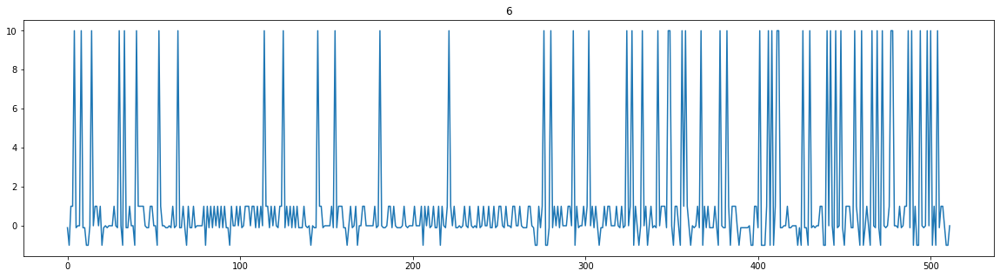

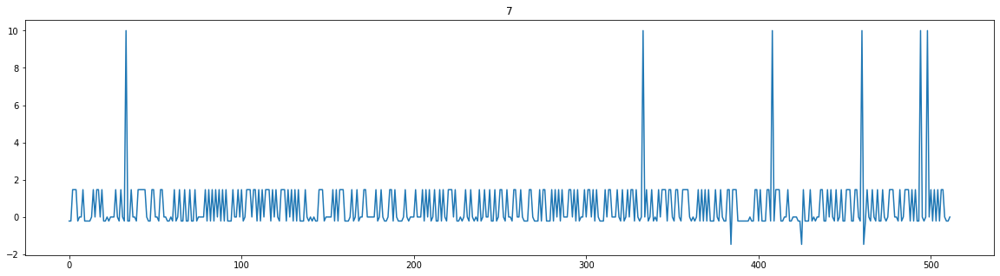

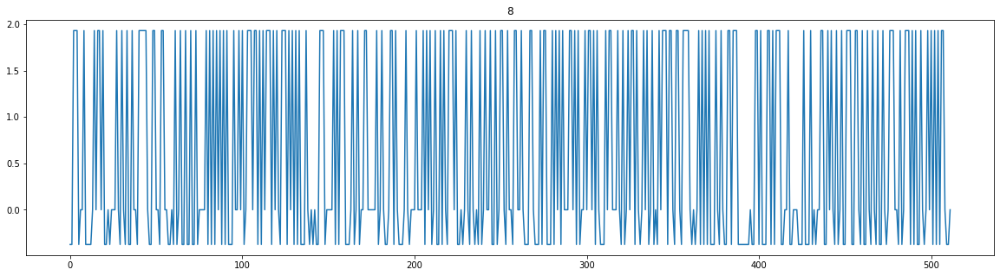

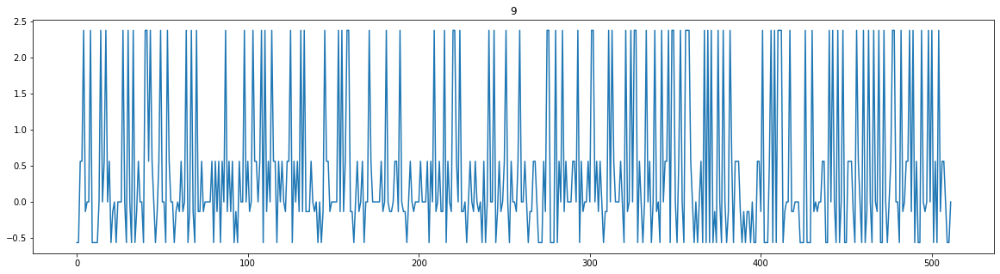

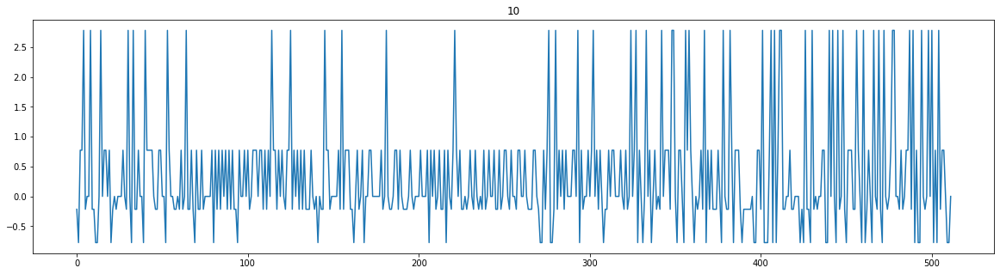

...

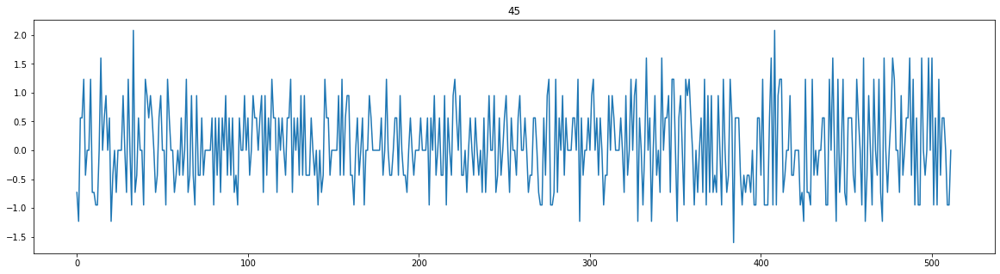

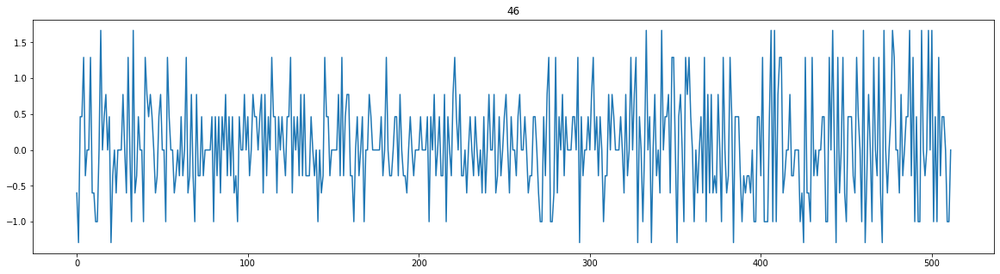

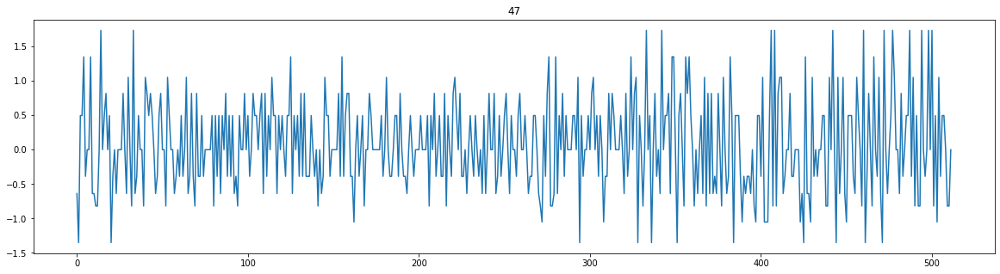

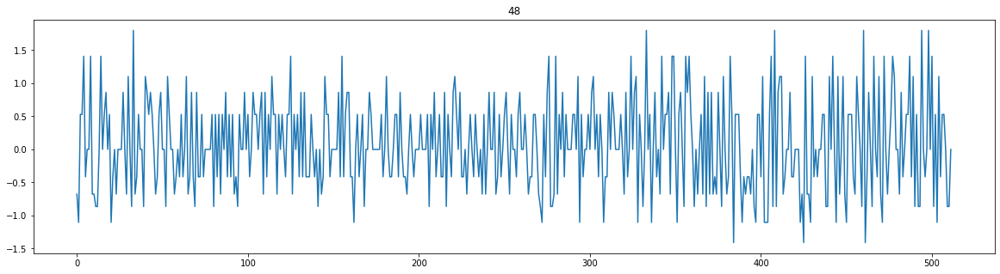

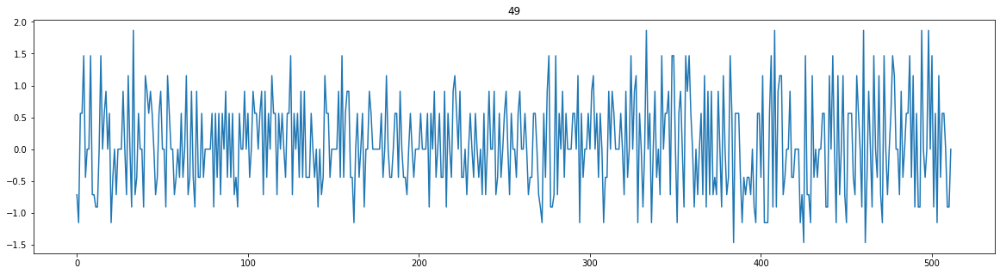

In [55]:
start = 0.0001
boundary = 10
number = 6

clusters = np.concatenate((-np.flip(np.geomspace(start, boundary, num=number)), [0], np.geomspace(start, boundary, num=number)))
# clusters = np.concatenate((clusters[:-len(clusters)//2], [0], clusters[len(clusters)//2:]))
for number in range(6, 50):
    clusters = np.concatenate((-np.flip(np.geomspace(start, boundary, num=number)), [0], np.geomspace(start, boundary, num=number)))
    fig = plt.figure(figsize=(20, 5))
    ax = fig.add_subplot(111)
    ax.plot(clusters[np.digitize(data[1], clusters)])
    plt.title(str(number))
    plt.show()

In [58]:
data.min()

-8.512397963218573

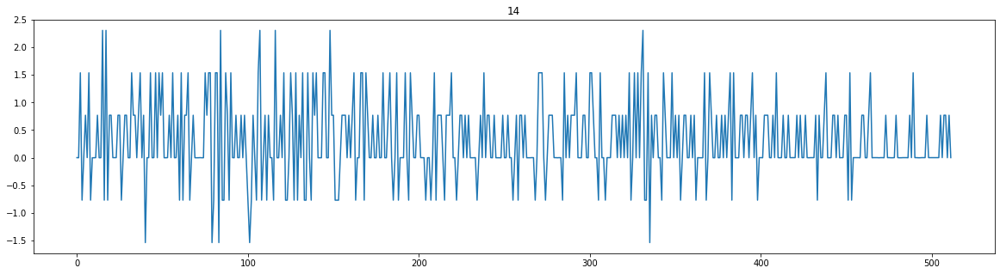

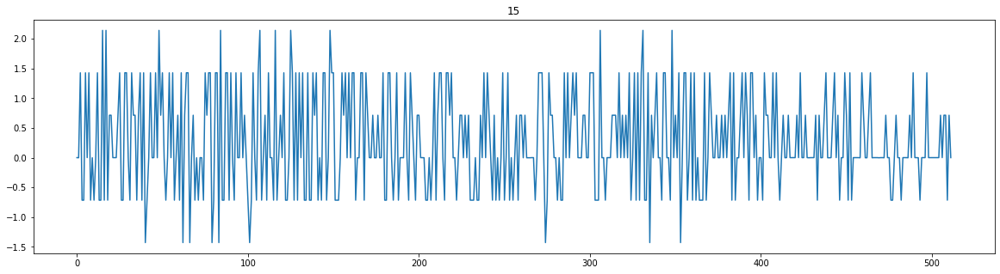

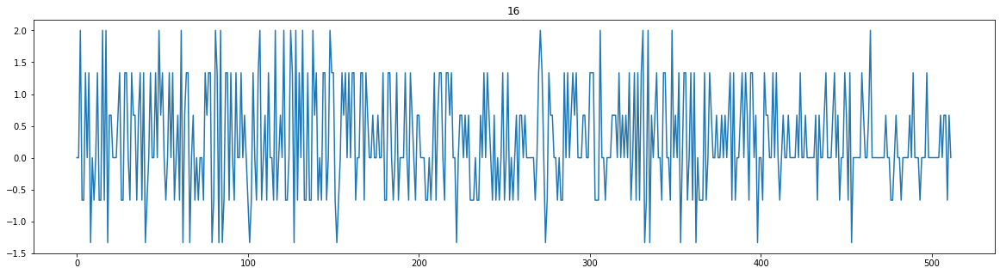

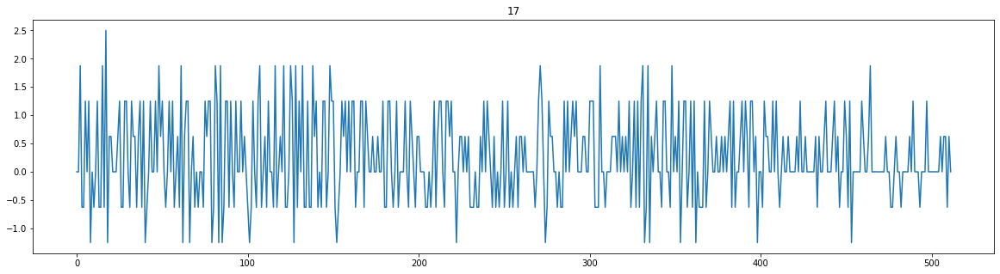

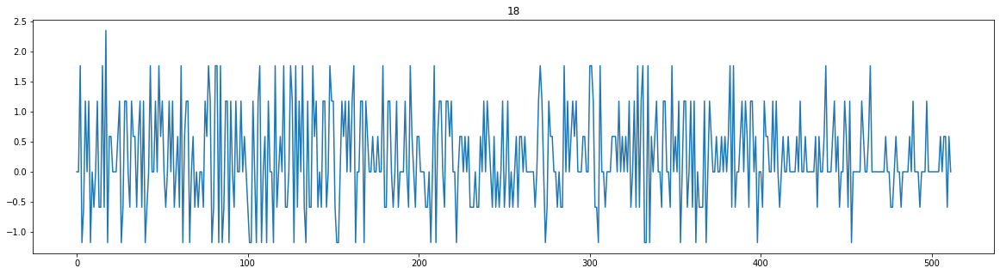

...

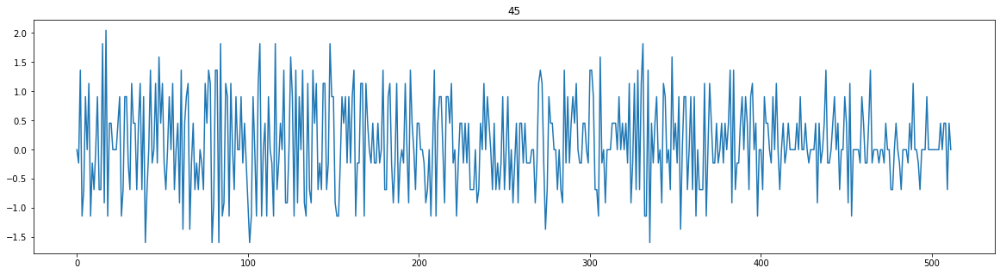

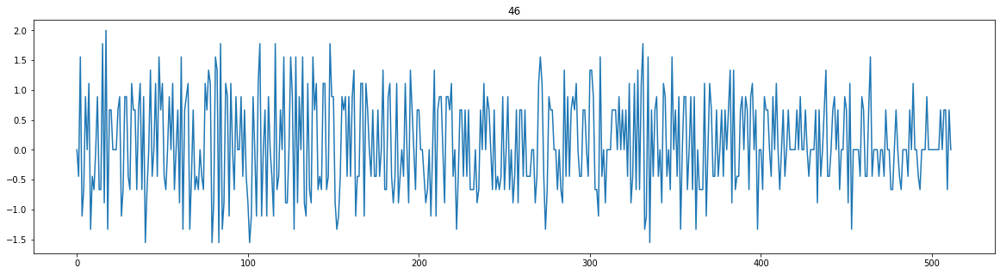

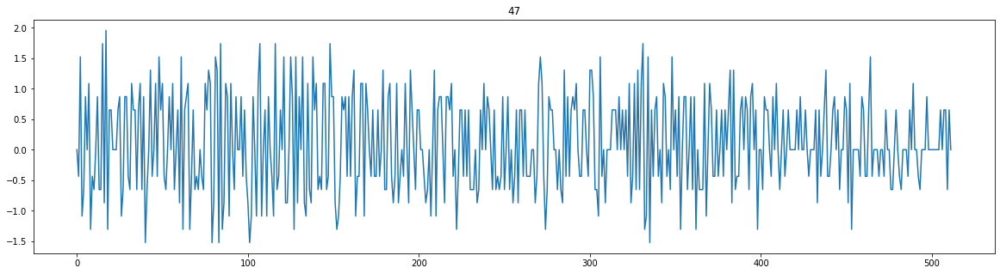

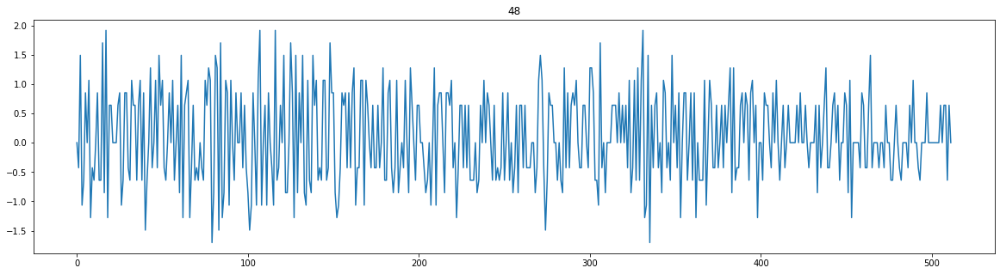

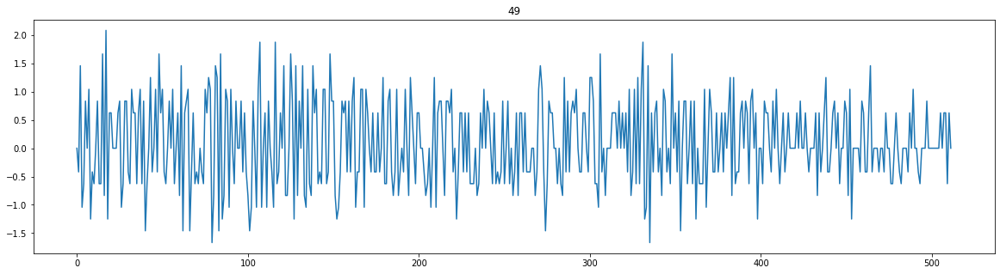

In [61]:
start = 0.001
boundary = 10
number = 14

clusters = np.concatenate((-np.flip(np.geomspace(start, boundary, num=number)), [0], np.geomspace(start, boundary, num=number)))
# clusters = np.concatenate((clusters[:-len(clusters)//2], [0], clusters[len(clusters)//2:]))
for number in range(14, 50):
    clusters = np.concatenate((-np.flip(np.linspace(start, boundary, num=number)), [0], np.linspace(start, boundary, num=number)))
    fig = plt.figure(figsize=(20, 5))
    ax = fig.add_subplot(111)
    ax.plot(clusters[np.digitize(data[5], clusters)])
    plt.title(str(number))
    plt.show()

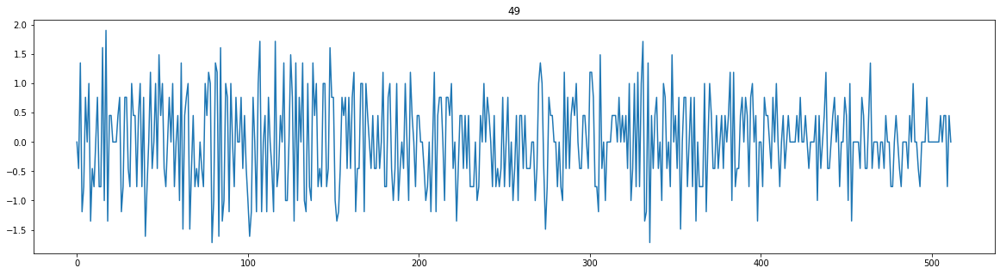

In [59]:
    fig = plt.figure(figsize=(20, 5))
    ax = fig.add_subplot(111)
    ax.plot(data[5])
    plt.title(str(number))
    plt.show()

In [4]:
start = 0.001
boundary = 10
number = 49

clusters = np.concatenate((-np.flip(np.geomspace(start, boundary, num=number)), [0], np.geomspace(start, boundary, num=number)))


In [8]:
data.shape

(466006, 512)

In [11]:
data_clustered = np.digitize(data, clusters, right=False)-1

In [12]:
data[1]

array([0.4550818788123867, 1.4945692613035106, -0.7662469283991332, 0.0,
       0.4548712795282659, 0.0, 0.0, 0.0, 0.0, -1.1950178314295419,
       0.7665552733113082, 0.0, 0.45491338352210536, 0.0, 0.0, 0.0,
       -0.4548712795282659, 0.0, 0.45491338352210536, 0.4548712795282659,
       0.0, -0.4548291834613643, 0.0, 0.0, -0.4548712795282659,
       0.45491338352210536, -0.4548712795282659, 0.0, 0.0,
       -0.45491338352210536, 0.7664935835149992, 0.4548712795282659, 0.0,
       1.3557116531565438, 0.45461882195130554, 0.4545767733982725,
       0.45453473275626605, 0.4544927000230166, -0.45445067519625576,
       1.0028800788933236, -0.7656310181332086, 0.0, 0.45445067519625576,
       -0.7656925624439377, 0.0, 0.4544927000230166, 0.45445067519625576,
       1.1942152758701214, -0.4542406695804377, 0.4542826549087549,
       0.4542406695804377, 0.4541986921450158, 0.7653234520936185,
       -0.454072807173501, -0.4541147609438087, 0.0, 0.0,
       -0.7653234520936185, 0.0, 0.454240

In [13]:
clusters[data_clustered[1]]

array([ 0.38311868,  1.46779927, -0.82540419,  0.        ,  0.38311868,
        0.        ,  0.        ,  0.        ,  0.        , -1.21152766,
        0.68129207,  0.        ,  0.38311868,  0.        ,  0.        ,
        0.        , -0.46415888,  0.        ,  0.38311868,  0.38311868,
        0.        , -0.46415888,  0.        ,  0.        , -0.46415888,
        0.38311868, -0.46415888,  0.        ,  0.        , -0.46415888,
        0.68129207,  0.38311868,  0.        ,  1.21152766,  0.38311868,
        0.38311868,  0.38311868,  0.38311868, -0.46415888,  1.        ,
       -0.82540419,  0.        ,  0.38311868, -0.82540419,  0.        ,
        0.38311868,  0.38311868,  1.        , -0.46415888,  0.38311868,
        0.38311868,  0.38311868,  0.68129207, -0.46415888, -0.46415888,
        0.        ,  0.        , -0.82540419,  0.        ,  0.38311868,
       -0.46415888,  0.38311868,  0.        , -1.21152766, -0.46415888,
        0.38311868,  0.        ,  0.        , -0.82540419,  0.38

In [17]:
np.save('data_clustered', data_clustered)

In [18]:
data_clustered.shape

(815635, 299)

In [5]:
data_clustered = np.load('data_clustered.npy')

In [6]:
max_size = 299

In [7]:
class SongLyrics(Dataset):  
    def __init__(self, context):
        self.context = context
        
    def __len__(self):
        return len(self.context)

    def __getitem__(self, item):
        x = torch.tensor(self.context[item][-max_size:]).long()
        return x
    
dataset = SongLyrics(data_clustered)  

In [8]:
np.array(dataset.context).shape, dataset.__getitem__(1000).shape

((815635, 299), torch.Size([299]))

In [9]:
dataset.__getitem__(0)

tensor([49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49,
        49, 91,  8, 84, 81, 84, 86, 49, 81, 88, 11, 11, 13, 13, 87, 49, 49, 11,
        88, 16, 81, 13, 11, 84, 49, 16, 49, 49, 16, 49, 11, 49, 81, 49, 13, 49,
        13, 13, 49, 89, 16, 13, 11, 86, 11, 81, 86, 16, 81, 84, 11, 86, 81, 11,
        84, 84, 81, 81, 11, 49, 81, 49, 87, 84, 81, 84, 11, 84, 84, 81, 49, 49,
        86,  9, 49, 86, 49, 81, 49, 88, 13, 81, 13, 88, 49, 84, 49, 11, 86, 13,
        81, 81, 84, 81, 81, 86, 16, 16, 16, 49, 49, 81, 89, 81, 88, 13, 13, 11,
        16, 16, 81, 13, 81, 49, 84, 13, 81, 11, 86, 49, 13, 49, 81, 13, 81, 81,
        13, 81, 11, 81, 11, 81, 81, 16, 84, 84, 81, 49, 16, 49, 49, 81, 84, 84,
        84, 84, 11, 84, 16, 86, 13, 16, 81, 16, 86, 84, 81, 13, 10, 16, 49, 16,
        49, 49, 13, 16, 81, 49, 81, 16, 16, 81, 13, 81, 49, 16, 81, 13, 49, 81,
        81, 49, 49, 86, 49, 16, 16, 13, 16, 11, 49, 84, 11, 11, 49, 86, 81, 16,
        16, 11, 81, 81, 13, 16, 49, 49, 

In [11]:
clusters[49]

0.0

In [27]:
import gc
gc.collect()
del model
del input_tensor
del outputs

In [28]:
torch.cuda.empty_cache()

In [7]:
vocab_size = len(clusters)
# bos_token_id=vocab_size-4
# eos_token_id=vocab_size-3
# pad_token_id=vocab_size-2
# unk_token_id=vocab_size-1
    
config = transformers.GPT2Config(
    vocab_size=vocab_size,
#     bos_token_id=bos_token_id,
#     eos_token_id=eos_token_id,
#     pad_token_id=pad_token_id,
#     unk_token_id=unk_token_id,
    bos_token_id=None,
    eos_token_id=None,
    pad_token_id=None,
    unk_token_id=None,
    n_positions=max_size,
    n_ctx=max_size,
    n_embd=12*64,
    num_labels=vocab_size,
    resid_pdrop=0,
    embd_pdrop=0,
    attn_pdrop=0,
)
model = transformers.GPT2LMHeadModel(config).cuda()
model.train()

KeyboardInterrupt: 

In [11]:
vocab_size = 50257
    
config = transformers.GPT2Config(
    vocab_size=vocab_size,
    n_positions=512*2,
    n_ctx=512*2,
    n_embd=12*64*8,
    num_labels=vocab_size
)
model = transformers.GPT2LMHeadModel(config)

KeyboardInterrupt: 

In [ ]:
def get_n_params(model):
    pp=0
    for p in list(model.parameters()):
        nn=1
        for s in list(p.size()):
            nn = nn*s
        pp += nn
    return pp
get_n_params(model)/1000000

In [ ]:
get_n_params(model)/1000000

In [ ]:
get_n_params(model)/1000000

In [12]:
get_n_params(model), np.log(5), np.log(data_clustered.size/get_n_params(model)), data_clustered.size/get_n_params(model)

(85361664, 1.6094379124341003, 1.0497581446691984, 2.8569600634776755)

In [9]:
epochs=1
warmup_steps=2000//(512/64)
# warmup_steps = 100
lr=0.000025
output_dir="./runs"
output_prefix="first"
save_model_on_epoch=True
time_steps = 30
    
device=torch.device("cuda")

batch_size_loader=44
batch_size = 512//batch_size_loader
train_dataloader = DataLoader(dataset, batch_size=batch_size_loader, shuffle=True)
loss=0
accumulating_batch_count = 0
input_tensor = None


optimizer = AdamW(model.parameters(), lr=lr, weight_decay=0)
scheduler = transformers.get_cosine_schedule_with_warmup(
    optimizer, num_warmup_steps=warmup_steps, num_training_steps=epochs*train_dataloader.__len__()//batch_size
)


for epoch in range(epochs):

    print(f"Training epoch {epoch}")
        
    pbar = tqdm(enumerate(train_dataloader), total=train_dataloader.__len__())
    acc = []
    acc_sign = []
    mae = []
    samples = np.empty((0, 30))
    input_tensors = torch.empty((0, max_size), dtype=torch.long).cuda()
    for idx, input_tensor in pbar:
        input_tensor = input_tensor.to(device)
        
        outputs = model(input_tensor, labels=input_tensor)
        loss = outputs[0]
        loss.backward()
        
        inp = input_tensor.cpu().detach().numpy()
        logits = outputs['logits'].argmax(axis=2).cpu().detach().numpy()
        
        acc.append((logits == inp).sum()/logits.size)
        acc_sign.append((np.sign(logits-len(clusters)//2) == np.sign(inp-len(clusters)//2)).sum()/logits.size)
        mae.append(mean_absolute_error(inp, logits)/len(clusters))

        if (accumulating_batch_count % batch_size) == 0:
            optimizer.step()
            scheduler.step()
            optimizer.zero_grad()
            model.zero_grad()
            
        accumulating_batch_count += 1
        
        input_tensor = None
        pbar.set_postfix(loss=loss.cpu().detach().numpy(), ACC=acc[-1], ACC_sign=acc_sign[-1], a_mae=mae[-1],
                         lr=scheduler.get_last_lr()[0])
        
    if save_model_on_epoch:
        torch.save(
            model.state_dict(),
            os.path.join(output_dir, f"{output_prefix}-{epoch}.pt"),
        )
        
    print(f"Loss: {loss}, ACC: {np.mean(acc)}, ACC_sign: {np.mean(acc_sign)}, MAE: {np.mean(mae)}")
    print()

  0%|                                                                                                                                                                                                           | 0/18538 [00:00<?, ?it/s]

Training epoch 0


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18538/18538 [3:43:13<00:00,  1.38it/s, ACC=0.105, ACC_sign=0.228, a_mae=0.389, loss=3.1560032, lr=3e-11]


Loss: 3.15600323677063, ACC: 0.13975646668482064, ACC_sign: 0.2496758507995122, MAE: 0.3669678239079964



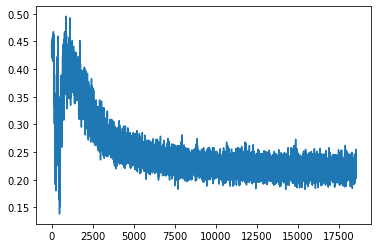

In [13]:
plt.plot(acc_sign)

In [11]:
epochs=1
warmup_steps=2000//(512/64)
# warmup_steps = 100
lr=0.000025
output_dir="./runs"
output_prefix="first"
save_model_on_epoch=True
time_steps = 30
    
device=torch.device("cuda")

batch_size_loader=32
batch_size = 512//batch_size_loader
train_dataloader = DataLoader(dataset, batch_size=batch_size_loader, shuffle=True)
loss=0
accumulating_batch_count = 0
input_tensor = None


optimizer = AdamW(model.parameters(), lr=lr, weight_decay=0)
scheduler = transformers.get_cosine_schedule_with_warmup(
    optimizer, num_warmup_steps=warmup_steps, num_training_steps=epochs*train_dataloader.__len__()//batch_size
)


for epoch in range(epochs):

    print(f"Training epoch {epoch}")
        
    pbar = tqdm(enumerate(train_dataloader), total=train_dataloader.__len__())
#     mae_profit = []
    acc = []
    acc_sign = []
    mae = []
#     mae_cash = []
    samples = np.empty((0, 30))
#     cash_preds = np.empty((0, 30))
#     cash_trues = np.empty((0, 30))
#     profit_preds = np.empty((0, 30))
#     profit_trues = np.empty((0, 30))
    input_tensors = torch.empty((0, max_size), dtype=torch.long).cuda()
    for idx, input_tensor in pbar:
        input_tensor = input_tensor.to(device)
#         input_tensors = torch.cat((input_tensors, input_tensor))
        
        if idx == 0 or (accumulating_batch_count % batch_size) == 0:
            output = model.generate(
                input_ids=input_tensor[:, :-time_steps],
                max_length=max_size, temperature=1.0, do_sample=False, top_k=100, seed=42, num_beams=3
            )
            sample = output[:,-time_steps:].cpu().detach().numpy()
            samples = np.concatenate((samples, sample))

            inp = input_tensors[:,-time_steps:].cpu().detach().numpy()
            acc.append((sample == inp).sum()/sample.size)
            acc_sign.append((np.sign(sample-len(clusters)//2) == np.sign(inp-len(clusters)//2)).sum()/sample.size)
            mae.append(mean_absolute_error(inp, sample)/len(clusters))
            

#             profit_pred = clusters[sample]
#             profit_true = clusters[inp]

#             profit_pred = np.sign(profit_pred)*(np.exp(abs(profit_pred)) - 1)
#             profit_true = np.sign(profit_true)*(np.exp(abs(profit_true)) - 1)

#             profit_preds = np.concatenate((profit_preds, profit_pred))
#             profit_trues = np.concatenate((profit_trues, profit_true))

#             mae_profit.append(mean_absolute_error(profit_true, profit_pred))

#             cash_pred = np.ones(profit_pred.shape)
#             cash_true = np.ones(profit_true.shape)
#             for i in range(1, 30):
#                 cash_pred[:,i] = cash_pred[:,i-1]*(1+profit_pred[:,i]/100)
#                 cash_true[:,i] = cash_true[:,i-1]*(1+profit_true[:,i]/100)

#             cash_preds = np.concatenate((cash_preds, cash_pred))
#             cash_trues = np.concatenate((cash_trues, cash_true))

#             mae_cash.append(mean_absolute_error(cash_true-1, cash_pred-1))
        
        outputs = model(input_tensor, labels=input_tensor)
        loss = outputs[0]
        loss.backward()

        if (accumulating_batch_count % batch_size) == 0:
            optimizer.step()
            scheduler.step()
            optimizer.zero_grad()
            model.zero_grad()
            
        accumulating_batch_count += 1
        
        input_tensor = None
#         pbar.set_postfix(loss=loss.cpu().detach().numpy(), ACC= acc[-1], mae_profit=mae_profit[-1], mae_cash=mae_cash[-1], 
#                          lr=scheduler.get_last_lr()[0])
        pbar.set_postfix(loss=loss.cpu().detach().numpy(), ACC= acc[-1], ACC_sign= acc_sign[-1], a_mae=mae[-1],
                         lr=scheduler.get_last_lr()[0])
        
    if save_model_on_epoch:
        torch.save(
            model.state_dict(),
            os.path.join(output_dir, f"{output_prefix}-{epoch}.pt"),
        )
        
    print(f"Loss: {loss}, ACC: {np.mean(acc)}, ACC_sign: {np.mean(acc_sign)}, MAE: {np.mean(mae)}")
    print()

  0%|                                                                                                                                                                                                           | 0/25489 [00:00<?, ?it/s]

Training epoch 0


c:\program files\python36\lib\site-packages\torch\_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  ..\aten\src\ATen\native\BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
  0%|                                                                                                                              | 16/25489 [00:13<5:50:00,  1.21it/s, ACC=0.0115, ACC_sign=0.434, a_mae=0.387, loss=4.7863426, lr=1e-7]


RuntimeError: CUDA out of memory. Tried to allocate 5.28 GiB (GPU 0; 24.00 GiB total capacity; 16.35 GiB already allocated; 2.73 GiB free; 19.05 GiB reserved in total by PyTorch)

In [28]:
torch.save(
    model.state_dict(),
    os.path.join(output_dir, f"one_epoch_all_forex.pt"),
)

In [73]:
# del output
# del input_tensors
del input_tensor

NameError: name 'input_tensor' is not defined

In [74]:
# del sample
del samples

In [76]:
del cash_preds 
del cash_trues 
del profit_preds 
del profit_trues 

In [78]:
del pbar

In [80]:
del dataset_test
del test_dataloader

In [81]:
torch.cuda.empty_cache()

In [14]:
data_test = np.load('data/forex/all_forex_data_ffill_test.csv.npy', allow_pickle=True)

In [16]:
data_test_clustered = np.digitize(data_test, clusters, right=False)-1

In [31]:
np.save('data_test_clustered', data_test_clustered)

In [11]:
data_test_clustered = np.load('data_test_clustered.npy')

In [82]:
dataset_test = SongLyrics(data_test_clustered) 
test_dataloader = DataLoader(dataset_test, batch_size=56, shuffle=False)

In [83]:
time_steps = 30
pbar = tqdm(enumerate(test_dataloader), total=test_dataloader.__len__())
mae_profit = []
acc = []
mae_cash = []
samples = np.empty((0, 30))
cash_preds = np.empty((0, 30))
cash_trues = np.empty((0, 30))
profit_preds = np.empty((0, 30))
profit_trues = np.empty((0, 30))
for idx, input_tensor in pbar:
    input_tensor = input_tensor.to(device)
    
    output = model.generate(
        input_ids=input_tensor[:, :-time_steps],
        max_length=max_size, temperature=0.5, do_sample=False, top_k=100, seed=42, num_beams=3, repetition_penalty=0.5
    )
    sample = output[:,-time_steps:].cpu().detach().numpy()
    samples = np.concatenate((samples, sample))
    
    inp = input_tensor[:,-time_steps:].cpu().detach().numpy()
    acc.append((sample == inp).sum()/sample.size)

    profit_pred = clusters[sample]
    profit_true = clusters[inp]

    profit_pred = np.sign(profit_pred)*(np.exp(abs(profit_pred)) - 1)
    profit_true = np.sign(profit_true)*(np.exp(abs(profit_true)) - 1)
    
    profit_preds = np.concatenate((profit_preds, profit_pred))
    profit_trues = np.concatenate((profit_trues, profit_true))

    mae_profit.append(mean_absolute_error(profit_true, profit_pred))

    cash_pred = np.ones(profit_pred.shape)
    cash_true = np.ones(profit_true.shape)
    for i in range(1, 30):
        cash_pred[:,i] = cash_pred[:,i-1]*(1+profit_pred[:,i]/100)
        cash_true[:,i] = cash_true[:,i-1]*(1+profit_true[:,i]/100)
        
    cash_preds = np.concatenate((cash_preds, cash_pred))
    cash_trues = np.concatenate((cash_trues, cash_true))

    mae_cash.append(mean_absolute_error(cash_true-1, cash_pred-1))
#     break

  0%|                                                                                                                                                                                                             | 0/332 [00:00<?, ?it/s]


RuntimeError: CUDA out of memory. Tried to allocate 134.00 MiB (GPU 0; 24.00 GiB total capacity; 20.65 GiB already allocated; 0 bytes free; 22.18 GiB reserved in total by PyTorch)

In [58]:
inp

array([[70, 70, 18, ..., 17, 20, 19],
       [17, 16, 82, ..., 81, 82, 11],
       [18, 24, 80, ..., 78, 81, 19],
       ...,
       [76, 78, 27, ..., 76, 80, 23],
       [20, 15, 18, ..., 21, 23, 79],
       [86, 49, 49, ..., 70, 49, 74]], dtype=int64)

In [61]:
(inp == 49).sum()/inp.size, (samples == 49).sum()/samples.size

(0.06369047619047619, 0.5913095238095238)

In [56]:
model.generate?

In [38]:
acc[-1], mae_profit[-1], mae_cash[-1]

(0.06190476190476191, 0.566537863252662, 0.018833705766187547)

In [40]:
for i in range(1, 30):
    print(mean_absolute_error(cash_trues[:,i]-1, cash_preds[:,i]-1))

0.005327927264014617
0.006650414533385384
0.008242009673536535
0.008732877882193854
0.010007780227318125
0.011146968004746757
0.012357496258328058
0.012808061501812984
0.014038753274218151
0.014923184883101044
0.015632607866635964
0.016322336159430607
0.017123284305053343
0.01825820379885913
0.018967354200362576
0.019197868810065116
0.020285440034510598
0.02023784302688332
0.020653531918031993
0.021012097491917528
0.021937939418352228
0.02218103836111131
0.023333730137836454
0.023147987172615122
0.023595093378702997
0.023786638446498677
0.024526074586196434
0.025315204123370603
0.0254454107844012


In [41]:
cash = 1.0
time_steps = 1
threshold = 0.01
for i in range(cash_preds.shape[0]):
    if cash_preds[i, time_steps] > 1.0 + threshold:
        cash = cash*cash_trues[i,time_steps]
        print(cash, cash_preds[i,time_steps], cash_trues[i,time_steps], profit_preds[i, time_steps], profit_trues[i, time_steps])
    if cash_preds[i, time_steps] < 1.0 - threshold:
        cash = cash*(2-cash_trues[i,time_steps])
        print(cash, cash_preds[i,time_steps], cash_trues[i,time_steps], profit_preds[i, time_steps], profit_trues[i, time_steps])

0.9995249003244331 0.987171967456663 1.000475099675567 -1.282803254333698 0.04750996755668879
1.0123468382736707 0.9828171817154095 0.987171967456663 -1.718281828459045 -1.282803254333698
1.0170730008791997 0.987171967456663 0.9953314788698423 -1.282803254333698 -0.4668521130157741
1.017661330120389 0.987171967456663 0.9994215466926359 -1.282803254333698 -0.05784533073640663
1.0253423955969467 1.012828032543337 1.0075477619608963 1.282803254333698 0.7547761960896255
1.0240217818563366 0.987171967456663 1.001287973408962 -1.282803254333698 0.12879734089618688
1.0162927092041123 1.012828032543337 0.9924522380391038 1.282803254333698 -0.7547761960896255
0.9988299362579041 0.9828171817154095 1.0171828182845903 -1.718281828459045 1.718281828459045
0.9860169133303285 1.012828032543337 0.987171967456663 1.282803254333698 -1.282803254333698
1.0029594627776162 1.012828032543337 1.0171828182845903 1.282803254333698 1.718281828459045
1.0023792975592203 0.9828171817154095 1.000578453307364 -1.7182

In [46]:
cash_preds[10]

array([1.        , 0.99628057, 0.99925196, 0.99553532, 0.99850448,
       0.99479062, 0.99775756, 0.99404647, 0.9970112 , 0.99330289,
       0.99626539, 0.99255986, 0.99552015, 0.99181738, 0.99477546,
       0.99107547, 0.99403133, 0.9903341 , 0.99328775, 0.98959329,
       0.99254474, 0.98885304, 0.99180227, 0.98811334, 0.99106037,
       0.98737419, 0.99031901, 0.9866356 , 0.98957822, 0.98589755])

In [12]:
samples_tokenized = np.load('all_forex_samples.npy', allow_pickle=True)

In [20]:
tokenizer = transformers.GPT2TokenizerFast.from_pretrained('gpt2')

In [22]:
print(tokenizer.decode(samples_tokenized[0]))

forex:AUDUSD:2001-05-22
234;08:25,0.5235;08:27,0.5235;08:28,0.5237;08:30,0.5236;08:31,0.5236;08:32,0.5235;08:33,0.5235;08:34,0.5237;08:35,0.5237;08:36,0.5236;08:37,0.5238;08:38,0.5239;08:40,0.5238;08:41,0.5239;08:42,0.5238;08:44,0.524;08:46,0.5242;08:48,0.5241;08:51,0.5243;08:52,0.5243;08:53,0.5243;08:54,0.5242;08:55,0.5241;08:56,0.5241;08:57,0.5238;08:59,0.5237;09:00,0.5237;09:01,0.5239;09:02,0.5241;09:03,0.5241;09:04,0.524;09:06,0.524;09:07,0.5241;09:16,0.5239;09:17,0.5241;09:18,0.524;09:20,0.5242;09:21,0.5243;09:23,0.5241;09:24,0.5242;09:25,0.5243;09:26,0.5242;09:27,0.5241;09:28,0.5241;09:31,0.5234;09:32,0.5236;09:33,0.5232;09:34,0.5233;09:35,0.5232;09:36,0.5231;09:37,0.523;09:38,0.5233;09:40,0.5227;09:41,0.5227;09:42,0.5227;09:43,0.5226;09:45,0.5225;09:46,0.5225;09:49,0.5228;09:51,0.5229;09:53,0.5234;09:54,0.5237;09:55,0.5237;09:56,0.5235;09:57,0.5235;09:58,0.5236;09:59,0.5235;10:00,0.5235;10:01,0.5237;10:02,0.5237;10:03,0.5239;10:04,0.5239;10:06,0.5238;10:07,0.5237;10:08,0.5237;10